In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperatures
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperatures
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperatures
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)

#Since the NaN values of GHI are gone which is used in data preparation, simulate these in solar activity instead
df['solar_activity'].loc[df['Year'] > 2020] = np.nan
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['GHI'], axis=1)

n_vars = df_trimmed.shape[1]-1

X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df) 

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  temperatures          slp  vapor_pressure  \
0      2006-01-31     6501     12.209677  1018.534543        8.674922   
1      2006-02-28     6501      8.174541  1021.230347        6.942276   
2      2006-03-31     6501     15.676613  1018.968548       10.468176   
3      2006-04-30     6501     22.464167  1014.686944       16.358802   
4      2006-05-31     6501     23.657258  1014.236828       18.798749   
...           ...      ...           ...          ...             ...   
24057  2024-07-31     9858     28.604704  1013.969355       23.769169   
24058  2024-08-31     9858     29.114919  1015.112097       23.699154   
24059  2024-09-30     9858     24.570278  1014.393750       16.790240   
24060  2024-10-31     9858     21.159140  1018.230376       10.994776   
24061  2024-11-30     9858     12.112917  1

C:\Users\User\AppData\Local\Temp\ipykernel_653008\3453849465.py:375: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['solar_activity'].loc[df['Year'] > 2020] = np.nan


Fold 1
Fold 2
Fold 3
Fold 4
Fold 5
Fold 1:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.39307412 0.69695044 0.32924264 ... 0.45808019 0.42952612 0.37788578]
 [0.45747266 0.51683609 0.42215989 ... 0.49422843 0.47691373 0.38882139]
 [0.38487242 0.62674714 0.3411641  ... 0.51032807 0.38244228 0.37363305]
 ...
 [0.54100851 0.46473952 0.46949509 ... 0.48025516 0.45504253 0.40583232]
 [0.44896719 0.51620076 0.3997195  ... 0.49696233 0.45170109 0.39611179]
 [0.46780073 0.52414231 0.42356241 ... 0.49301337 0.4881531  0.43772783]]
Fold 2:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.38166311 0.62313675 0.34639831 ... 0.51507767 0.37861712 0.40511727]
 [0.39415169 0.71548931 0.32450565 ... 0.45933597 0.43070362 0.37892172]
 [0.45872677 0.53175632 0.4180791  ... 0.49558331 0.47822114 0.3898873 ]
 ...
 [0.54249162 0.47861309 0.465

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-21 15:46:51,200] A new study created in memory with name: no-name-c1b0867d-f963-4095-8f4a-87918c4a0bf1
[I 2025-05-21 15:49:44,595] Trial 0 finished with value: 0.05199993997812271 and parameters: {'lr': 0.5367063289855805, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.2600278418039466}. Best is trial 0 with value: 0.05199993997812271.


Cross Validation Accuracies:
[0.04781362786889076, 0.041120242327451706, 0.05805576965212822, 0.06360948830842972, 0.04940057173371315]
Mean Cross Validation Accuracy:
0.05199993997812271
Standard Deviation of Cross Validation Accuracy:
0.007925962790604847


[I 2025-05-21 15:51:53,567] Trial 1 finished with value: 0.05115852653980255 and parameters: {'lr': 0.008287484823659947, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.10682135490186934}. Best is trial 1 with value: 0.05115852653980255.


Cross Validation Accuracies:
[0.042333416640758514, 0.04488983750343323, 0.05690058693289757, 0.06341332197189331, 0.048255469650030136]
Mean Cross Validation Accuracy:
0.05115852653980255
Standard Deviation of Cross Validation Accuracy:
0.00785821907190809


[I 2025-05-21 15:55:57,790] Trial 2 finished with value: 0.054520221799612044 and parameters: {'lr': 0.7005347317909746, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.21842290515861704}. Best is trial 1 with value: 0.05115852653980255.


Cross Validation Accuracies:
[0.04914763197302818, 0.0513019785284996, 0.055475588887929916, 0.06523526459932327, 0.05144064500927925]
Mean Cross Validation Accuracy:
0.054520221799612044
Standard Deviation of Cross Validation Accuracy:
0.005734639881935286


[I 2025-05-21 16:02:21,322] Trial 3 finished with value: 0.051155208796262744 and parameters: {'lr': 0.010660510865656678, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.48708154472616727}. Best is trial 3 with value: 0.051155208796262744.


Cross Validation Accuracies:
[0.04097555950284004, 0.04704228416085243, 0.055976901203393936, 0.06262435764074326, 0.04915694147348404]
Mean Cross Validation Accuracy:
0.051155208796262744
Standard Deviation of Cross Validation Accuracy:
0.007474283563964733


[I 2025-05-21 16:06:38,194] Trial 4 finished with value: 0.05177406817674637 and parameters: {'lr': 0.03246529364413676, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.4387455501946578}. Best is trial 3 with value: 0.051155208796262744.


Cross Validation Accuracies:
[0.043590474873781204, 0.0460018664598465, 0.05639667436480522, 0.06370604783296585, 0.04917527735233307]
Mean Cross Validation Accuracy:
0.05177406817674637
Standard Deviation of Cross Validation Accuracy:
0.007359128375620152


[I 2025-05-21 16:11:01,053] Trial 5 finished with value: 0.05109989047050476 and parameters: {'lr': 0.020320603449508427, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.10577016642136275}. Best is trial 5 with value: 0.05109989047050476.


Cross Validation Accuracies:
[0.041645295917987823, 0.04541497305035591, 0.05785540118813515, 0.06249860301613808, 0.048085179179906845]
Mean Cross Validation Accuracy:
0.05109989047050476
Standard Deviation of Cross Validation Accuracy:
0.00782769060638003


[I 2025-05-21 16:17:31,058] Trial 6 finished with value: 2.975352096557617 and parameters: {'lr': 0.03791672712479481, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.2863994054596582}. Best is trial 5 with value: 0.05109989047050476.


Cross Validation Accuracies:
[3.1636812686920166, 3.435154914855957, 2.684617757797241, 3.40975022315979, 2.183556318283081]
Mean Cross Validation Accuracy:
2.975352096557617
Standard Deviation of Cross Validation Accuracy:
0.47896873622715985


[I 2025-05-21 16:26:20,313] Trial 7 finished with value: 0.15967389643192292 and parameters: {'lr': 0.02483118345227777, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.2552740628339979}. Best is trial 5 with value: 0.05109989047050476.


Cross Validation Accuracies:
[0.13935695588588715, 0.15995657444000244, 0.2000197321176529, 0.15064182877540588, 0.1483943909406662]
Mean Cross Validation Accuracy:
0.15967389643192292
Standard Deviation of Cross Validation Accuracy:
0.021210610210300494


[I 2025-05-21 16:31:59,624] Trial 8 finished with value: 0.4980153560638428 and parameters: {'lr': 0.9675207239889425, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.31792931573305283}. Best is trial 5 with value: 0.05109989047050476.


Cross Validation Accuracies:
[0.512074887752533, 0.48834484815597534, 0.5186828374862671, 0.48603466153144836, 0.4849395453929901]
Mean Cross Validation Accuracy:
0.4980153560638428
Standard Deviation of Cross Validation Accuracy:
0.014372528024159103


[I 2025-05-21 16:36:03,096] Trial 9 finished with value: 0.04514648094773292 and parameters: {'lr': 0.003286726221520146, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.2585695216538211}. Best is trial 9 with value: 0.04514648094773292.


Cross Validation Accuracies:
[0.03133869916200638, 0.04040450230240822, 0.04218244552612305, 0.06275535374879837, 0.04905140399932861]
Mean Cross Validation Accuracy:
0.04514648094773292
Standard Deviation of Cross Validation Accuracy:
0.010461811799669322


[I 2025-05-21 16:40:05,729] Trial 10 finished with value: 0.03817020021378994 and parameters: {'lr': 0.0010583716223997207, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.37323061819939696}. Best is trial 10 with value: 0.03817020021378994.


Cross Validation Accuracies:
[0.02975851483643055, 0.03720781207084656, 0.041305962949991226, 0.04666930064558983, 0.03590941056609154]
Mean Cross Validation Accuracy:
0.03817020021378994
Standard Deviation of Cross Validation Accuracy:
0.0056366927846755975


[I 2025-05-21 16:44:41,651] Trial 11 finished with value: 0.0397310383617878 and parameters: {'lr': 0.0010763499915200688, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.36825629732807896}. Best is trial 10 with value: 0.03817020021378994.


Cross Validation Accuracies:
[0.03165171667933464, 0.03826012462377548, 0.040624383836984634, 0.05081460252404213, 0.037304364144802094]
Mean Cross Validation Accuracy:
0.0397310383617878
Standard Deviation of Cross Validation Accuracy:
0.006276483641426583


[I 2025-05-21 16:48:45,808] Trial 12 finished with value: 0.03894238919019699 and parameters: {'lr': 0.0010674553214811628, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3781063240374232}. Best is trial 10 with value: 0.03817020021378994.


Cross Validation Accuracies:
[0.0327211394906044, 0.03663536533713341, 0.04005802422761917, 0.04858759418129921, 0.036709822714328766]
Mean Cross Validation Accuracy:
0.03894238919019699
Standard Deviation of Cross Validation Accuracy:
0.005353228573665859


[I 2025-05-21 16:52:40,021] Trial 13 finished with value: 0.041448541730642316 and parameters: {'lr': 0.0013000507115914826, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.38111157272962953}. Best is trial 10 with value: 0.03817020021378994.


Cross Validation Accuracies:
[0.031001828610897064, 0.04167769476771355, 0.04360818490386009, 0.055822886526584625, 0.035132113844156265]
Mean Cross Validation Accuracy:
0.041448541730642316
Standard Deviation of Cross Validation Accuracy:
0.008489634082975485


[I 2025-05-21 16:57:02,128] Trial 14 finished with value: 0.6271363615989685 and parameters: {'lr': 0.11967417561455986, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3919742246678335}. Best is trial 10 with value: 0.03817020021378994.


Cross Validation Accuracies:
[0.8841409683227539, 0.8717362880706787, 0.28585466742515564, 0.4602387249469757, 0.6337111592292786]
Mean Cross Validation Accuracy:
0.6271363615989685
Standard Deviation of Cross Validation Accuracy:
0.23248730536064188


[I 2025-05-21 17:01:23,593] Trial 15 finished with value: 0.059423422813415526 and parameters: {'lr': 0.0023608506858124522, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.33273344324870985}. Best is trial 10 with value: 0.03817020021378994.


Cross Validation Accuracies:
[0.05373198166489601, 0.05325426161289215, 0.06515631824731827, 0.06882456690073013, 0.056149985641241074]
Mean Cross Validation Accuracy:
0.059423422813415526
Standard Deviation of Cross Validation Accuracy:
0.006362610209525504


[I 2025-05-21 17:04:50,968] Trial 16 finished with value: 0.05152829214930534 and parameters: {'lr': 0.006051498953872824, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.44070552722454404}. Best is trial 10 with value: 0.03817020021378994.


Cross Validation Accuracies:
[0.043136343359947205, 0.045617666095495224, 0.05622965097427368, 0.06385859847068787, 0.04879920184612274]
Mean Cross Validation Accuracy:
0.05152829214930534
Standard Deviation of Cross Validation Accuracy:
0.007575585356846655


[I 2025-05-21 17:08:33,816] Trial 17 finished with value: 0.03508567549288273 and parameters: {'lr': 0.0025376029520190455, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.18406667272917732}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.02767619490623474, 0.02977210469543934, 0.03967413678765297, 0.043495792895555496, 0.0348101481795311]
Mean Cross Validation Accuracy:
0.03508567549288273
Standard Deviation of Cross Validation Accuracy:
0.005915985197143469


[I 2025-05-21 17:12:31,687] Trial 18 finished with value: 0.11583567783236504 and parameters: {'lr': 0.0030324731393012393, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.17304305708233164}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.05819198861718178, 0.05202613025903702, 0.19801336526870728, 0.0712188333272934, 0.1997280716896057]
Mean Cross Validation Accuracy:
0.11583567783236504
Standard Deviation of Cross Validation Accuracy:
0.06808262941591305


[I 2025-05-21 17:16:46,861] Trial 19 finished with value: 0.05256204828619957 and parameters: {'lr': 0.004682858155407816, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.18483959785921394}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.04288094490766525, 0.045588091015815735, 0.056240323930978775, 0.06342683732509613, 0.054674044251441956]
Mean Cross Validation Accuracy:
0.05256204828619957
Standard Deviation of Cross Validation Accuracy:
0.007461819110256037


[I 2025-05-21 17:21:57,534] Trial 20 finished with value: 0.6501985192298889 and parameters: {'lr': 0.13216439674729222, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.15260184359147128}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.5217109322547913, 0.7289558053016663, 0.7323848605155945, 0.5640122890472412, 0.7039287090301514]
Mean Cross Validation Accuracy:
0.6501985192298889
Standard Deviation of Cross Validation Accuracy:
0.08919794210526844


[I 2025-05-21 17:27:32,587] Trial 21 finished with value: 0.04200686290860176 and parameters: {'lr': 0.0015365710028637065, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4239184994948487}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.03192845731973648, 0.03748690336942673, 0.0445360504090786, 0.05622271075844765, 0.03986019268631935]
Mean Cross Validation Accuracy:
0.04200686290860176
Standard Deviation of Cross Validation Accuracy:
0.008186569562340755


[I 2025-05-21 17:33:27,168] Trial 22 finished with value: 0.04041237086057663 and parameters: {'lr': 0.001003142050135009, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3467361738877537}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.03568063676357269, 0.03794915974140167, 0.03961888328194618, 0.051180433481931686, 0.037632741034030914]
Mean Cross Validation Accuracy:
0.04041237086057663
Standard Deviation of Cross Validation Accuracy:
0.00552745608231968


[I 2025-05-21 17:39:09,589] Trial 23 finished with value: 0.04637047126889229 and parameters: {'lr': 0.002010523652225059, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4785374882325337}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.03889380395412445, 0.03864968195557594, 0.046957049518823624, 0.05979626998305321, 0.047555550932884216]
Mean Cross Validation Accuracy:
0.04637047126889229
Standard Deviation of Cross Validation Accuracy:
0.007713775997821071


[I 2025-05-21 17:44:28,861] Trial 24 finished with value: 0.04962418302893638 and parameters: {'lr': 0.004213482547322365, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.30005689058746954}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.043672896921634674, 0.04467921704053879, 0.05712553486227989, 0.0535152442753315, 0.04912802204489708]
Mean Cross Validation Accuracy:
0.04962418302893638
Standard Deviation of Cross Validation Accuracy:
0.005128885017823232


[I 2025-05-21 17:50:01,547] Trial 25 finished with value: 0.041553229093551636 and parameters: {'lr': 0.0019676269398779716, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3980556491546715}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.03162789344787598, 0.04010188579559326, 0.04182058945298195, 0.05712100490927696, 0.03709477186203003]
Mean Cross Validation Accuracy:
0.041553229093551636
Standard Deviation of Cross Validation Accuracy:
0.008519667262794163


[I 2025-05-21 17:55:24,525] Trial 26 finished with value: 0.08846233189105987 and parameters: {'lr': 0.012463854652285168, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3488537090348909}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.09654068201780319, 0.07647063583135605, 0.08107995986938477, 0.09162872284650803, 0.09659165889024734]
Mean Cross Validation Accuracy:
0.08846233189105987
Standard Deviation of Cross Validation Accuracy:
0.008242231748348788


[I 2025-05-21 18:01:44,794] Trial 27 finished with value: 0.41895580291748047 and parameters: {'lr': 0.07308620098548559, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.22365171635345713}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.5994972586631775, 0.29174333810806274, 0.43263718485832214, 0.4031469523906708, 0.3677542805671692]
Mean Cross Validation Accuracy:
0.41895580291748047
Standard Deviation of Cross Validation Accuracy:
0.10182035582676231


[I 2025-05-21 18:09:12,788] Trial 28 finished with value: 0.4403856873512268 and parameters: {'lr': 0.006861412948722606, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.4058613062907154}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.4584769010543823, 0.451722651720047, 0.4149291217327118, 0.4173416197299957, 0.4594581425189972]
Mean Cross Validation Accuracy:
0.4403856873512268
Standard Deviation of Cross Validation Accuracy:
0.01999321437939074


[I 2025-05-21 18:15:07,986] Trial 29 finished with value: 3.9579779624938967 and parameters: {'lr': 0.3705118144933907, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.28548922490580486}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[3.7542378902435303, 4.464481353759766, 5.017624855041504, 3.4032557010650635, 3.150290012359619]
Mean Cross Validation Accuracy:
3.9579779624938967
Standard Deviation of Cross Validation Accuracy:
0.6900701198294331


[I 2025-05-21 18:22:15,560] Trial 30 finished with value: 0.5041079044342041 and parameters: {'lr': 0.0016658304889657573, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.4622656390699808}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.5057419538497925, 0.5073257684707642, 0.5050042867660522, 0.49208128452301025, 0.5103862285614014]
Mean Cross Validation Accuracy:
0.5041079044342041
Standard Deviation of Cross Validation Accuracy:
0.006291028661032987


[I 2025-05-21 18:28:17,845] Trial 31 finished with value: 0.038822729140520096 and parameters: {'lr': 0.001053450415927842, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3675357160426811}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.02919403836131096, 0.040230534970760345, 0.04021932929754257, 0.049056485295295715, 0.03541325777769089]
Mean Cross Validation Accuracy:
0.038822729140520096
Standard Deviation of Cross Validation Accuracy:
0.006526842351171676


[I 2025-05-21 18:34:53,921] Trial 32 finished with value: 0.038203117251396176 and parameters: {'lr': 0.0010095188925284665, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.36209493175957647}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.03064456582069397, 0.03500598669052124, 0.03876829147338867, 0.04925745353102684, 0.037339288741350174]
Mean Cross Validation Accuracy:
0.038203117251396176
Standard Deviation of Cross Validation Accuracy:
0.006174420065609121


[I 2025-05-21 18:41:00,681] Trial 33 finished with value: 0.03933131359517574 and parameters: {'lr': 0.002768722236476756, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.35042707640338777}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.029886716976761818, 0.03459519147872925, 0.04004630446434021, 0.05217178910970688, 0.03995656594634056]
Mean Cross Validation Accuracy:
0.03933131359517574
Standard Deviation of Cross Validation Accuracy:
0.007448640437977239


[I 2025-05-21 18:46:42,898] Trial 34 finished with value: 0.038003386557102205 and parameters: {'lr': 0.0016443819888292957, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3161220368407825}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.028783150017261505, 0.03360815718770027, 0.0401422418653965, 0.05006469786167145, 0.03741868585348129]
Mean Cross Validation Accuracy:
0.038003386557102205
Standard Deviation of Cross Validation Accuracy:
0.007137543140165672


[I 2025-05-21 18:52:22,238] Trial 35 finished with value: 0.04591743536293506 and parameters: {'lr': 0.0038899559977332884, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.31639152221706746}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.030107663944363594, 0.04556605964899063, 0.04619773477315903, 0.05880323797464371, 0.04891248047351837]
Mean Cross Validation Accuracy:
0.04591743536293506
Standard Deviation of Cross Validation Accuracy:
0.009221335143259327


[I 2025-05-21 18:57:40,842] Trial 36 finished with value: 0.05227598175406456 and parameters: {'lr': 0.01099396039247167, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.23173281604974877}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.04274599626660347, 0.04647019878029823, 0.05737115070223808, 0.06393977254629135, 0.05085279047489166]
Mean Cross Validation Accuracy:
0.05227598175406456
Standard Deviation of Cross Validation Accuracy:
0.007596814793083663


[I 2025-05-21 19:02:24,891] Trial 37 finished with value: 0.4341666638851166 and parameters: {'lr': 0.0018710587546656736, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.27559881301936495}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.4554091691970825, 0.4470885097980499, 0.4436272382736206, 0.377798855304718, 0.4469095468521118]
Mean Cross Validation Accuracy:
0.4341666638851166
Standard Deviation of Cross Validation Accuracy:
0.02845147276312389


[I 2025-05-21 19:08:04,174] Trial 38 finished with value: 0.03374846093356609 and parameters: {'lr': 0.002444996215470414, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13131063644327787}. Best is trial 38 with value: 0.03374846093356609.


Cross Validation Accuracies:
[0.029605813324451447, 0.02719116397202015, 0.03304717689752579, 0.04206646606326103, 0.03683168441057205]
Mean Cross Validation Accuracy:
0.03374846093356609
Standard Deviation of Cross Validation Accuracy:
0.00527914667917458


[I 2025-05-21 19:13:36,799] Trial 39 finished with value: 0.11537515372037888 and parameters: {'lr': 0.018227869210686087, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13193855983099917}. Best is trial 38 with value: 0.03374846093356609.


Cross Validation Accuracies:
[0.10020744800567627, 0.10276060551404953, 0.13792972266674042, 0.144145205616951, 0.09183278679847717]
Mean Cross Validation Accuracy:
0.11537515372037888
Standard Deviation of Cross Validation Accuracy:
0.02135347105212972


[I 2025-05-21 19:20:07,055] Trial 40 finished with value: 0.48830243945121765 and parameters: {'lr': 0.0062617409677038095, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.12199425027577912}. Best is trial 38 with value: 0.03374846093356609.


Cross Validation Accuracies:
[0.40876856446266174, 0.5134032964706421, 0.4361172616481781, 0.44233158230781555, 0.6408914923667908]
Mean Cross Validation Accuracy:
0.48830243945121765
Standard Deviation of Cross Validation Accuracy:
0.08375645867908975


[I 2025-05-21 19:25:45,929] Trial 41 finished with value: 0.031514284759759904 and parameters: {'lr': 0.00152039778703965, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15123019069489207}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.026474719867110252, 0.034645963460206985, 0.02954523079097271, 0.03986732289195061, 0.02703818678855896]
Mean Cross Validation Accuracy:
0.031514284759759904
Standard Deviation of Cross Validation Accuracy:
0.005077213771502605


[I 2025-05-21 19:31:15,779] Trial 42 finished with value: 0.036035004258155826 and parameters: {'lr': 0.0025254616296883706, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1978956696669701}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.02672129124403, 0.032475437968969345, 0.03319913148880005, 0.049404583871364594, 0.03837457671761513]
Mean Cross Validation Accuracy:
0.036035004258155826
Standard Deviation of Cross Validation Accuracy:
0.00763776400483245


[I 2025-05-21 19:36:45,232] Trial 43 finished with value: 0.036643259972333905 and parameters: {'lr': 0.0024798064187342215, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.20567546596658043}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.028662651777267456, 0.0378100723028183, 0.040867239236831665, 0.04568171873688698, 0.030194617807865143]
Mean Cross Validation Accuracy:
0.036643259972333905
Standard Deviation of Cross Validation Accuracy:
0.006421406101603135


[I 2025-05-21 19:42:29,125] Trial 44 finished with value: 0.04186854436993599 and parameters: {'lr': 0.0028512908184137966, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.19607594429356964}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.04250924289226532, 0.03151252493262291, 0.03856782242655754, 0.04756595194339752, 0.049187179654836655]
Mean Cross Validation Accuracy:
0.04186854436993599
Standard Deviation of Cross Validation Accuracy:
0.006396487692813161


[I 2025-05-21 19:49:13,045] Trial 45 finished with value: 0.05311012417078018 and parameters: {'lr': 0.008091924051074902, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15943009121258586}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.043063998222351074, 0.048161569982767105, 0.05979349836707115, 0.06468131393194199, 0.04985024034976959]
Mean Cross Validation Accuracy:
0.05311012417078018
Standard Deviation of Cross Validation Accuracy:
0.007932207773203533


[I 2025-05-21 19:55:55,520] Trial 46 finished with value: 0.06509028151631355 and parameters: {'lr': 0.004858414371056381, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.20196860733573632}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.06013678014278412, 0.06722386181354523, 0.06210136041045189, 0.07765255123376846, 0.058336853981018066]
Mean Cross Validation Accuracy:
0.06509028151631355
Standard Deviation of Cross Validation Accuracy:
0.00694899120805215


[I 2025-05-21 20:02:48,911] Trial 47 finished with value: 0.043023969233036044 and parameters: {'lr': 0.0035893764175710186, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.14210700064486576}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.04371040314435959, 0.04143354296684265, 0.04674939811229706, 0.05002523958683014, 0.03320126235485077]
Mean Cross Validation Accuracy:
0.043023969233036044
Standard Deviation of Cross Validation Accuracy:
0.005698821361280053


[I 2025-05-21 20:09:40,125] Trial 48 finished with value: 0.0330107145011425 and parameters: {'lr': 0.0025108525869140283, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10840325460642822}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.030580490827560425, 0.029423832893371582, 0.03434870392084122, 0.040605612099170685, 0.0300949327647686]
Mean Cross Validation Accuracy:
0.0330107145011425
Standard Deviation of Cross Validation Accuracy:
0.004165241292355957


[I 2025-05-21 20:16:13,599] Trial 49 finished with value: 0.050992104411125186 and parameters: {'lr': 0.014162496817388766, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10313853236602719}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.042069997638463974, 0.045350879430770874, 0.05615202337503433, 0.06260023266077042, 0.04878738895058632]
Mean Cross Validation Accuracy:
0.050992104411125186
Standard Deviation of Cross Validation Accuracy:
0.00745200085853458


[I 2025-05-21 20:24:24,860] Trial 50 finished with value: 4.723494625091552 and parameters: {'lr': 0.0521107102237265, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11918094604332355}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[4.81771183013916, 4.638731479644775, 4.991872787475586, 4.778892993927002, 4.39026403427124]
Mean Cross Validation Accuracy:
4.723494625091552
Standard Deviation of Cross Validation Accuracy:
0.20109704946902027


[I 2025-05-21 20:31:47,445] Trial 51 finished with value: 0.03439026065170765 and parameters: {'lr': 0.0023750450875939418, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.16752180997031513}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.028641266748309135, 0.02750477008521557, 0.039616428315639496, 0.04540061950683594, 0.03078821860253811]
Mean Cross Validation Accuracy:
0.03439026065170765
Standard Deviation of Cross Validation Accuracy:
0.006956672318526711


[I 2025-05-21 20:38:17,456] Trial 52 finished with value: 0.0322361271828413 and parameters: {'lr': 0.001402938552975304, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1712023053947087}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.026081638410687447, 0.033987872302532196, 0.0317973718047142, 0.03751622885465622, 0.03179752454161644]
Mean Cross Validation Accuracy:
0.0322361271828413
Standard Deviation of Cross Validation Accuracy:
0.0037205025261208007


[I 2025-05-21 20:44:54,915] Trial 53 finished with value: 0.03448401764035225 and parameters: {'lr': 0.0015941178163232919, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1671811047732614}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.03197616711258888, 0.028094761073589325, 0.03808991238474846, 0.043319977819919586, 0.030939269810914993]
Mean Cross Validation Accuracy:
0.03448401764035225
Standard Deviation of Cross Validation Accuracy:
0.005490971136736927


[I 2025-05-21 20:51:59,359] Trial 54 finished with value: 0.030120401829481124 and parameters: {'lr': 0.001388878826187802, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15313304309588235}. Best is trial 54 with value: 0.030120401829481124.


Cross Validation Accuracies:
[0.02618018537759781, 0.028687985613942146, 0.030987108126282692, 0.038287512958049774, 0.026459217071533203]
Mean Cross Validation Accuracy:
0.030120401829481124
Standard Deviation of Cross Validation Accuracy:
0.004436987259962924


[I 2025-05-21 20:58:35,087] Trial 55 finished with value: 0.03225643970072269 and parameters: {'lr': 0.0013592825407083863, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.14372542833836444}. Best is trial 54 with value: 0.030120401829481124.


Cross Validation Accuracies:
[0.02633334882557392, 0.032268594950437546, 0.031320955604314804, 0.042584747076034546, 0.028774552047252655]
Mean Cross Validation Accuracy:
0.03225643970072269
Standard Deviation of Cross Validation Accuracy:
0.0055633759288817915


[I 2025-05-21 21:04:42,024] Trial 56 finished with value: 0.030828387290239335 and parameters: {'lr': 0.0013018495528727293, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.14013868581009667}. Best is trial 54 with value: 0.030120401829481124.


Cross Validation Accuracies:
[0.023663276806473732, 0.02556437812745571, 0.031247170642018318, 0.04791684448719025, 0.025750266388058662]
Mean Cross Validation Accuracy:
0.030828387290239335
Standard Deviation of Cross Validation Accuracy:
0.008910966967454796


[I 2025-05-21 21:10:25,399] Trial 57 finished with value: 0.03173478879034519 and parameters: {'lr': 0.0013512733312997381, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.14627018018961405}. Best is trial 54 with value: 0.030120401829481124.


Cross Validation Accuracies:
[0.026315174996852875, 0.025288863107562065, 0.03244899585843086, 0.040992069989442825, 0.03362883999943733]
Mean Cross Validation Accuracy:
0.03173478879034519
Standard Deviation of Cross Validation Accuracy:
0.005669514062007585


[I 2025-05-21 21:17:18,774] Trial 58 finished with value: 0.03274599239230156 and parameters: {'lr': 0.0013277053691459191, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.148533233581966}. Best is trial 54 with value: 0.030120401829481124.


Cross Validation Accuracies:
[0.02915218286216259, 0.02607862278819084, 0.036346014589071274, 0.04302007704973221, 0.029133064672350883]
Mean Cross Validation Accuracy:
0.03274599239230156
Standard Deviation of Cross Validation Accuracy:
0.0061471864531932275


[I 2025-05-21 21:22:43,104] Trial 59 finished with value: 0.03907153308391571 and parameters: {'lr': 0.001349920849102556, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1396644596841725}. Best is trial 54 with value: 0.030120401829481124.


Cross Validation Accuracies:
[0.02644713595509529, 0.03547630459070206, 0.05372735112905502, 0.049364615231752396, 0.030342258512973785]
Mean Cross Validation Accuracy:
0.03907153308391571
Standard Deviation of Cross Validation Accuracy:
0.010669975145180267


[I 2025-05-21 21:27:46,001] Trial 60 finished with value: 0.034249170869588855 and parameters: {'lr': 0.0013434203698688793, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.18334272566229393}. Best is trial 54 with value: 0.030120401829481124.


Cross Validation Accuracies:
[0.02974197082221508, 0.026468781754374504, 0.039749693125486374, 0.04276100918650627, 0.03252439945936203]
Mean Cross Validation Accuracy:
0.034249170869588855
Standard Deviation of Cross Validation Accuracy:
0.006107884741703881


[I 2025-05-21 21:32:29,711] Trial 61 finished with value: 0.02871493771672249 and parameters: {'lr': 0.0012821726838092452, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15053071753197886}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.023278212174773216, 0.02557617425918579, 0.029494179412722588, 0.03798072785139084, 0.02724539488554001]
Mean Cross Validation Accuracy:
0.02871493771672249
Standard Deviation of Cross Validation Accuracy:
0.005060266025300125


[I 2025-05-21 21:37:36,207] Trial 62 finished with value: 0.030507874116301535 and parameters: {'lr': 0.0012597557450634324, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15601806196950443}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.025590360164642334, 0.027263082563877106, 0.033361002802848816, 0.03919710963964462, 0.027127815410494804]
Mean Cross Validation Accuracy:
0.030507874116301535
Standard Deviation of Cross Validation Accuracy:
0.00509467505971233


[I 2025-05-21 21:43:10,191] Trial 63 finished with value: 0.03284641988575458 and parameters: {'lr': 0.0018709679517419338, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15865078975812688}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.028108807280659676, 0.028797926381230354, 0.039683423936367035, 0.0391971580684185, 0.02844478376209736]
Mean Cross Validation Accuracy:
0.03284641988575458
Standard Deviation of Cross Validation Accuracy:
0.005390476291943964


[I 2025-05-21 21:47:08,339] Trial 64 finished with value: 0.051043270528316496 and parameters: {'lr': 0.002026293521398254, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2375843830276696}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.038515426218509674, 0.04683062061667442, 0.05668039619922638, 0.06253603100776672, 0.05065387859940529]
Mean Cross Validation Accuracy:
0.051043270528316496
Standard Deviation of Cross Validation Accuracy:
0.008230500078011816


[I 2025-05-21 21:52:30,445] Trial 65 finished with value: 0.029548521712422372 and parameters: {'lr': 0.001222819848233763, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1841425278250464}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.024557262659072876, 0.028300948441028595, 0.029578281566500664, 0.038868725299835205, 0.026437390595674515]
Mean Cross Validation Accuracy:
0.029548521712422372
Standard Deviation of Cross Validation Accuracy:
0.004960147646803955


[I 2025-05-21 21:59:43,468] Trial 66 finished with value: 0.06061236783862114 and parameters: {'lr': 0.0011519207816884762, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.18180968790605878}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.0584496408700943, 0.056963756680488586, 0.06191358342766762, 0.06825724989175797, 0.05747760832309723]
Mean Cross Validation Accuracy:
0.06061236783862114
Standard Deviation of Cross Validation Accuracy:
0.0041941352424394104


[I 2025-05-21 22:07:42,454] Trial 67 finished with value: 0.04082373157143593 and parameters: {'lr': 0.0032558338062201203, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11760077975245738}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.03348293900489807, 0.032879479229450226, 0.04433732107281685, 0.054072678089141846, 0.03934624046087265]
Mean Cross Validation Accuracy:
0.04082373157143593
Standard Deviation of Cross Validation Accuracy:
0.007836596911582505


[I 2025-05-21 22:11:46,257] Trial 68 finished with value: 0.050201470404863356 and parameters: {'lr': 0.3121468381249421, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.15254207286709806}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.03929493948817253, 0.04596487432718277, 0.05455705150961876, 0.06201735511422157, 0.049173131585121155]
Mean Cross Validation Accuracy:
0.050201470404863356
Standard Deviation of Cross Validation Accuracy:
0.007701231874385912


[I 2025-05-21 22:15:40,991] Trial 69 finished with value: 0.03281532004475594 and parameters: {'lr': 0.001760736183629806, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.21517271933072904}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.027970094233751297, 0.03181303292512894, 0.03225080668926239, 0.04082223027944565, 0.031220436096191406]
Mean Cross Validation Accuracy:
0.03281532004475594
Standard Deviation of Cross Validation Accuracy:
0.004276768272284435


[I 2025-05-21 22:19:26,999] Trial 70 finished with value: 0.030499214306473732 and parameters: {'lr': 0.0011874279806505339, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1277086854995138}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.029596984386444092, 0.028336765244603157, 0.03001958690583706, 0.03723113611340523, 0.027311598882079124]
Mean Cross Validation Accuracy:
0.030499214306473732
Standard Deviation of Cross Validation Accuracy:
0.003498568579453641


[I 2025-05-21 22:23:17,841] Trial 71 finished with value: 0.03233265094459057 and parameters: {'lr': 0.0011951318039143933, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13023991393034387}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.02480226755142212, 0.03147304058074951, 0.03546464443206787, 0.039378877729177475, 0.030544424429535866]
Mean Cross Validation Accuracy:
0.03233265094459057
Standard Deviation of Cross Validation Accuracy:
0.004901062195081898


[I 2025-05-21 22:27:09,471] Trial 72 finished with value: 0.031151299923658372 and parameters: {'lr': 0.0020941801917703233, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11224512877206946}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.027814092114567757, 0.02948089689016342, 0.03192497789859772, 0.03774929419159889, 0.028787238523364067]
Mean Cross Validation Accuracy:
0.031151299923658372
Standard Deviation of Cross Validation Accuracy:
0.00356785914880081


[I 2025-05-21 22:29:39,724] Trial 73 finished with value: 0.03635205551981926 and parameters: {'lr': 0.0010151400421388509, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.11178982865502833}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.0263363104313612, 0.0352933369576931, 0.03905607387423515, 0.050682369619607925, 0.03039218671619892]
Mean Cross Validation Accuracy:
0.03635205551981926
Standard Deviation of Cross Validation Accuracy:
0.008362125187854449


[I 2025-05-21 22:33:30,500] Trial 74 finished with value: 0.0315429400652647 and parameters: {'lr': 0.0019445187331174148, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.12847604887609995}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.025083569809794426, 0.027383653447031975, 0.03171957656741142, 0.04809950292110443, 0.025428397580981255]
Mean Cross Validation Accuracy:
0.0315429400652647
Standard Deviation of Cross Validation Accuracy:
0.00860885280528403


[I 2025-05-21 22:37:15,587] Trial 75 finished with value: 0.03269367143511772 and parameters: {'lr': 0.0016507629950458175, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15812335868995508}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.027469396591186523, 0.03130987286567688, 0.032380297780036926, 0.039576612412929535, 0.03273217752575874]
Mean Cross Validation Accuracy:
0.03269367143511772
Standard Deviation of Cross Validation Accuracy:
0.003916184581872388


[I 2025-05-21 22:41:00,154] Trial 76 finished with value: 0.07003968879580498 and parameters: {'lr': 0.004509844095985281, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10323132675133004}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.07619284093379974, 0.06907538324594498, 0.06945093721151352, 0.07968336343765259, 0.05579591915011406]
Mean Cross Validation Accuracy:
0.07003968879580498
Standard Deviation of Cross Validation Accuracy:
0.008185636556458228


[I 2025-05-21 22:45:24,063] Trial 77 finished with value: 0.05202709510922432 and parameters: {'lr': 0.0021971972149984736, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1773853004615619}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.04487472027540207, 0.045318447053432465, 0.05824068933725357, 0.06254696846008301, 0.049154650419950485]
Mean Cross Validation Accuracy:
0.05202709510922432
Standard Deviation of Cross Validation Accuracy:
0.007123059055512826


[I 2025-05-21 22:49:15,169] Trial 78 finished with value: 0.03389032036066055 and parameters: {'lr': 0.0011779354644720565, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.12294269469178372}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.027729542925953865, 0.03552057966589928, 0.032496701925992966, 0.043101754039525986, 0.03060302324593067]
Mean Cross Validation Accuracy:
0.03389032036066055
Standard Deviation of Cross Validation Accuracy:
0.005257602668220597


[I 2025-05-21 22:51:45,193] Trial 79 finished with value: 0.062118486315011975 and parameters: {'lr': 0.0015687909165690696, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.13644420883545003}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.058187175542116165, 0.05821514502167702, 0.06321349740028381, 0.07145357131958008, 0.05952304229140282]
Mean Cross Validation Accuracy:
0.062118486315011975
Standard Deviation of Cross Validation Accuracy:
0.0050153857009089435


[I 2025-05-21 22:55:28,558] Trial 80 finished with value: 0.03434886895120144 and parameters: {'lr': 0.002112139895286163, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.19456982165748707}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.026264848187565804, 0.03250301256775856, 0.03867868706583977, 0.04024678096175194, 0.034051015973091125]
Mean Cross Validation Accuracy:
0.03434886895120144
Standard Deviation of Cross Validation Accuracy:
0.004947322202602214


[I 2025-05-21 22:59:15,807] Trial 81 finished with value: 0.037111996114253996 and parameters: {'lr': 0.0031622261018946062, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.12544471965808687}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.03226664289832115, 0.029865799471735954, 0.038748081773519516, 0.054026518017053604, 0.030652938410639763]
Mean Cross Validation Accuracy:
0.037111996114253996
Standard Deviation of Cross Validation Accuracy:
0.009016452378541694


[I 2025-05-21 23:04:07,028] Trial 82 finished with value: 0.03296422362327576 and parameters: {'lr': 0.0018729792202505265, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.16269839182266466}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.027270197868347168, 0.03129046410322189, 0.03580957651138306, 0.04048769548535347, 0.029963184148073196]
Mean Cross Validation Accuracy:
0.03296422362327576
Standard Deviation of Cross Validation Accuracy:
0.004667511115740823


[I 2025-05-21 23:09:47,492] Trial 83 finished with value: 0.03100132681429386 and parameters: {'lr': 0.001532745868953075, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11622140527223689}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.02664574235677719, 0.026034152135252953, 0.034398578107357025, 0.041764382272958755, 0.026163779199123383]
Mean Cross Validation Accuracy:
0.03100132681429386
Standard Deviation of Cross Validation Accuracy:
0.0062358718130221865


[I 2025-05-21 23:15:40,673] Trial 84 finished with value: 0.029147764667868614 and parameters: {'lr': 0.001018984858573717, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10060387812842395}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.020852701738476753, 0.027057163417339325, 0.029801689088344574, 0.0368637777864933, 0.031163491308689117]
Mean Cross Validation Accuracy:
0.029147764667868614
Standard Deviation of Cross Validation Accuracy:
0.005238440838193791


[I 2025-05-21 23:21:41,625] Trial 85 finished with value: 0.030529095232486723 and parameters: {'lr': 0.0011749981539883093, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11182042206018412}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.024155618622899055, 0.02977869100868702, 0.028968097642064095, 0.04166474565863609, 0.028078323230147362]
Mean Cross Validation Accuracy:
0.030529095232486723
Standard Deviation of Cross Validation Accuracy:
0.005892877359833885


[I 2025-05-21 23:27:44,993] Trial 86 finished with value: 0.4928761005401611 and parameters: {'lr': 0.0010086340687041754, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11400333705426843}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.49295979738235474, 0.4987201392650604, 0.49448907375335693, 0.4794238805770874, 0.49878761172294617]
Mean Cross Validation Accuracy:
0.4928761005401611
Standard Deviation of Cross Validation Accuracy:
0.007108722286953048


[I 2025-05-21 23:33:33,667] Trial 87 finished with value: 0.030339252576231955 and parameters: {'lr': 0.0011979613669086144, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10248389036081577}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.02222360484302044, 0.032383546233177185, 0.02935478277504444, 0.038884878158569336, 0.02884945087134838]
Mean Cross Validation Accuracy:
0.030339252576231955
Standard Deviation of Cross Validation Accuracy:
0.00540849851970454


[I 2025-05-21 23:39:09,464] Trial 88 finished with value: 0.029694798961281778 and parameters: {'lr': 0.00118722640647267, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.10212397881829748}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.023982621729373932, 0.02734283357858658, 0.031076274812221527, 0.03982261195778847, 0.026249652728438377]
Mean Cross Validation Accuracy:
0.029694798961281778
Standard Deviation of Cross Validation Accuracy:
0.005558971381015332


[I 2025-05-21 23:43:39,713] Trial 89 finished with value: 0.17927946150302887 and parameters: {'lr': 0.028956104140429848, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.10250136412870217}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.17706754803657532, 0.1419592946767807, 0.21086658537387848, 0.1729004681110382, 0.19360341131687164]
Mean Cross Validation Accuracy:
0.17927946150302887
Standard Deviation of Cross Validation Accuracy:
0.022983911340409478


[I 2025-05-21 23:49:42,869] Trial 90 finished with value: 0.031169069930911064 and parameters: {'lr': 0.0011929800460707368, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1323727850683514}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.022919107228517532, 0.02533070556819439, 0.03384276106953621, 0.04010814055800438, 0.03364463523030281]
Mean Cross Validation Accuracy:
0.031169069930911064
Standard Deviation of Cross Validation Accuracy:
0.006250318624761495


[I 2025-05-21 23:55:37,876] Trial 91 finished with value: 0.031129783764481545 and parameters: {'lr': 0.001207260785489512, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1001908714504679}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.02145661599934101, 0.03255533054471016, 0.0341925323009491, 0.040676016360521317, 0.02676842361688614]
Mean Cross Validation Accuracy:
0.031129783764481545
Standard Deviation of Cross Validation Accuracy:
0.006559493973585674


[I 2025-05-22 00:01:35,789] Trial 92 finished with value: 0.03476814217865467 and parameters: {'lr': 0.0010717519706836265, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.13857130798295242}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.033121366053819656, 0.031821854412555695, 0.03535496070981026, 0.042667366564273834, 0.03087516315281391]
Mean Cross Validation Accuracy:
0.03476814217865467
Standard Deviation of Cross Validation Accuracy:
0.004225869633211494


[I 2025-05-22 00:07:05,432] Trial 93 finished with value: 0.031066696718335153 and parameters: {'lr': 0.0014759573554631426, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.12188029832829114}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.023922892287373543, 0.027662105858325958, 0.03434906154870987, 0.042687371373176575, 0.026712052524089813]
Mean Cross Validation Accuracy:
0.031066696718335153
Standard Deviation of Cross Validation Accuracy:
0.006743917334067999


[I 2025-05-22 00:13:06,274] Trial 94 finished with value: 0.028811102360486986 and parameters: {'lr': 0.0010050969450089498, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.110287634254824}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.02251180075109005, 0.026700859889388084, 0.031104983761906624, 0.03838392719626427, 0.025353940203785896]
Mean Cross Validation Accuracy:
0.028811102360486986
Standard Deviation of Cross Validation Accuracy:
0.005531494580146667


[I 2025-05-22 00:19:13,873] Trial 95 finished with value: 0.03939655907452107 and parameters: {'lr': 0.0017227827319304912, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.10939083508996567}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.027555687353014946, 0.054253533482551575, 0.04041396081447601, 0.04259954392910004, 0.03216006979346275]
Mean Cross Validation Accuracy:
0.03939655907452107
Standard Deviation of Cross Validation Accuracy:
0.009215171480553515


[I 2025-05-22 00:23:08,968] Trial 96 finished with value: 0.03042110688984394 and parameters: {'lr': 0.0010098904145752938, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.12692234950427045}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.02516804449260235, 0.025759493932127953, 0.03503218665719032, 0.03734508156776428, 0.028800727799534798]
Mean Cross Validation Accuracy:
0.03042110688984394
Standard Deviation of Cross Validation Accuracy:
0.004922487384940332


[I 2025-05-22 00:26:50,639] Trial 97 finished with value: 0.05114068239927292 and parameters: {'lr': 0.0010006318146744064, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10006731350855712}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.041962072253227234, 0.04475398361682892, 0.05846337974071503, 0.062098946422338486, 0.04842502996325493]
Mean Cross Validation Accuracy:
0.05114068239927292
Standard Deviation of Cross Validation Accuracy:
0.007824538586493027


[I 2025-05-22 00:30:38,731] Trial 98 finished with value: 0.05159495696425438 and parameters: {'lr': 0.002775664129623467, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.15163123295933678}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.043593134731054306, 0.046984732151031494, 0.05582263320684433, 0.06275103241205215, 0.04882325232028961]
Mean Cross Validation Accuracy:
0.05159495696425438
Standard Deviation of Cross Validation Accuracy:
0.006859984611100563


[I 2025-05-22 00:39:50,840] Trial 99 finished with value: 0.09037808179855347 and parameters: {'lr': 0.0014463172965424203, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.12809082895058638}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.05336480960249901, 0.10153187066316605, 0.10975546389818192, 0.1256950944662094, 0.06154317036271095]
Mean Cross Validation Accuracy:
0.09037808179855347
Standard Deviation of Cross Validation Accuracy:
0.02810201331937207
Number of finished trials: 100
Best trial: {'lr': 0.0012821726838092452, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15053071753197886}
Best hyperparameters:  {'lr': 0.0012821726838092452, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15053071753197886}
Fold 1:
Epoch 1/100
84/84 [==============================] - 37s 183ms/step - loss: 0.1154 - val_loss: 0.0713
Epoch 2/100
84/84 [==============================] - 10s 121ms/step - loss: 0.0884 - val_loss: 0.0682
Epoch 3/100
84/84 [==============================] - 11s 129ms/step - loss: 0.0714 - val_loss: 0.0680
Epoch 4/100
84/84 [==============================] - 11

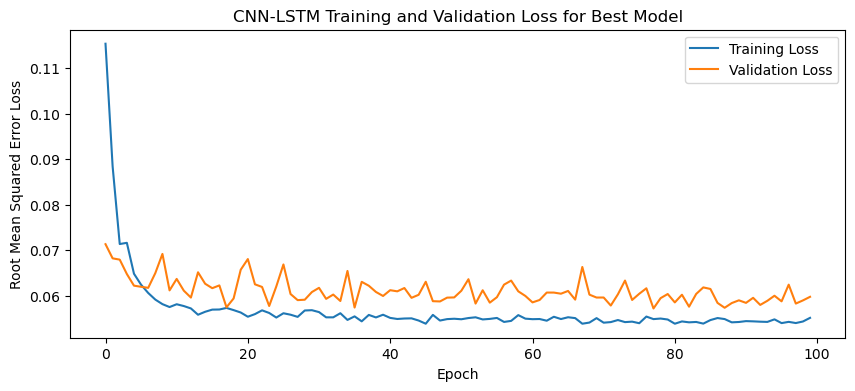

1/1 - 4s - loss: 0.0432 - 4s/epoch - 4s/step
Test Loss: 0.04324109107255936
1/1 [==============================] - 0s 75ms/step


NameError: name 'series' is not defined

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    filters = trial.suggest_categorical('filters', [256, 512, 1024]) # Used for CNN-LSTM model
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM Only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "CNN-LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    #print("Forecasts:")
    #print(forecasts)
    #print("Actual:")
    #print(actual)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    print(np.mean(rmse_list))
    print(np.std(rmse_list))

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = [forecasts[j]]
        
        plot_forecasts(series_ws, forecasts_ws, n_test+2, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    # Plotting the results
    plt.figure(figsize=(15, 6))
    plt.plot(results_df['ws'], results_df['Actual'], label='Actual')
    plt.plot(results_df['ws'], results_df['Predicted'], label='Predicted', alpha=0.7)
    plt.title('CNN-LSTM Model Comparison Temperature Prediction')
    plt.xlabel('Weather Station')
    plt.ylabel('Temperature')
    plt.legend()
    plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('CNN-LSTM Training and Validation Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

    # Plot training & validation accuracy
    #plt.subplot(1, 2, 2)
    #plt.plot(history.history['accuracy'], label='Training Accuracy')
    #plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    #plt.title('Model Accuracy')
    #plt.xlabel('Epoch')
    #plt.ylabel('Accuracy')
    #plt.legend(['Training', 'Validation'])
    #plt.tight_layout()

# Plot model architecture
filename = "cnnlstm_model_optimized.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)

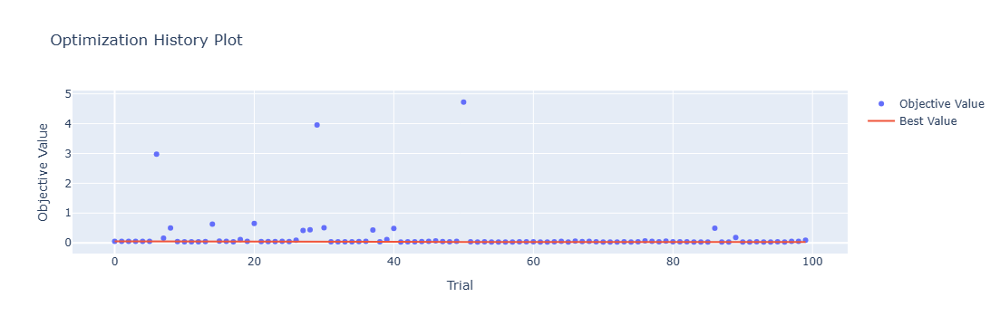

In [4]:
optuna.visualization.plot_optimization_history(study)

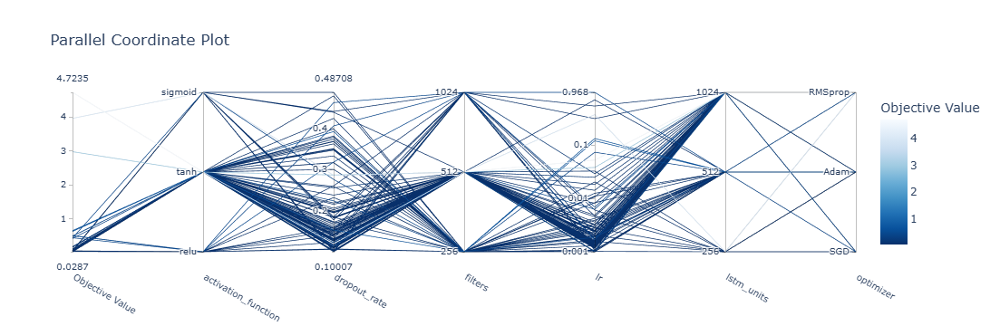

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

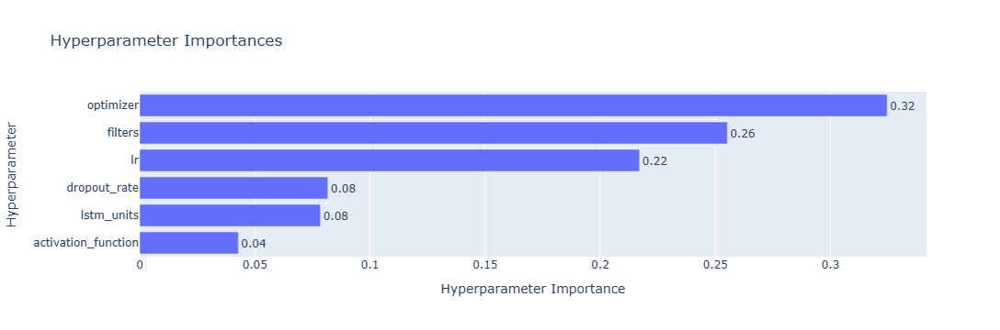

In [6]:
optuna.visualization.plot_param_importances(study)

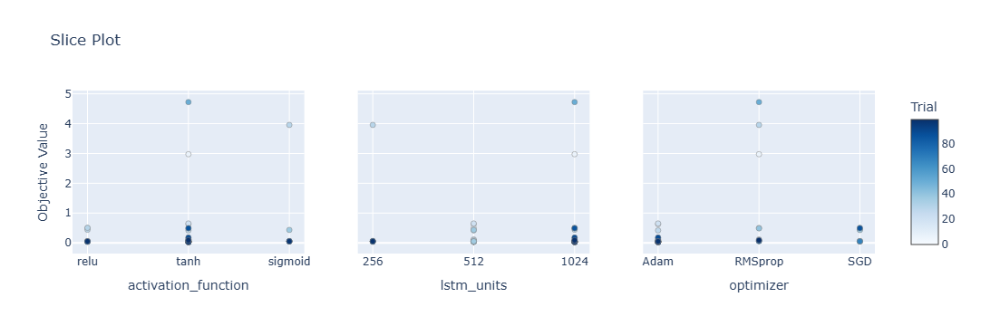

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

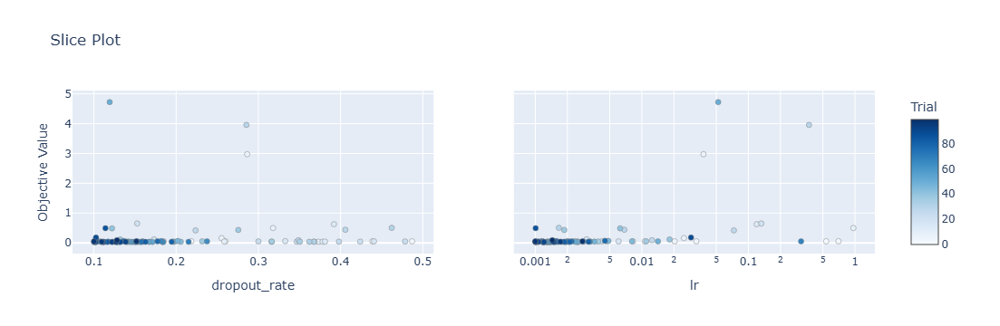

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 12s 86ms/step - loss: 0.1221 - accuracy: 0.2619 - mae: 0.1001 - rmse: 0.1221 - mape: inf - pearson: 0.6410 - val_loss: 0.0986 - val_accuracy: 0.4000 - val_mae: 0.0801 - val_rmse: 0.0986 - val_mape: 16.6771 - val_pearson: 0.7240
Epoch 2/100
84/84 [==============================] - 5s 64ms/step - loss: 0.0805 - accuracy: 0.3333 - mae: 0.0649 - rmse: 0.0805 - mape: inf - pearson: 0.7836 - val_loss: 0.0791 - val_accuracy: 0.0000e+00 - val_mae: 0.0612 - val_rmse: 0.0791 - val_mape: 13.3861 - val_pearson: 0.7275
Epoch 3/100
84/84 [==============================] - 5s 65ms/step - loss: 0.0732 - accuracy: 0.4881 - mae: 0.0591 - rmse: 0.0732 - mape: inf - pearson: 0.8157 - val_loss: 0.0800 - val_accuracy: 0.4000 - val_mae: 0.0627 - val_rmse: 0.0800 - val_mape: 13.4806 - val_pearson: 0.7767
Epoch 4/100
84/84 [==============================] - 5s 64ms/step - loss: 0.0719 - accuracy: 0.4762 - mae: 0.0575 - rmse: 0.0719 - mape: inf - pearson: 0.8

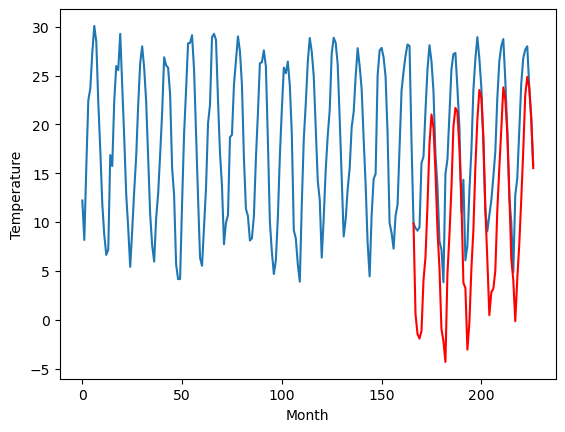

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		-0.42		0.53
-1.85		-2.44		-0.59
-2.23		-2.91		-0.68
-1.48		-2.11		-0.63
4.35		3.07		-1.28
4.84		5.46		0.62
7.61		10.73		3.12
11.36		17.02		5.66
11.84		20.04		8.20
12.47		18.71		6.24
9.49		14.12		4.63
6.86		8.23		1.37
3.44		4.30		0.86
-3.77		-1.93		1.84
-3.11		-3.18		-0.07
-3.20		-5.29		-2.09
1.86		3.74		1.88
3.26		7.71		4.45
7.28		12.47		5.19
10.76		18.78		8.02
11.98		20.71		8.73
12.32		20.28		7.96
10.19		16.55		6.36
7.56		11.34		3.78
2.05		2.81		0.76
1.81		2.27		0.46
-4.87		-4.03		0.84
-2.10		-1.28		0.82
1.76		4.23		2.47
4.73		8.18		3.45
9.04		14.64		5.60
12.73		19.53		6.80
12.87		22.54		9.67
12.32		21.73		9.41
11.30		17.76		6.46
5.70		10.35		4.65
3.01		5.14		2.13
-0.84		-0.50		0.34
-0.05		1.85		1.90
1.05		2.20		1.15
2.64		4.04		1.40
4.79		10.24		5.45
7.97		14.56		6.59
11.05		18.54		7.49
12.88		22.81		9.93
14.47		21.58		7.11
11.09		18.16		7.07
5.98		12.14		6.16
0.74		5.25		4.51
-1.96	

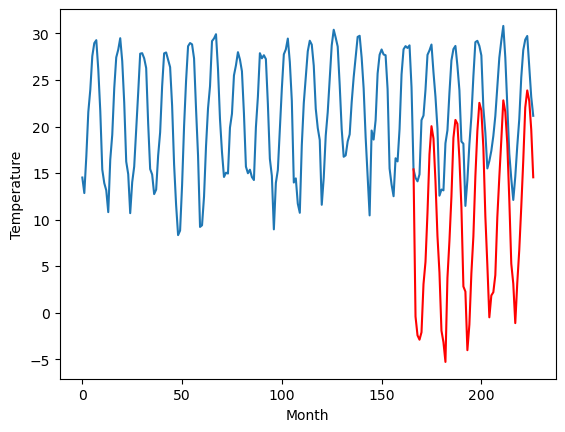

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.10		-1.80		1.30
-3.21		-3.82		-0.61
-3.83		-4.29		-0.46
-3.21		-3.49		-0.28
3.04		1.69		-1.35
2.80		4.08		1.28
6.49		9.35		2.86
10.21		15.64		5.43
12.58		18.66		6.08
11.82		17.33		5.51
8.43		12.74		4.31
4.71		6.85		2.14
-0.22		2.92		3.14
-7.22		-3.31		3.91
-6.40		-4.56		1.84
-5.54		-6.67		-1.13
0.44		2.36		1.92
2.08		6.33		4.25
6.06		11.09		5.03
10.20		17.40		7.20
11.96		19.33		7.37
12.24		18.90		6.66
8.67		15.17		6.50
4.79		9.96		5.17
-3.57		1.43		5.00
-1.39		0.89		2.28
-7.40		-5.41		1.99
-3.45		-2.66		0.79
0.05		2.85		2.80
2.79		6.80		4.01
8.55		13.26		4.71
12.33		18.15		5.82
13.25		21.16		7.91
12.02		20.35		8.33
8.90		16.38		7.48
1.76		8.97		7.21
-0.72		3.76		4.48
-5.24		-1.88		3.36
-3.29		0.47		3.76
-0.51		0.82		1.33
-0.53		2.66		3.19
2.54		8.86		6.32
5.95		13.18		7.23
9.27		17.16		7.89
12.37		21.43		9.06
11.98		20.20		8.22
8.53		16.78		8.25
2.55		10.76		8.21
-2.54		3.87		6.41
-5.57		1

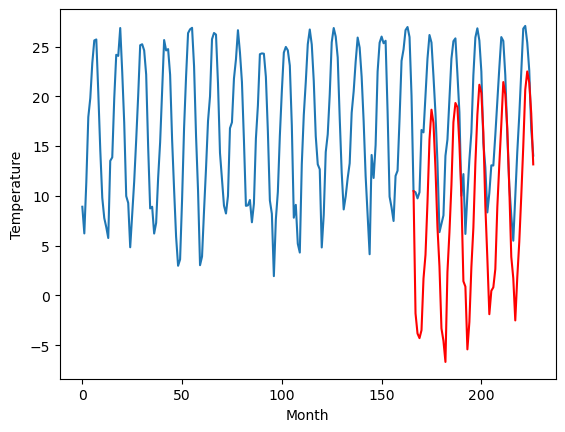

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.49		-3.00		-0.51
-2.51		-5.02		-2.51
-2.47		-5.49		-3.02
-2.47		-4.69		-2.22
4.45		0.49		-3.96
4.53		2.88		-1.65
7.42		8.15		0.73
10.33		14.44		4.11
11.30		17.46		6.16
11.64		16.13		4.49
9.31		11.54		2.23
5.25		5.65		0.40
2.41		1.72		-0.69
-5.05		-4.51		0.54
-4.96		-5.76		-0.80
-6.53		-7.87		-1.34
1.38		1.16		-0.22
3.17		5.13		1.96
7.14		9.89		2.75
10.42		16.20		5.78
11.05		18.13		7.08
11.10		17.70		6.60
8.59		13.97		5.38
6.28		8.76		2.48
-1.81		0.23		2.04
0.96		-0.31		-1.27
-6.39		-6.61		-0.22
-3.95		-3.86		0.09
-0.16		1.65		1.81
4.63		5.60		0.97
9.15		12.06		2.91
11.58		16.95		5.37
11.56		19.96		8.40
10.37		19.15		8.78
9.13		15.18		6.05
3.51		7.77		4.26
-0.60		2.56		3.16
-2.78		-3.08		-0.30
-1.34		-0.73		0.61
-0.93		-0.38		0.55
2.59		1.46		-1.13
4.01		7.66		3.65
8.44		11.98		3.54
12.19		15.96		3.77
13.31		20.23		6.92
14.84		19.00		4.16
11.40		15.58		4.18
5.15		9.56		4.41
-0.71		2.67		3.3

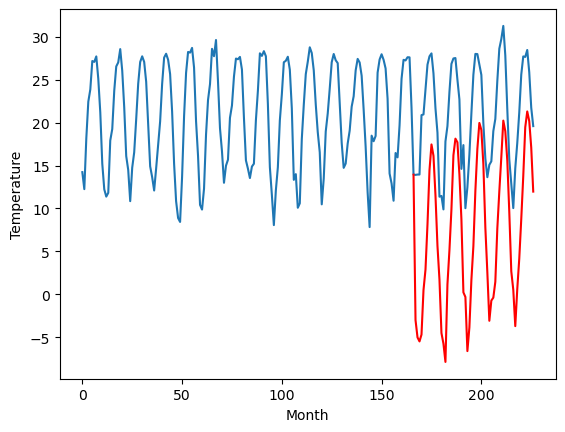

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.32		3.92		-1.40
3.27		1.90		-1.37
4.01		1.43		-2.58
3.34		2.23		-1.11
11.09		7.41		-3.68
11.34		9.80		-1.54
16.32		15.07		-1.25
20.52		21.36		0.84
22.13		24.38		2.25
22.62		23.05		0.43
16.91		18.46		1.55
12.03		12.57		0.54
9.51		8.64		-0.87
3.04		2.41		-0.63
2.16		1.16		-1.00
-0.93		-0.95		-0.02
8.97		8.08		-0.89
10.90		12.05		1.15
14.76		16.81		2.05
19.96		23.12		3.16
20.39		25.05		4.66
21.15		24.62		3.47
19.14		20.89		1.75
14.79		15.68		0.89
7.22		7.15		-0.07
9.55		6.61		-2.94
1.10		0.31		-0.79
0.87		3.06		2.19
7.36		8.57		1.21
13.40		12.52		-0.88
18.11		18.98		0.87
22.45		23.87		1.42
24.81		26.88		2.07
22.45		26.07		3.62
19.50		22.10		2.60
13.58		14.69		1.11
6.65		9.48		2.83
3.92		3.84		-0.08
4.89		6.19		1.30
5.02		6.54		1.52
9.74		8.38		-1.36
11.24		14.58		3.34
16.77		18.90		2.13
21.32		22.88		1.56
24.31		27.15		2.84
26.05		25.92		-0.13
21.57		22.50		0.93
13.91		16.48		2.57
7.55		9.59		

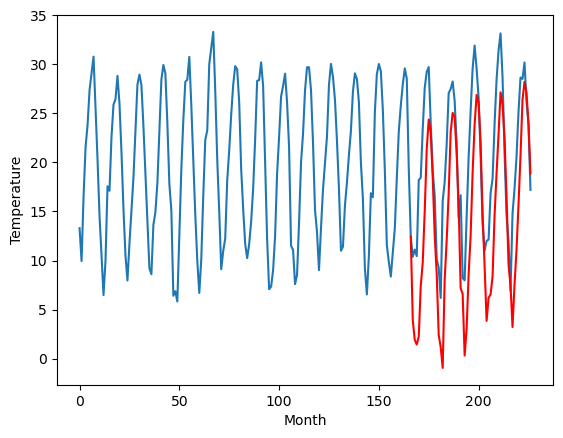

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.85		6.23		0.38
5.28		4.21		-1.07
4.75		3.74		-1.01
4.44		4.54		0.10
8.03		9.72		1.69
10.00		12.11		2.11
13.69		17.38		3.69
18.04		23.67		5.63
21.78		26.69		4.91
20.93		25.36		4.43
17.90		20.77		2.87
13.81		14.88		1.07
9.69		10.95		1.26
2.94		4.72		1.78
1.16		3.47		2.31
1.81		1.36		-0.45
6.71		10.39		3.68
10.08		14.36		4.28
13.59		19.12		5.53
18.16		25.43		7.27
20.15		27.36		7.21
20.63		26.93		6.30
17.62		23.20		5.58
14.02		17.99		3.97
5.85		9.46		3.61
6.90		8.92		2.02
0.52		2.62		2.10
4.13		5.37		1.24
8.05		10.88		2.83
10.92		14.83		3.91
15.55		21.29		5.74
19.12		26.18		7.06
21.26		29.19		7.93
20.41		28.38		7.97
17.76		24.41		6.65
11.20		17.00		5.80
9.51		11.79		2.28
2.99		6.15		3.16
4.68		8.50		3.82
6.17		8.85		2.68
7.08		10.69		3.61
11.76		16.89		5.13
13.28		21.21		7.93
17.10		25.19		8.09
20.93		29.46		8.53
20.45		28.23		7.78
16.93		24.81		7.88
12.58		18.79		6.21
7.14		11.90		4.76
5.00		9

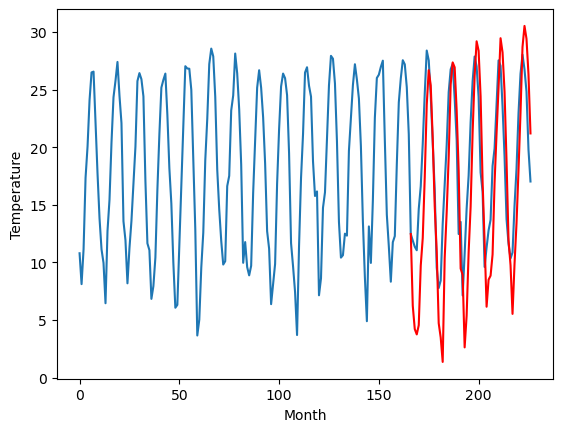

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.20		0.62		1.82
-1.56		-1.40		0.16
-2.03		-1.87		0.16
-0.92		-1.07		-0.15
4.50		4.11		-0.39
5.74		6.50		0.76
8.08		11.77		3.69
13.33		18.06		4.73
16.40		21.08		4.68
15.37		19.75		4.38
11.48		15.16		3.68
7.48		9.27		1.79
3.30		5.34		2.04
-3.63		-0.89		2.74
-4.21		-2.14		2.07
-3.57		-4.25		-0.68
3.41		4.78		1.37
4.44		8.75		4.31
8.15		13.51		5.36
12.48		19.82		7.34
14.10		21.75		7.65
14.04		21.32		7.28
9.99		17.59		7.60
6.76		12.38		5.62
-1.89		3.85		5.74
0.05		3.31		3.26
-6.60		-2.99		3.61
-2.62		-0.24		2.38
1.72		5.27		3.55
4.64		9.22		4.58
9.71		15.68		5.97
13.62		20.57		6.95
14.72		23.58		8.86
13.43		22.77		9.34
10.37		18.80		8.43
3.43		11.39		7.96
1.20		6.18		4.98
-5.31		0.54		5.85
-2.12		2.89		5.01
0.88		3.24		2.36
1.36		5.08		3.72
4.92		11.28		6.36
7.61		15.60		7.99
10.96		19.58		8.62
14.67		23.85		9.18
13.98		22.62		8.64
10.47		19.20		8.73
5.26		13.18		7.92
-0.61		6.29		6.90
-2.90		4.

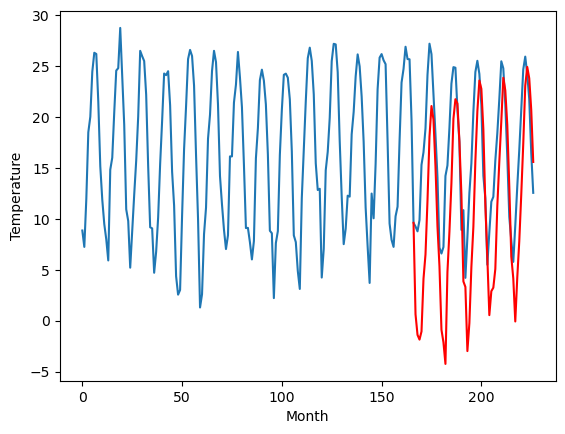

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.01		5.94		1.93
3.64		3.92		0.28
3.52		3.45		-0.07
4.56		4.25		-0.31
10.14		9.43		-0.71
11.04		11.82		0.78
14.16		17.09		2.93
19.68		23.38		3.70
22.94		26.40		3.46
21.57		25.07		3.50
16.70		20.48		3.78
12.86		14.59		1.73
8.63		10.66		2.03
1.70		4.43		2.73
0.76		3.18		2.42
1.38		1.07		-0.31
7.90		10.10		2.20
11.53		14.07		2.54
14.55		18.83		4.28
19.34		25.14		5.80
21.46		27.07		5.61
21.41		26.64		5.23
16.90		22.91		6.01
13.05		17.70		4.65
3.55		9.17		5.62
5.61		8.63		3.02
-1.57		2.33		3.90
2.67		5.08		2.41
7.51		10.59		3.08
10.83		14.54		3.71
15.81		21.00		5.19
19.81		25.89		6.08
21.68		28.90		7.22
20.00		28.09		8.09
16.30		24.12		7.82
9.11		16.71		7.60
6.91		11.50		4.59
-0.26		5.86		6.12
2.91		8.21		5.30
5.88		8.56		2.68
6.56		10.40		3.84
11.18		16.60		5.42
13.47		20.92		7.45
17.22		24.90		7.68
21.36		29.17		7.81
20.22		27.94		7.72
16.46		24.52		8.06
11.07		18.50		7.43
4.62		11.61		6.99
3.03

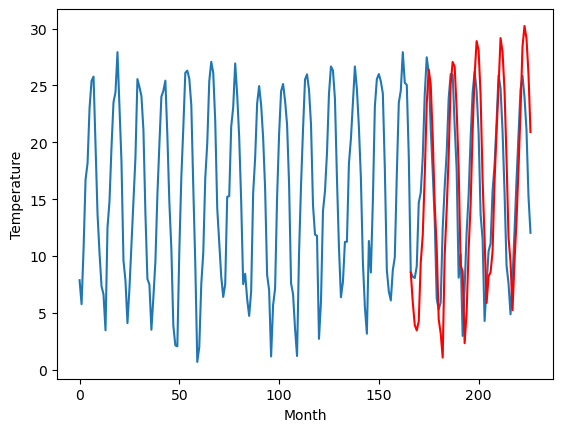

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.48		5.01		0.53
4.32		2.99		-1.33
3.13		2.52		-0.61
3.63		3.32		-0.31
10.20		8.50		-1.70
12.48		10.89		-1.59
17.36		16.16		-1.20
23.29		22.45		-0.84
26.03		25.47		-0.56
23.02		24.14		1.12
19.46		19.55		0.09
12.20		13.66		1.46
9.34		9.73		0.39
2.63		3.50		0.87
1.84		2.25		0.41
-2.43		0.14		2.57
10.04		9.17		-0.87
12.64		13.14		0.50
17.33		17.90		0.57
23.52		24.21		0.69
24.09		26.14		2.05
24.03		25.71		1.68
20.29		21.98		1.69
16.33		16.77		0.44
6.29		8.24		1.95
8.09		7.70		-0.39
-0.42		1.40		1.82
1.62		4.15		2.53
8.84		9.66		0.82
12.79		13.61		0.82
19.63		20.07		0.44
24.15		24.96		0.81
26.48		27.97		1.49
23.60		27.16		3.56
19.96		23.19		3.23
13.40		15.78		2.38
7.43		10.57		3.14
2.14		4.93		2.79
4.70		7.28		2.58
6.31		7.62		1.31
8.13		9.47		1.34
13.91		15.67		1.76
19.50		19.99		0.49
23.37		23.97		0.60
24.86		28.24		3.38
23.60		27.01		3.41
20.43		23.59		3.16
14.83		17.57		2.74
7.84		10.68		2.84


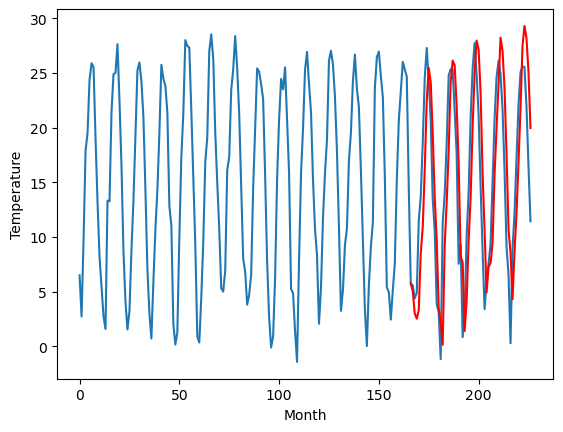

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.26		2.50		2.76
-0.08		0.48		0.56
-1.36		0.01		1.37
-2.23		0.81		3.04
4.96		5.99		1.03
6.62		8.38		1.76
11.71		13.65		1.94
18.69		19.94		1.25
21.32		22.96		1.64
18.94		21.63		2.69
15.27		17.04		1.77
8.88		11.15		2.27
5.20		7.22		2.02
-2.31		0.99		3.30
-3.90		-0.26		3.64
-6.07		-2.37		3.70
4.68		6.66		1.98
7.74		10.63		2.89
12.21		15.39		3.18
18.69		21.70		3.01
19.70		23.63		3.93
20.30		23.20		2.90
16.44		19.47		3.03
11.97		14.26		2.29
1.31		5.73		4.42
2.54		5.19		2.65
-6.43		-1.11		5.32
-2.85		1.64		4.49
4.13		7.15		3.02
6.86		11.10		4.24
15.03		17.56		2.53
18.93		22.45		3.52
20.96		25.46		4.50
19.05		24.65		5.60
15.32		20.68		5.36
8.28		13.27		4.99
3.26		8.06		4.80
-2.45		2.42		4.87
-0.56		4.77		5.33
1.48		5.11		3.63
1.82		6.96		5.14
8.10		13.16		5.06
13.06		17.48		4.42
16.90		21.46		4.56
19.73		25.73		6.00
18.93		24.50		5.57
16.32		21.08		4.76
9.74		15.06		5.32
3.24		8.17		4.93
0.81		6.0

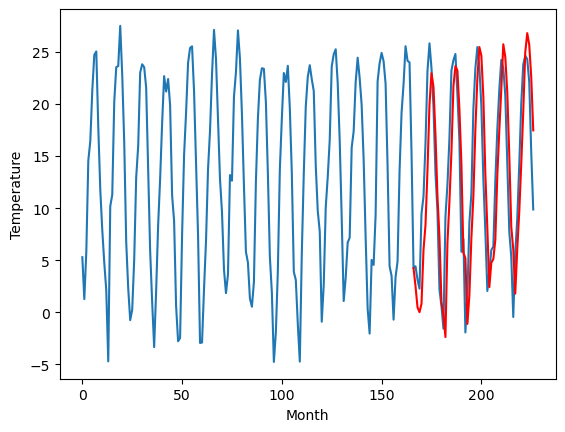

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.50		0.56		2.06
-2.17		-1.46		0.71
-3.20		-1.93		1.27
-4.66		-1.13		3.53
1.48		4.05		2.57
4.13		6.44		2.31
10.56		11.71		1.15
18.52		18.00		-0.52
21.68		21.02		-0.66
18.99		19.69		0.70
14.16		15.10		0.94
7.41		9.21		1.80
3.93		5.28		1.35
-3.10		-0.95		2.15
-4.71		-2.20		2.51
-9.02		-4.31		4.71
2.71		4.72		2.01
6.68		8.69		2.01
11.83		13.45		1.62
19.14		19.76		0.62
19.73		21.69		1.96
20.44		21.26		0.82
16.39		17.53		1.14
12.04		12.32		0.28
1.18		3.79		2.61
0.28		3.25		2.97
-8.67		-3.05		5.62
-5.43		-0.30		5.13
1.48		5.21		3.73
5.09		9.16		4.07
14.41		15.62		1.21
19.17		20.51		1.34
20.28		23.52		3.24
19.16		22.71		3.55
15.32		18.74		3.42
8.08		11.33		3.25
3.05		6.12		3.07
-3.13		0.48		3.61
-2.00		2.83		4.83
-1.59		3.17		4.76
0.27		5.02		4.75
7.12		11.22		4.10
12.14		15.54		3.40
17.65		19.52		1.87
20.11		23.79		3.68
18.30		22.56		4.26
15.92		19.14		3.22
9.96		13.12		3.16
2.32		6.23		3.91
1.64

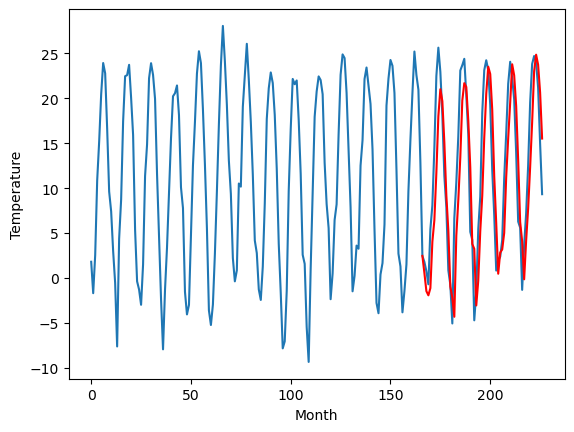

RangeIndex(start=1, stop=12, step=1)
[0.5800000000000001, -0.9500000000000002, -3.0999999999999996, -2.490000000000002, 5.320000000000001, 5.850000000000001, -1.200000000000001, 4.010000000000003, 4.48, -0.2599999999999998, -1.5000000000000018]
[0.5619016647338864, -0.41809642791748036, -1.798098335266113, -2.9980983352661132, 3.9218997573852548, 6.231901664733886, 0.6219016647338869, 5.941900711059571, 5.011892127990723, 2.501893081665038, 0.5618883132934567]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.58   0.561902
1                 1   -0.95  -0.418096
2                 2   -3.10  -1.798098
3                 3   -2.49  -2.998098
4                 4    5.32   3.921900
5                 5    5.85   6.231902
6                 6   -1.20   0.621902
7                 7    4.01   5.941901
8                 8    4.48   5.011892
9                 9   -0.26   2.501893
10               10   -1.50   0.561888


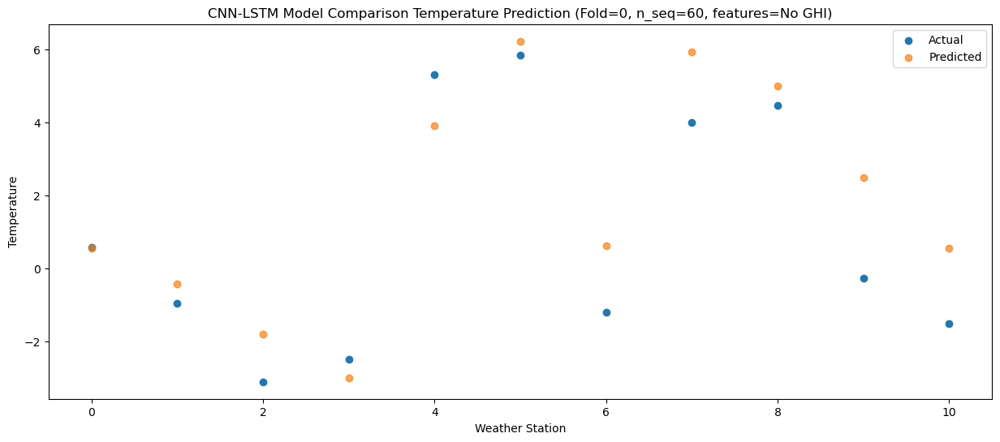

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.11  -1.461737
1                 1   -1.85  -2.441713
2                 2   -3.21  -3.821719
3                 3   -2.51  -5.021723
4                 4    3.27   1.898265
5                 5    5.28   4.208285
6                 6   -1.56  -1.401721
7                 7    3.64   3.918276
8                 8    4.32   2.988224
9                 9   -0.08   0.478235
10               10   -2.17  -1.461793


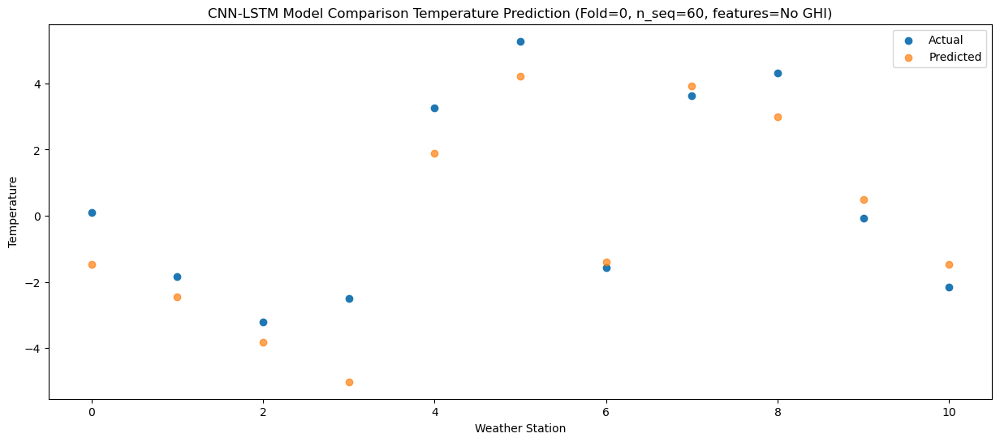

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.16  -1.925990
1                 1   -2.23  -2.905990
2                 2   -3.83  -4.285986
3                 3   -2.47  -5.485988
4                 4    4.01   1.434012
5                 5    4.75   3.744012
6                 6   -2.03  -1.865990
7                 7    3.52   3.454009
8                 8    3.13   2.524001
9                 9   -1.36   0.014004
10               10   -3.20  -1.926005


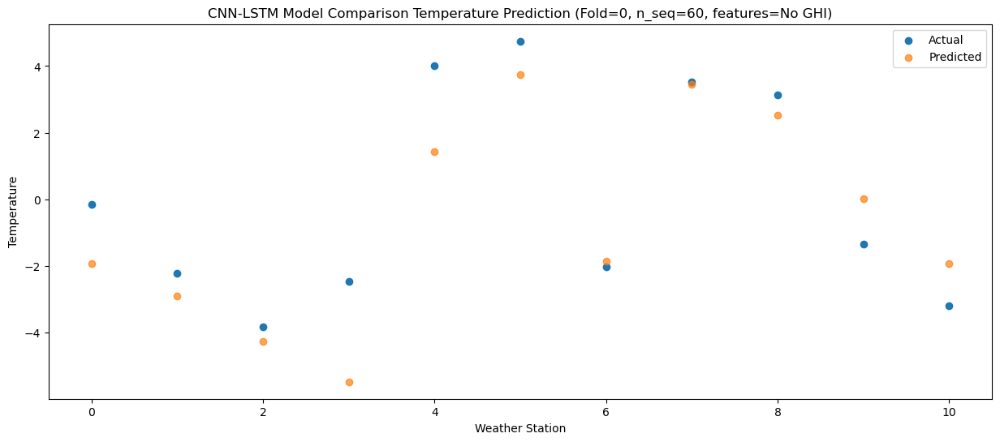

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.19  -1.127659
1                 1   -1.48  -2.107630
2                 2   -3.21  -3.487632
3                 3   -2.47  -4.687635
4                 4    3.34   2.232343
5                 5    4.44   4.542371
6                 6   -0.92  -1.067635
7                 7    4.56   4.252364
8                 8    3.63   3.322296
9                 9   -2.23   0.812311
10               10   -4.66  -1.127717


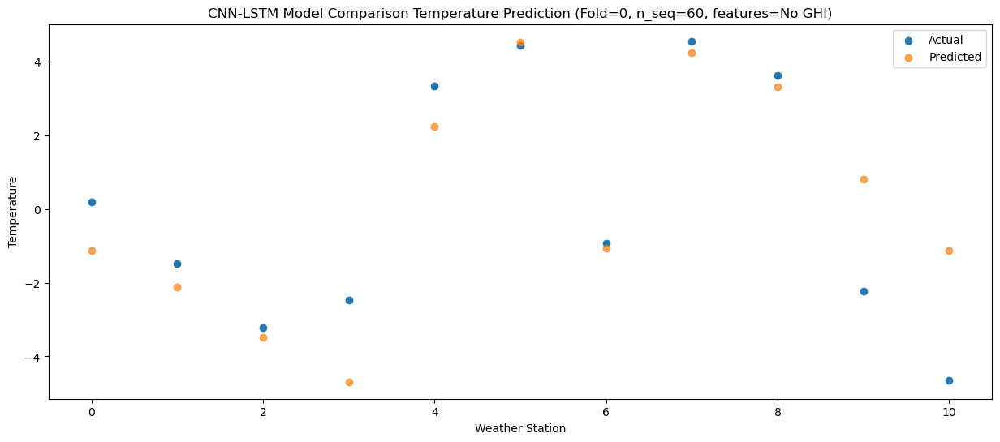

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.77   4.048241
1                 1    4.35   3.068263
2                 2    3.04   1.688265
3                 3    4.45   0.488261
4                 4   11.09   7.408242
5                 5    8.03   9.718267
6                 6    4.50   4.108261
7                 7   10.14   9.428258
8                 8   10.20   8.498202
9                 9    4.96   5.988217
10               10    1.48   4.048189


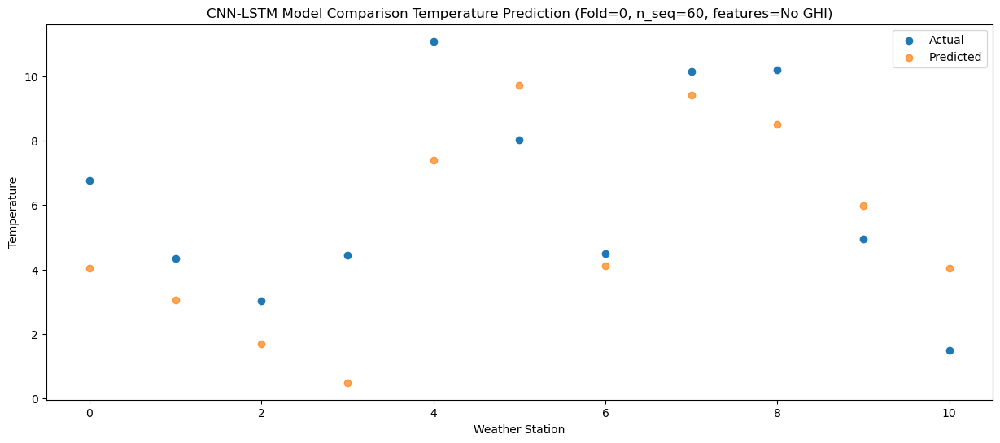

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    7.42   6.441034
1                 1    4.84   5.461081
2                 2    2.80   4.081073
3                 3    4.53   2.881069
4                 4   11.34   9.801032
5                 5   10.00  12.111083
6                 6    5.74   6.501071
7                 7   11.04  11.821066
8                 8   12.48  10.890963
9                 9    6.62   8.380990
10               10    4.13   6.440940


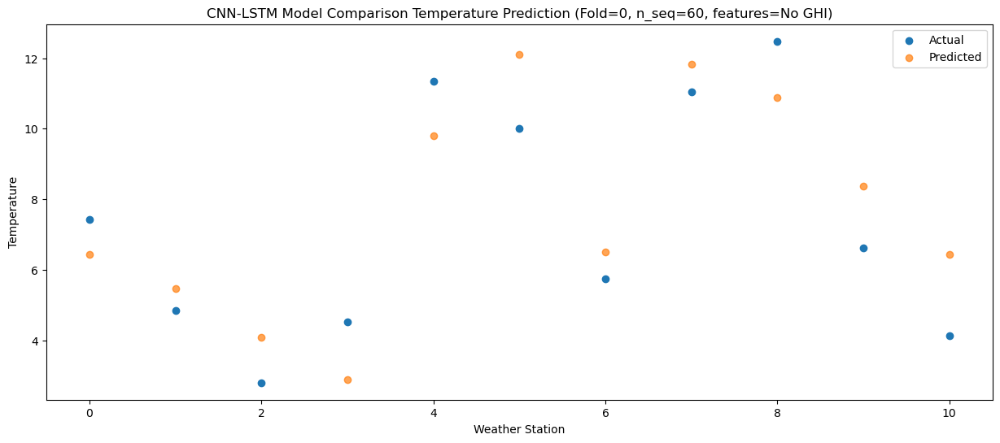

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.15  11.710972
1                 1    7.61  10.731011
2                 2    6.49   9.351007
3                 3    7.42   8.151002
4                 4   16.32  15.070970
5                 5   13.69  17.381013
6                 6    8.08  11.771005
7                 7   14.16  17.091001
8                 8   17.36  16.160917
9                 9   11.71  13.650938
10               10   10.56  11.710902


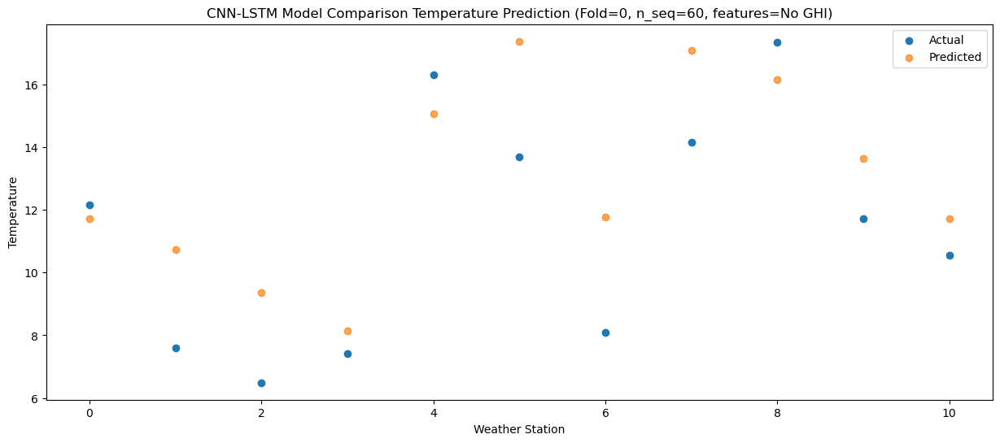

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   16.37  18.004056
1                 1   11.36  17.024142
2                 2   10.21  15.644127
3                 3   10.33  14.444115
4                 4   20.52  21.364058
5                 5   18.04  23.674143
6                 6   13.33  18.064125
7                 7   19.68  23.384112
8                 8   23.29  22.453948
9                 9   18.69  19.943985
10               10   18.52  18.003915


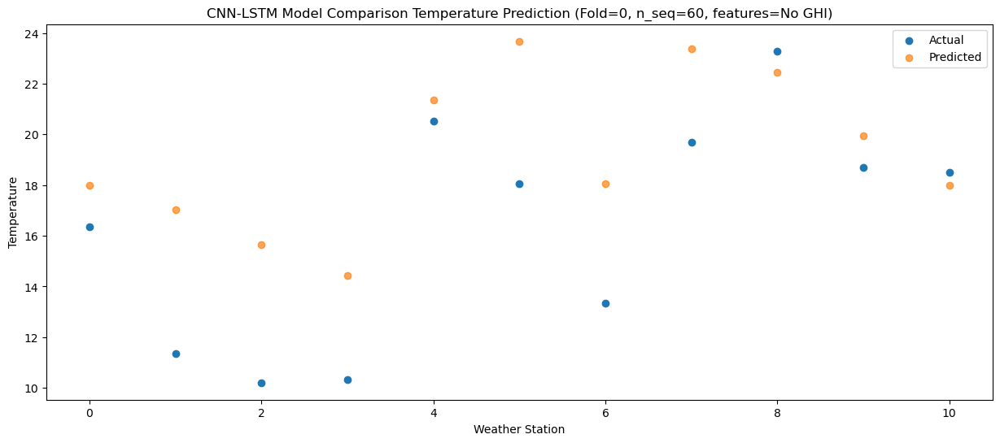

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.82  21.015845
1                 1   11.84  20.035931
2                 2   12.58  18.655920
3                 3   11.30  17.455906
4                 4   22.13  24.375847
5                 5   21.78  26.685934
6                 6   16.40  21.075916
7                 7   22.94  26.395901
8                 8   26.03  25.465741
9                 9   21.32  22.955780
10               10   21.68  21.015712


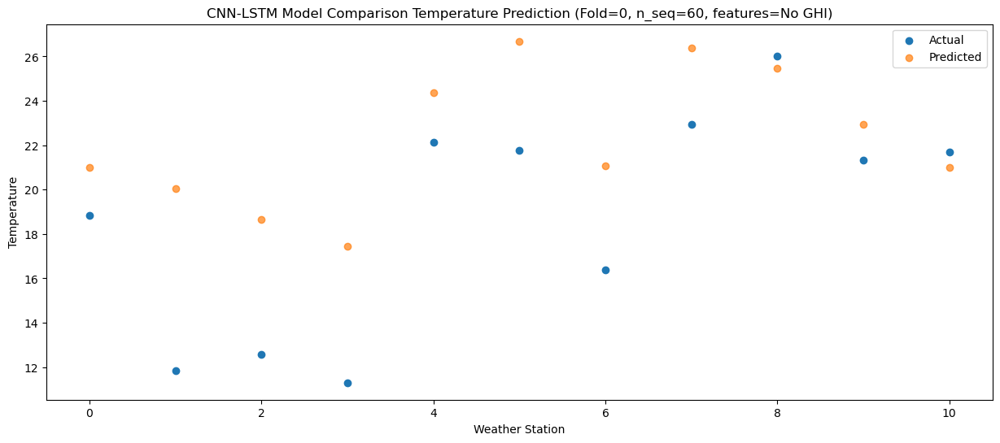

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.19  19.693173
1                 1   12.47  18.713238
2                 2   11.82  17.333236
3                 3   11.64  16.133223
4                 4   22.62  23.053176
5                 5   20.93  25.363247
6                 6   15.37  19.753231
7                 7   21.57  25.073220
8                 8   23.02  24.143085
9                 9   18.94  21.633120
10               10   18.99  19.693066


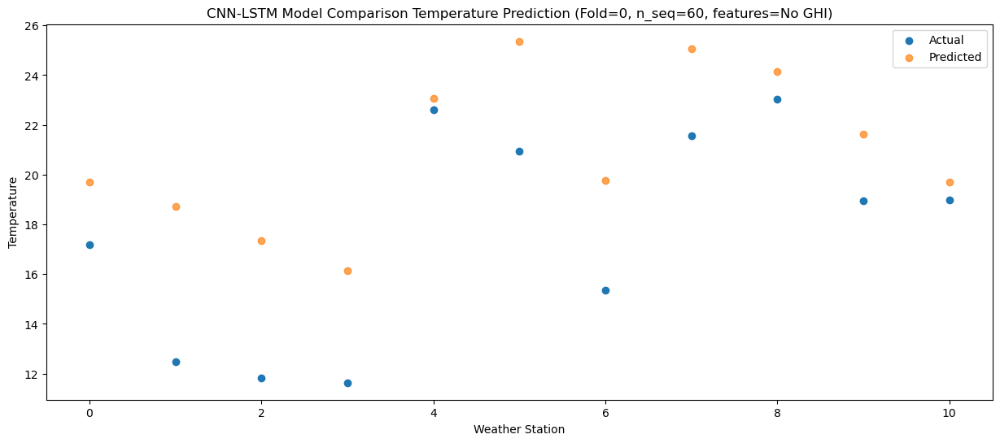

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.13  15.099170
1                 1    9.49  14.119233
2                 2    8.43  12.739231
3                 3    9.31  11.539219
4                 4   16.91  18.459171
5                 5   17.90  20.769242
6                 6   11.48  15.159225
7                 7   16.70  20.479217
8                 8   19.46  19.549083
9                 9   15.27  17.039119
10               10   14.16  15.099064


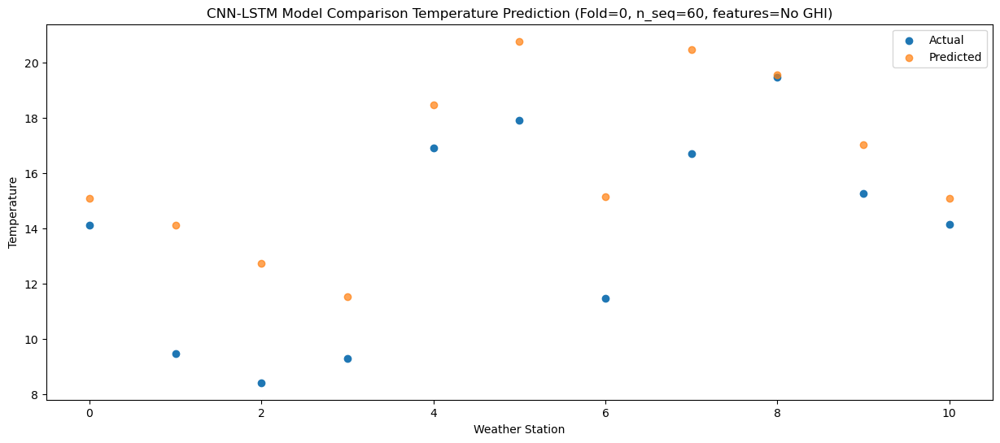

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   9.209370
1                 1    6.86   8.229460
2                 2    4.71   6.849448
3                 3    5.25   5.649437
4                 4   12.03  12.569373
5                 5   13.81  14.879465
6                 6    7.48   9.269443
7                 7   12.86  14.589435
8                 8   12.20  13.659255
9                 9    8.88  11.149301
10               10    7.41   9.209225


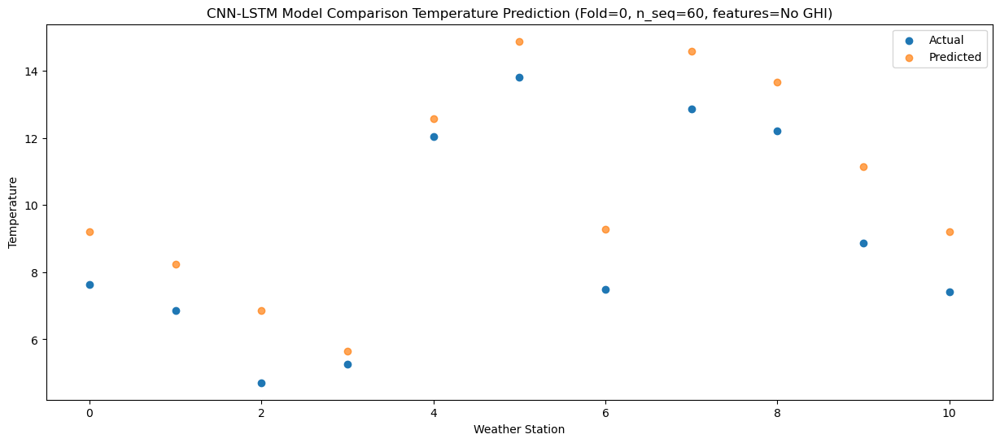

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.39   5.282186
1                 1    3.44   4.302301
2                 2   -0.22   2.922278
3                 3    2.41   1.722268
4                 4    9.51   8.642190
5                 5    9.69  10.952305
6                 6    3.30   5.342272
7                 7    8.63  10.662264
8                 8    9.34   9.732038
9                 9    5.20   7.222092
10               10    3.93   5.281993


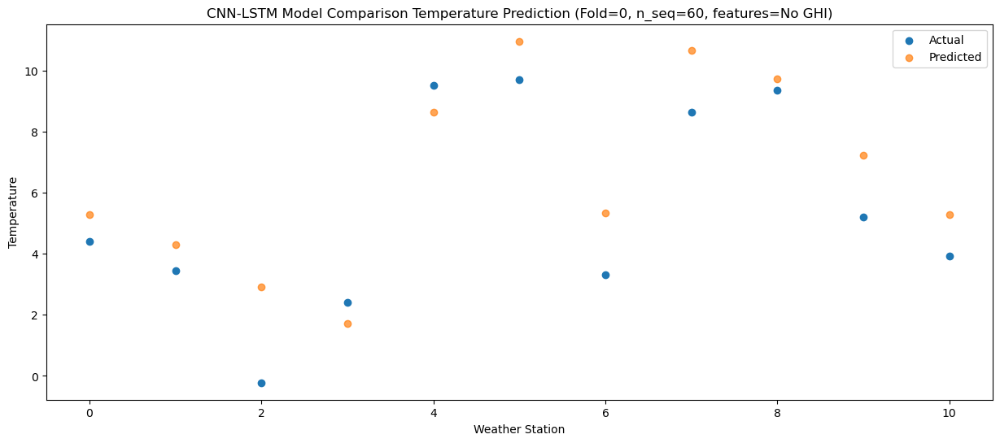

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.23  -0.950924
1                 1   -3.77  -1.930800
2                 2   -7.22  -3.310826
3                 3   -5.05  -4.510836
4                 4    3.04   2.409080
5                 5    2.94   4.719203
6                 6   -3.63  -0.890830
7                 7    1.70   4.429161
8                 8    2.63   3.498923
9                 9   -2.31   0.988980
10               10   -3.10  -0.951122


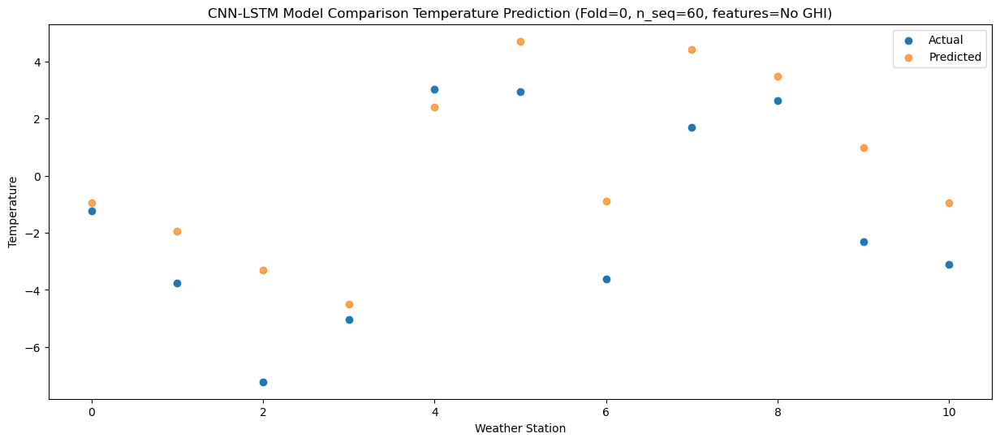

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.09  -2.195320
1                 1   -3.11  -3.175186
2                 2   -6.40  -4.555210
3                 3   -4.96  -5.755222
4                 4    2.16   1.164684
5                 5    1.16   3.474819
6                 6   -4.21  -2.135214
7                 7    0.76   3.184769
8                 8    1.84   2.254516
9                 9   -3.90  -0.255423
10               10   -4.71  -2.195531


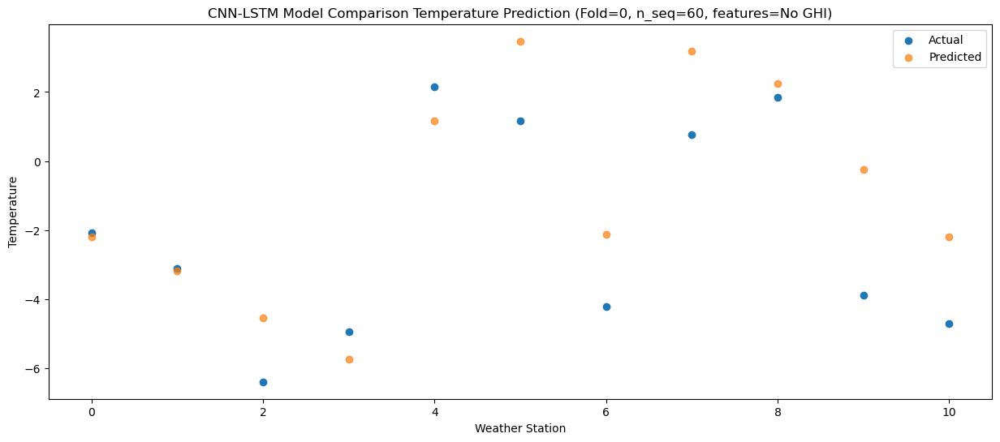

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -5.44  -4.314607
1                 1   -3.20  -5.294428
2                 2   -5.54  -6.674462
3                 3   -6.53  -7.874477
4                 4   -0.93  -0.954599
5                 5    1.81   1.355571
6                 6   -3.57  -4.254466
7                 7    1.38   1.065511
8                 8   -2.43   0.135177
9                 9   -6.07  -2.374750
10               10   -9.02  -4.314893


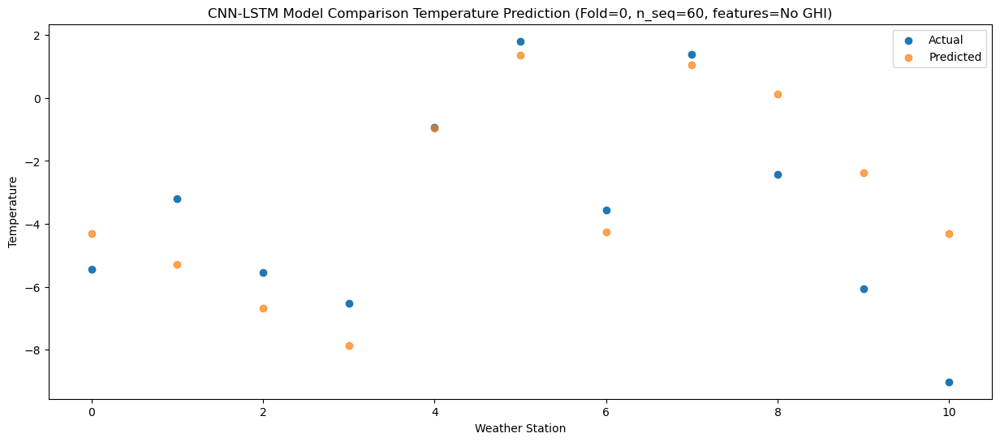

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.63   4.717353
1                 1    1.86   3.737548
2                 2    0.44   2.357511
3                 3    1.38   1.157491
4                 4    8.97   8.077362
5                 5    6.71  10.387548
6                 6    3.41   4.777507
7                 7    7.90  10.097479
8                 8   10.04   9.167110
9                 9    4.68   6.657191
10               10    2.71   4.717032


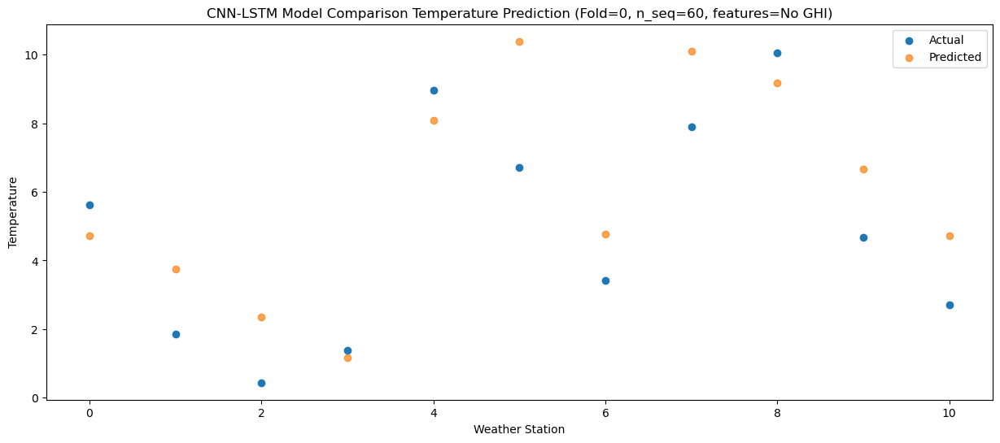

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.16   8.690558
1                 1    3.26   7.710765
2                 2    2.08   6.330720
3                 3    3.17   5.130703
4                 4   10.90  12.050566
5                 5   10.08  14.360761
6                 6    4.44   8.750715
7                 7   11.53  14.070688
8                 8   12.64  13.140297
9                 9    7.74  10.630380
10               10    6.68   8.690209


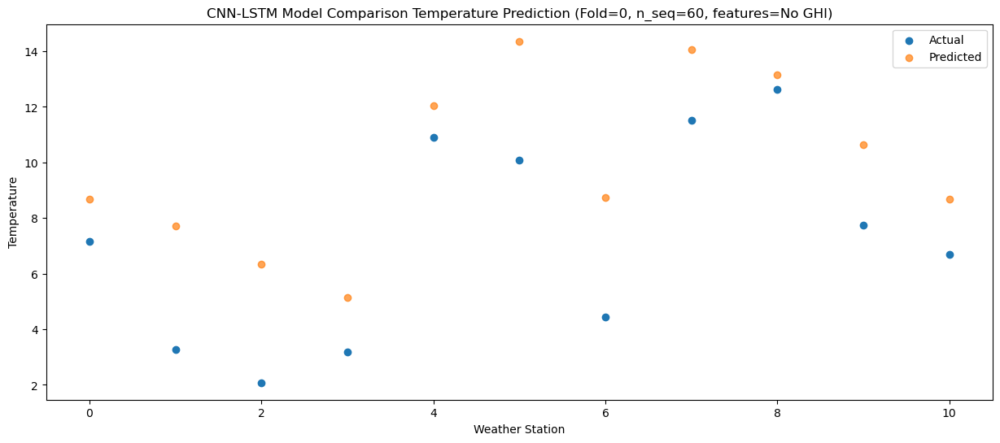

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   11.66  13.454368
1                 1    7.28  12.474534
2                 2    6.06  11.094500
3                 3    7.14   9.894480
4                 4   14.76  16.814376
5                 5   13.59  19.124534
6                 6    8.15  13.514494
7                 7   14.55  18.834475
8                 8   17.33  17.904158
9                 9   12.21  15.394228
10               10   11.83  13.454092


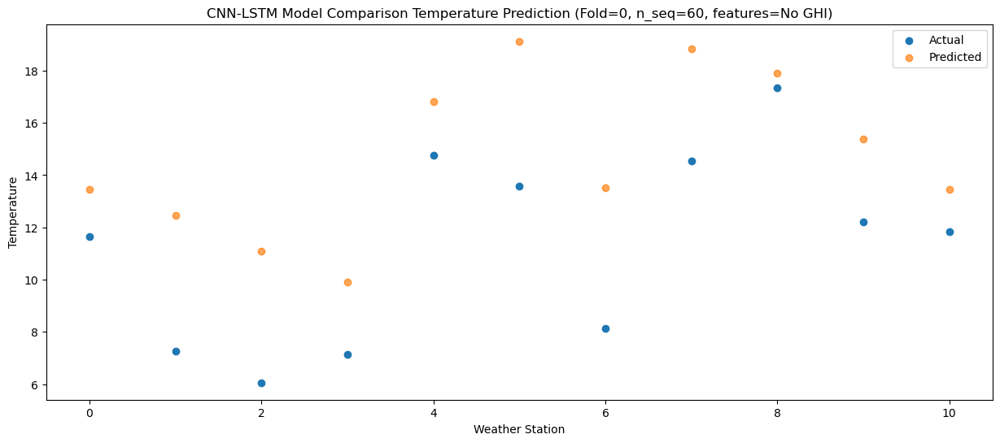

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.33  19.762033
1                 1   10.76  18.782189
2                 2   10.20  17.402161
3                 3   10.42  16.202141
4                 4   19.96  23.122045
5                 5   18.16  25.432193
6                 6   12.48  19.822155
7                 7   19.34  25.142136
8                 8   23.52  24.211831
9                 9   18.69  21.701901
10               10   19.14  19.761773


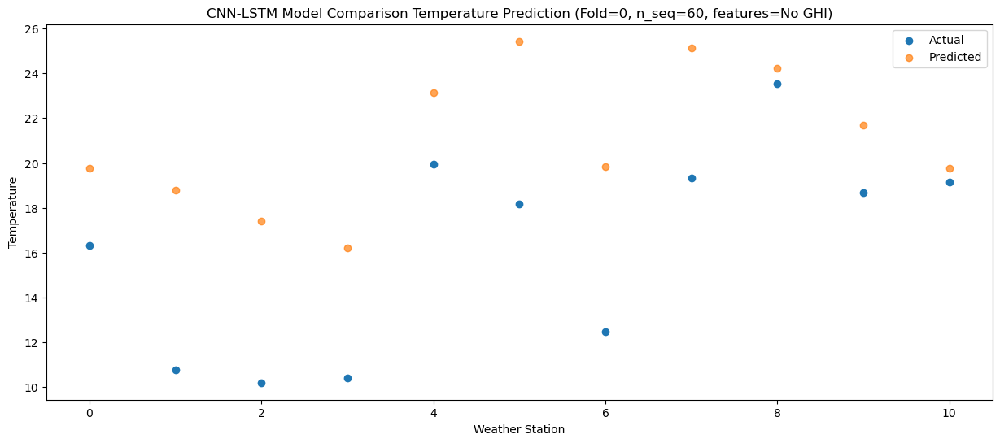

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.92  21.689697
1                 1   11.98  20.709867
2                 2   11.96  19.329836
3                 3   11.05  18.129815
4                 4   20.39  25.049710
5                 5   20.15  27.359873
6                 6   14.10  21.749827
7                 7   21.46  27.069808
8                 8   24.09  26.139476
9                 9   19.70  23.629547
10               10   19.73  21.689405


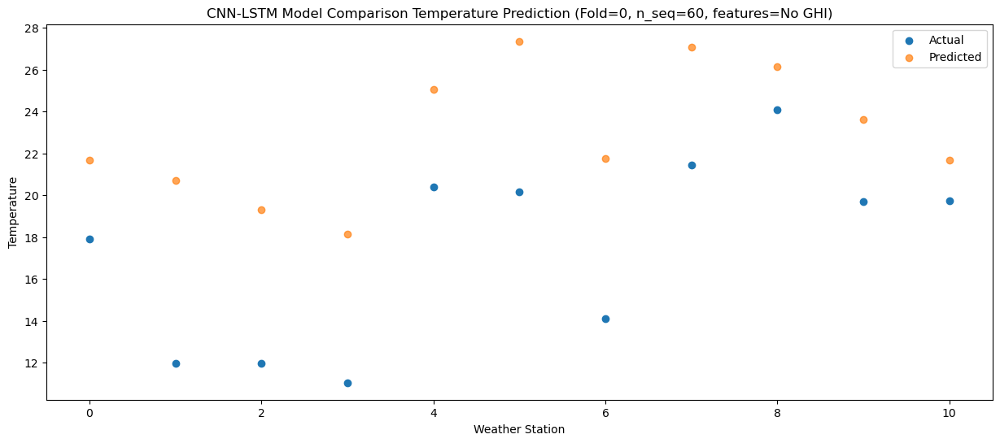

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.03  21.264121
1                 1   12.32  20.284305
2                 2   12.24  18.904267
3                 3   11.10  17.704249
4                 4   21.15  24.624133
5                 5   20.63  26.934306
6                 6   14.04  21.324259
7                 7   21.41  26.644241
8                 8   24.03  25.713886
9                 9   20.30  23.203961
10               10   20.44  21.263806


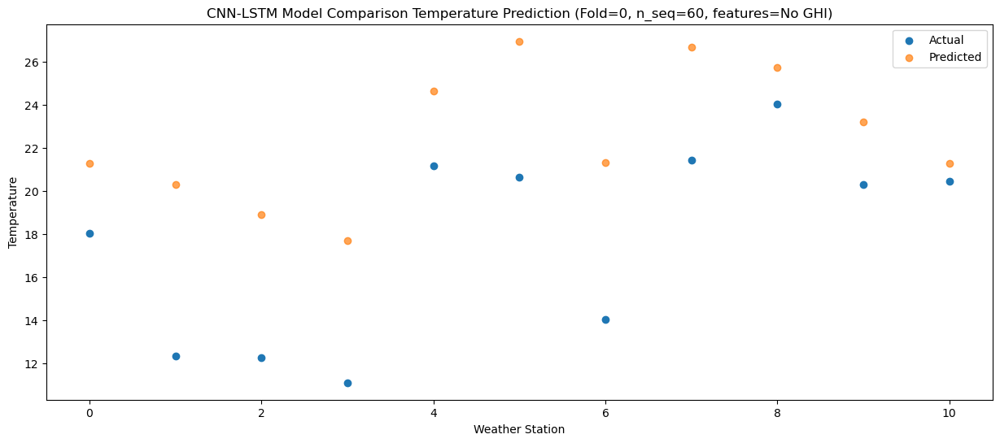

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.45  17.526480
1                 1   10.19  16.546579
2                 2    8.67  15.166560
3                 3    8.59  13.966549
4                 4   19.14  20.886487
5                 5   17.62  23.196588
6                 6    9.99  17.586552
7                 7   16.90  22.906544
8                 8   20.29  21.976341
9                 9   16.44  19.466390
10               10   16.39  17.526298


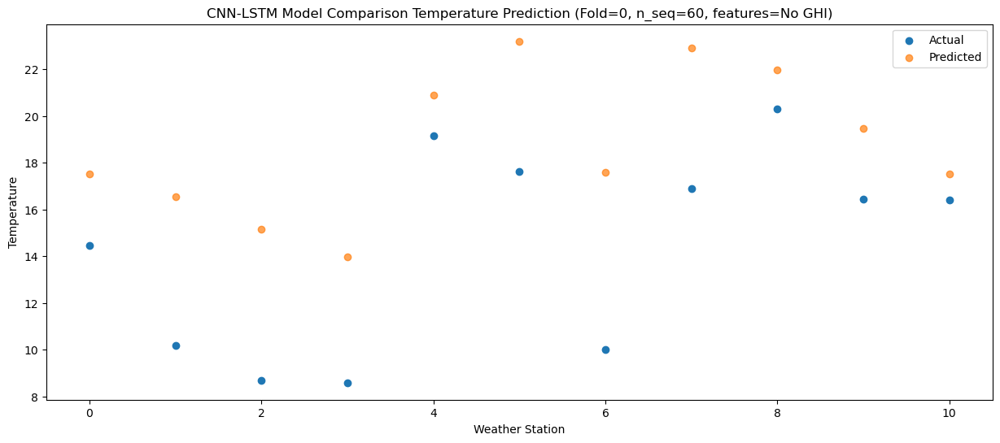

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.43  12.320607
1                 1    7.56  11.340708
2                 2    4.79   9.960688
3                 3    6.28   8.760679
4                 4   14.79  15.680617
5                 5   14.02  17.990717
6                 6    6.76  12.380681
7                 7   13.05  17.700670
8                 8   16.33  16.770468
9                 9   11.97  14.260519
10               10   12.04  12.320420


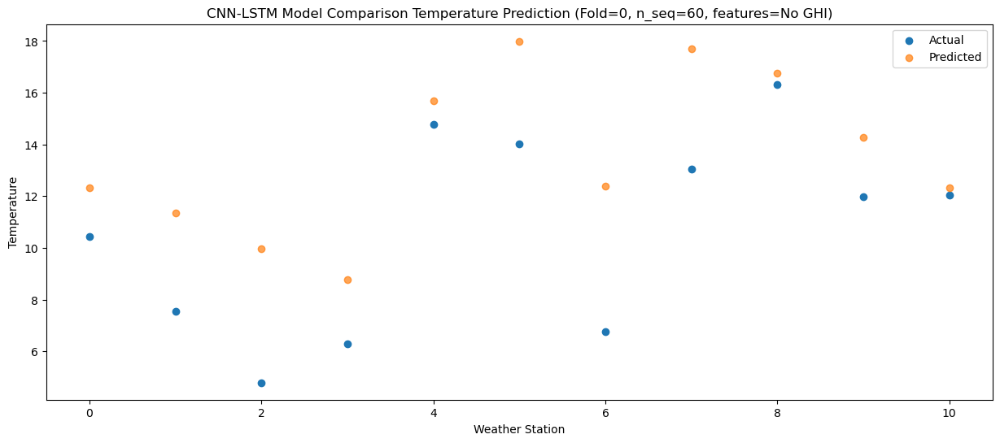

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.67   3.788429
1                 1    2.05   2.808588
2                 2   -3.57   1.428554
3                 3   -1.81   0.228542
4                 4    7.22   7.148445
5                 5    5.85   9.458592
6                 6   -1.89   3.848546
7                 7    3.55   9.168530
8                 8    6.29   8.238226
9                 9    1.31   5.728293
10               10    1.18   3.788148


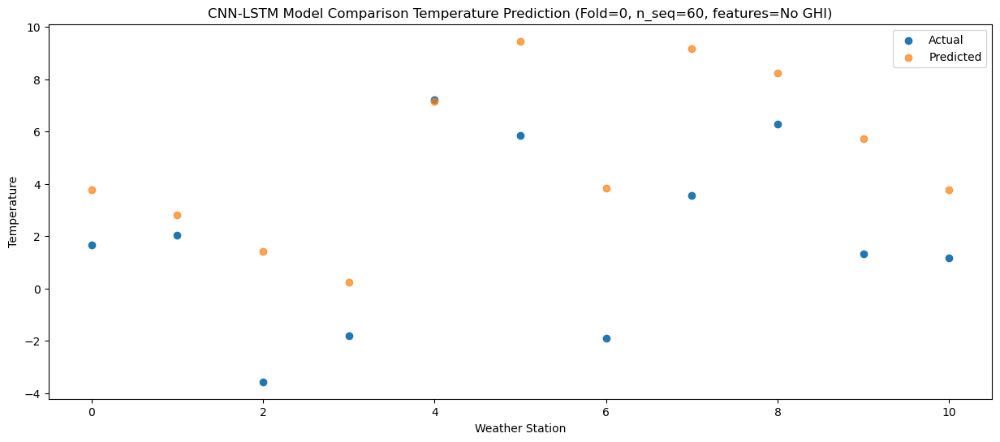

84/84 [==============================] - 9s 109ms/step - loss: 0.0559 - accuracy: 0.5000 - mae: 0.0440 - rmse: 0.0559 - mape: inf - pearson: 0.8532 - val_loss: 0.0548 - val_accuracy: 0.6000 - val_mae: 0.0436 - val_rmse: 0.0548 - val_mape: 9.7232 - val_pearson: 0.8716
Epoch 19/100
84/84 [==============================] - 10s 120ms/step - loss: 0.0562 - accuracy: 0.6071 - mae: 0.0445 - rmse: 0.0562 - mape: inf - pearson: 0.8570 - val_loss: 0.0553 - val_accuracy: 0.6000 - val_mae: 0.0443 - val_rmse: 0.0553 - val_mape: 10.0953 - val_pearson: 0.8719
Epoch 20/100
84/84 [==============================] - 9s 108ms/step - loss: 0.0556 - accuracy: 0.6071 - mae: 0.0441 - rmse: 0.0556 - mape: inf - pearson: 0.8553 - val_loss: 0.0544 - val_accuracy: 0.6000 - val_mae: 0.0438 - val_rmse: 0.0544 - val_mape: 9.7553 - val_pearson: 0.8729
Epoch 21/100
84/84 [==============================] - 9s 106ms/step - loss: 0.0562 - accuracy: 0.5595 - mae: 0.0443 - rmse: 0.0562 - mape: inf - pearson: 0.8517 - val_l

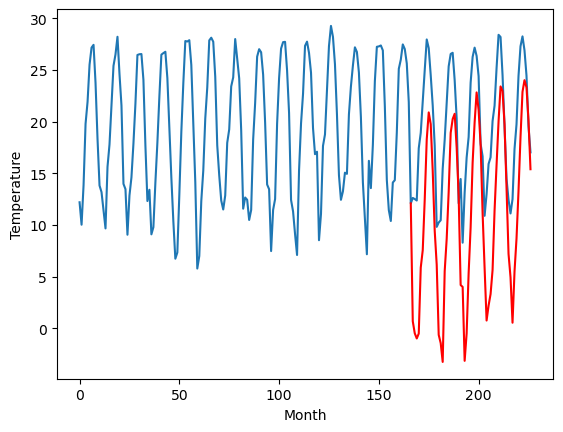

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.99		-0.74		0.25
-1.90		-1.91		-0.01
-3.01		-2.40		0.61
-2.92		-1.93		0.99
3.08		4.46		1.38
4.30		6.15		1.85
7.65		11.08		3.43
12.00		16.87		4.87
15.37		19.49		4.12
13.96		18.36		4.40
10.42		13.84		3.42
6.70		8.04		1.34
2.60		4.76		2.16
-4.29		-2.02		2.27
-4.49		-2.82		1.67
-3.83		-4.63		-0.80
2.94		4.15		1.21
5.08		7.28		2.20
8.81		11.84		3.03
12.95		17.55		4.60
14.33		18.88		4.55
14.60		19.39		4.79
10.86		16.12		5.26
7.08		11.47		4.39
-0.58		2.82		3.40
1.05		2.65		1.60
-5.68		-4.50		1.18
-1.45		-1.85		-0.40
2.12		3.98		1.86
5.12		8.43		3.31
11.00		14.68		3.68
14.97		18.57		3.60
15.47		21.49		6.02
14.01		19.80		5.79
10.92		16.47		5.55
4.58		9.83		5.25
1.58		4.53		2.95
-4.23		-0.57		3.66
-2.04		0.88		2.92
1.33		1.99		0.66
2.10		4.32		2.22
5.37		10.09		4.72
8.65		14.50		5.85
11.84		18.72		6.88
15.44		22.10		6.66
14.90		21.66		6.76
11.39		18.43		7.04
6.38		12.27		5.89
0.76		5.91		5.15
-2.38		

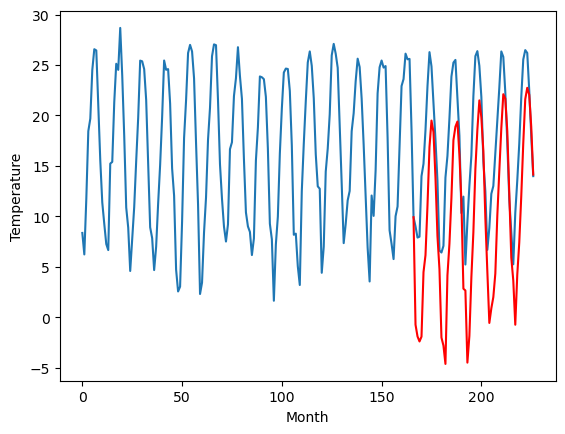

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.90		0.50		1.40
-0.47		-0.67		-0.20
-1.00		-1.17		-0.17
-0.72		-0.69		0.03
6.38		5.69		-0.69
5.41		7.38		1.97
9.56		12.30		2.74
13.79		18.09		4.30
15.26		20.71		5.45
15.25		19.58		4.33
12.45		15.06		2.61
8.10		9.26		1.16
3.30		5.98		2.68
-3.76		-0.80		2.96
-3.34		-1.60		1.74
-2.85		-3.42		-0.57
4.21		5.36		1.15
5.61		8.48		2.87
9.73		13.05		3.32
13.61		18.75		5.14
14.38		20.08		5.70
15.04		20.59		5.55
12.02		17.32		5.30
8.24		12.67		4.43
0.50		4.02		3.52
3.10		3.84		0.74
-3.79		-3.31		0.48
-0.44		-0.66		-0.22
3.56		5.16		1.60
7.15		9.61		2.46
12.51		15.86		3.35
15.48		19.75		4.27
16.19		22.67		6.48
14.58		20.98		6.40
12.19		17.64		5.45
5.50		11.00		5.50
2.18		5.70		3.52
-0.98		0.60		1.58
0.02		2.05		2.03
2.61		3.16		0.55
4.04		5.49		1.45
6.73		11.25		4.52
9.97		15.66		5.69
13.72		19.88		6.16
16.09		23.26		7.17
16.53		22.82		6.29
13.57		19.58		6.01
7.53		13.42		5.89
0.97		7.06		6.09
-1.81		4

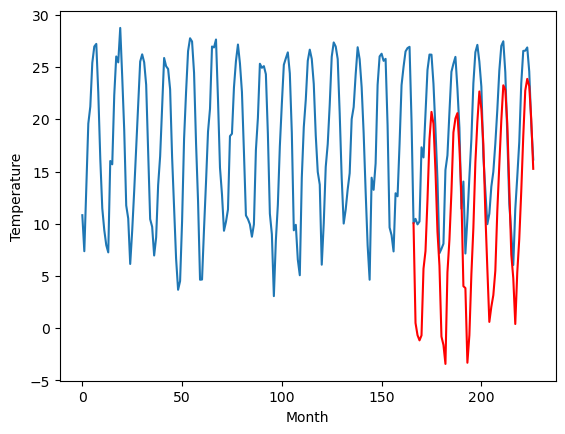

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.19		-0.47		-1.66
-0.23		-1.64		-1.41
0.52		-2.14		-2.66
-0.01		-1.67		-1.66
7.63		4.71		-2.92
7.51		6.39		-1.12
11.26		11.30		0.04
14.04		17.09		3.05
15.69		19.70		4.01
15.93		18.56		2.63
12.52		14.04		1.52
7.98		8.24		0.26
5.08		4.96		-0.12
-1.10		-1.83		-0.73
-1.20		-2.64		-1.44
-2.79		-4.46		-1.67
4.58		4.32		-0.26
6.92		7.43		0.51
10.81		11.99		1.18
14.70		17.69		2.99
14.58		19.02		4.44
15.55		19.52		3.97
12.54		16.25		3.71
9.85		11.60		1.75
2.69		2.96		0.27
6.06		2.77		-3.29
-1.99		-4.38		-2.39
-2.46		-1.74		0.72
3.38		4.08		0.70
9.38		8.52		-0.86
13.81		14.77		0.96
16.81		18.65		1.84
17.75		21.56		3.81
16.11		19.86		3.75
13.34		16.52		3.18
7.78		9.87		2.09
2.73		4.58		1.85
0.64		-0.52		-1.16
1.35		0.93		-0.42
2.35		2.04		-0.31
6.18		4.36		-1.82
7.02		10.11		3.09
11.61		14.51		2.90
15.76		18.73		2.97
17.48		22.10		4.62
19.45		21.65		2.20
16.37		18.41		2.04
9.11		12.24		3.13
2.83		5.88	

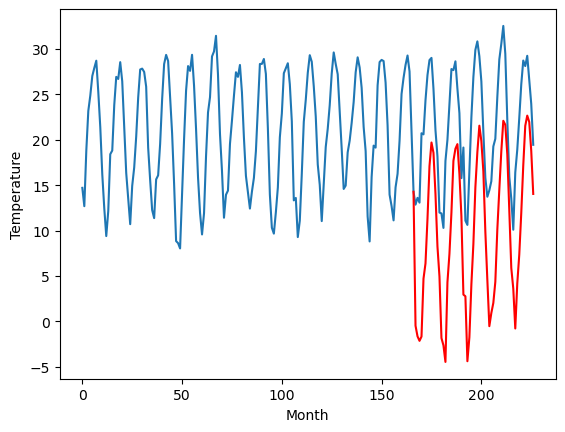

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.60		3.77		-1.83
3.71		2.60		-1.11
4.52		2.10		-2.42
4.14		2.57		-1.57
12.18		8.95		-3.23
11.92		10.63		-1.29
15.72		15.55		-0.17
18.75		21.34		2.59
20.79		23.95		3.16
21.03		22.81		1.78
17.45		18.29		0.84
12.51		12.49		-0.02
9.41		9.21		-0.20
3.05		2.42		-0.63
3.04		1.62		-1.42
1.34		-0.20		-1.54
8.95		8.57		-0.38
11.25		11.69		0.44
15.37		16.25		0.88
18.84		21.94		3.10
18.93		23.28		4.35
19.90		23.78		3.88
16.32		20.51		4.19
13.28		15.86		2.58
5.73		7.21		1.48
9.61		7.03		-2.58
1.13		-0.12		-1.25
0.82		2.52		1.70
6.60		8.34		1.74
12.87		12.79		-0.08
17.49		19.03		1.54
20.86		22.92		2.06
21.95		25.82		3.87
19.94		24.13		4.19
16.76		20.79		4.03
11.37		14.15		2.78
6.37		8.85		2.48
4.35		3.75		-0.60
4.83		5.20		0.37
6.01		6.31		0.30
9.83		8.63		-1.20
10.79		14.39		3.60
15.43		18.79		3.36
20.32		23.00		2.68
22.27		26.37		4.10
23.70		25.93		2.23
19.85		22.69		2.84
12.45		16.52		4.07
6.25		10.17	

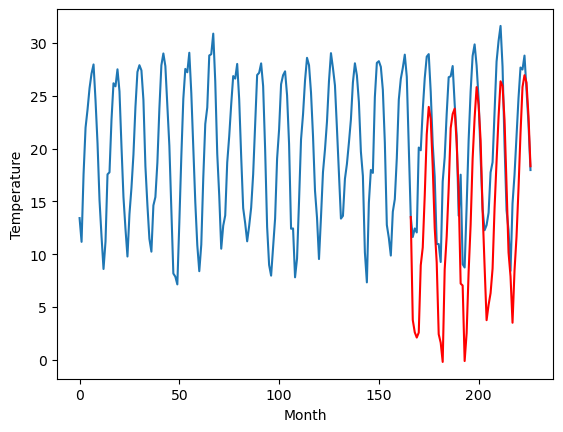

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.73		-0.08		-2.81
0.70		-1.25		-1.95
0.04		-1.75		-1.79
-0.48		-1.28		-0.80
6.87		5.10		-1.77
9.66		6.78		-2.88
14.85		11.70		-3.15
17.57		17.49		-0.08
20.27		20.10		-0.17
20.12		18.96		-1.16
12.59		14.44		1.85
9.75		8.64		-1.11
6.03		5.35		-0.68
-0.72		-1.43		-0.71
-2.23		-2.24		-0.01
-1.85		-4.06		-2.21
5.49		4.72		-0.77
7.76		7.83		0.07
13.35		12.39		-0.96
17.62		18.09		0.47
16.96		19.42		2.46
16.37		19.93		3.56
16.01		16.65		0.64
11.69		12.00		0.31
5.22		3.36		-1.86
5.48		3.18		-2.30
-1.84		-3.98		-2.14
-1.95		-1.33		0.62
5.00		4.48		-0.52
11.91		8.93		-2.98
17.31		15.17		-2.14
19.37		19.06		-0.31
20.29		21.96		1.67
17.44		20.27		2.83
14.39		16.93		2.54
8.31		10.28		1.97
1.35		4.99		3.64
0.23		-0.11		-0.34
0.69		1.34		0.65
0.83		2.45		1.62
5.89		4.77		-1.12
9.05		10.52		1.47
13.66		14.92		1.26
20.35		19.14		-1.21
21.45		22.51		1.06
20.64		22.06		1.42
18.36		18.82		0.46
10.76		12.65		1.89

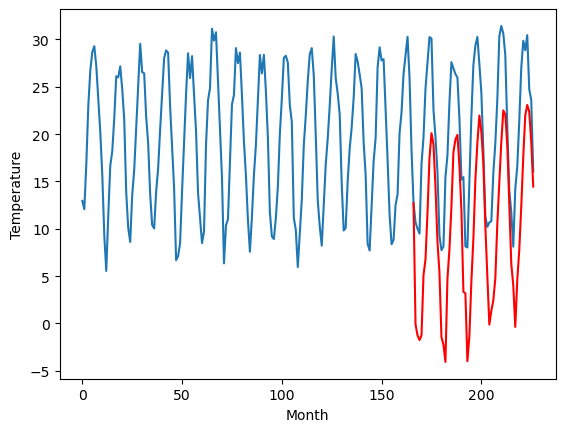

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.75		2.39		0.64
1.02		1.22		0.20
0.21		0.73		0.52
0.28		1.20		0.92
5.95		7.59		1.64
7.58		9.28		1.70
10.36		14.20		3.84
15.03		19.99		4.96
18.21		22.61		4.40
16.58		21.48		4.90
13.16		16.96		3.80
9.67		11.16		1.49
5.52		7.89		2.37
-1.69		1.11		2.80
-1.89		0.31		2.20
-1.11		-1.51		-0.40
5.17		7.27		2.10
7.74		10.40		2.66
11.51		14.96		3.45
15.52		20.67		5.15
16.88		22.00		5.12
17.14		22.52		5.38
13.81		19.24		5.43
9.86		14.59		4.73
2.26		5.95		3.69
3.78		5.77		1.99
-2.61		-1.38		1.23
1.20		1.27		0.07
5.04		7.10		2.06
7.80		11.55		3.75
13.72		17.80		4.08
17.30		21.69		4.39
18.04		24.61		6.57
16.54		22.92		6.38
13.65		19.59		5.94
7.31		12.95		5.64
4.42		7.65		3.23
-1.59		2.55		4.14
0.54		4.00		3.46
4.13		5.11		0.98
4.80		7.44		2.64
8.06		13.20		5.14
11.06		17.61		6.55
14.34		21.84		7.50
17.79		25.22		7.43
17.37		24.78		7.41
14.20		21.54		7.34
9.19		15.38		6.19
3.50		9.02		5.52
0.76		6.75		5.99


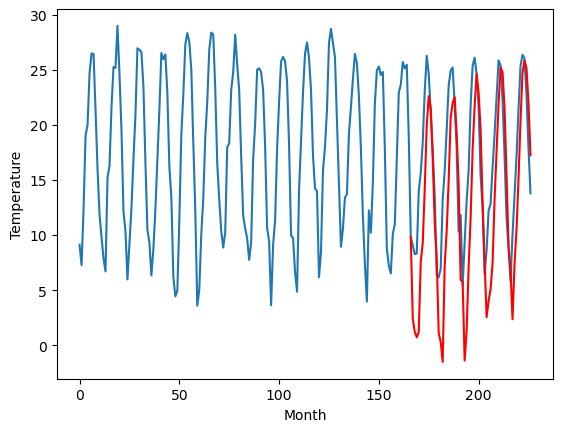

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.51		6.28		-0.23
5.89		5.12		-0.77
5.04		4.62		-0.42
5.72		5.10		-0.62
12.64		11.50		-1.14
13.78		13.20		-0.58
18.28		18.13		-0.15
23.84		23.92		0.08
26.38		26.55		0.17
24.36		25.43		1.07
21.06		20.92		-0.14
14.29		15.11		0.82
10.62		11.84		1.22
4.02		5.07		1.05
3.71		4.28		0.57
0.71		2.47		1.76
12.03		11.26		-0.77
13.74		14.40		0.66
18.40		18.96		0.56
24.48		24.68		0.20
25.47		26.01		0.54
26.69		26.53		-0.16
22.98		23.26		0.28
17.78		18.61		0.83
8.48		9.96		1.48
10.89		9.79		-1.10
2.06		2.64		0.58
4.11		5.30		1.19
10.06		11.14		1.08
15.25		15.60		0.35
20.72		21.85		1.13
24.78		25.76		0.98
28.91		28.68		-0.23
26.04		27.00		0.96
22.20		23.68		1.48
15.53		17.04		1.51
8.93		11.73		2.80
5.19		6.64		1.45
6.38		8.09		1.71
7.88		9.20		1.32
10.71		11.54		0.83
15.11		17.32		2.21
20.46		21.74		1.28
24.27		25.97		1.70
26.57		29.36		2.79
27.07		28.92		1.85
23.45		25.70		2.25
17.14		19.55		2.41
9.74		13.

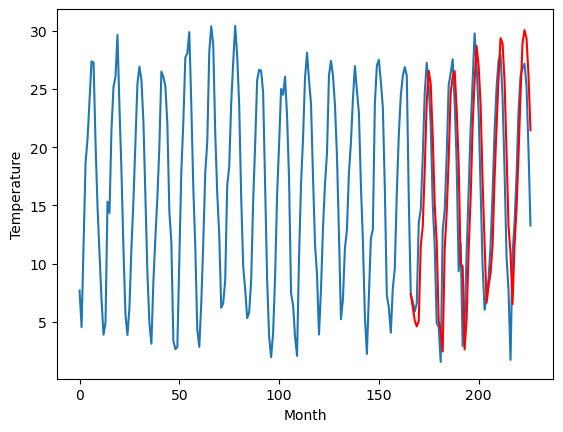

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.17		4.99		-1.18
4.32		3.83		-0.49
4.50		3.33		-1.17
3.99		3.81		-0.18
11.82		10.20		-1.62
13.20		11.90		-1.30
19.31		16.83		-2.48
24.42		22.62		-1.80
26.96		25.25		-1.71
26.03		24.13		-1.90
19.38		19.61		0.23
13.20		13.81		0.61
10.32		10.53		0.21
3.64		3.76		0.12
3.29		2.97		-0.32
-1.49		1.16		2.65
11.07		9.94		-1.13
12.87		13.08		0.21
17.68		17.65		-0.03
23.71		23.36		-0.35
25.22		24.69		-0.53
25.61		25.21		-0.40
23.10		21.94		-1.16
16.85		17.29		0.44
9.10		8.64		-0.46
8.29		8.47		0.18
0.67		1.32		0.65
1.65		3.97		2.32
8.90		9.82		0.92
16.01		14.27		-1.74
21.37		20.52		-0.85
25.66		24.43		-1.23
29.81		27.35		-2.46
27.14		25.67		-1.47
23.31		22.34		-0.97
15.08		15.70		0.62
7.23		10.40		3.17
3.60		5.30		1.70
4.46		6.75		2.29
4.83		7.86		3.03
9.26		10.20		0.94
13.59		15.97		2.38
19.28		20.39		1.11
24.21		24.62		0.41
27.09		28.01		0.92
28.90		27.57		-1.33
24.26		24.34		0.08
15.68		18.19		2.51


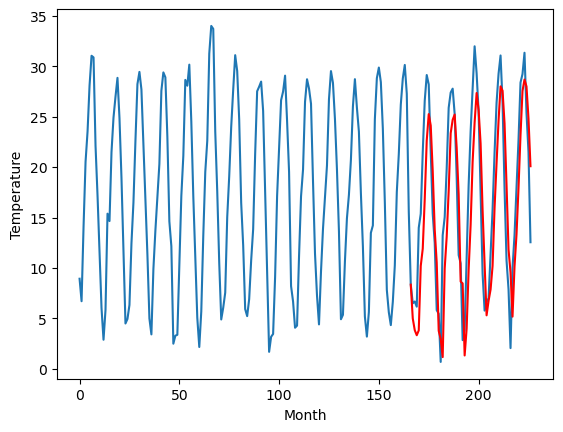

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.70		4.52		-4.18
7.34		3.35		-3.99
6.89		2.86		-4.03
5.65		3.33		-2.32
13.61		9.72		-3.89
15.92		11.42		-4.50
22.45		16.35		-6.10
28.83		22.14		-6.69
30.41		24.76		-5.65
29.18		23.63		-5.55
22.43		19.11		-3.32
15.83		13.31		-2.52
12.65		10.04		-2.61
5.38		3.26		-2.12
5.49		2.46		-3.03
1.12		0.65		-0.47
11.83		9.43		-2.40
15.59		12.57		-3.02
20.14		17.13		-3.01
27.25		22.84		-4.41
27.92		24.17		-3.75
27.77		24.69		-3.08
25.82		21.41		-4.41
18.38		16.76		-1.62
12.13		8.12		-4.01
10.52		7.94		-2.58
3.60		0.79		-2.81
3.66		3.44		-0.22
10.59		9.28		-1.31
17.07		13.73		-3.34
22.52		19.98		-2.54
27.09		23.88		-3.21
30.69		26.80		-3.89
27.86		25.11		-2.75
25.45		21.78		-3.67
16.91		15.14		-1.77
7.92		9.84		1.92
5.57		4.74		-0.83
5.85		6.19		0.34
7.00		7.30		0.30
10.73		9.64		-1.09
16.08		15.40		-0.68
21.19		19.82		-1.37
24.42		24.04		-0.38
29.04		27.43		-1.61
29.44		26.99		-2.45
25.92		23.76		-2.16

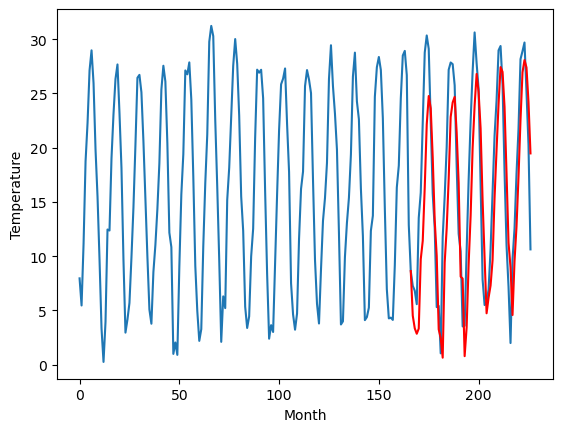

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.40		0.69		1.09
-3.21		-0.47		2.74
-2.87		-0.97		1.90
-2.13		-0.49		1.64
2.19		5.91		3.72
3.82		7.61		3.79
9.28		12.55		3.27
16.60		18.34		1.74
20.47		20.97		0.50
18.28		19.85		1.57
13.75		15.34		1.59
8.21		9.53		1.32
4.01		6.26		2.25
-3.00		-0.51		2.49
-4.84		-1.29		3.55
-5.80		-3.10		2.70
1.42		5.69		4.27
6.07		8.83		2.76
10.61		13.39		2.78
16.70		19.11		2.41
18.93		20.44		1.51
18.71		20.97		2.26
15.01		17.70		2.69
10.59		13.05		2.46
1.27		4.40		3.13
0.50		4.23		3.73
-6.52		-2.92		3.60
-2.62		-0.27		2.35
1.94		5.58		3.64
5.29		10.04		4.75
12.27		16.30		4.03
16.66		20.21		3.55
20.60		23.13		2.53
20.06		21.45		1.39
15.15		18.13		2.98
7.05		11.49		4.44
3.54		6.18		2.64
-3.61		1.09		4.70
-0.65		2.54		3.19
-0.97		3.65		4.62
0.15		5.99		5.84
7.37		11.77		4.40
9.93		16.20		6.27
14.30		20.43		6.13
19.44		23.82		4.38
17.70		23.39		5.69
14.51		20.16		5.65
9.16		14.01		4.85
1.22		7.65		6.43
-0.47		

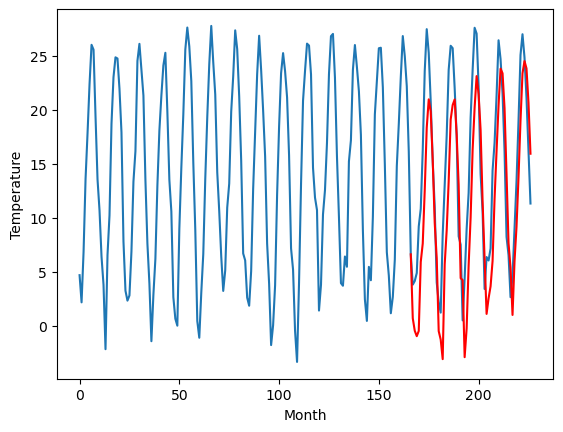

RangeIndex(start=1, stop=12, step=1)
[-0.6800000000000015, -0.9899999999999993, -0.9000000000000021, 1.1899999999999986, 5.599999999999998, 2.730000000000003, 1.7500000000000018, 6.510000000000002, 6.17, 8.7, -0.40000000000000036]
[0.6890059661865227, -0.7421403503417965, 0.498646430969238, -0.46958354949951175, 3.7700521469116204, -0.07981052398681676, 2.388011283874512, 6.275695762634278, 4.986255569458008, 4.517277908325195, 0.6852360916137687]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.68   0.689006
1                 1   -0.99  -0.742140
2                 2   -0.90   0.498646
3                 3    1.19  -0.469584
4                 4    5.60   3.770052
5                 5    2.73  -0.079811
6                 6    1.75   2.388011
7                 7    6.51   6.275696
8                 8    6.17   4.986256
9                 9    8.70   4.517278
10               10   -0.40   0.685236


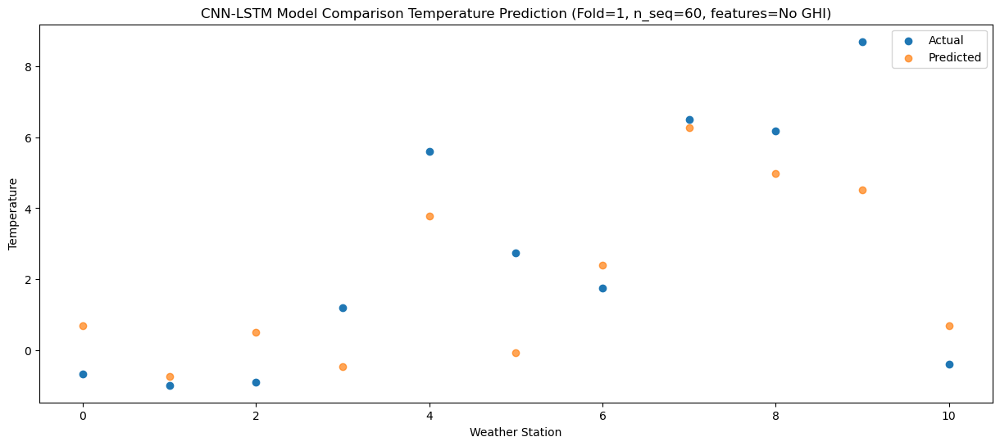

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.15  -0.476757
1                 1   -1.90  -1.905807
2                 2   -0.47  -0.666470
3                 3   -0.23  -1.637950
4                 4    3.71   2.602358
5                 5    0.70  -1.247750
6                 6    1.02   1.224063
7                 7    5.89   5.116000
8                 8    4.32   3.825532
9                 9    7.34   3.354682
10               10   -3.21  -0.473627


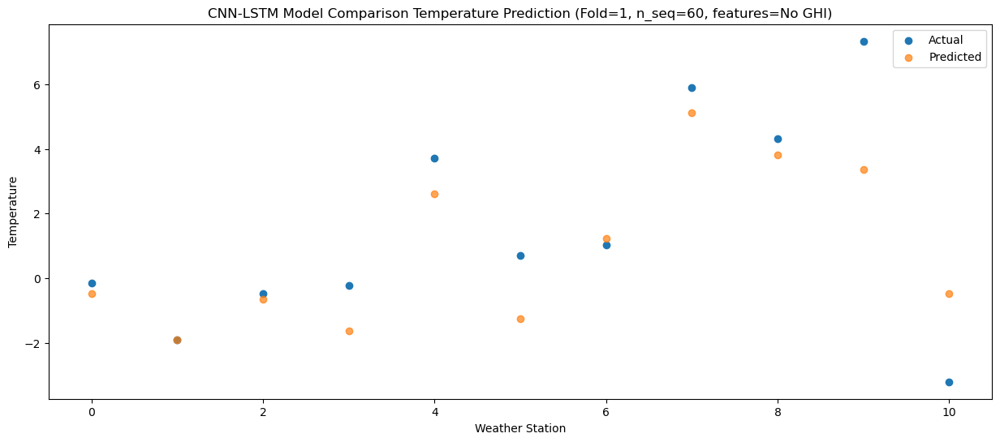

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -0.975208
1                 1   -3.01  -2.404664
2                 2   -1.00  -1.165028
3                 3    0.52  -2.135838
4                 4    4.52   2.104330
5                 5    0.04  -1.745737
6                 6    0.21   0.725273
7                 7    5.04   4.616352
8                 8    4.50   3.326077
9                 9    6.89   2.855607
10               10   -2.87  -0.973419


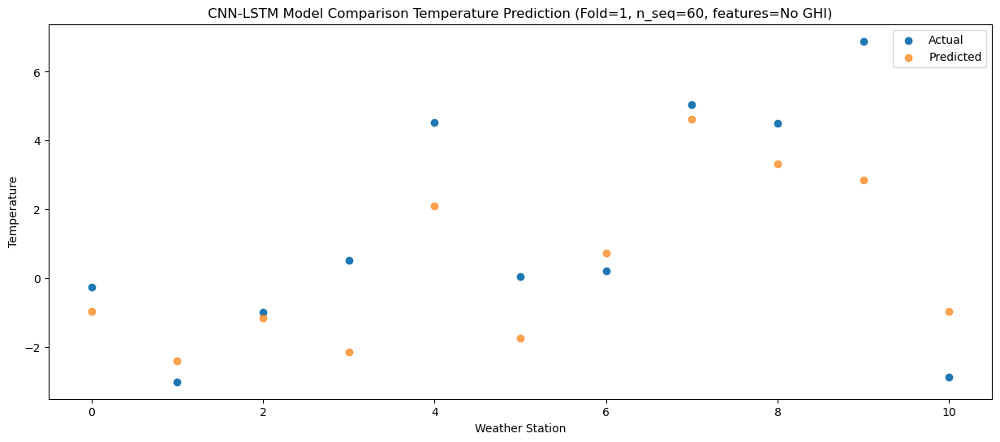

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.40  -0.501787
1                 1   -2.92  -1.927883
2                 2   -0.72  -0.690513
3                 3   -0.01  -1.666405
4                 4    4.14   2.574806
5                 5   -0.48  -1.275682
6                 6    0.28   1.201637
7                 7    5.72   5.099432
8                 8    3.99   3.807488
9                 9    5.65   3.334065
10               10   -2.13  -0.488948


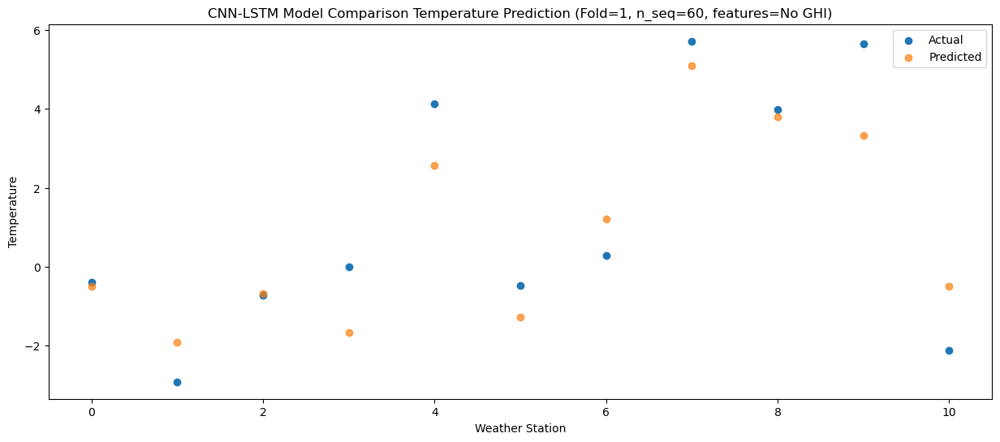

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.66   5.880492
1                 1    3.08   4.459029
2                 2    6.38   5.693237
3                 3    7.63   4.710239
4                 4   12.18   8.952917
5                 5    6.87   5.101861
6                 6    5.95   7.587963
7                 7   12.64  11.495092
8                 8   11.82  10.200862
9                 9   13.61   9.723330
10               10    2.19   5.908602


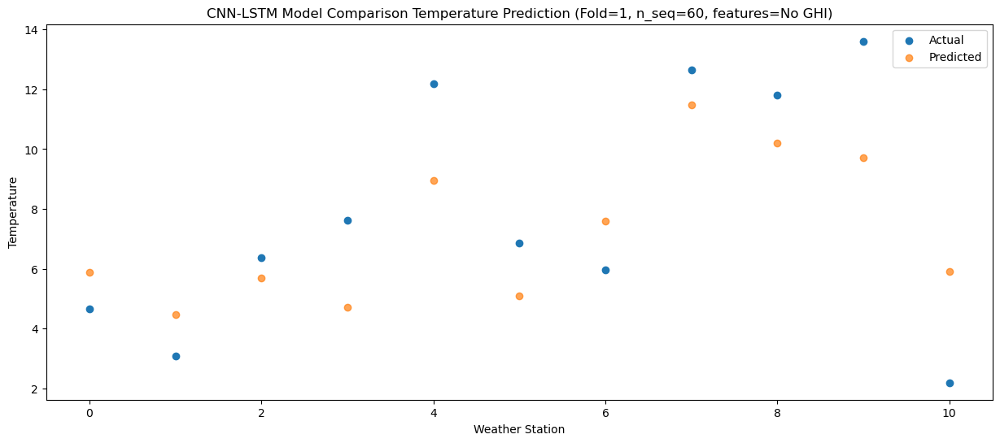

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.15   7.566389
1                 1    4.30   6.150620
2                 2    5.41   7.380956
3                 3    7.51   6.389284
4                 4   11.92  10.633745
5                 5    9.66   6.781989
6                 6    7.58   9.278836
7                 7   13.78  13.197384
8                 8   13.20  11.900345
9                 9   15.92  11.417784
10               10    3.82   7.613227


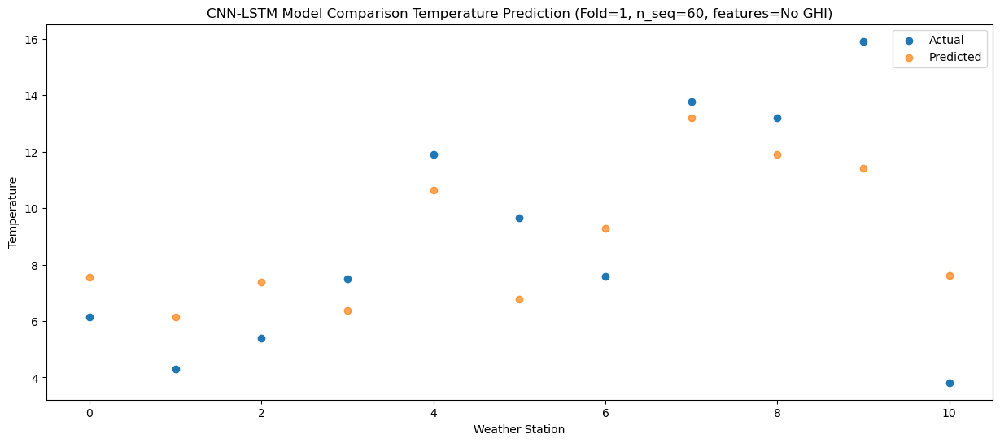

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    9.23  12.486635
1                 1    7.65  11.075647
2                 2    9.56  12.302699
3                 3   11.26  11.303670
4                 4   15.72  15.549653
5                 5   14.85  11.697320
6                 6   10.36  14.203240
7                 7   18.28  18.131436
8                 8   19.31  16.832050
9                 9   22.45  16.345230
10               10    9.28  12.549205


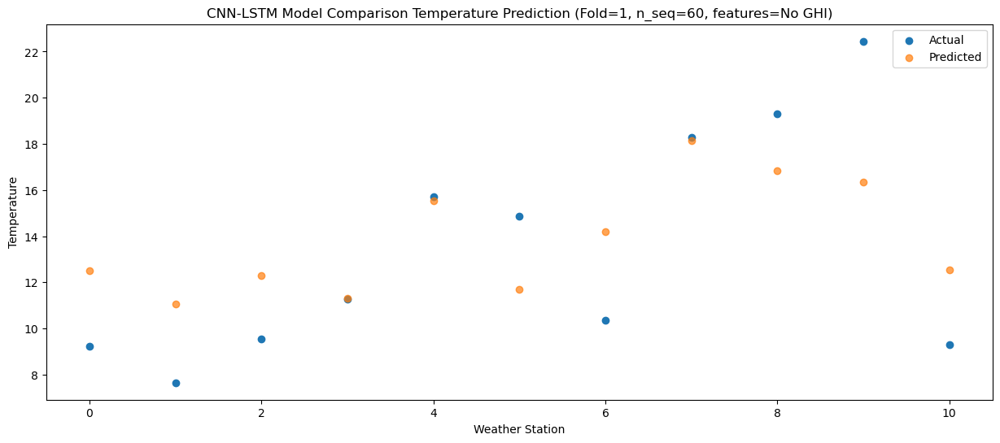

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.23  18.277176
1                 1   12.00  16.866522
2                 2   13.79  18.093341
3                 3   14.04  17.093790
4                 4   18.75  21.339885
5                 5   17.57  17.487516
6                 6   15.03  19.994069
7                 7   23.84  23.922953
8                 8   24.42  22.623403
9                 9   28.83  22.136281
10               10   16.60  18.340851


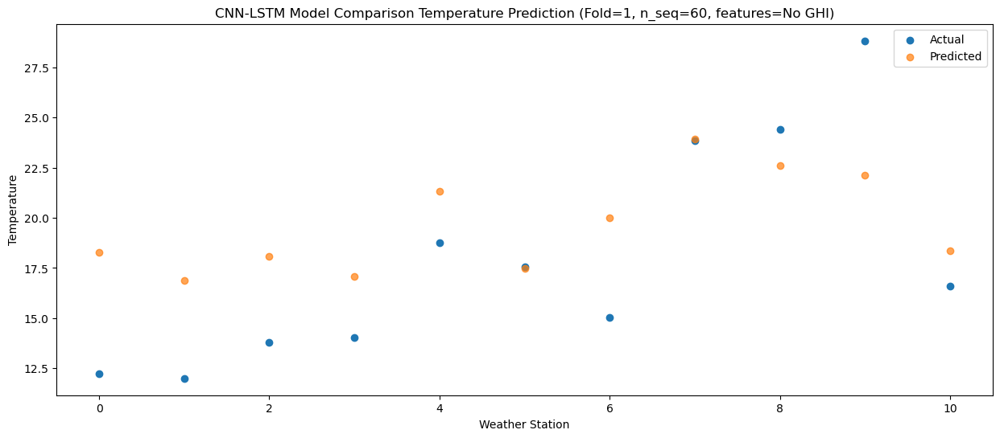

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.18  20.892611
1                 1   15.37  19.487360
2                 2   15.26  20.710485
3                 3   15.69  19.702658
4                 4   20.79  23.950455
5                 5   20.27  20.097427
6                 6   18.21  22.614210
7                 7   26.38  26.553974
8                 8   26.96  25.251767
9                 9   30.41  24.759855
10               10   20.47  20.974072


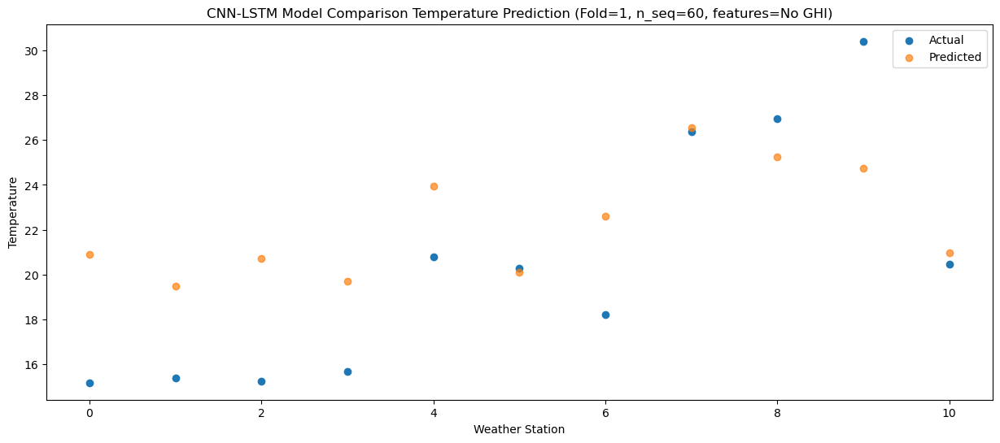

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   14.34  19.759569
1                 1   13.96  18.358240
2                 2   15.25  19.578697
3                 3   15.93  18.564893
4                 4   21.03  22.813913
5                 5   20.12  18.960413
6                 6   16.58  21.484592
7                 7   24.36  25.432228
8                 8   26.03  24.128089
9                 9   29.18  23.632708
10               10   18.28  19.853922


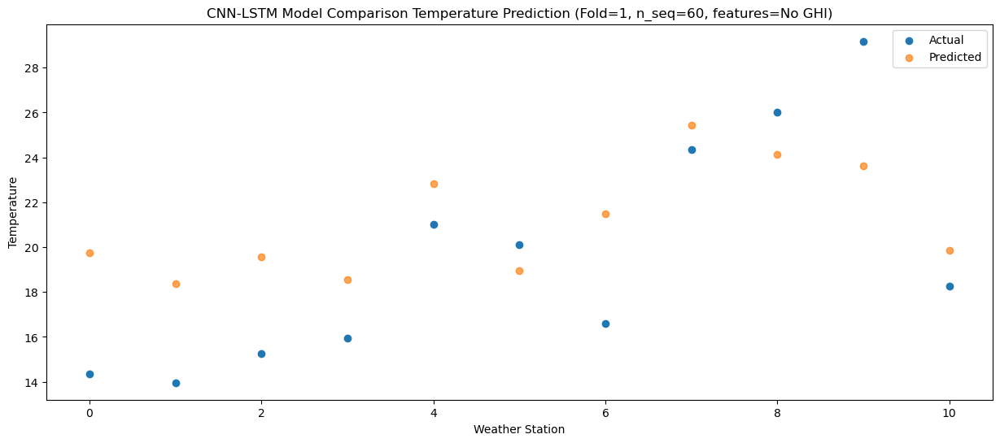

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.72  15.238249
1                 1   10.42  13.838454
2                 2   12.45  15.057864
3                 3   12.52  14.041711
4                 4   17.45  18.291210
5                 5   12.59  14.437528
6                 6   13.16  16.964610
7                 7   21.06  20.915337
8                 8   19.38  19.610444
9                 9   22.43  19.113698
10               10   13.75  15.337655


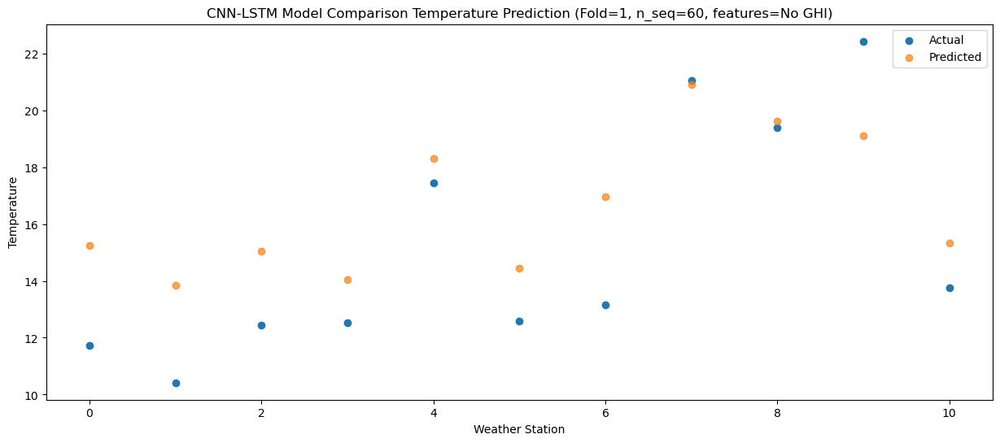

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    8.79   9.438684
1                 1    6.70   8.037171
2                 2    8.10   9.257767
3                 3    7.98   8.244268
4                 4   12.51  12.493221
5                 5    9.75   8.639742
6                 6    9.67  11.163557
7                 7   14.29  15.110804
8                 8   13.20  13.806748
9                 9   15.83  13.311537
10               10    8.21   9.532441


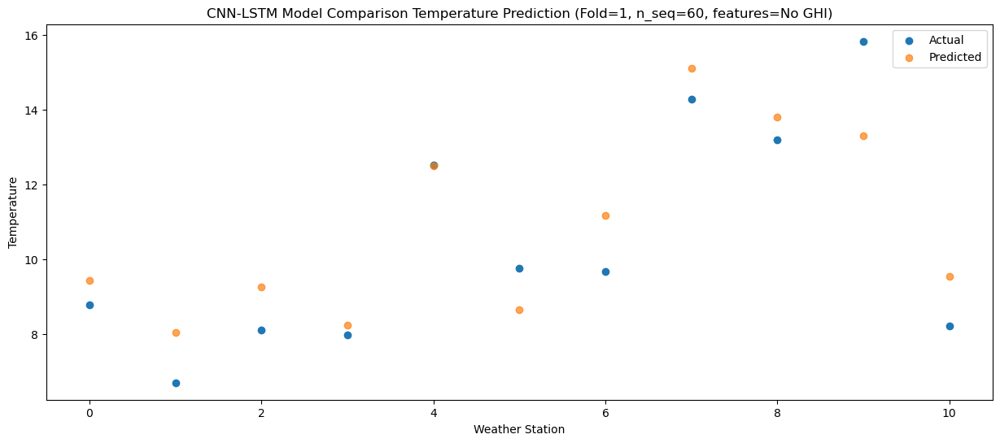

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.89   6.156928
1                 1    2.60   4.759251
2                 2    3.30   5.977240
3                 3    5.08   4.957906
4                 4    9.41   9.208054
5                 5    6.03   5.354106
6                 6    5.52   7.885158
7                 7   10.62  11.840097
8                 8   10.32  10.534138
9                 9   12.65  10.035537
10               10    4.01   6.263327


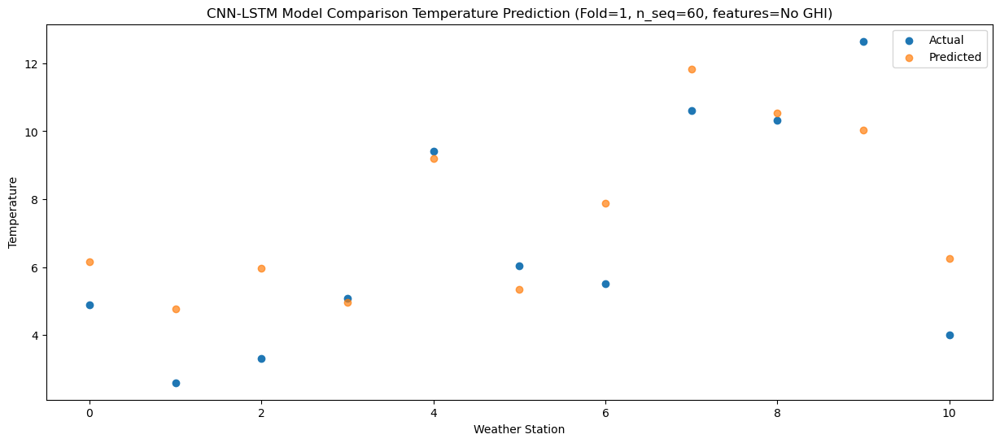

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -0.625461
1                 1   -4.29  -2.018908
2                 2   -3.76  -0.803779
3                 3   -1.10  -1.829513
4                 4    3.05   2.421944
5                 5   -0.72  -1.432527
6                 6   -1.69   1.106477
7                 7    4.02   5.069872
8                 8    3.64   3.761817
9                 9    5.38   3.259492
10               10   -3.00  -0.505141


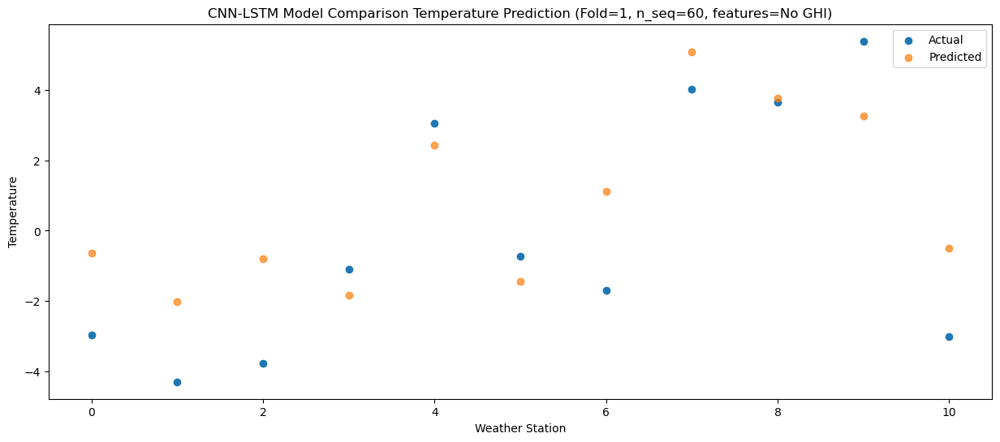

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.53  -1.428021
1                 1   -4.49  -2.816922
2                 2   -3.34  -1.604889
3                 3   -1.20  -2.637561
4                 4    3.04   1.615323
5                 5   -2.23  -2.239705
6                 6   -1.89   0.307891
7                 7    3.71   4.280419
8                 8    3.29   2.970116
9                 9    5.49   2.463766
10               10   -4.84  -1.292733


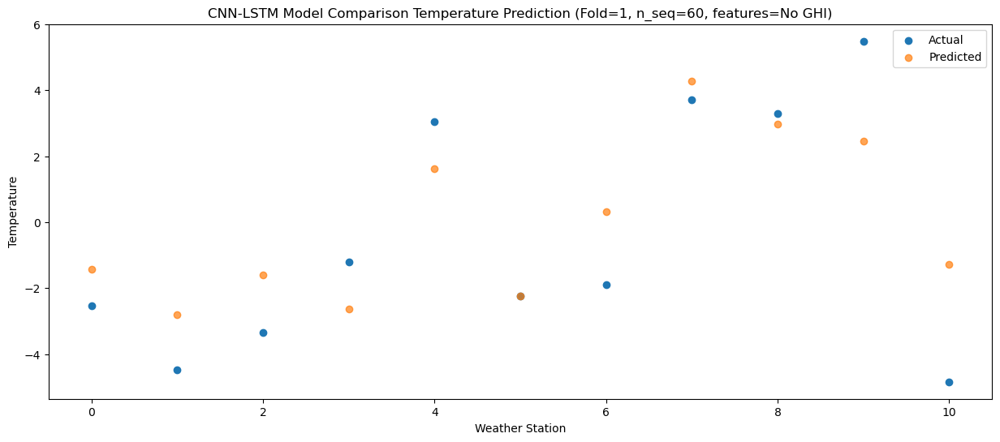

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -3.244426
1                 1   -3.83  -4.631041
2                 2   -2.85  -3.420577
3                 3   -2.79  -4.456761
4                 4    1.34  -0.203158
5                 5   -1.85  -4.058456
6                 6   -1.11  -1.506525
7                 7    0.71   2.470613
8                 8   -1.49   1.159190
9                 9    1.12   0.650810
10               10   -5.80  -3.101615


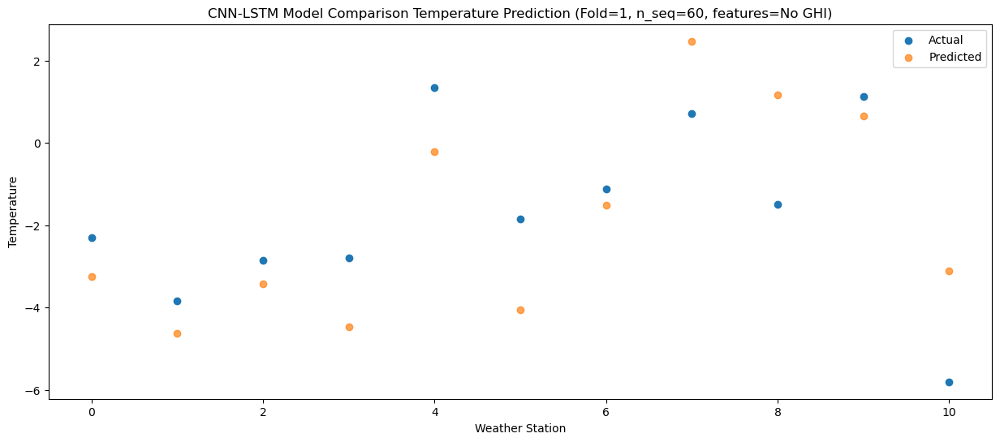

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.67   5.532694
1                 1    2.94   4.149580
2                 2    4.21   5.357656
3                 3    4.58   4.316127
4                 4    8.95   8.570820
5                 5    5.49   4.715098
6                 6    5.17   7.273648
7                 7   12.03  11.257811
8                 8   11.07   9.944673
9                 9   11.83   9.433191
10               10    1.42   5.687002


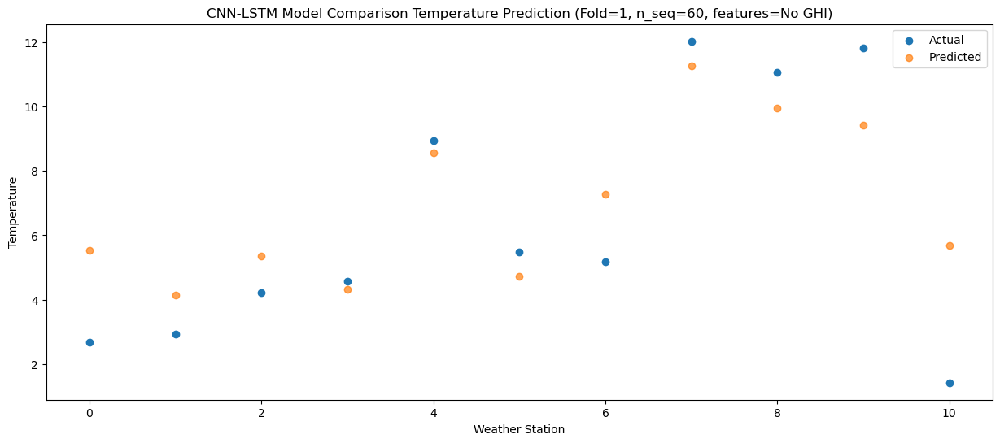

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    5.48   8.657114
1                 1    5.08   7.279319
2                 2    5.61   8.483755
3                 3    6.92   7.434090
4                 4   11.25  11.690456
5                 5    7.76   7.834089
6                 6    7.74  10.402702
7                 7   13.74  14.397569
8                 8   12.87  13.081812
9                 9   15.59  12.565614
10               10    6.07   8.828920


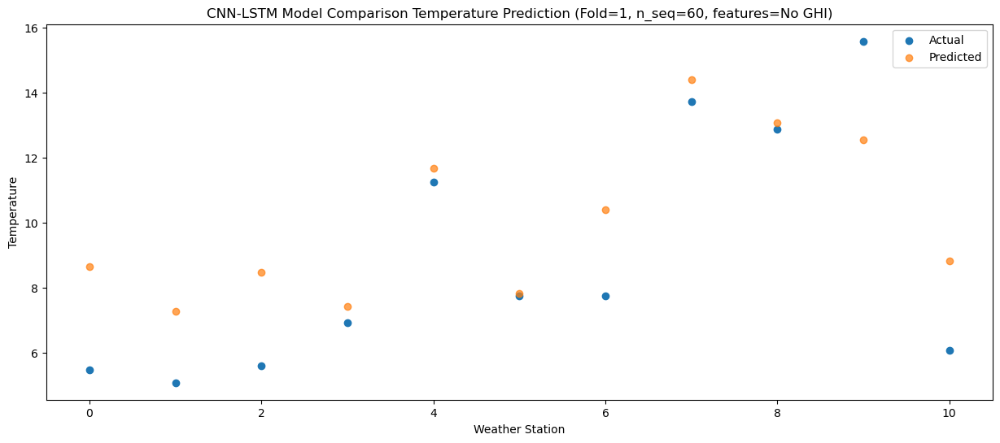

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    9.09  13.217910
1                 1    8.81  11.841565
2                 2    9.73  13.045027
3                 3   10.81  11.993184
4                 4   15.37  16.249998
5                 5   13.35  12.393446
6                 6   11.51  14.964776
7                 7   18.40  18.962529
8                 8   17.68  17.646048
9                 9   20.14  17.128581
10               10   10.61  13.394487


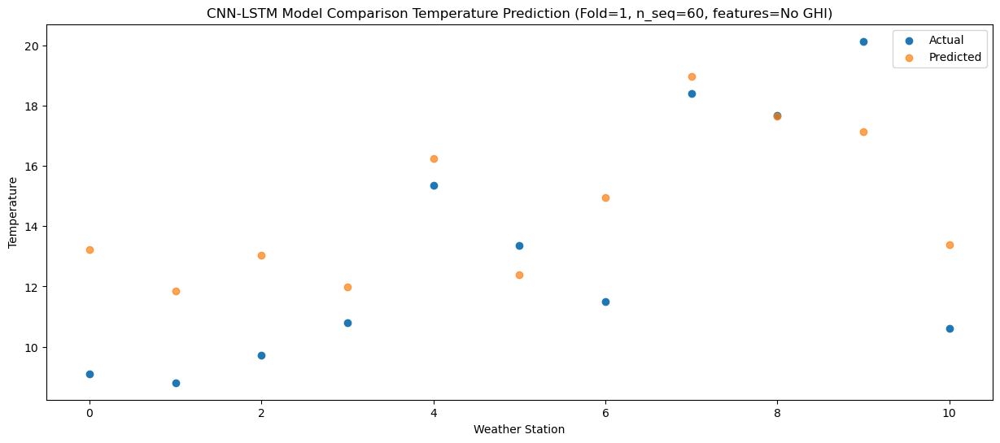

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.58  18.917229
1                 1   12.95  17.546395
2                 2   13.61  18.746115
3                 3   14.70  17.685895
4                 4   18.84  21.944423
5                 5   17.62  18.087200
6                 6   15.52  20.668919
7                 7   24.48  24.677721
8                 8   23.71  23.358513
9                 9   27.25  22.836181
10               10   16.70  19.111940


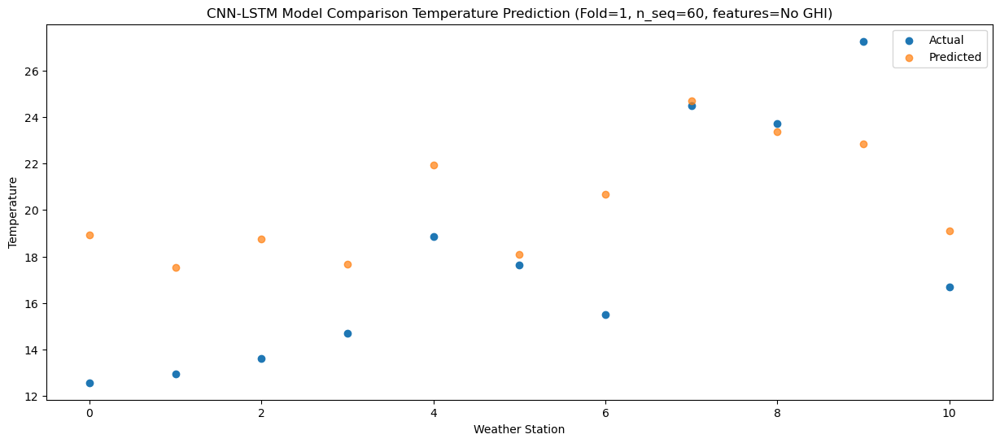

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   13.78  20.249249
1                 1   14.33  18.878664
2                 2   14.38  20.078220
3                 3   14.58  19.017621
4                 4   18.93  23.276227
5                 5   16.96  19.418974
6                 6   16.88  22.001162
7                 7   25.47  26.010454
8                 8   25.22  24.691119
9                 9   27.92  24.168576
10               10   18.93  20.444773


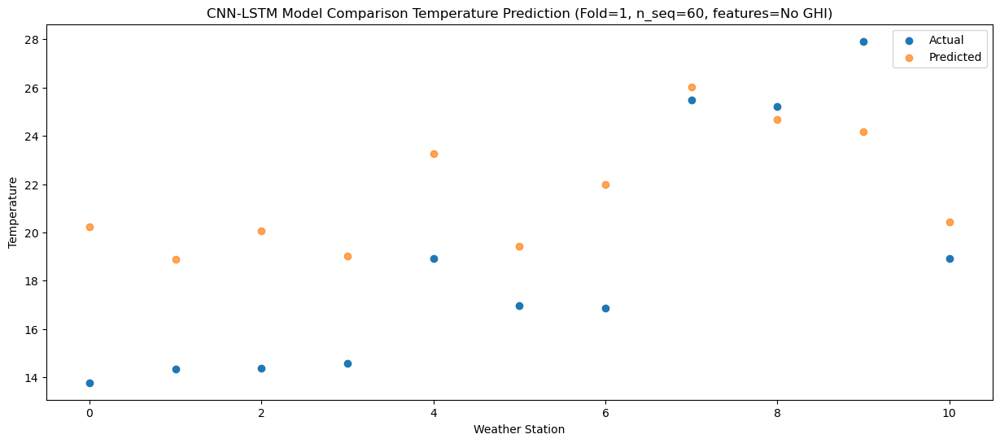

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   13.89  20.760777
1                 1   14.60  19.393752
2                 2   15.04  20.590880
3                 3   15.55  19.524848
4                 4   19.90  23.784577
5                 5   16.37  19.926887
6                 6   17.14  22.515797
7                 7   26.69  26.532240
8                 8   25.61  25.211148
9                 9   27.77  24.685457
10               10   18.71  20.968017


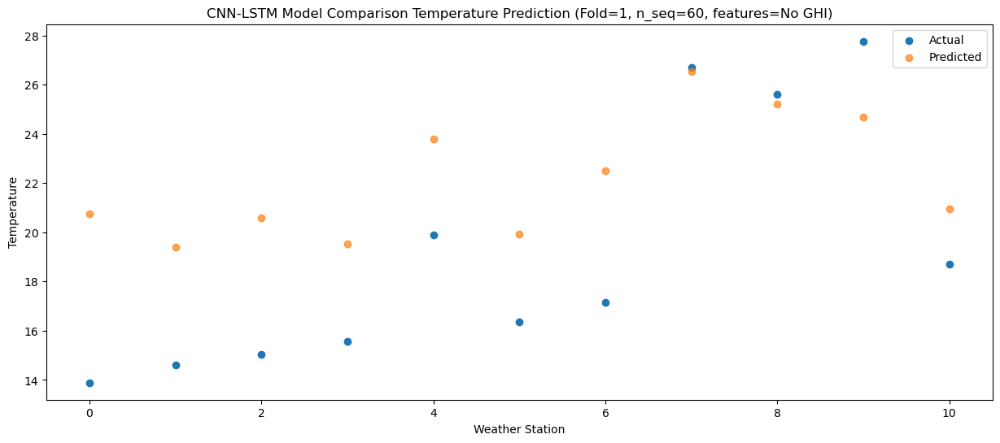

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   11.24  17.488748
1                 1   10.86  16.122495
2                 2   12.02  17.319091
3                 3   12.54  16.251861
4                 4   16.32  20.511838
5                 5   16.01  16.654058
6                 6   13.81  19.244438
7                 7   22.98  23.262438
8                 8   23.10  21.940972
9                 9   25.82  21.414594
10               10   15.01  17.698523


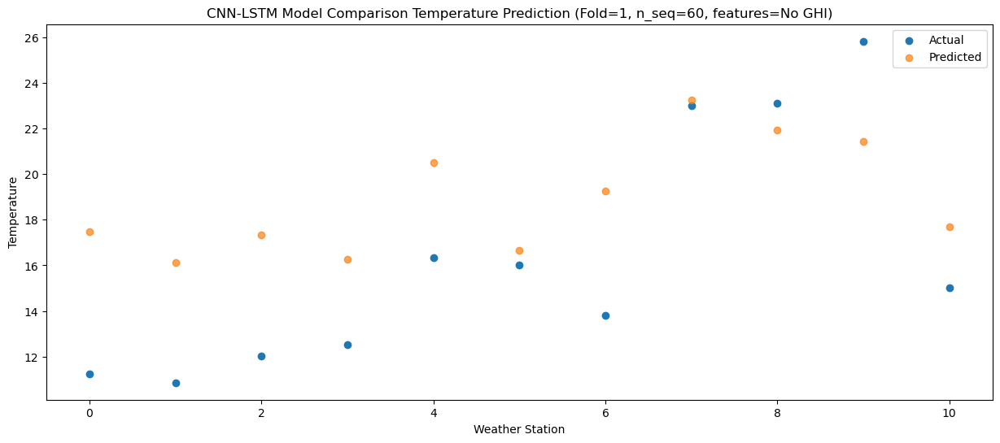

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.54  12.834564
1                 1    7.08  11.469033
2                 2    8.24  12.665119
3                 3    9.85  11.596739
4                 4   13.28  15.856952
5                 5   11.69  11.999092
6                 6    9.86  14.590870
7                 7   17.78  18.610355
8                 8   16.85  17.288547
9                 9   18.38  16.761507
10               10   10.59  13.046720


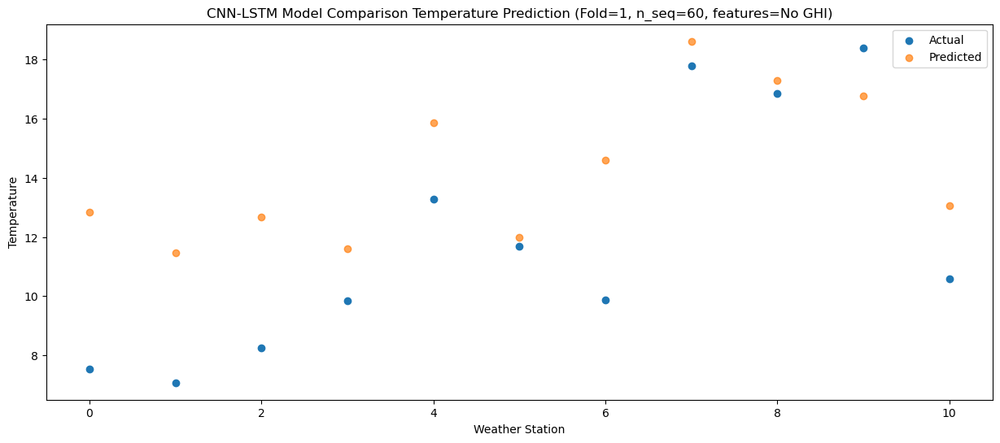

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -0.67   4.191003
1                 1   -0.58   2.823872
2                 2    0.50   4.021038
3                 3    2.69   2.955079
4                 4    5.73   7.214797
5                 5    5.22   3.357131
6                 6    2.26   5.945904
7                 7    8.48   9.962184
8                 8    9.10   8.641175
9                 9   12.13   8.115547
10               10    1.27   4.397882


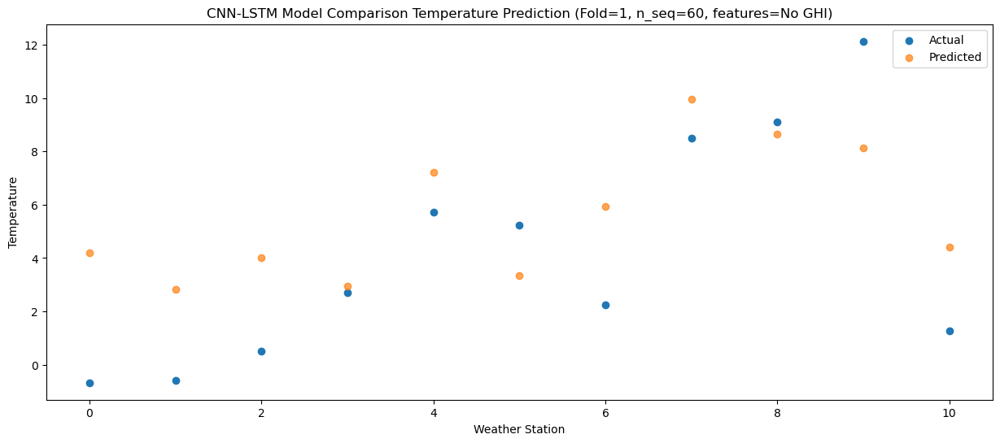

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.68   4.012098
1                 1    1.05   2.647294
2                 2    3.10   3.842867
3                 3    6.06   2.773340
4                 4    9.61   7.033795
5                 5    5.48   3.175846
6                 6    3.78   5.769025
7                 7   10.89   9.789988
8                 8    8.29   8.467840
9                 9   10.52   7.940145
10               10    0.50   4.226625


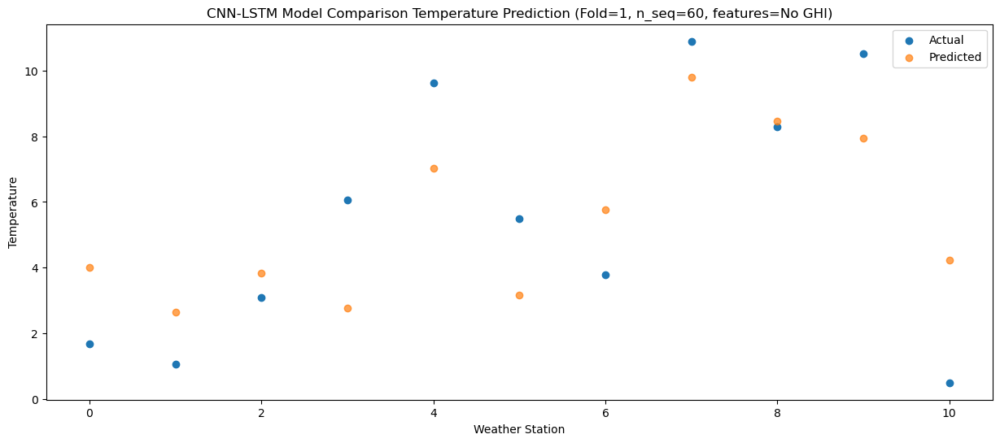

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.48  -3.139546
1                 1   -5.68  -4.503146
2                 2   -3.79  -3.308412
3                 3   -1.99  -4.379830
4                 4    1.13  -0.118983
5                 5   -1.84  -3.977073
6                 6   -2.61  -1.381581
7                 7    2.06   2.641838
8                 8    0.67   1.319109
9                 9    3.60   0.790332
10               10   -6.52  -2.921061


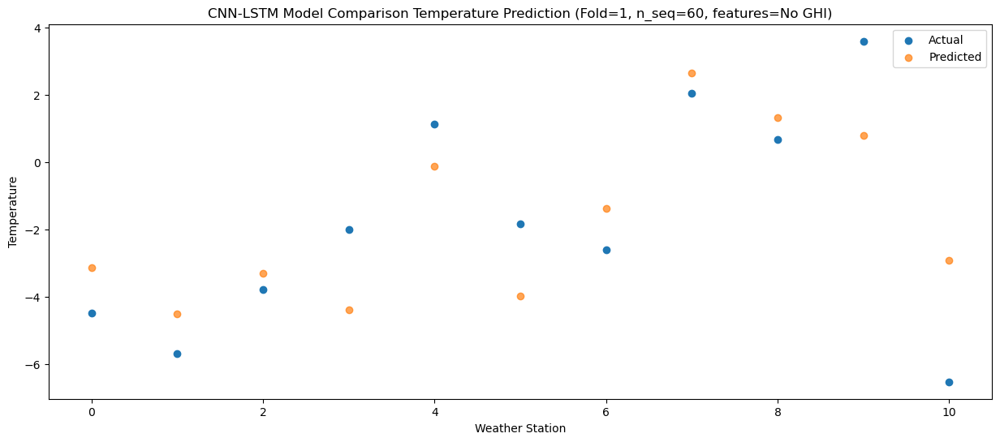

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.36  -0.493643
1                 1   -1.45  -1.854294
2                 2   -0.44  -0.661564
3                 3   -2.46  -1.737465
4                 4    0.82   2.524301
5                 5   -1.95  -1.334149
6                 6    1.20   1.266899
7                 7    4.11   5.296228
8                 8    1.65   3.972039
9                 9    3.66   3.440657
10               10   -2.62  -0.265460


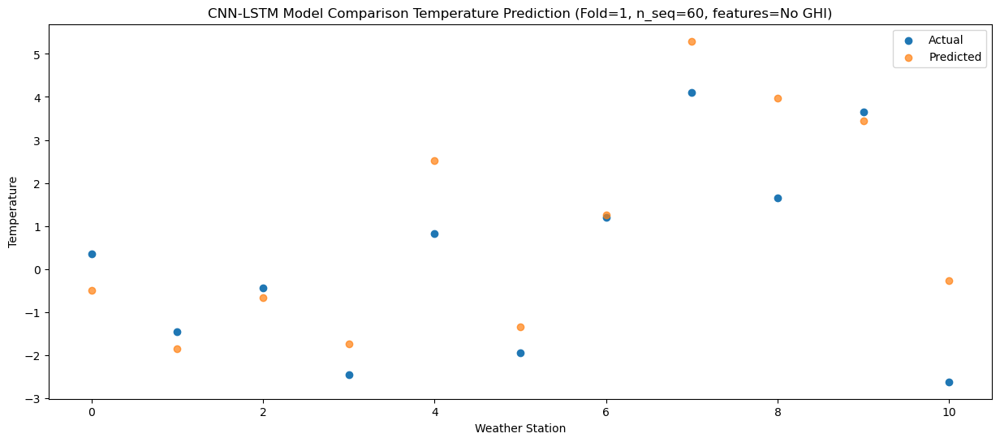

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.75   5.329757
1                 1    2.12   3.977304
2                 2    3.56   5.164445
3                 3    3.38   4.076031
4                 4    6.60   8.340372
5                 5    5.00   4.480919
6                 6    5.04   7.097461
7                 7   10.06  11.143254
8                 8    8.90   9.815020
9                 9   10.59   9.276380
10               10    1.94   5.584924


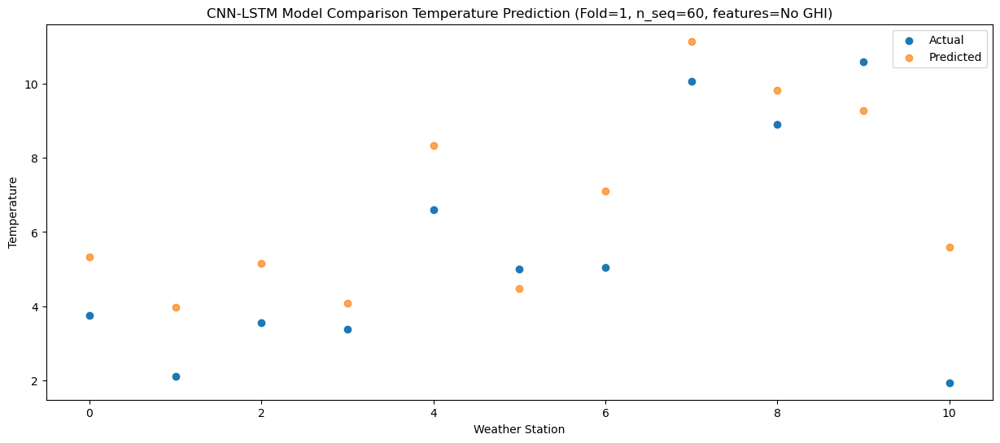

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    5.74   9.777560
1                 1    5.12   8.427311
2                 2    7.15   9.612940
3                 3    9.38   8.521119
4                 4   12.87  12.786162
5                 5   11.91   8.926446
6                 6    7.80  11.547176
7                 7   15.25  15.597421
8                 8   16.01  14.268113
9                 9   17.07  13.727507
10               10    5.29  10.039964


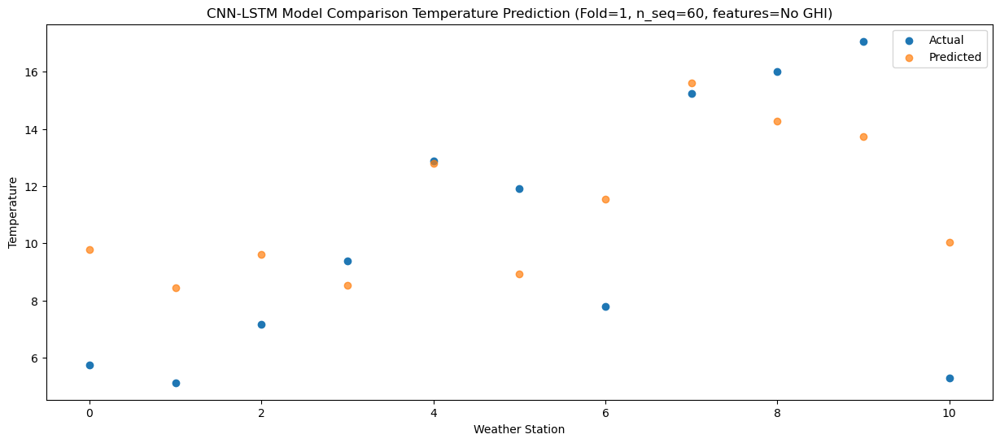

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.99  16.026220
1                 1   11.00  14.678468
2                 2   12.51  15.862382
3                 3   13.81  14.766724
4                 4   17.49  19.032558
5                 5   17.31  15.172542
6                 6   13.72  17.798008
7                 7   20.72  21.853278
8                 8   21.37  20.522747
9                 9   22.52  19.979923
10               10   12.27  16.296838


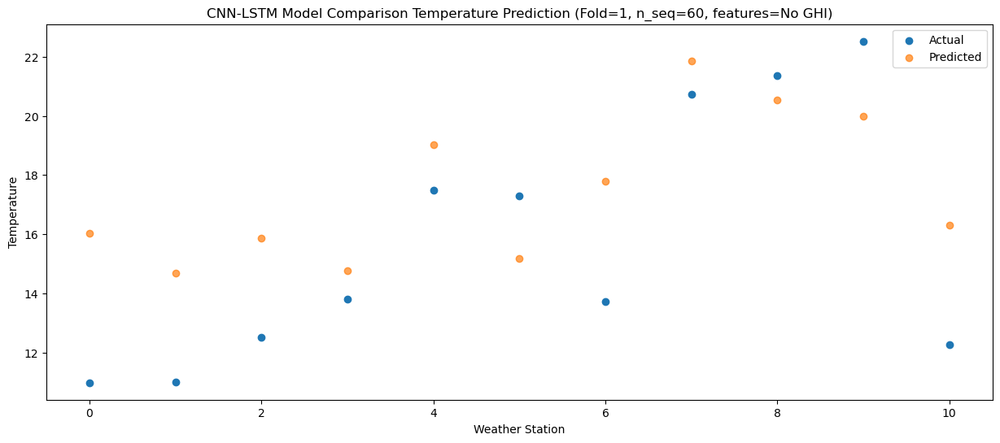

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.49  19.915786
1                 1   14.97  18.574012
2                 2   15.48  19.753844
3                 3   16.81  18.649036
4                 4   20.86  22.916752
5                 5   19.37  19.056005
6                 6   17.30  21.692800
7                 7   24.78  25.760103
8                 8   25.66  24.426625
9                 9   27.09  23.878493
10               10   16.66  20.206107


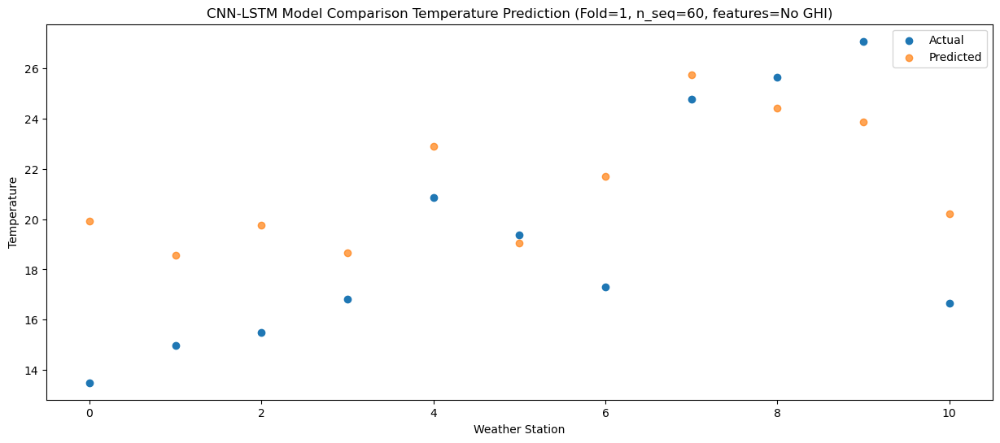

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   14.39  22.826699
1                 1   15.47  21.488854
2                 2   16.19  22.666004
3                 3   17.75  21.555186
4                 4   21.95  25.824133
5                 5   20.29  21.962918
6                 6   18.04  24.607144
7                 7   28.91  28.682350
8                 8   29.81  27.346939
9                 9   30.69  26.795319
10               10   20.60  23.129963


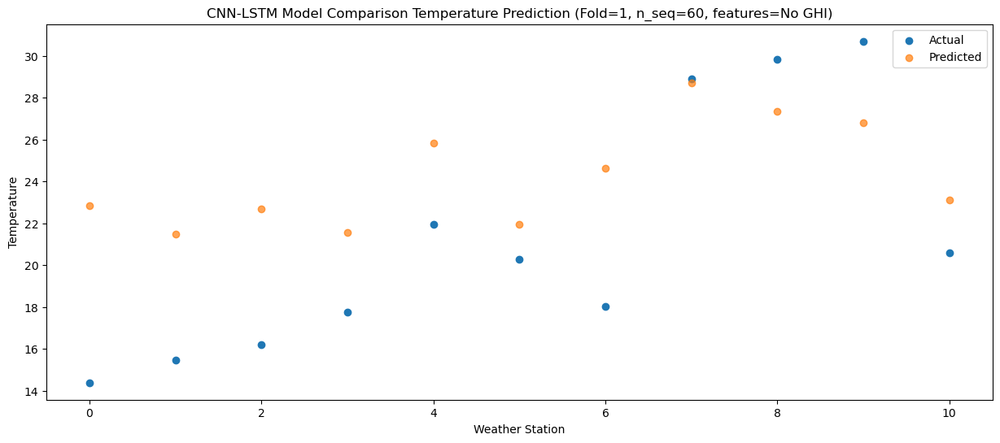

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.59  21.137982
1                 1   14.01  19.803380
2                 2   14.58  20.978348
3                 3   16.11  19.862639
4                 4   19.94  24.132587
5                 5   17.44  20.270973
6                 6   16.54  22.921276
7                 7   26.04  27.002940
8                 8   27.14  25.665924
9                 9   27.86  25.111459
10               10   20.06  21.451907


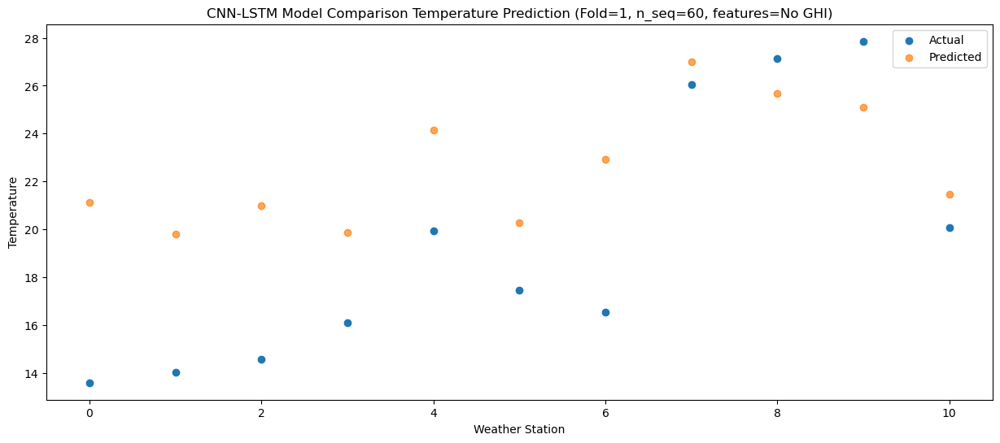

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   11.63  17.799894
1                 1   10.92  16.469543
2                 2   12.19  17.641617
3                 3   13.34  16.519427
4                 4   16.76  20.790704
5                 5   14.39  16.928575
6                 6   13.65  19.586899
7                 7   22.20  23.677090
8                 8   23.31  22.337980
9                 9   25.45  21.779757
10               10   15.15  18.127797


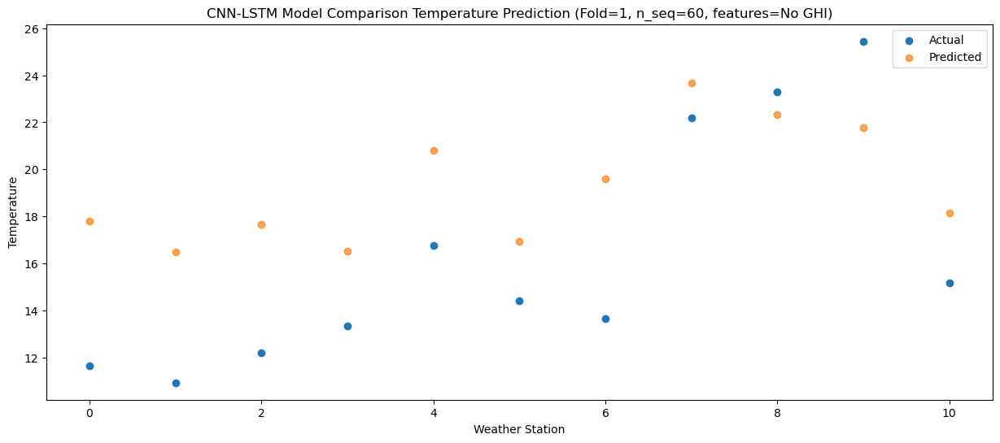

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.08  11.156511
1                 1    4.58   9.828729
2                 2    5.50  10.999048
3                 3    7.78   9.872920
4                 4   11.37  14.145005
5                 5    8.31  10.282570
6                 6    7.31  12.945758
7                 7   15.53  17.041124
8                 8   15.08  15.700749
9                 9   16.91  15.140244
10               10    7.05  11.492872


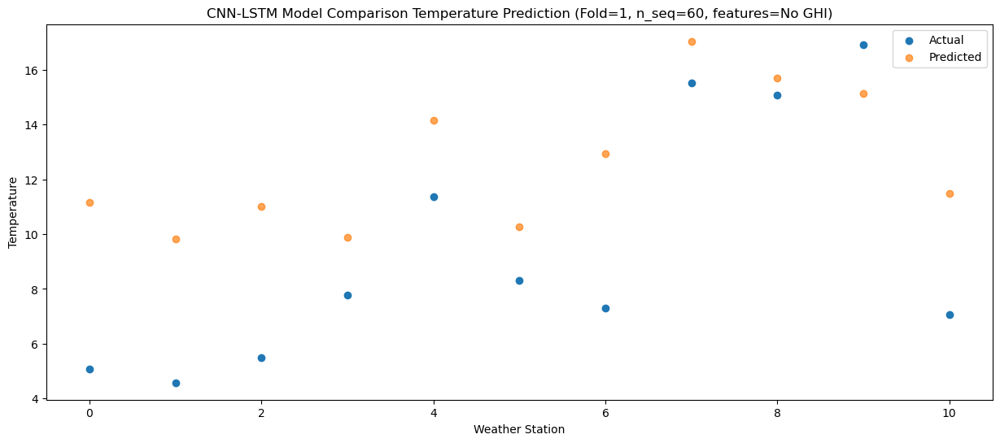

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.88   5.859974
1                 1    1.58   4.528720
2                 2    2.18   5.701399
3                 3    2.73   4.580558
4                 4    6.37   8.851559
5                 5    1.35   4.989545
6                 6    4.42   7.646184
7                 7    8.93  11.734589
8                 8    7.23  10.395928
9                 9    7.92   9.838489
10               10    3.54   6.184916


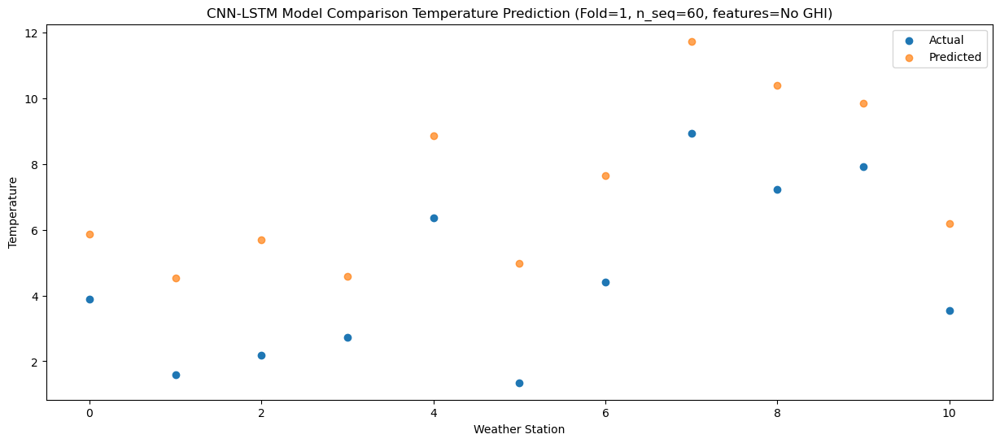

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.88   0.760693
1                 1   -4.23  -0.569050
2                 2   -0.98   0.602597
3                 3    0.64  -0.520552
4                 4    4.35   3.750921
5                 5    0.23  -0.111276
6                 6   -1.59   2.548223
7                 7    5.19   6.639665
8                 8    3.60   5.300261
9                 9    5.57   4.741481
10               10   -3.61   1.090611


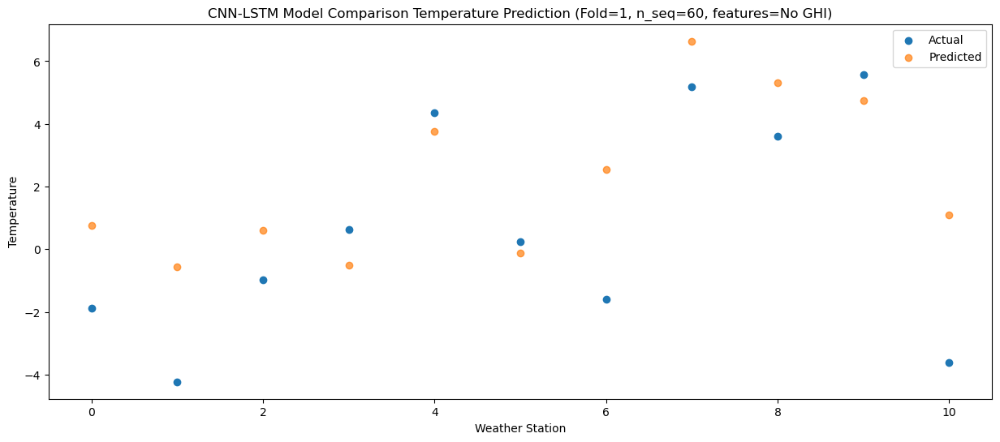

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.23   2.208841
1                 1   -2.04   0.878805
2                 2    0.02   2.050656
3                 3    1.35   0.927968
4                 4    4.83   5.199348
5                 5    0.69   1.337182
6                 6    0.54   3.996122
7                 7    6.38   8.086965
8                 8    4.46   6.747701
9                 9    5.85   6.189184
10               10   -0.65   2.537803


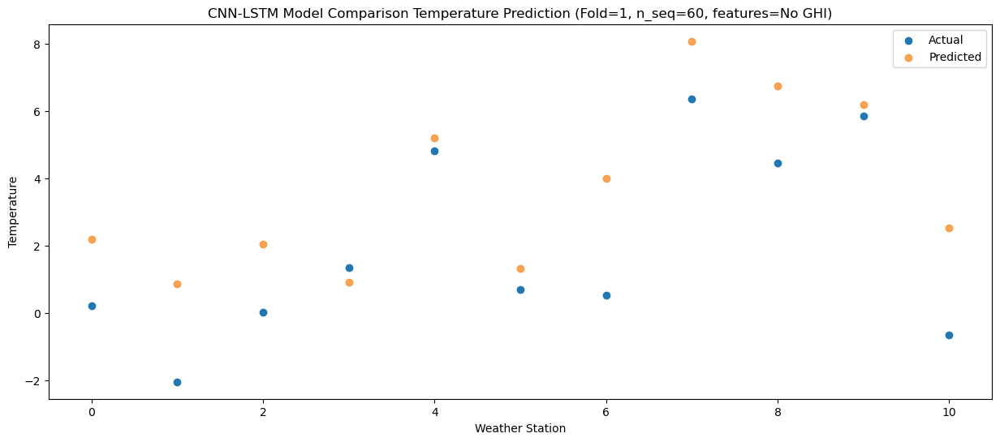

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    3.14   3.321325
1                 1    1.33   1.991790
2                 2    2.61   3.163308
3                 3    2.35   2.039876
4                 4    6.01   6.311405
5                 5    0.83   2.449174
6                 6    4.13   5.109051
7                 7    7.88   9.200881
8                 8    4.83   7.861363
9                 9    7.00   7.302415
10               10   -0.97   3.651936


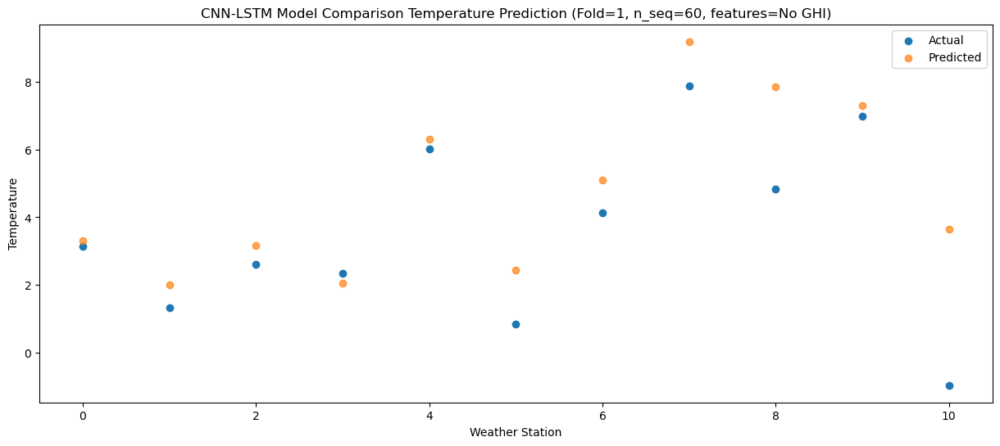

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.78   5.647949
1                 1    2.10   4.322981
2                 2    4.04   5.491372
3                 3    6.18   4.360912
4                 4    9.83   8.633882
5                 5    5.89   4.771110
6                 6    4.80   7.439646
7                 7   10.71  11.540696
8                 8    9.26  10.198933
9                 9   10.73   9.635925
10               10    0.15   5.993591


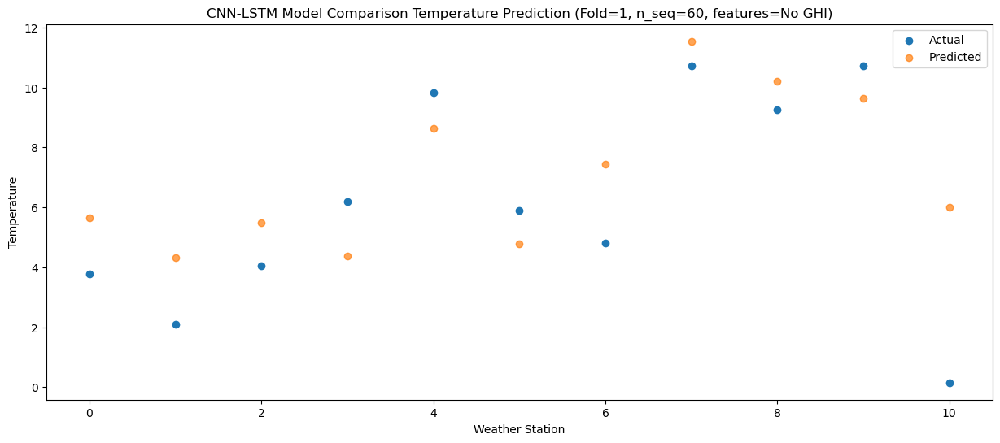

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.28  11.406484
1                 1    5.37  10.087640
2                 2    6.73  11.251850
3                 3    7.02  10.112046
4                 4   10.79  14.386930
5                 5    9.05  10.523418
6                 6    8.06  13.203525
7                 7   15.11  17.316891
8                 8   13.59  15.972097
9                 9   16.08  15.403672
10               10    7.37  11.772295


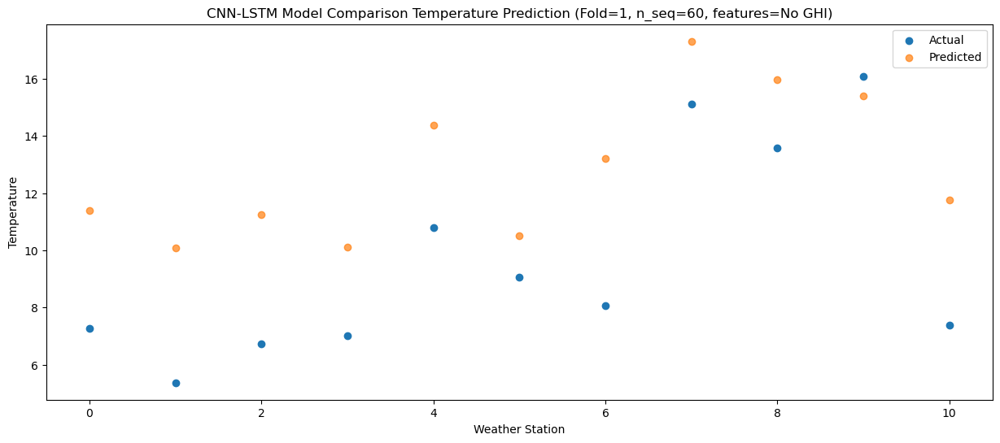

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.78  15.811844
1                 1    8.65  14.499697
2                 2    9.97  15.659360
3                 3   11.61  14.509396
4                 4   15.43  18.786363
5                 5   13.66  14.922024
6                 6   11.06  17.614750
7                 7   20.46  21.741527
8                 8   19.28  20.393417
9                 9   21.19  19.819081
10               10    9.93  16.199698


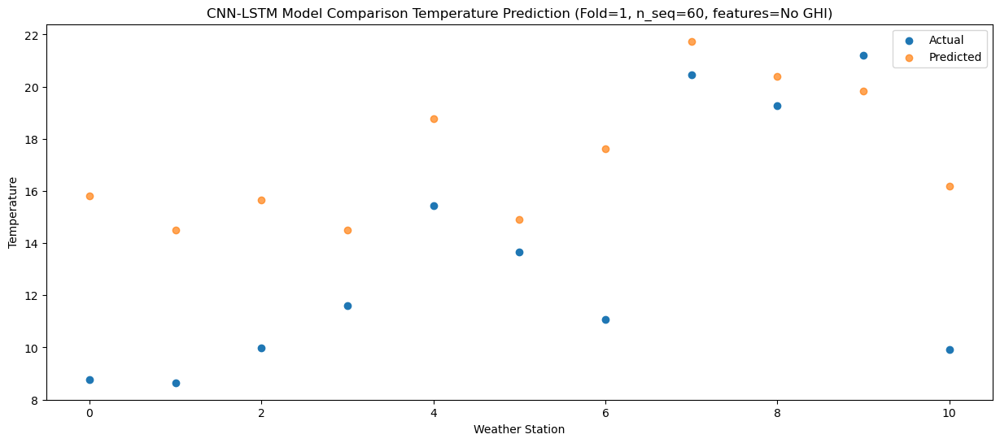

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   12.40  20.030348
1                 1   11.84  18.720314
2                 2   13.72  19.878527
3                 3   15.76  18.725350
4                 4   20.32  23.002981
5                 5   20.35  19.138382
6                 6   14.34  21.835094
7                 7   24.27  25.966112
8                 8   24.21  24.616963
9                 9   24.42  24.040764
10               10   14.30  20.425149


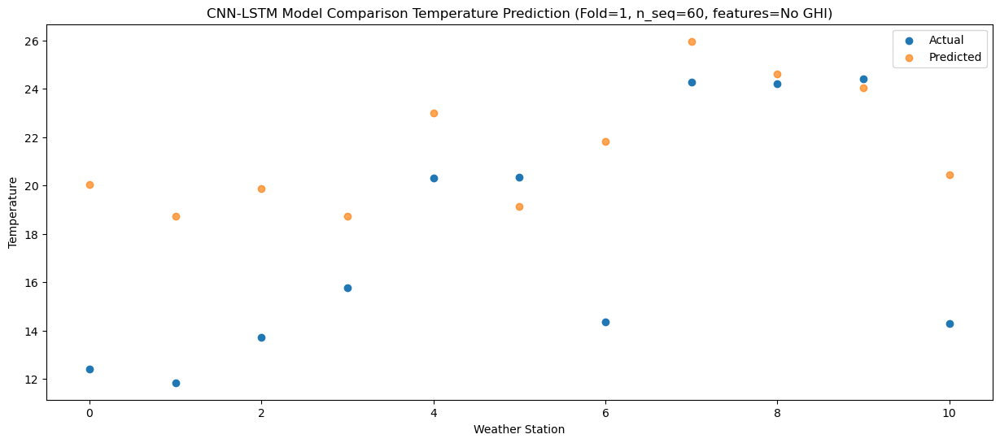

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.63  23.406796
1                 1   15.44  22.102200
2                 2   16.09  23.256706
3                 3   17.48  22.095226
4                 4   22.27  26.374557
5                 5   21.45  22.509293
6                 6   17.79  25.216290
7                 7   26.57  29.358239
8                 8   27.09  28.006409
9                 9   29.04  27.425390
10               10   19.44  23.819514


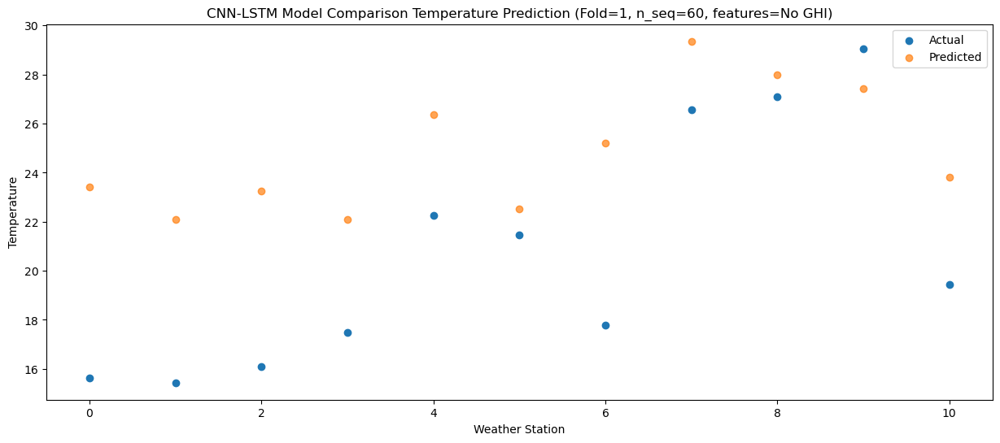

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.42  22.964360
1                 1   14.90  21.662728
2                 2   16.53  22.815210
3                 3   19.45  21.649198
4                 4   23.70  25.929456
5                 5   20.64  22.063840
6                 6   17.37  24.776446
7                 7   27.07  28.924352
8                 8   28.90  27.571060
9                 9   29.44  26.987411
10               10   17.70  23.386852


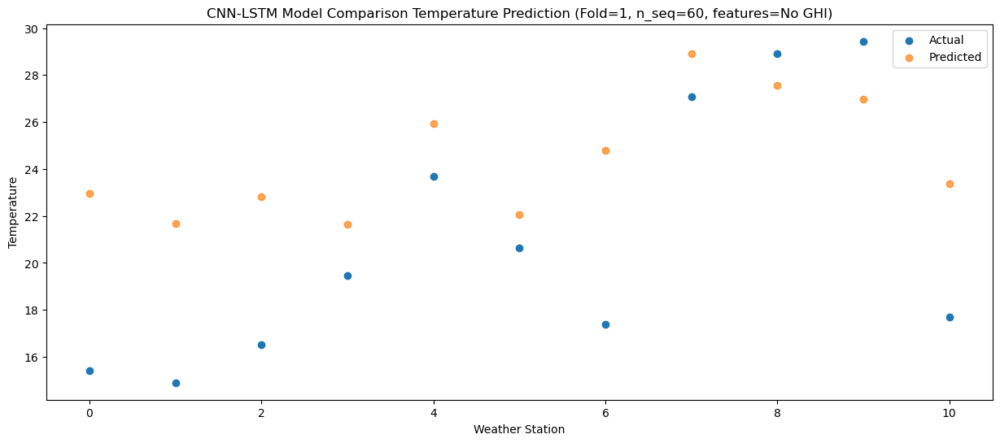

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.73  19.727483
1                 1   11.39  18.428916
2                 2   13.57  19.579286
3                 3   16.37  18.408532
4                 4   19.85  22.689770
5                 5   18.36  18.823791
6                 6   14.20  21.542227
7                 7   23.45  25.696341
8                 8   24.26  24.341554
9                 9   25.92  23.755162
10               10   14.51  20.160059


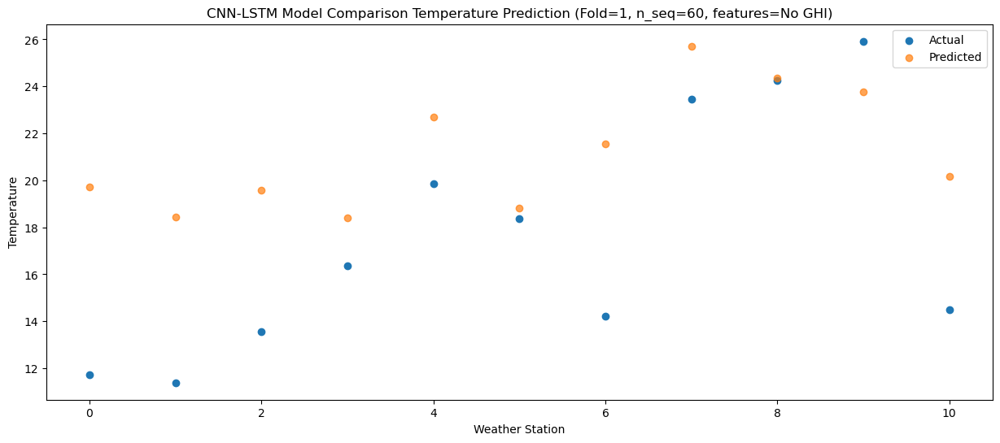

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.85  13.564011
1                 1    6.38  12.270732
2                 2    7.53  13.417501
3                 3    9.11  12.238686
4                 4   12.45  16.521580
5                 5   10.76  12.654957
6                 6    9.19  15.383376
7                 7   17.14  19.548106
8                 8   15.68  18.190707
9                 9   17.82  17.599639
10               10    9.16  14.014000


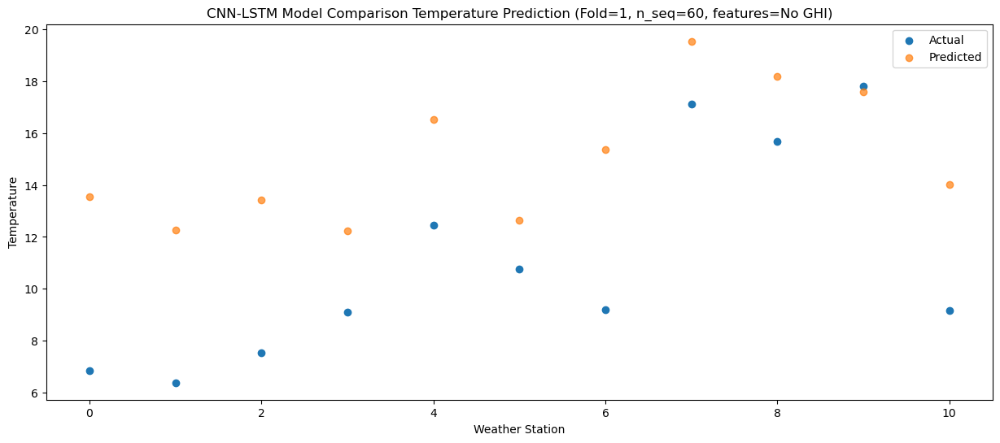

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.70   7.206392
1                 1    0.76   5.911006
2                 2    0.97   7.059223
3                 3    2.83   5.883661
4                 4    6.25  10.165885
5                 5    4.10   6.299512
6                 6    3.50   9.023928
7                 7    9.74  13.184407
8                 8    8.56  11.828036
9                 9   11.07  11.238848
10               10    1.22   7.649444


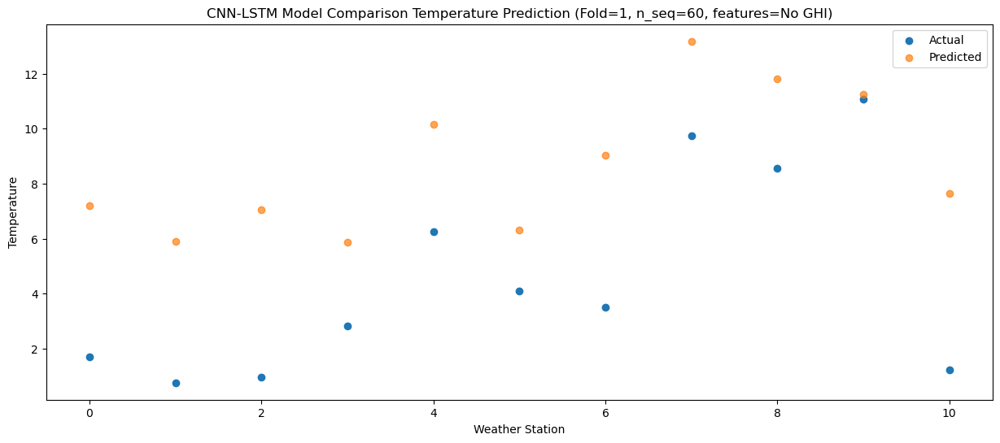

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.33   4.933560
1                 1   -2.38   3.637760
2                 2   -1.81   4.786263
3                 3    0.43   3.611336
4                 4    4.35   7.893430
5                 5    1.74   4.027101
6                 6    0.76   6.750736
7                 7    6.82  10.910384
8                 8    5.71   9.554216
9                 9    7.24   8.965397
10               10   -0.47   5.375251


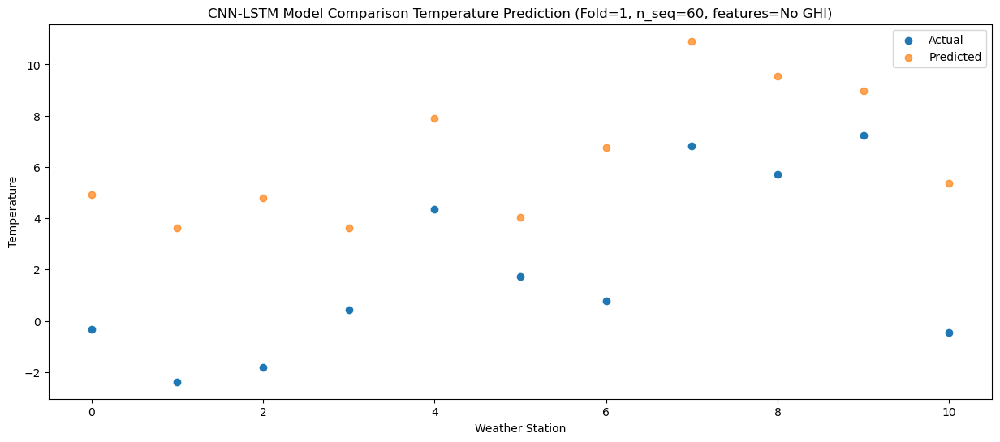

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.65   0.548082
1                 1   -5.66  -0.746708
2                 2   -4.89   0.401104
3                 3   -2.99  -0.775373
4                 4    0.50   3.507040
5                 5   -1.87  -0.359408
6                 6   -2.24   2.366137
7                 7    0.89   6.527816
8                 8   -0.12   5.171155
9                 9    2.07   4.581443
10               10   -4.37   0.993086


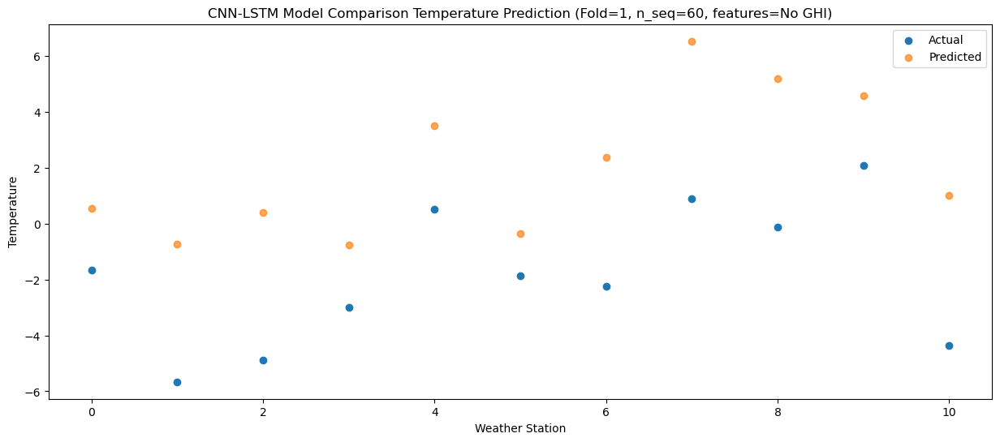

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.27   5.507553
1                 1   -0.58   4.218488
2                 2    0.45   5.362396
3                 3    3.32   4.177181
4                 4    6.87   8.461390
5                 5    4.25   4.594247
6                 6    1.97   7.330606
7                 7    9.89  11.503781
8                 8    7.83  10.144302
9                 9    9.78   9.549522
10               10   -2.42   5.971399


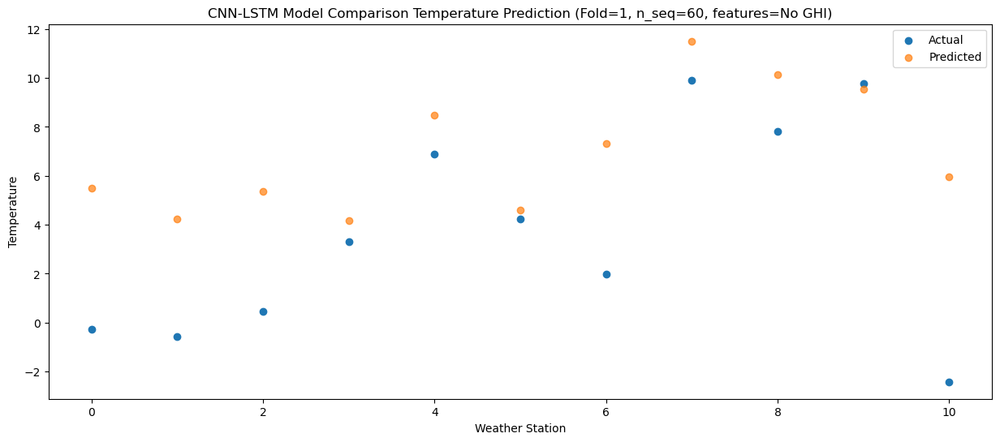

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.58   8.688738
1                 1    2.64   7.403031
2                 2    3.55   8.544646
3                 3    5.83   7.354278
4                 4    9.61  11.639546
5                 5    6.60   7.771998
6                 6    5.63  10.514726
7                 7   12.61  14.694668
8                 8   11.07  13.333534
9                 9   12.61  12.735770
10               10    1.98   9.163654


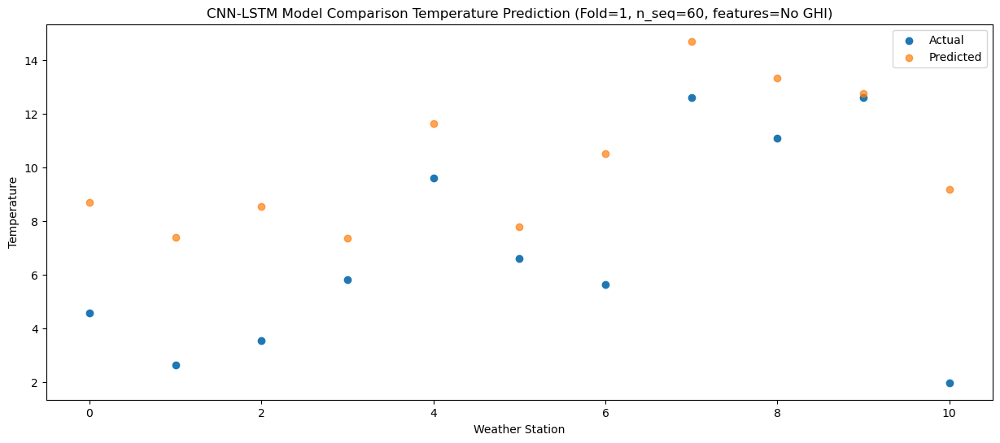

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.98  13.275637
1                 1    6.31  11.990591
2                 2    6.89  13.131748
3                 3    9.31  11.940354
4                 4   13.17  16.225836
5                 5   11.40  12.358212
6                 6    9.10  15.102198
7                 7   16.65  19.283482
8                 8   15.75  17.922025
9                 9   17.68  17.323664
10               10    6.37  13.752735


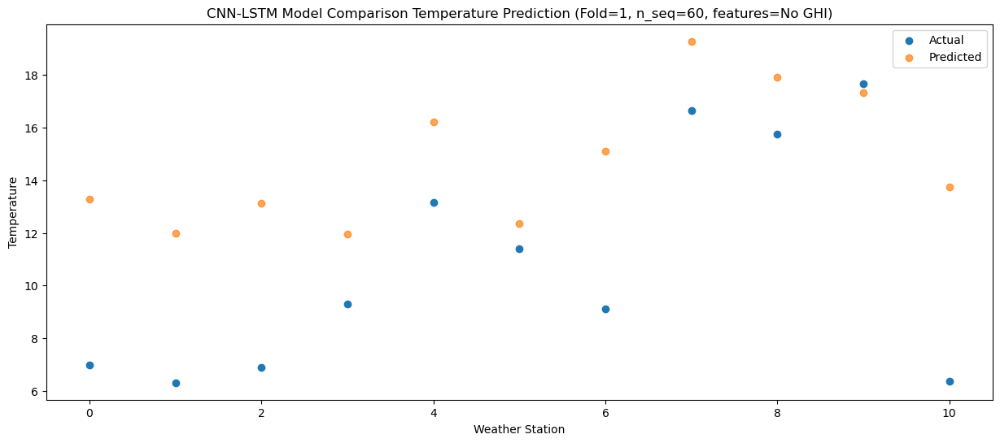

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.65  18.505803
1                 1   10.88  17.225027
2                 2   12.50  18.363270
3                 3   13.01  17.165356
4                 4   16.87  21.452174
5                 5   17.02  17.584037
6                 6   13.34  20.336087
7                 7   22.19  24.525949
8                 8   20.51  23.162393
9                 9   21.82  22.560252
10               10   11.96  18.996941


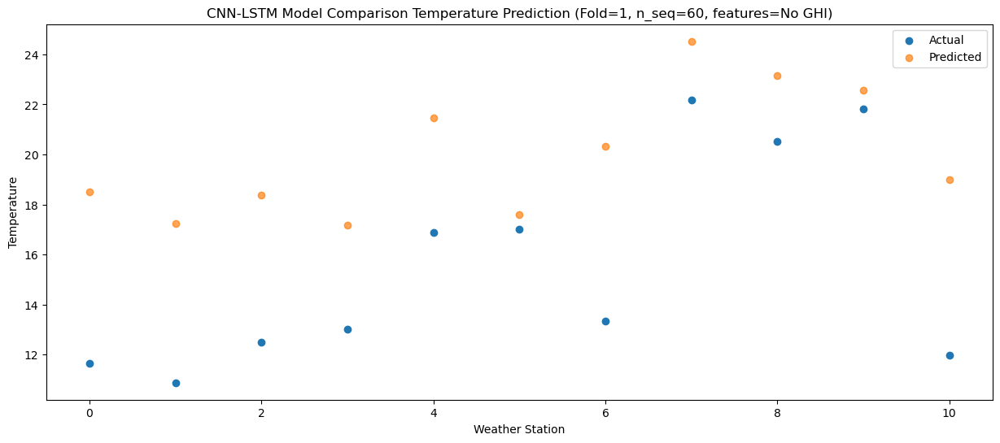

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   14.52  22.884425
1                 1   14.64  21.607071
2                 2   15.61  22.742994
3                 3   15.64  21.539869
4                 4   19.76  25.827757
5                 5   19.88  21.959202
6                 6   17.27  24.717707
7                 7   25.26  28.914435
8                 8   26.21  27.549189
9                 9   28.23  26.944021
10               10   18.07  23.386842


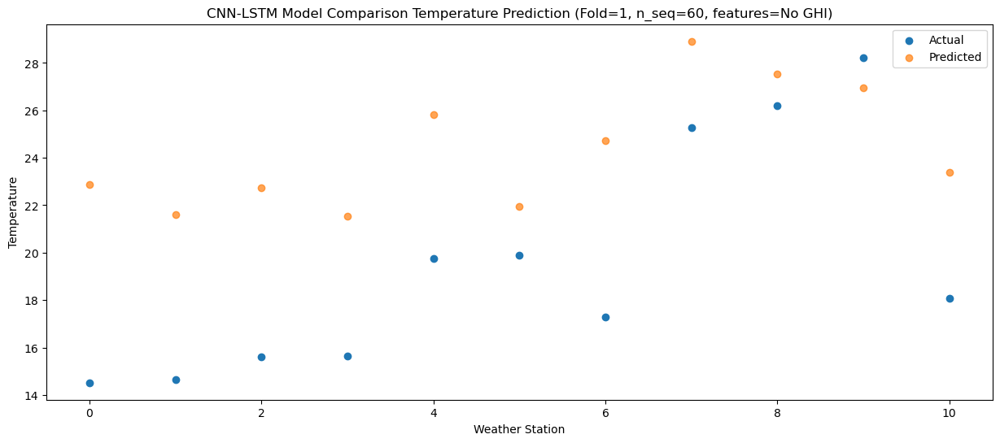

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   15.48  24.012144
1                 1   15.57  22.737245
2                 2   15.63  23.871494
3                 3   15.03  22.664614
4                 4   19.57  26.953275
5                 5   18.88  23.084422
6                 6   18.30  25.847567
7                 7   25.90  30.049226
8                 8   27.06  28.682777
9                 9   28.96  28.075436
10               10   20.00  24.522635


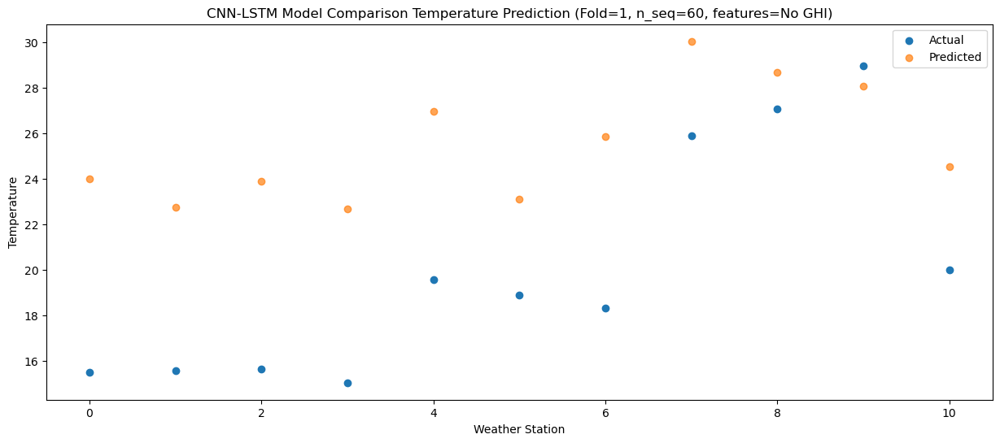

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   14.13  23.318452
1                 1   15.29  22.047303
2                 2   15.94  23.178998
3                 3   16.16  21.966394
4                 4   20.89  26.256232
5                 5   20.48  22.386919
6                 6   17.97  25.157152
7                 7   26.31  29.366341
8                 8   29.17  27.998044
9                 9   29.76  27.387379
10               10   17.85  23.841286


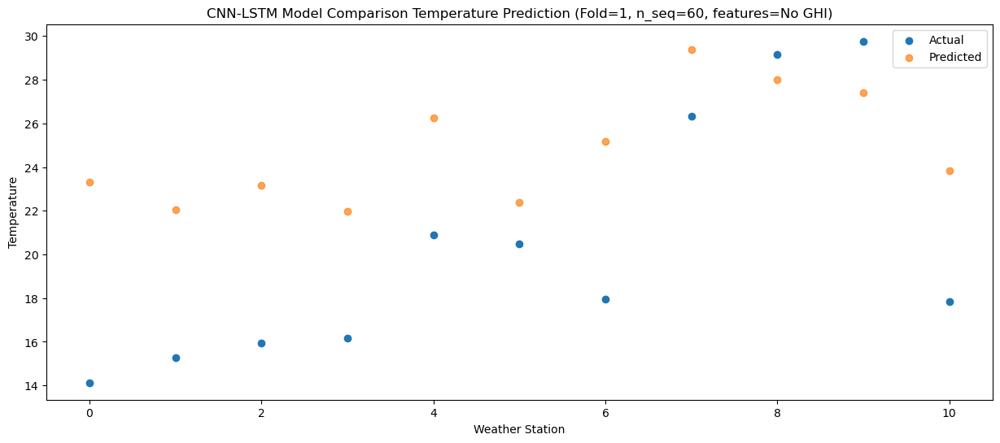

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.69  20.150882
1                 1   11.57  18.879815
2                 2   13.63  20.011466
3                 3   13.56  18.798780
4                 4   17.60  23.088631
5                 5   14.77  19.219303
6                 6   14.67  21.989663
7                 7   24.44  26.198991
8                 8   23.20  24.830642
9                 9   25.20  24.219923
10               10   14.12  20.673984


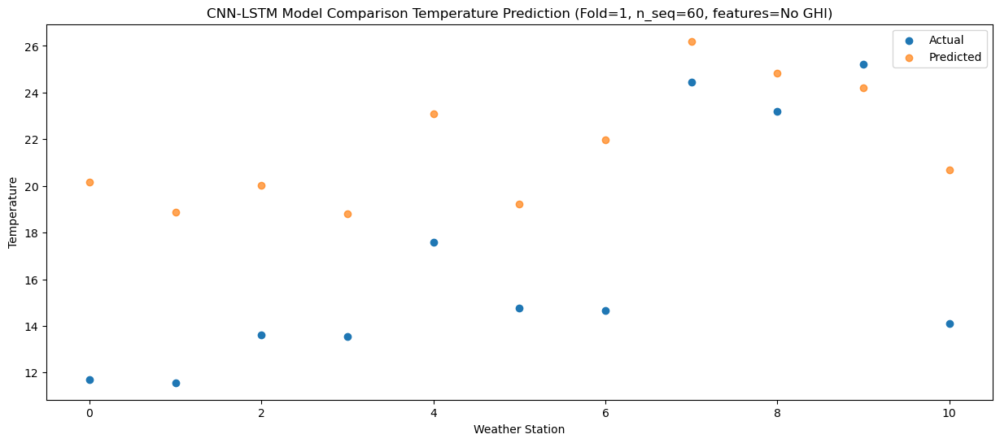

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    6.81  15.397556
1                 1    7.12  14.131162
2                 2    8.63  15.259625
3                 3   10.87  14.039800
4                 4   14.45  18.331115
5                 5   13.62  14.461222
6                 6    9.87  17.240413
7                 7   18.97  21.459134
8                 8   19.34  20.088486
9                 9   20.35  19.473628
10               10    9.25  15.936034


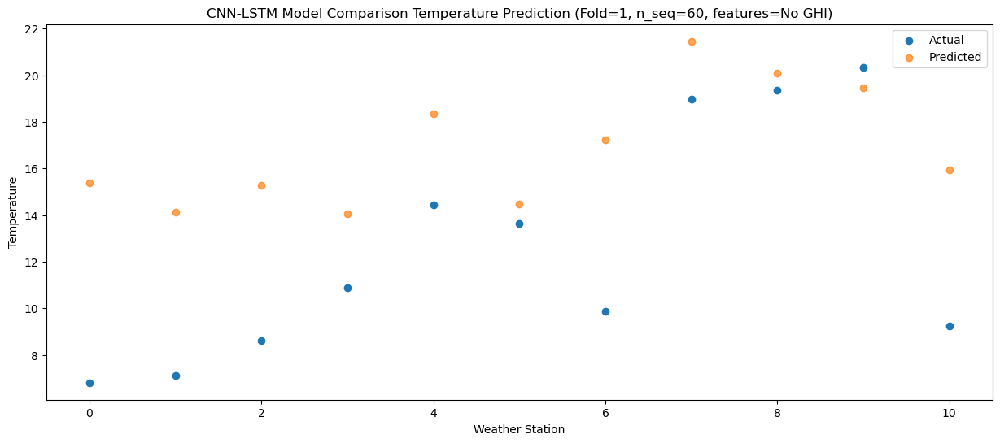

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_1 (Conv1D)           (None, 1, 512)            929792    
                                                                 
 max_pooling1d_1 (MaxPooling  (None, 1, 512)           0         
 1D)                                                             
                                                                 
 dropout_3 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_2 (LSTM)               (None, 1, 1024)           6295552   
                                                                 
 dropout_4 (Dropout)         (None, 1, 1024)           0         
                                                                 
 lstm_3 (LSTM)               (None, 1024)              8392704   
                                                      

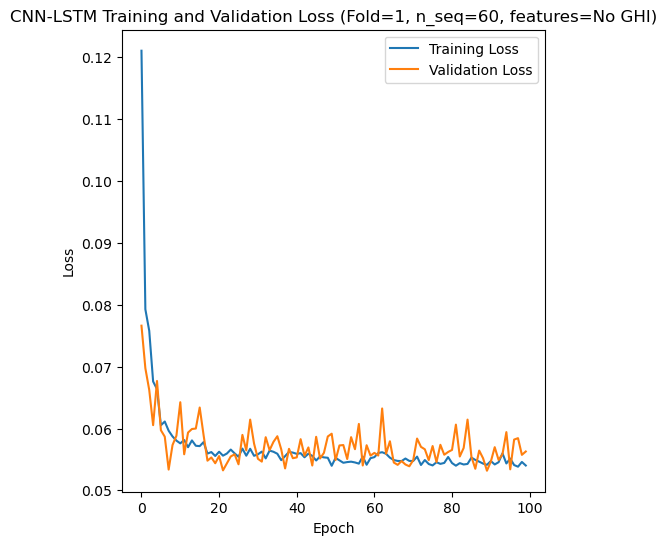

Epoch 1/100
84/84 [==============================] - 19s 98ms/step - loss: 0.1170 - accuracy: 0.3095 - mae: 0.0960 - rmse: 0.1170 - mape: inf - pearson: 0.6624 - val_loss: 0.1096 - val_accuracy: 0.0000e+00 - val_mae: 0.0868 - val_rmse: 0.1096 - val_mape: 16.3618 - val_pearson: 0.7159
Epoch 2/100
84/84 [==============================] - 6s 68ms/step - loss: 0.0835 - accuracy: 0.3690 - mae: 0.0670 - rmse: 0.0835 - mape: inf - pearson: 0.7686 - val_loss: 0.0920 - val_accuracy: 0.6000 - val_mae: 0.0736 - val_rmse: 0.0920 - val_mape: 14.2725 - val_pearson: 0.8133
Epoch 3/100
84/84 [==============================] - 5s 63ms/step - loss: 0.0742 - accuracy: 0.4643 - mae: 0.0596 - rmse: 0.0742 - mape: inf - pearson: 0.8083 - val_loss: 0.0521 - val_accuracy: 0.6000 - val_mae: 0.0421 - val_rmse: 0.0521 - val_mape: 9.3862 - val_pearson: 0.8872
Epoch 4/100
84/84 [==============================] - 6s 67ms/step - loss: 0.0664 - accuracy: 0.4524 - mae: 0.0530 - rmse: 0.0664 - mape: inf - pearson: 0.83

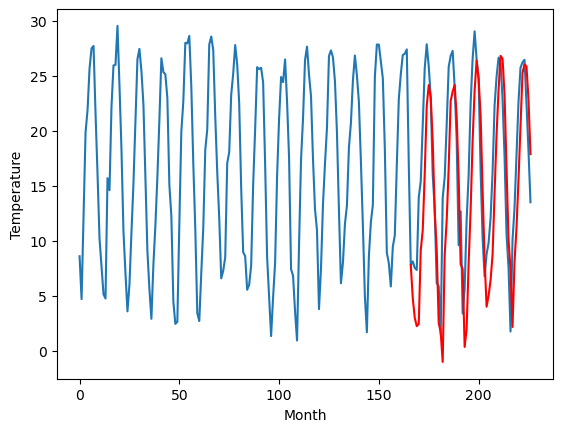

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.57		-0.57		-2.14
-0.71		-2.36		-1.65
-0.95		-3.12		-2.17
-1.68		-2.92		-1.24
6.33		3.78		-2.55
8.56		5.62		-2.94
15.36		10.79		-4.57
22.56		16.90		-5.66
22.59		18.80		-3.79
21.26		17.67		-3.59
15.13		13.67		-1.46
8.14		7.30		-0.84
5.02		3.83		-1.19
-1.61		-2.82		-1.21
-1.69		-3.68		-1.99
-5.73		-6.37		-0.64
4.46		3.39		-1.07
8.22		6.48		-1.74
13.40		11.30		-2.10
20.65		17.37		-3.28
21.34		18.22		-3.12
22.10		18.82		-3.28
19.86		15.96		-3.90
11.60		10.44		-1.16
4.89		2.51		-2.38
2.50		2.07		-0.43
-2.19		-5.01		-2.82
-2.20		-3.37		-1.17
4.78		2.56		-2.22
11.46		7.47		-3.99
17.26		13.74		-3.52
21.06		18.31		-2.75
24.30		21.03		-3.27
21.99		19.39		-2.60
19.23		16.04		-3.19
10.85		9.26		-1.59
0.86		2.97		2.11
-1.85		-1.35		0.50
-2.10		-0.35		1.75
-0.50		1.07		1.57
3.57		3.39		-0.18
9.43		8.92		-0.51
14.92		14.32		-0.60
17.53		18.34		0.81
21.63		21.46		-0.17
22.12		21.20		-0.92
19.25		17.94		-1.3

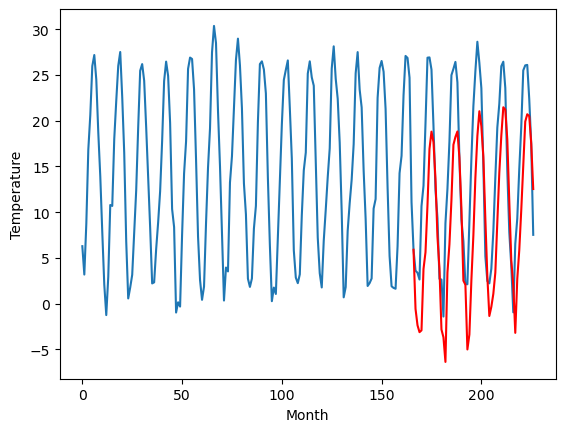

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.66		4.70		-0.96
4.54		2.91		-1.63
3.39		2.15		-1.24
4.43		2.35		-2.08
8.05		9.05		1.00
9.44		10.89		1.45
10.75		16.06		5.31
13.34		22.17		8.83
13.98		24.07		10.09
13.67		22.94		9.27
12.41		18.94		6.53
11.14		12.57		1.43
7.72		9.10		1.38
0.73		2.45		1.72
1.39		1.59		0.20
4.12		-1.10		-5.22
5.93		8.66		2.73
7.74		11.75		4.01
11.32		16.57		5.25
12.54		22.64		10.10
13.33		23.49		10.16
13.38		24.09		10.71
12.10		21.23		9.13
10.96		15.71		4.75
4.11		7.78		3.67
5.01		7.34		2.33
0.75		0.26		-0.49
3.08		1.90		-1.18
6.55		7.83		1.28
8.36		12.74		4.38
11.12		19.01		7.89
12.93		23.58		10.65
13.11		26.30		13.19
12.54		24.66		12.12
11.13		21.31		10.18
8.50		14.53		6.03
6.74		8.24		1.50
2.64		3.92		1.28
2.44		4.92		2.48
5.50		6.34		0.84
6.52		8.66		2.14
9.06		14.19		5.13
10.04		19.59		9.55
12.45		23.61		11.16
14.36		26.73		12.37
14.54		26.47		11.93
12.59		23.21		10.62
9.01		16.45		7.44
5.03		10.01		4.98
3

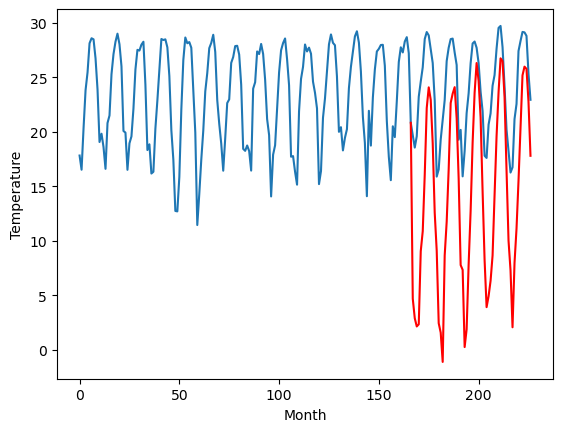

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.01		1.23		1.24
-3.07		-0.56		2.51
-2.80		-1.32		1.48
-2.65		-1.12		1.53
0.90		5.58		4.68
2.13		7.42		5.29
8.02		12.59		4.57
14.08		18.70		4.62
18.36		20.60		2.24
16.51		19.47		2.96
11.93		15.47		3.54
6.71		9.10		2.39
2.75		5.63		2.88
-4.08		-1.02		3.06
-7.16		-1.88		5.28
-7.14		-4.57		2.57
-3.03		5.19		8.22
1.47		8.28		6.81
6.73		13.10		6.37
12.30		19.17		6.87
14.30		20.02		5.72
15.36		20.62		5.26
12.19		17.76		5.57
8.36		12.24		3.88
0.28		4.31		4.03
-1.64		3.87		5.51
-7.79		-3.21		4.58
-5.47		-1.57		3.90
-1.61		4.36		5.97
2.83		9.27		6.44
8.17		15.54		7.37
12.41		20.11		7.70
17.03		22.83		5.80
16.95		21.19		4.24
11.91		17.84		5.93
6.47		11.06		4.59
2.67		4.77		2.10
-3.50		0.45		3.95
-2.21		1.45		3.66
-4.09		2.87		6.96
-1.65		5.19		6.84
4.07		10.72		6.65
7.70		16.12		8.42
11.49		20.14		8.65
17.06		23.26		6.20
15.05		23.00		7.95
12.63		19.74		7.11
7.61		12.98		5.37
-0.37		6.54		6.91
-1.11		

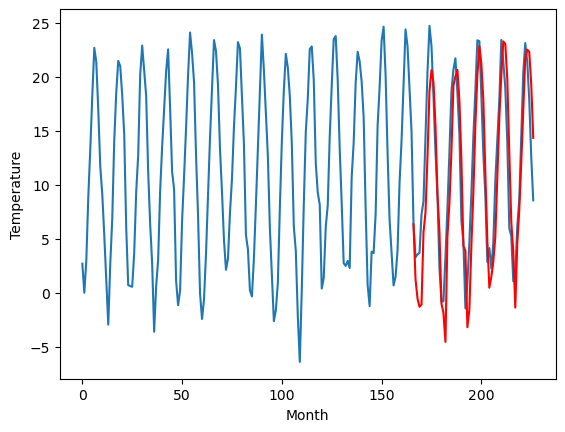

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.32		1.27		1.59
0.03		-0.52		-0.55
0.37		-1.28		-1.65
1.01		-1.08		-2.09
7.70		5.62		-2.08
7.17		7.46		0.29
10.14		12.63		2.49
13.18		18.74		5.56
13.92		20.64		6.72
14.29		19.51		5.22
11.94		15.51		3.57
8.25		9.14		0.89
4.13		5.67		1.54
-2.17		-0.98		1.19
-1.82		-1.84		-0.02
-2.56		-4.53		-1.97
4.77		5.23		0.46
5.64		8.32		2.68
10.11		13.14		3.03
13.59		19.21		5.62
14.18		20.06		5.88
14.35		20.66		6.31
11.81		17.80		5.99
9.07		12.28		3.21
0.80		4.35		3.55
4.21		3.91		-0.30
-3.52		-3.17		0.35
-0.38		-1.53		-1.15
3.38		4.40		1.02
7.18		9.31		2.13
12.34		15.58		3.24
14.93		20.15		5.22
14.76		22.87		8.11
13.94		21.23		7.29
11.97		17.88		5.91
5.78		11.10		5.32
2.71		4.81		2.10
0.20		0.49		0.29
1.37		1.49		0.12
3.50		2.91		-0.59
5.33		5.23		-0.10
7.25		10.76		3.51
11.28		16.16		4.88
14.93		20.18		5.25
16.37		23.30		6.93
17.67		23.04		5.37
13.24		19.78		6.54
7.08		13.02		5.94
1.97		6.58		4.61
-0.6

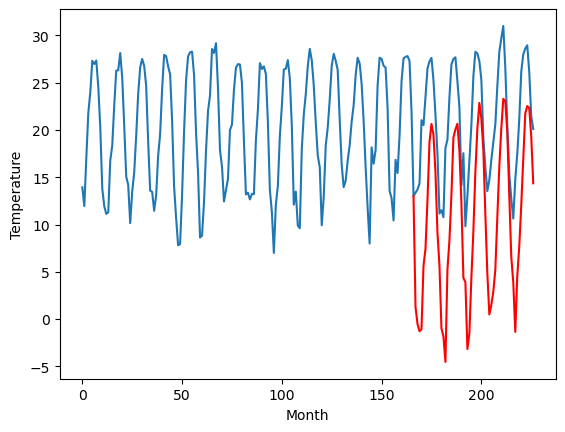

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.39		-1.06		-0.67
-1.82		-2.85		-1.03
-1.45		-3.61		-2.16
-2.21		-3.41		-1.20
5.88		3.29		-2.59
5.85		5.13		-0.72
9.69		10.30		0.61
13.30		16.41		3.11
15.00		18.31		3.31
15.30		17.18		1.88
10.90		13.18		2.28
6.43		6.81		0.38
3.75		3.34		-0.41
-2.36		-3.31		-0.95
-2.95		-4.17		-1.22
-5.30		-6.86		-1.56
3.08		2.90		-0.18
5.20		5.99		0.79
9.24		10.81		1.57
13.79		16.88		3.09
13.87		17.73		3.86
14.98		18.33		3.35
12.24		15.47		3.23
8.94		9.95		1.01
1.30		2.02		0.72
4.54		1.58		-2.96
-3.89		-5.50		-1.61
-4.27		-3.86		0.41
1.85		2.07		0.22
8.00		6.98		-1.02
12.60		13.25		0.65
16.32		17.82		1.50
17.68		20.54		2.86
14.96		18.90		3.94
12.30		15.55		3.25
6.73		8.77		2.04
0.85		2.48		1.63
-1.38		-1.84		-0.46
-0.62		-0.84		-0.22
0.57		0.58		0.01
4.37		2.90		-1.47
5.29		8.43		3.14
10.37		13.83		3.46
15.29		17.85		2.56
17.45		20.97		3.52
19.15		20.71		1.56
14.67		17.45		2.78
6.78		10.69		3.91
0.50		4.25	

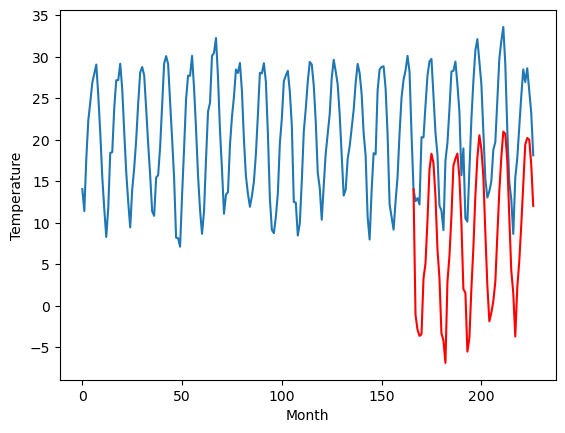

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
10.42		10.48		0.06
8.61		8.69		0.08
8.96		7.93		-1.03
8.40		8.13		-0.27
16.05		14.83		-1.22
16.36		16.67		0.31
21.26		21.84		0.58
26.00		27.95		1.95
27.18		29.85		2.67
27.41		28.72		1.31
21.47		24.72		3.25
15.99		18.35		2.36
13.50		14.88		1.38
7.04		8.23		1.19
6.34		7.37		1.03
3.23		4.68		1.45
13.60		14.44		0.84
15.30		17.53		2.23
19.38		22.35		2.97
24.94		28.42		3.48
25.83		29.27		3.44
26.39		29.87		3.48
24.12		27.01		2.89
19.61		21.49		1.88
11.64		13.56		1.92
13.93		13.12		-0.81
5.45		6.04		0.59
5.28		7.68		2.40
11.86		13.61		1.75
18.13		18.52		0.39
23.15		24.79		1.64
27.86		29.36		1.50
30.65		32.08		1.43
27.84		30.44		2.60
24.01		27.09		3.08
17.63		20.31		2.68
10.96		14.02		3.06
8.34		9.70		1.36
9.22		10.70		1.48
9.41		12.12		2.71
14.06		14.44		0.38
15.88		19.97		4.09
21.62		25.37		3.75
25.77		29.39		3.62
28.33		32.51		4.18
30.67		32.25		1.58
25.89		28.99		3.10
17.17		22.23		5.06
11.83		15

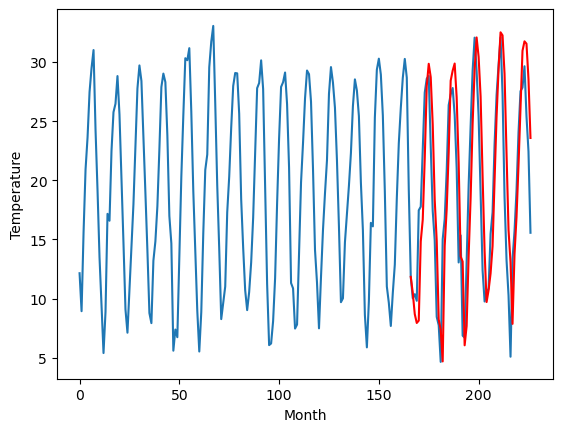

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.43		-4.66		-1.23
-7.96		-6.45		1.51
-6.71		-7.21		-0.50
-5.90		-7.01		-1.11
-1.40		-0.31		1.09
3.58		1.53		-2.05
9.87		6.70		-3.17
13.39		12.81		-0.58
15.49		14.71		-0.78
15.93		13.58		-2.35
9.68		9.58		-0.10
4.08		3.21		-0.87
-1.48		-0.26		1.22
-9.13		-6.91		2.22
-8.59		-7.77		0.82
-5.67		-10.46		-4.79
-2.57		-0.70		1.87
4.09		2.39		-1.70
9.10		7.21		-1.89
14.09		13.28		-0.81
12.89		14.13		1.24
12.37		14.73		2.36
10.19		11.87		1.68
3.63		6.35		2.72
-1.77		-1.58		0.19
-5.12		-2.02		3.10
-8.12		-9.10		-0.98
-7.15		-7.46		-0.31
-2.09		-1.53		0.56
5.10		3.38		-1.72
9.80		9.65		-0.15
13.66		14.22		0.56
14.80		16.94		2.14
11.78		15.30		3.52
10.05		11.95		1.90
1.84		5.17		3.33
-5.05		-1.12		3.93
-7.22		-5.44		1.78
-7.93		-4.44		3.49
-6.72		-3.02		3.70
-2.02		-0.70		1.32
3.62		4.83		1.21
8.27		10.23		1.96
12.93		14.25		1.32
17.68		17.37		-0.31
14.68		17.11		2.43
12.02		13.85		1.83
5.28		7.09		1.8

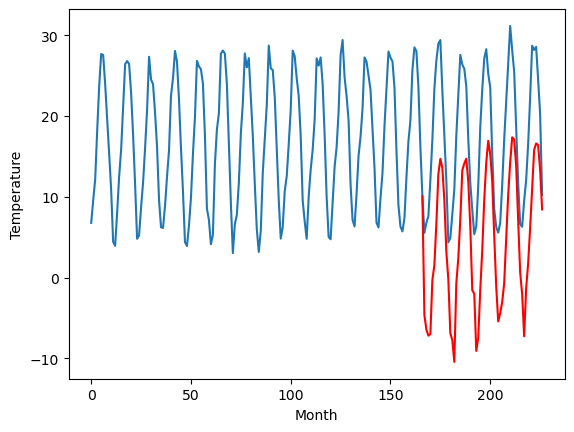

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.34		6.60		-2.74
5.80		4.81		-0.99
6.34		4.05		-2.29
8.45		4.25		-4.20
8.52		10.95		2.43
11.73		12.79		1.06
15.78		17.96		2.18
17.07		24.07		7.00
19.48		25.97		6.49
21.88		24.84		2.96
20.28		20.84		0.56
17.04		14.47		-2.57
10.32		11.00		0.68
8.27		4.35		-3.92
8.21		3.49		-4.72
7.29		0.80		-6.49
6.89		10.56		3.67
10.75		13.65		2.90
12.97		18.47		5.50
17.21		24.54		7.33
20.19		25.39		5.20
19.79		25.99		6.20
18.01		23.13		5.12
13.03		17.61		4.58
11.77		9.68		-2.09
5.26		9.24		3.98
7.67		2.16		-5.51
8.54		3.80		-4.74
10.33		9.73		-0.60
12.45		14.64		2.19
13.41		20.91		7.50
18.33		25.48		7.15
19.14		28.20		9.06
21.18		26.56		5.38
20.77		23.21		2.44
14.50		16.43		1.93
8.27		10.14		1.87
5.57		5.82		0.25
5.23		6.82		1.59
4.91		8.24		3.33
5.92		10.56		4.64
9.76		16.09		6.33
10.97		21.49		10.52
12.93		25.51		12.58
19.85		28.63		8.78
19.48		28.37		8.89
15.98		25.11		9.13
14.39		18.35		3.96
10.00		11.91

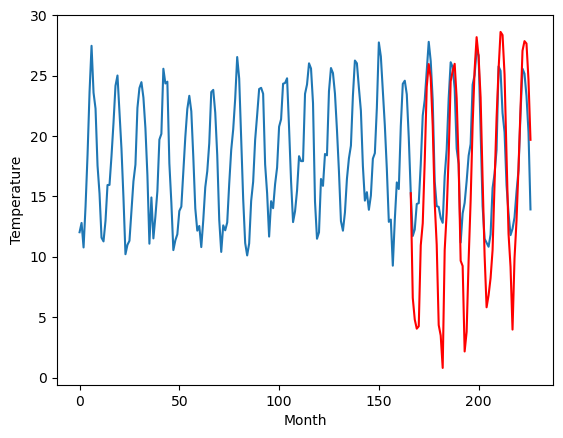

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		6.71		2.66
3.64		4.92		1.28
3.35		4.16		0.81
4.39		4.36		-0.03
9.62		11.06		1.44
10.92		12.90		1.98
13.52		18.07		4.55
18.81		24.18		5.37
21.80		26.08		4.28
20.80		24.95		4.15
16.77		20.95		4.18
12.85		14.58		1.73
8.24		11.11		2.87
1.24		4.46		3.22
0.83		3.60		2.77
1.33		0.91		-0.42
8.21		10.67		2.46
11.00		13.76		2.76
15.02		18.58		3.56
19.31		24.65		5.34
20.88		25.50		4.62
20.97		26.10		5.13
16.86		23.24		6.38
13.58		17.72		4.14
4.67		9.79		5.12
6.59		9.35		2.76
0.11		2.27		2.16
4.13		3.91		-0.22
8.24		9.84		1.60
11.53		14.75		3.22
16.38		21.02		4.64
20.14		25.59		5.45
21.58		28.31		6.73
20.20		26.67		6.47
16.89		23.32		6.43
9.58		16.54		6.96
7.46		10.25		2.79
0.93		5.93		5.00
4.13		6.93		2.80
7.15		8.35		1.20
7.60		10.67		3.07
11.12		16.20		5.08
13.90		21.60		7.70
17.56		25.62		8.06
21.15		28.74		7.59
20.60		28.48		7.88
16.64		25.22		8.58
11.35		18.46		7.11
5.45		12.02		6.57
2.98		9

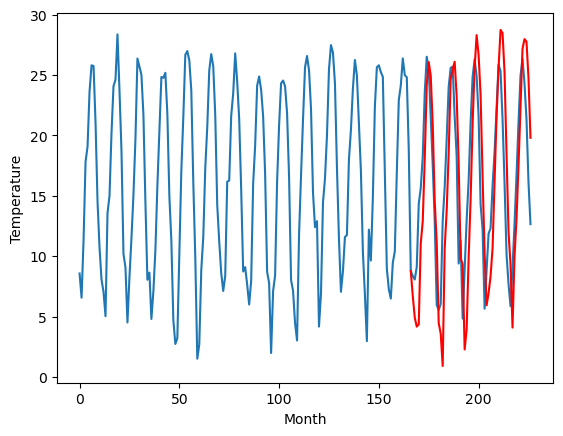

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		4.80		3.15
2.25		3.01		0.76
1.81		2.25		0.44
1.61		2.45		0.84
7.65		9.15		1.50
8.08		10.99		2.91
12.12		16.16		4.04
17.49		22.27		4.78
20.78		24.17		3.39
19.52		23.04		3.52
15.57		19.04		3.47
10.91		12.67		1.76
5.86		9.20		3.34
-1.20		2.55		3.75
-0.87		1.69		2.56
0.48		-1.00		-1.48
6.69		8.76		2.07
8.66		11.85		3.19
13.57		16.67		3.10
18.98		22.74		3.76
20.29		23.59		3.30
20.37		24.19		3.82
15.88		21.33		5.45
12.12		15.81		3.69
1.90		7.88		5.98
4.00		7.44		3.44
-2.87		0.36		3.23
1.72		2.00		0.28
6.27		7.93		1.66
9.43		12.84		3.41
15.67		19.11		3.44
19.32		23.68		4.36
20.67		26.40		5.73
19.42		24.76		5.34
15.27		21.41		6.14
7.99		14.63		6.64
5.54		8.34		2.80
0.08		4.02		3.94
2.00		5.02		3.02
4.79		6.44		1.65
5.32		8.76		3.44
10.21		14.29		4.08
13.56		19.69		6.13
16.47		23.71		7.24
20.02		26.83		6.81
19.31		26.57		7.26
16.53		23.31		6.78
10.48		16.55		6.07
4.27		10.11		5.84
1.42		7.39		5

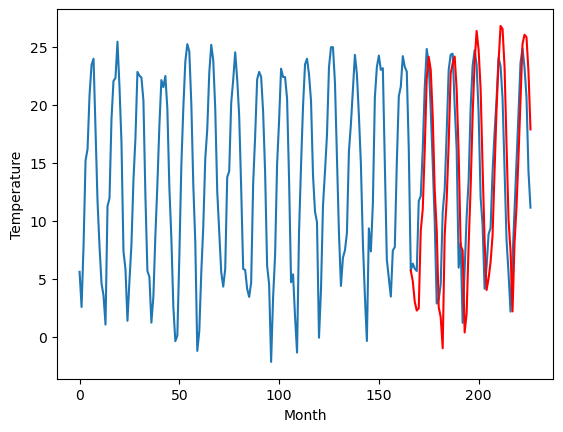

RangeIndex(start=1, stop=12, step=1)
[2.9200000000000017, 1.5699999999999985, 5.66, -0.009999999999999787, -0.3200000000000003, -0.39000000000000057, 10.42, -3.430000000000002, 9.339999999999996, 4.050000000000001, 1.6500000000000021]
[4.802961959838868, -0.567039947509766, 4.702957191467284, 1.2329600524902347, 1.2729590988159174, -1.0570399475097654, 10.482961959838867, -4.657040901184082, 6.6029590988159175, 6.712960052490235, 4.802960052490235]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.92   4.802962
1                 1    1.57  -0.567040
2                 2    5.66   4.702957
3                 3   -0.01   1.232960
4                 4   -0.32   1.272959
5                 5   -0.39  -1.057040
6                 6   10.42  10.482962
7                 7   -3.43  -4.657041
8                 8    9.34   6.602959
9                 9    4.05   6.712960
10               10    1.65   4.802960


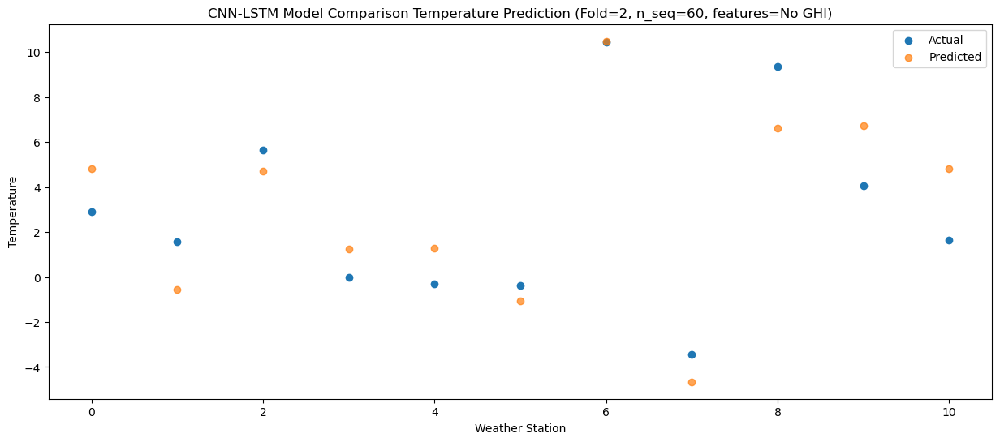

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    3.26   3.005129
1                 1   -0.71  -2.364871
2                 2    4.54   2.905113
3                 3   -3.07  -0.564872
4                 4    0.03  -0.524884
5                 5   -1.82  -2.854879
6                 6    8.61   8.685131
7                 7   -7.96  -6.454876
8                 8    5.80   4.805116
9                 9    3.64   4.915124
10               10    2.25   3.005123


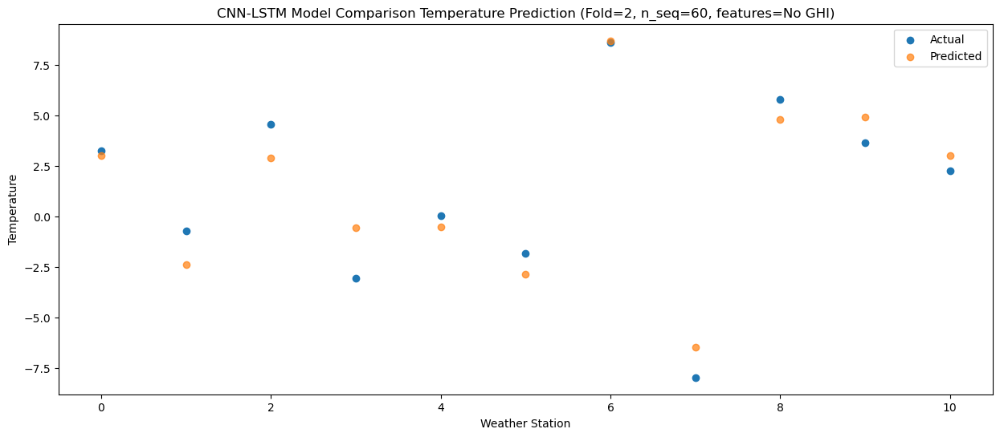

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    2.67   2.253638
1                 1   -0.95  -3.116366
2                 2    3.39   2.153640
3                 3   -2.80  -1.316359
4                 4    0.37  -1.276363
5                 5   -1.45  -3.606360
6                 6    8.96   7.933643
7                 7   -6.71  -7.206359
8                 8    6.34   4.053635
9                 9    3.35   4.163648
10               10    1.81   2.253642


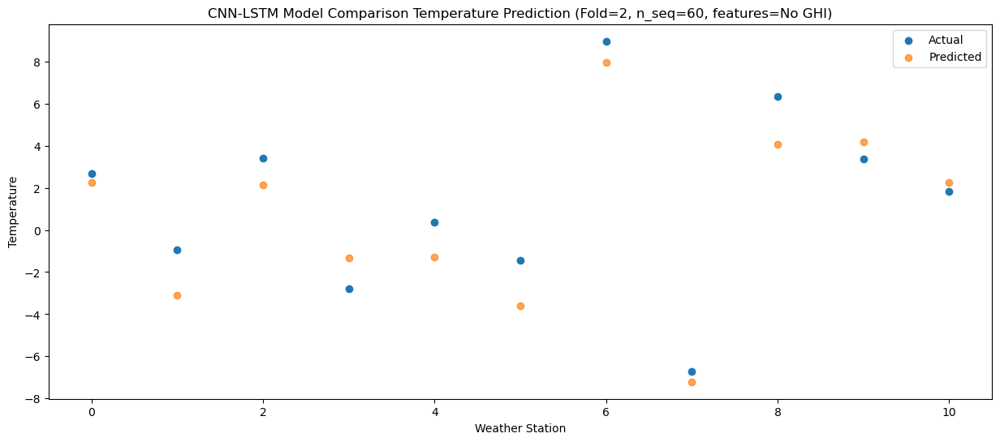

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    2.48   2.452750
1                 1   -1.68  -2.917244
2                 2    4.43   2.352711
3                 3   -2.65  -1.117258
4                 4    1.01  -1.077284
5                 5   -2.21  -3.407269
6                 6    8.40   8.132750
7                 7   -5.90  -7.007262
8                 8    8.45   4.252714
9                 9    4.39   4.362736
10               10    1.61   2.452737


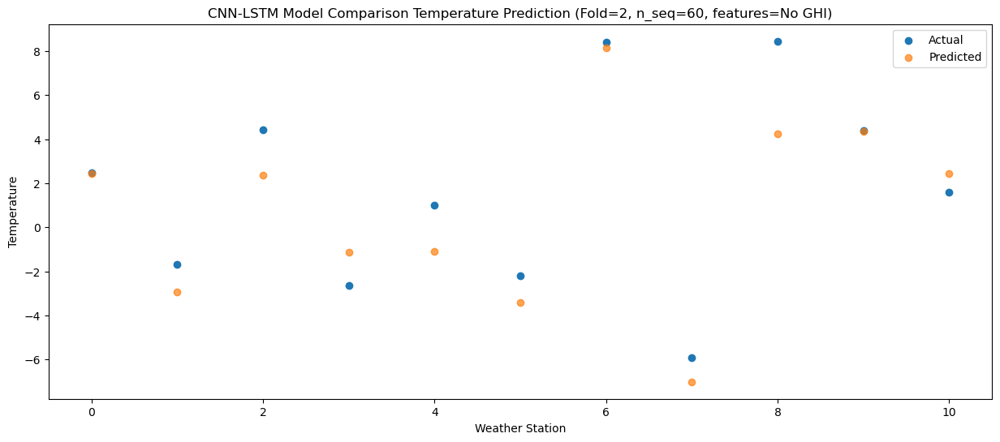

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    9.07   9.152011
1                 1    6.33   3.782013
2                 2    8.05   9.051991
3                 3    0.90   5.582010
4                 4    7.70   5.621988
5                 5    5.88   3.291999
6                 6   16.05  14.832019
7                 7   -1.40  -0.307990
8                 8    8.52  10.951986
9                 9    9.62  11.062008
10               10    7.65   9.152009


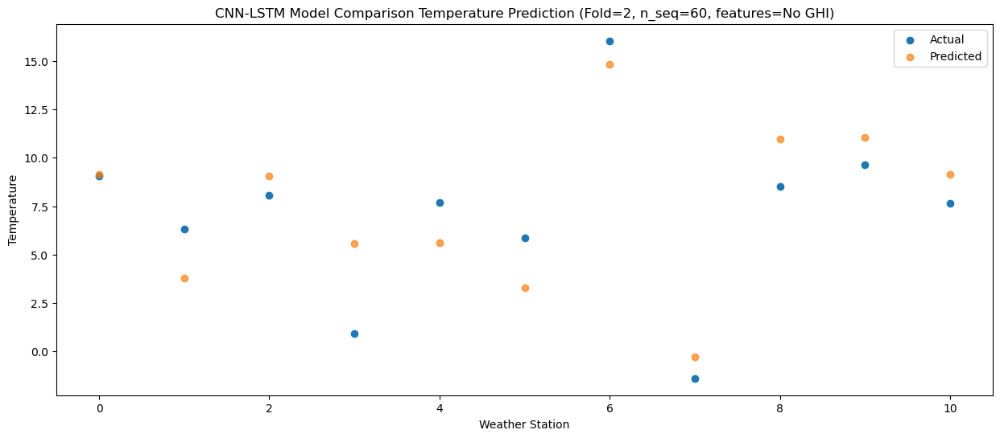

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   10.55  10.986018
1                 1    8.56   5.616020
2                 2    9.44  10.886018
3                 3    2.13   7.416025
4                 4    7.17   7.456013
5                 5    5.85   5.126018
6                 6   16.36  16.666030
7                 7    3.58   1.526029
8                 8   11.73  12.786009
9                 9   10.92  12.896025
10               10    8.08  10.986024


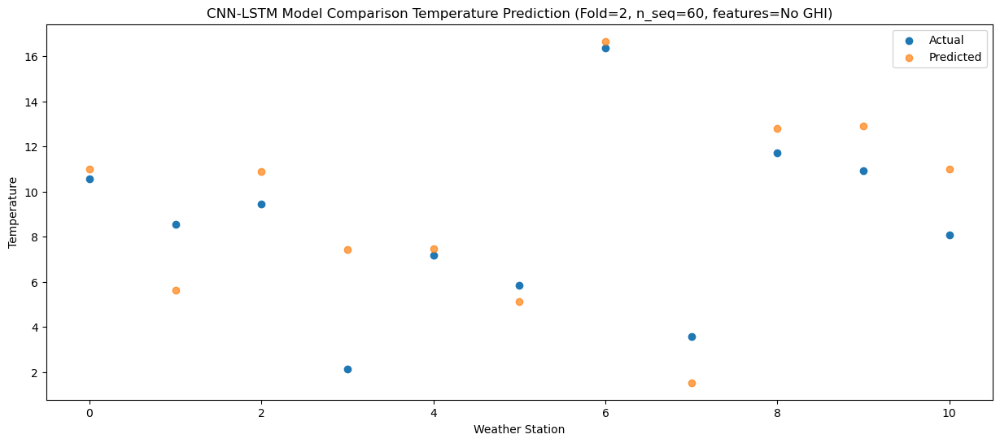

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   15.84  16.156354
1                 1   15.36  10.786350
2                 2   10.75  16.056365
3                 3    8.02  12.586363
4                 4   10.14  12.626353
5                 5    9.69  10.296358
6                 6   21.26  21.836366
7                 7    9.87   6.696369
8                 8   15.78  17.956351
9                 9   13.52  18.066364
10               10   12.12  16.156364


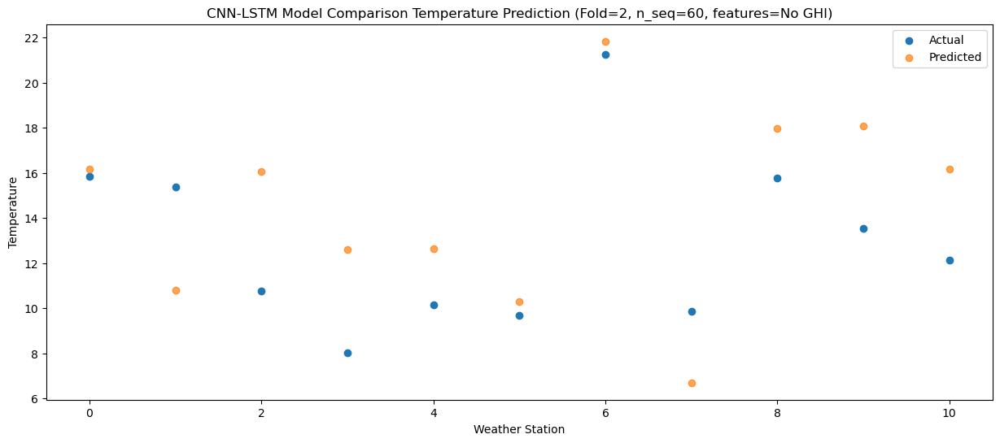

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   20.84  22.273979
1                 1   22.56  16.903989
2                 2   13.34  22.173956
3                 3   14.08  18.703978
4                 4   13.18  18.743953
5                 5   13.30  16.413968
6                 6   26.00  27.953991
7                 7   13.39  12.813980
8                 8   17.07  24.073951
9                 9   18.81  24.183970
10               10   17.49  22.273975


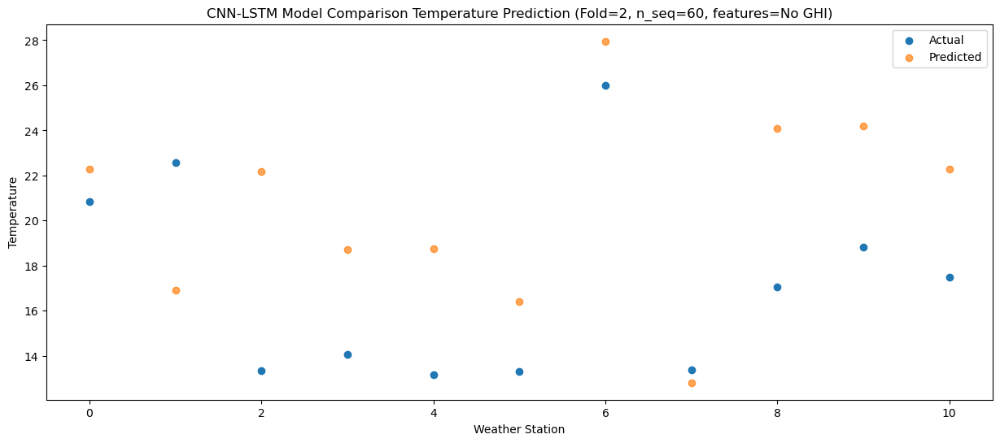

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   23.00  24.168408
1                 1   22.59  18.798417
2                 2   13.98  24.068388
3                 3   18.36  20.598403
4                 4   13.92  20.638383
5                 5   15.00  18.308401
6                 6   27.18  29.848420
7                 7   15.49  14.708411
8                 8   19.48  25.968384
9                 9   21.80  26.078399
10               10   20.78  24.168402


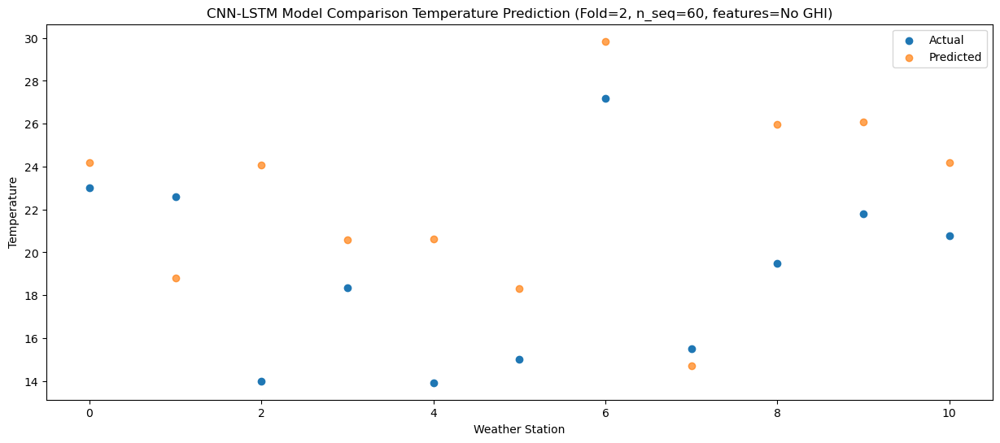

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   21.02  23.037477
1                 1   21.26  17.667483
2                 2   13.67  22.937461
3                 3   16.51  19.467474
4                 4   14.29  19.507454
5                 5   15.30  17.177473
6                 6   27.41  28.717488
7                 7   15.93  13.577483
8                 8   21.88  24.837453
9                 9   20.80  24.947467
10               10   19.52  23.037472


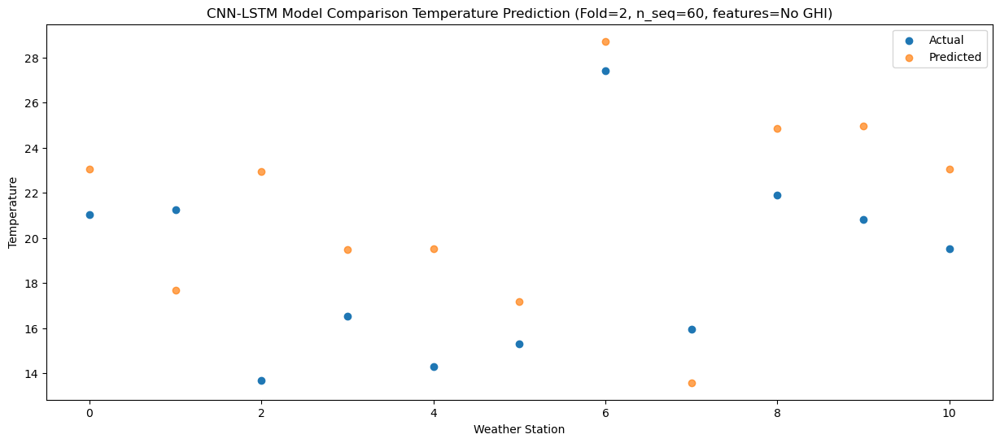

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   18.18  19.036070
1                 1   15.13  13.666081
2                 2   12.41  18.936047
3                 3   11.93  15.466068
4                 4   11.94  15.506039
5                 5   10.90  13.176064
6                 6   21.47  24.716081
7                 7    9.68   9.576073
8                 8   20.28  20.836037
9                 9   16.77  20.946055
10               10   15.57  19.036063


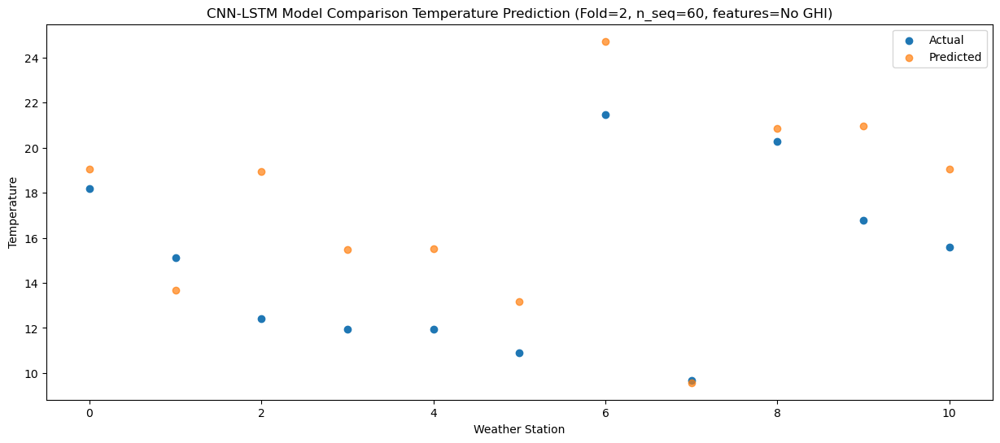

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   11.17  12.673866
1                 1    8.14   7.303855
2                 2   11.14  12.573902
3                 3    6.71   9.103877
4                 4    8.25   9.143876
5                 5    6.43   6.813882
6                 6   15.99  18.353884
7                 7    4.08   3.213889
8                 8   17.04  14.473874
9                 9   12.85  14.583880
10               10   10.91  12.673880


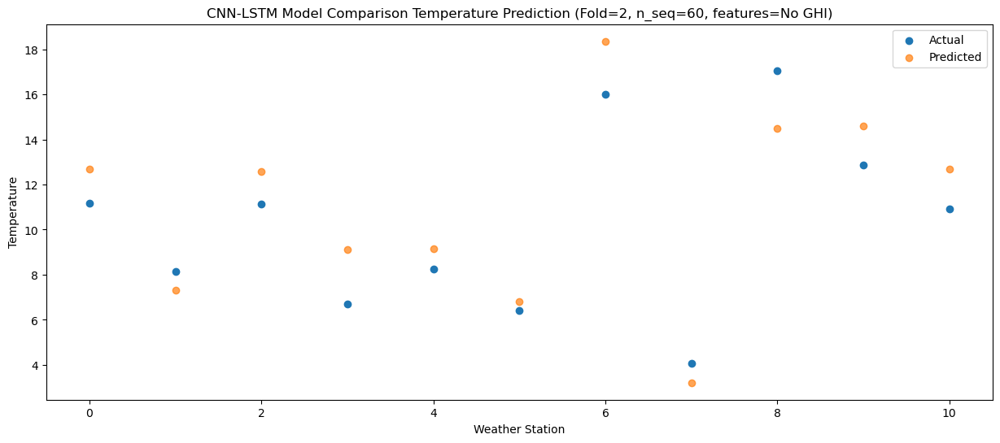

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    8.04   9.201600
1                 1    5.02   3.831599
2                 2    7.72   9.101616
3                 3    2.75   5.631607
4                 4    4.13   5.671597
5                 5    3.75   3.341609
6                 6   13.50  14.881616
7                 7   -1.48  -0.258386
8                 8   10.32  11.001595
9                 9    8.24  11.111606
10               10    5.86   9.201606


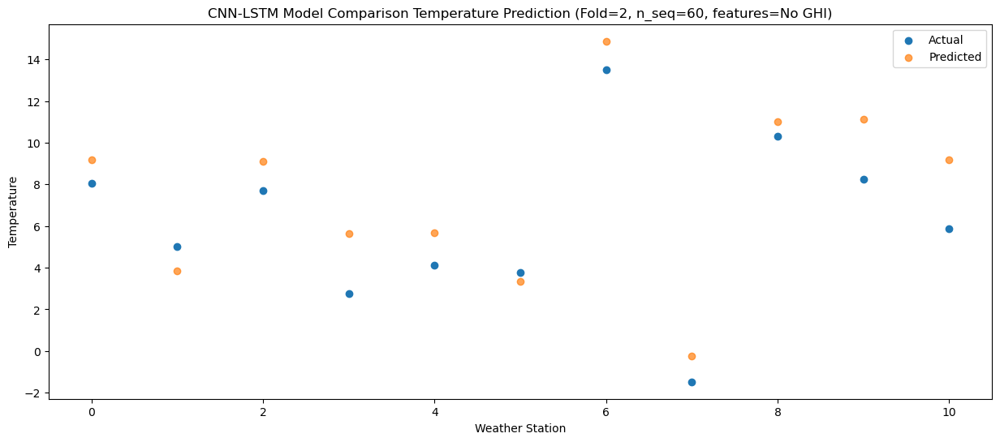

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.28   2.551625
1                 1   -1.61  -2.818373
2                 2    0.73   2.451636
3                 3   -4.08  -1.018368
4                 4   -2.17  -0.978381
5                 5   -2.36  -3.308368
6                 6    7.04   8.231640
7                 7   -9.13  -6.908360
8                 8    8.27   4.351617
9                 9    1.24   4.461631
10               10   -1.20   2.551630


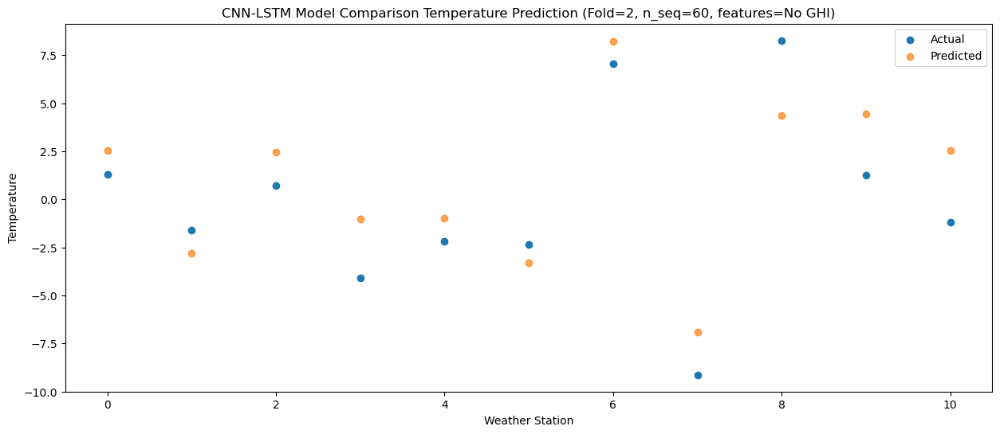

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.02   1.687728
1                 1   -1.69  -3.682272
2                 2    1.39   1.587739
3                 3   -7.16  -1.882265
4                 4   -1.82  -1.842276
5                 5   -2.95  -4.172269
6                 6    6.34   7.367741
7                 7   -8.59  -7.772259
8                 8    8.21   3.487720
9                 9    0.83   3.597730
10               10   -0.87   1.687735


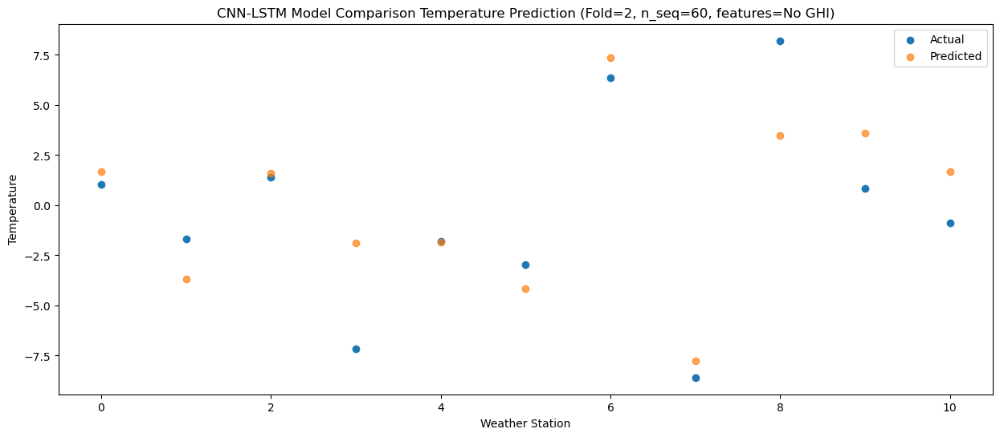

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.38  -0.997664
1                 1   -5.73  -6.367670
2                 2    4.12  -1.097645
3                 3   -7.14  -4.567657
4                 4   -2.56  -4.527659
5                 5   -5.30  -6.857657
6                 6    3.23   4.682348
7                 7   -5.67 -10.457647
8                 8    7.29   0.802337
9                 9    1.33   0.912339
10               10    0.48  -0.997655


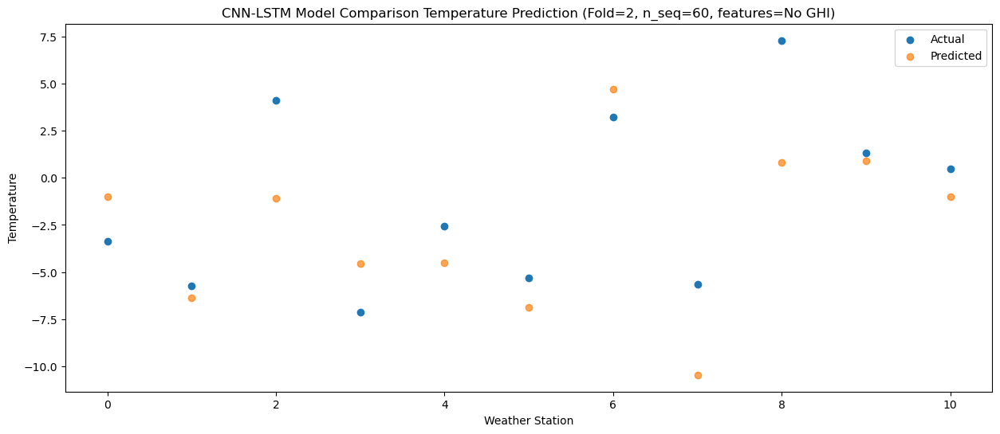

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    9.04   8.762854
1                 1    4.46   3.392854
2                 2    5.93   8.662842
3                 3   -3.03   5.192855
4                 4    4.77   5.232831
5                 5    3.08   2.902839
6                 6   13.60  14.442860
7                 7   -2.57  -0.697147
8                 8    6.89  10.562826
9                 9    8.21  10.672833
10               10    6.69   8.762845


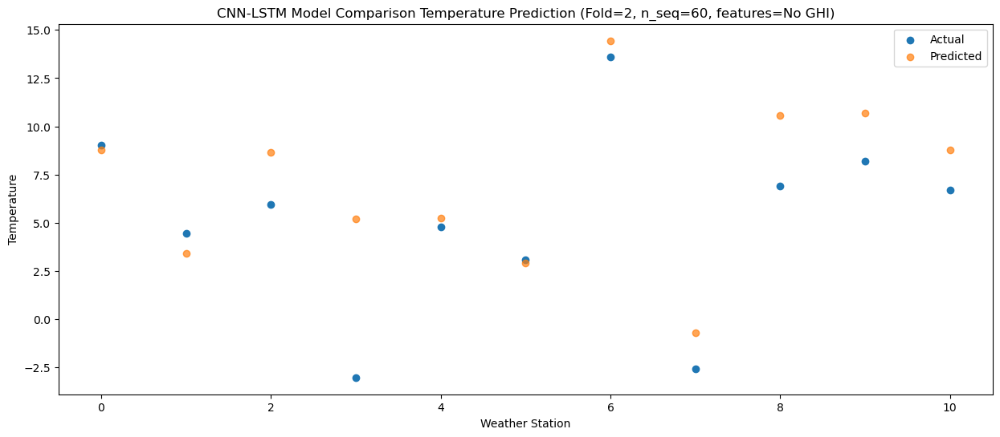

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   10.91  11.853939
1                 1    8.22   6.483950
2                 2    7.74  11.753911
3                 3    1.47   8.283940
4                 4    5.64   8.323908
5                 5    5.20   5.993920
6                 6   15.30  17.533945
7                 7    4.09   2.393936
8                 8   10.75  13.653899
9                 9   11.00  13.763910
10               10    8.66  11.853928


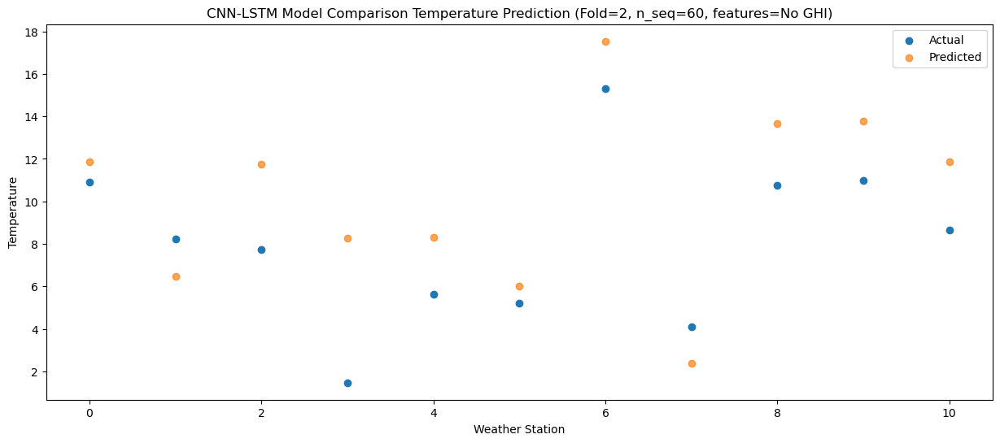

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   15.69  16.671440
1                 1   13.40  11.301448
2                 2   11.32  16.571436
3                 3    6.73  13.101447
4                 4   10.11  13.141427
5                 5    9.24  10.811433
6                 6   19.38  22.351447
7                 7    9.10   7.211447
8                 8   12.97  18.471418
9                 9   15.02  18.581426
10               10   13.57  16.671437


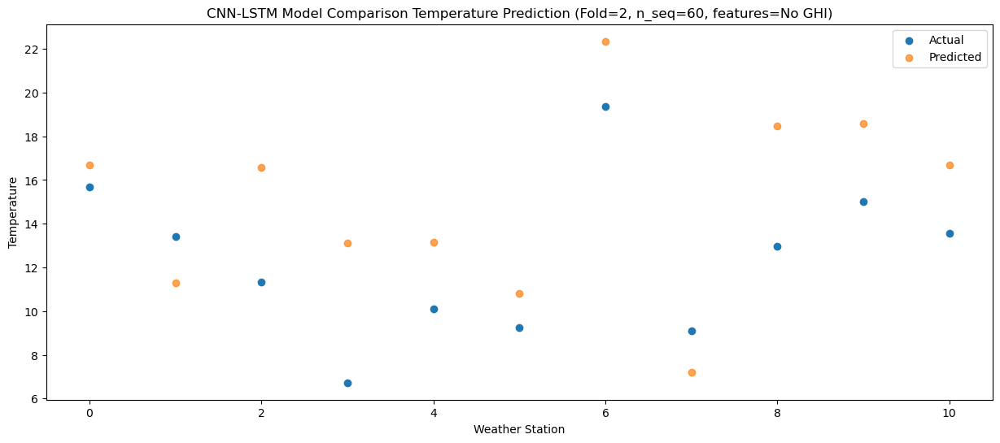

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   20.94  22.737486
1                 1   20.65  17.367486
2                 2   12.54  22.637511
3                 3   12.30  19.167499
4                 4   13.59  19.207493
5                 5   13.79  16.877492
6                 6   24.94  28.417498
7                 7   14.09  13.277500
8                 8   17.21  24.537483
9                 9   19.31  24.647489
10               10   18.98  22.737494


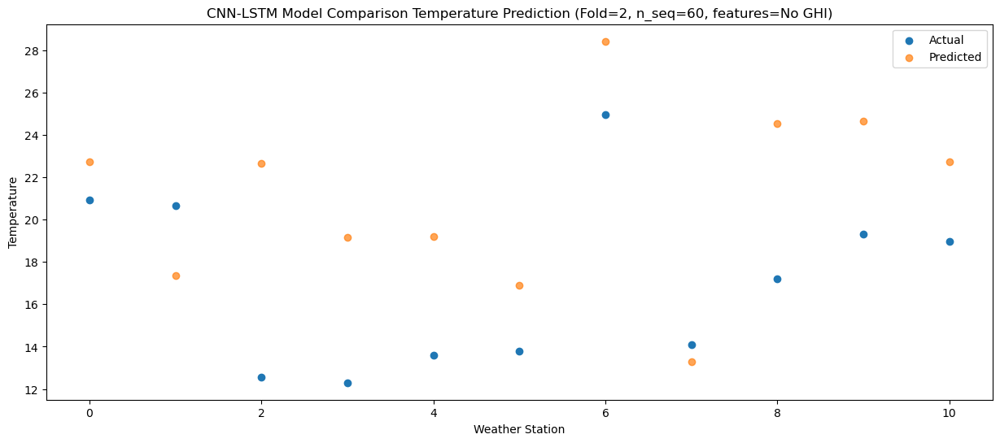

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   21.95  23.590016
1                 1   21.34  18.220016
2                 2   13.33  23.490029
3                 3   14.30  20.020029
4                 4   14.18  20.060013
5                 5   13.87  17.730015
6                 6   25.83  29.270024
7                 7   12.89  14.130024
8                 8   20.19  25.390008
9                 9   20.88  25.500009
10               10   20.29  23.590020


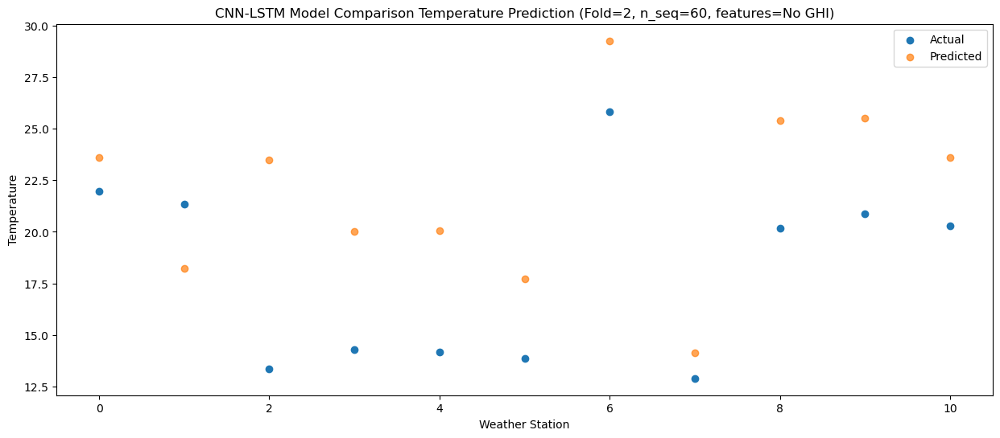

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   22.40  24.188281
1                 1   22.10  18.818269
2                 2   13.38  24.088323
3                 3   15.36  20.618295
4                 4   14.35  20.658297
5                 5   14.98  18.328297
6                 6   26.39  29.868291
7                 7   12.37  14.728300
8                 8   19.79  25.988294
9                 9   20.97  26.098289
10               10   20.37  24.188296


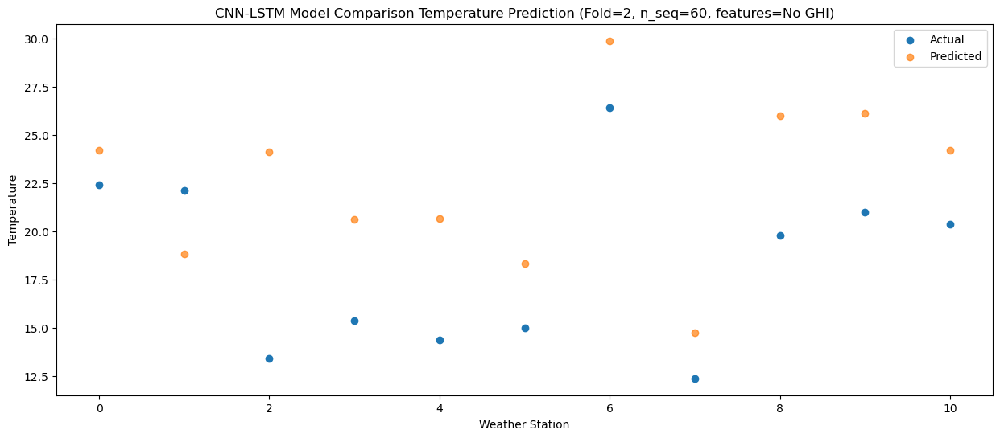

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.10  21.329294
1                 1   19.86  15.959287
2                 2   12.10  21.229315
3                 3   12.19  17.759301
4                 4   11.81  17.799296
5                 5   12.24  15.469303
6                 6   24.12  27.009303
7                 7   10.19  11.869304
8                 8   18.01  23.129292
9                 9   16.86  23.239293
10               10   15.88  21.329300


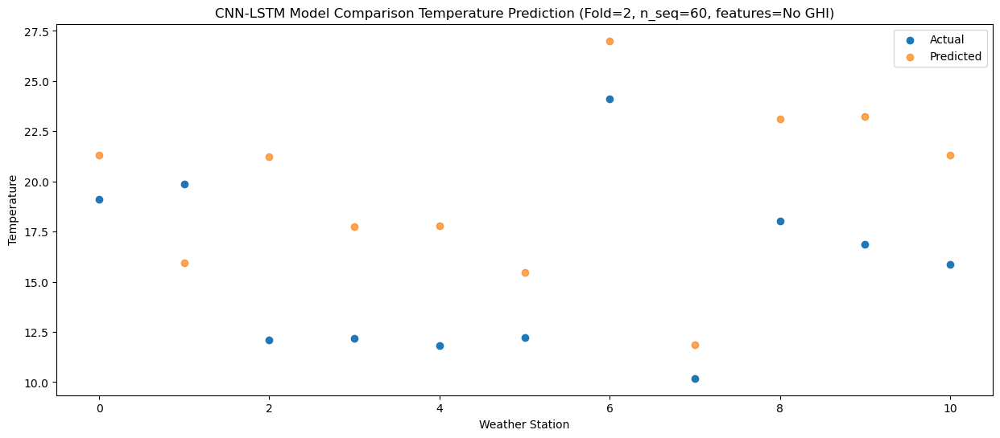

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   14.35  15.810491
1                 1   11.60  10.440492
2                 2   10.96  15.710503
3                 3    8.36  12.240499
4                 4    9.07  12.280489
5                 5    8.94   9.950498
6                 6   19.61  21.490503
7                 7    3.63   6.350499
8                 8   13.03  17.610486
9                 9   13.58  17.720484
10               10   12.12  15.810495


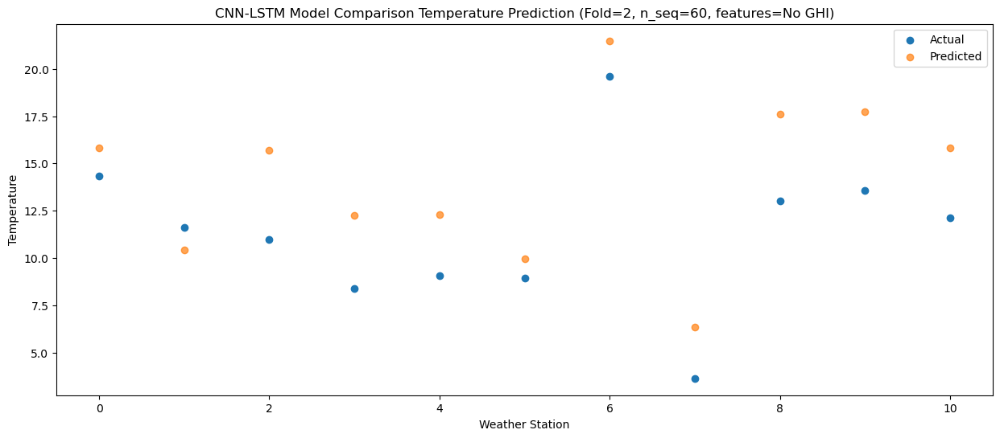

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    4.73   7.879631
1                 1    4.89   2.509629
2                 2    4.11   7.779661
3                 3    0.28   4.309645
4                 4    0.80   4.349641
5                 5    1.30   2.019649
6                 6   11.64  13.559647
7                 7   -1.77  -1.580353
8                 8   11.77   9.679638
9                 9    4.67   9.789637
10               10    1.90   7.879643


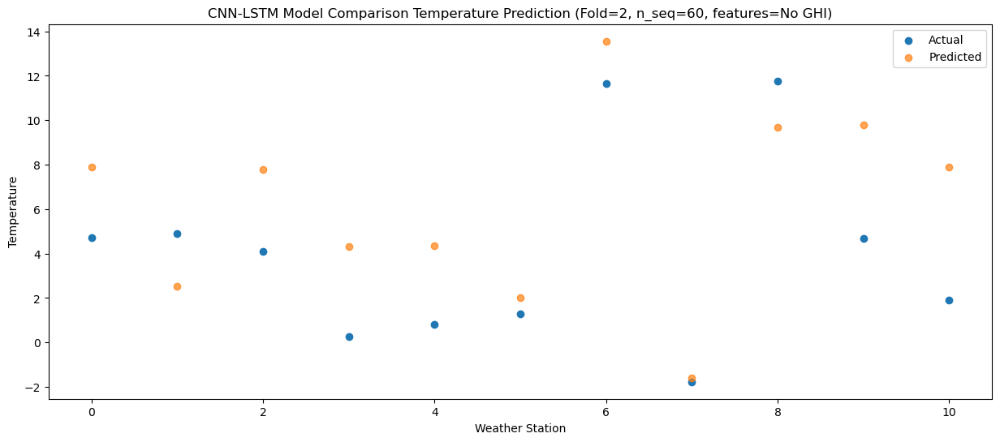

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    7.82   7.444860
1                 1    2.50   2.074854
2                 2    5.01   7.344904
3                 3   -1.64   3.874874
4                 4    4.21   3.914880
5                 5    4.54   1.584886
6                 6   13.93  13.124876
7                 7   -5.12  -2.015118
8                 8    5.26   9.244875
9                 9    6.59   9.354872
10               10    4.00   7.444876


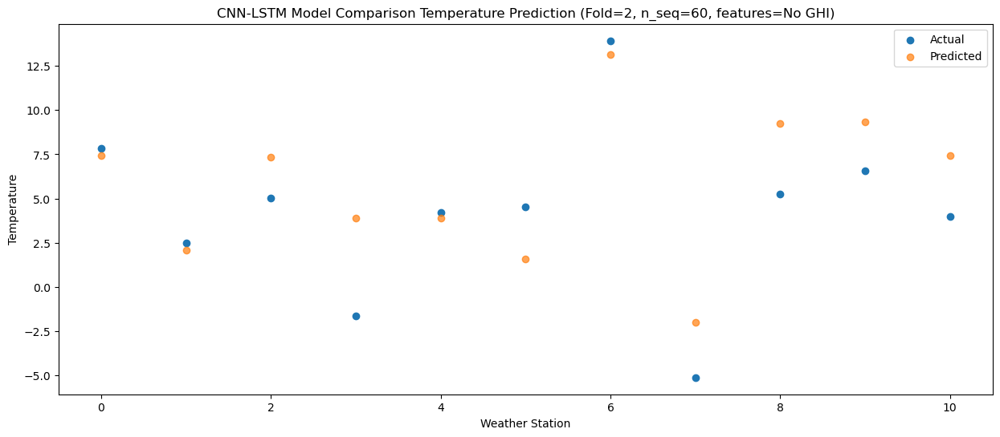

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.48   0.364582
1                 1   -2.19  -5.005422
2                 2    0.75   0.264623
3                 3   -7.79  -3.205404
4                 4   -3.52  -3.165400
5                 5   -3.89  -5.495393
6                 6    5.45   6.044596
7                 7   -8.12  -9.095398
8                 8    7.67   2.164594
9                 9    0.11   2.274594
10               10   -2.87   0.364596


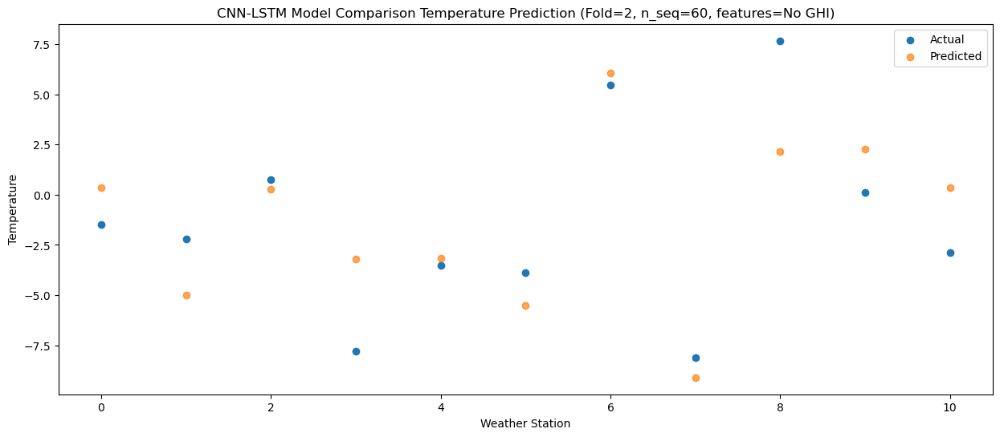

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.76   1.997779
1                 1   -2.20  -3.372220
2                 2    3.08   1.897795
3                 3   -5.47  -1.572214
4                 4   -0.38  -1.532226
5                 5   -4.27  -3.862213
6                 6    5.28   7.677789
7                 7   -7.15  -7.462220
8                 8    8.54   3.797772
9                 9    4.13   3.907772
10               10    1.72   1.997778


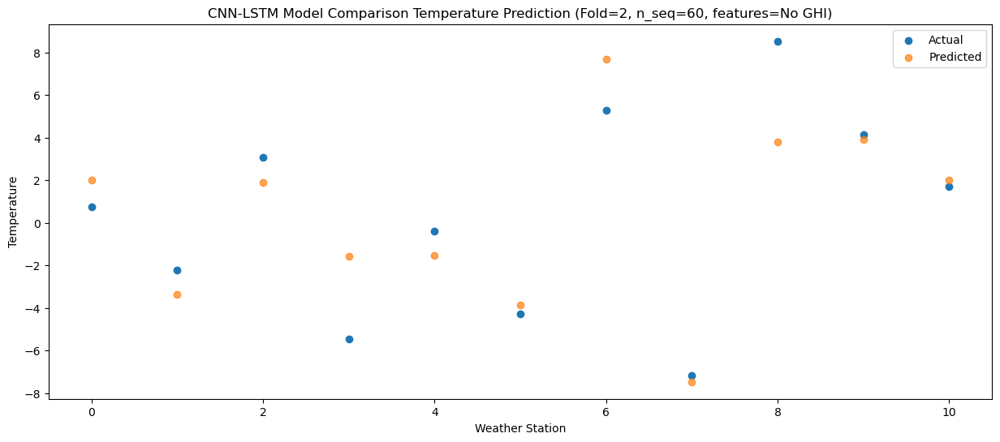

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    7.05   7.931091
1                 1    4.78   2.561107
2                 2    6.55   7.831081
3                 3   -1.61   4.361097
4                 4    3.38   4.401069
5                 5    1.85   2.071092
6                 6   11.86  13.611099
7                 7   -2.09  -1.528916
8                 8   10.33   9.731070
9                 9    8.24   9.841074
10               10    6.27   7.931078


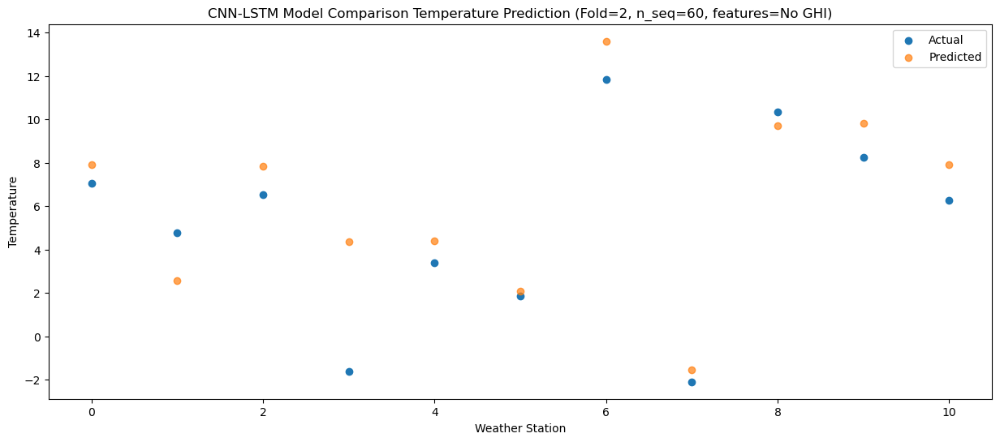

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   11.08  12.841351
1                 1   11.46   7.471365
2                 2    8.36  12.741352
3                 3    2.83   9.271361
4                 4    7.18   9.311335
5                 5    8.00   6.981360
6                 6   18.13  18.521367
7                 7    5.10   3.381350
8                 8   12.45  14.641336
9                 9   11.53  14.751337
10               10    9.43  12.841338


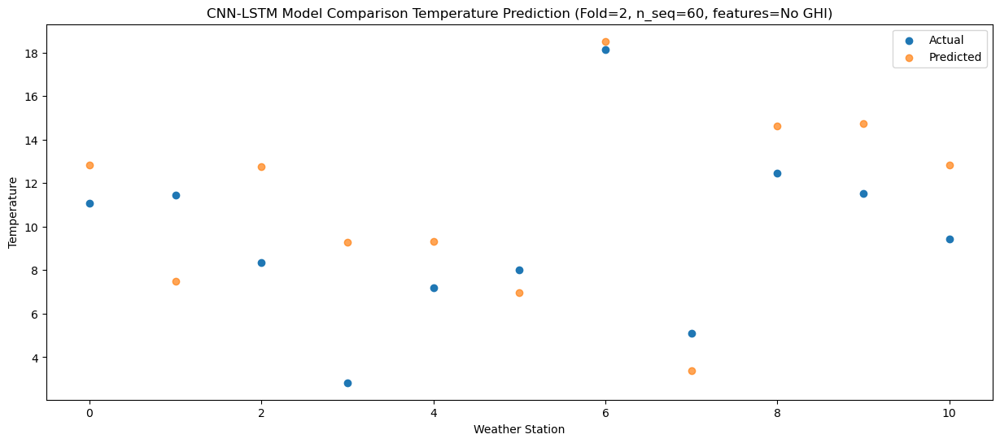

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   17.63  19.107309
1                 1   17.26  13.737304
2                 2   11.12  19.007372
3                 3    8.17  15.537333
4                 4   12.34  15.577343
5                 5   12.60  13.247349
6                 6   23.15  24.787327
7                 7    9.80   9.647338
8                 8   13.41  20.907340
9                 9   16.38  21.017331
10               10   15.67  19.107322


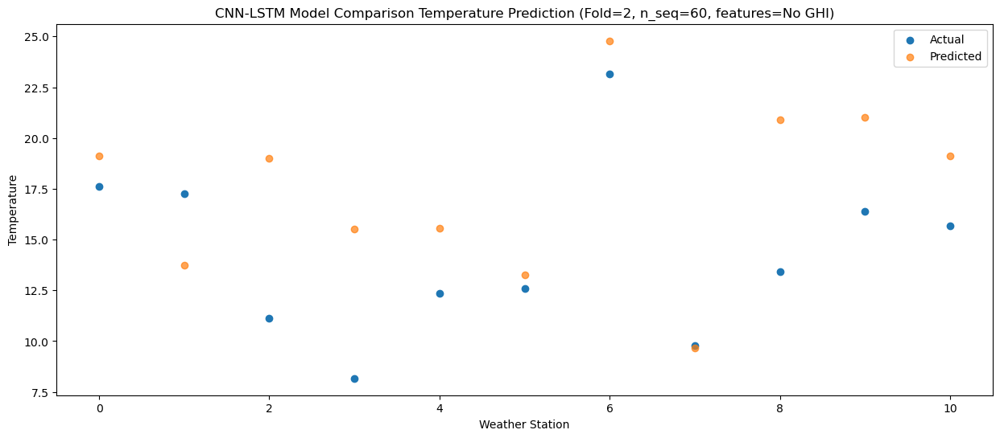

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   21.68  23.684610
1                 1   21.06  18.314616
2                 2   12.93  23.584661
3                 3   12.41  20.114634
4                 4   14.93  20.154634
5                 5   16.32  17.824642
6                 6   27.86  29.364626
7                 7   13.66  14.224631
8                 8   18.33  25.484633
9                 9   20.14  25.594624
10               10   19.32  23.684619


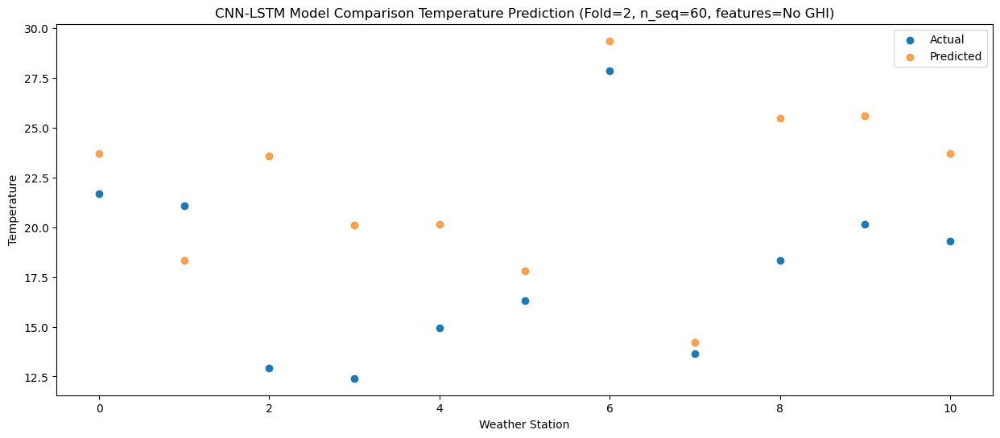

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.18  26.397142
1                 1   24.30  21.027149
2                 2   13.11  26.297205
3                 3   17.03  22.827172
4                 4   14.76  22.867172
5                 5   17.68  20.537184
6                 6   30.65  32.077158
7                 7   14.80  16.937171
8                 8   19.14  28.197171
9                 9   21.58  28.307160
10               10   20.67  26.397155


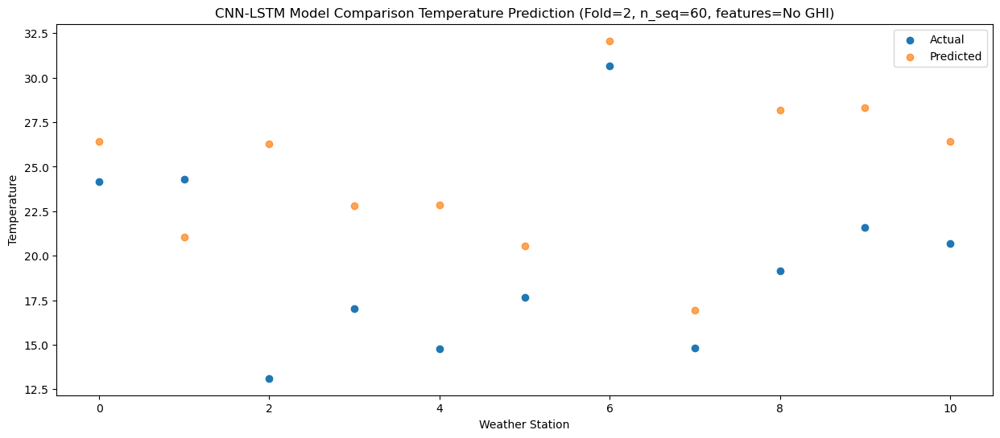

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   21.63  24.762202
1                 1   21.99  19.392206
2                 2   12.54  24.662282
3                 3   16.95  21.192237
4                 4   13.94  21.232243
5                 5   14.96  18.902250
6                 6   27.84  30.442218
7                 7   11.78  15.302241
8                 8   21.18  26.562243
9                 9   20.20  26.672229
10               10   19.42  24.762221


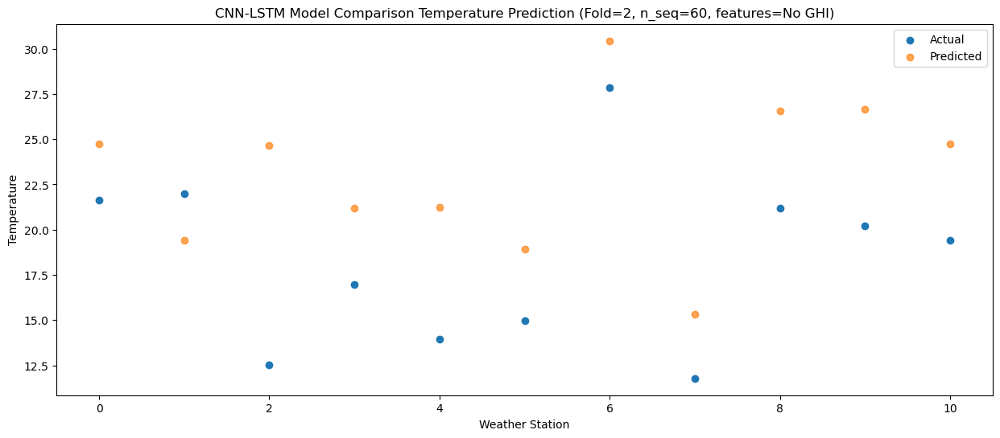

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.88  21.407113
1                 1   19.23  16.037108
2                 2   11.13  21.307217
3                 3   11.91  17.837158
4                 4   11.97  17.877172
5                 5   12.30  15.547176
6                 6   24.01  27.087130
7                 7   10.05  11.947162
8                 8   20.77  23.207169
9                 9   16.89  23.317155
10               10   15.27  21.407143


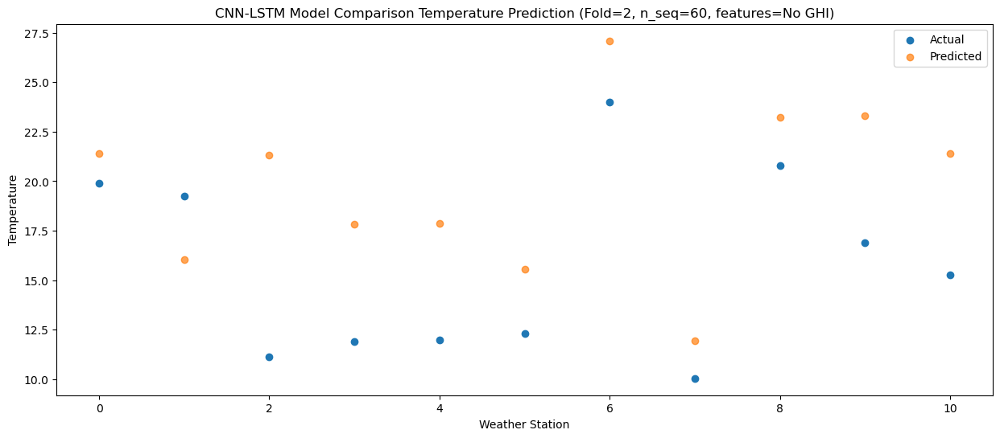

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.54  14.630858
1                 1   10.85   9.260867
2                 2    8.50  14.530934
3                 3    6.47  11.060895
4                 4    5.78  11.100897
5                 5    6.73   8.770906
6                 6   17.63  20.310870
7                 7    1.84   5.170896
8                 8   14.50  16.430895
9                 9    9.58  16.540885
10               10    7.99  14.630879


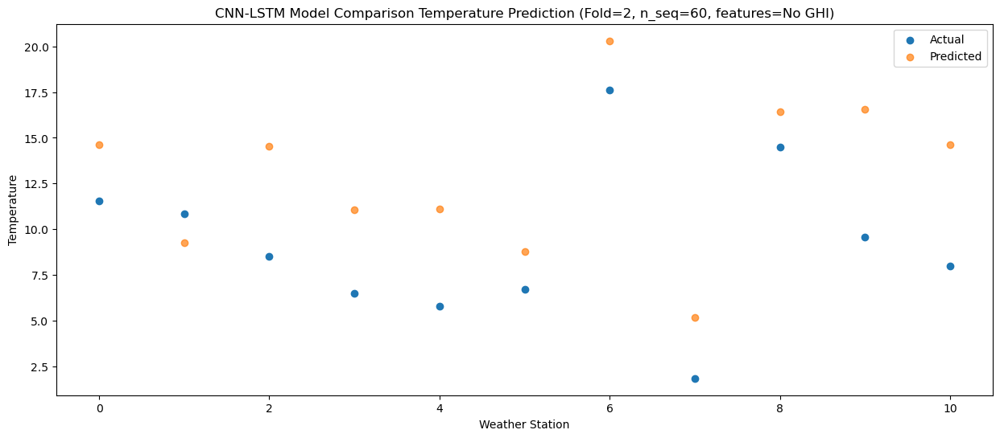

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    5.41   8.339063
1                 1    0.86   2.969070
2                 2    6.74   8.239151
3                 3    2.67   4.769104
4                 4    2.71   4.809112
5                 5    0.85   2.479119
6                 6   10.96  14.019078
7                 7   -5.05  -1.120893
8                 8    8.27  10.139109
9                 9    7.46  10.249098
10               10    5.54   8.339090


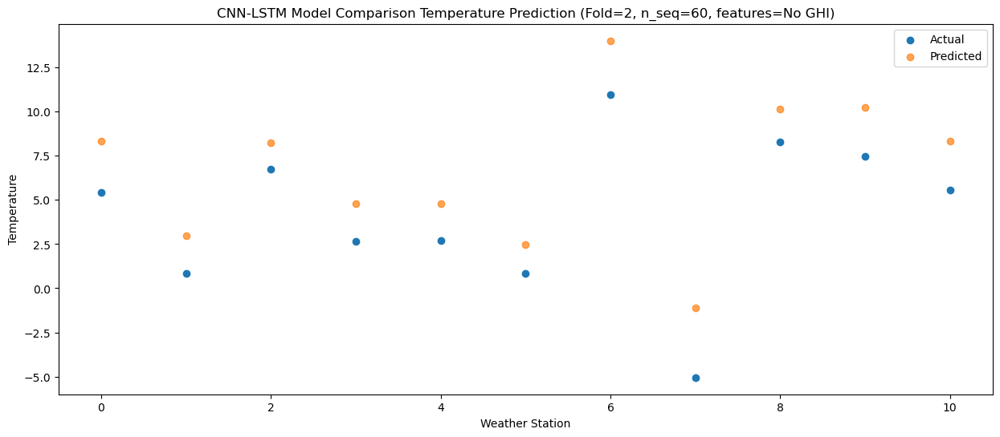

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.90   4.023720
1                 1   -1.85  -1.346261
2                 2    2.64   3.923778
3                 3   -3.50   0.453757
4                 4    0.20   0.493752
5                 5   -1.38  -1.836237
6                 6    8.34   9.703730
7                 7   -7.22  -5.436249
8                 8    5.57   5.823748
9                 9    0.93   5.933740
10               10    0.08   4.023734


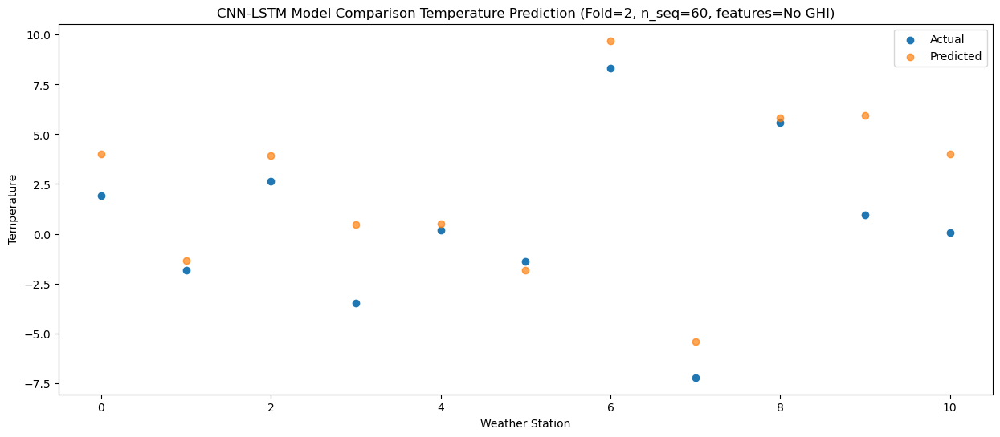

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    3.92   5.024588
1                 1   -2.10  -0.345390
2                 2    2.44   4.924665
3                 3   -2.21   1.454628
4                 4    1.37   1.494631
5                 5   -0.62  -0.835361
6                 6    9.22  10.704605
7                 7   -7.93  -4.435371
8                 8    5.23   6.824631
9                 9    4.13   6.934619
10               10    2.00   5.024613


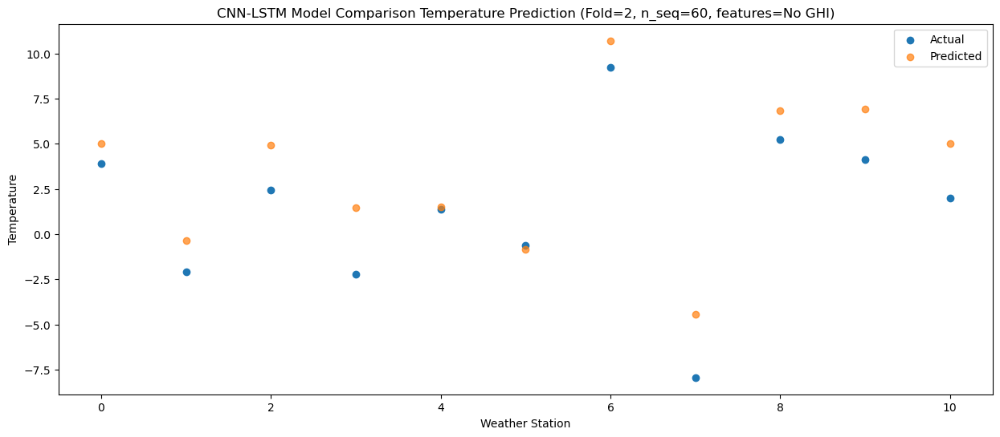

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    4.94   6.443238
1                 1   -0.50   1.073277
2                 2    5.50   6.343286
3                 3   -4.09   2.873274
4                 4    3.50   2.913258
5                 5    0.57   0.583273
6                 6    9.41  12.123253
7                 7   -6.72  -3.016733
8                 8    4.91   8.243261
9                 9    7.15   8.353252
10               10    4.79   6.443253


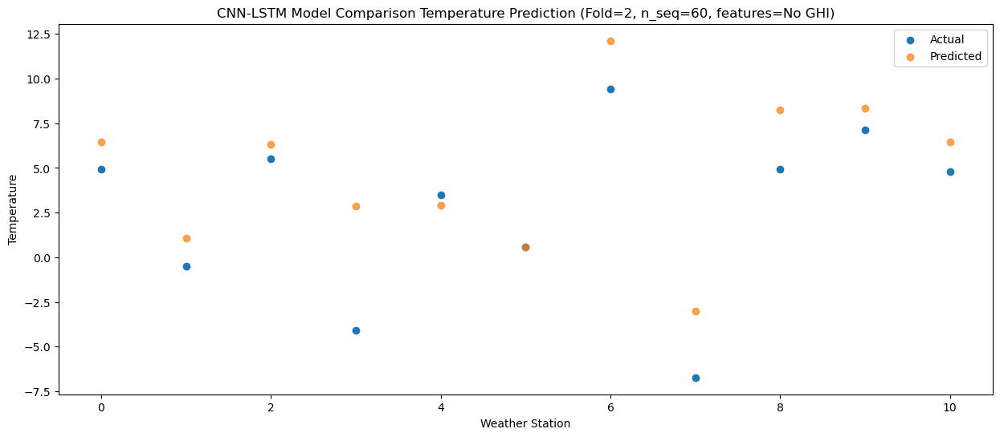

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    7.21   8.755771
1                 1    3.57   3.385803
2                 2    6.52   8.655839
3                 3   -1.65   5.185815
4                 4    5.33   5.225798
5                 5    4.37   2.895814
6                 6   14.06  14.435786
7                 7   -2.02  -0.704196
8                 8    5.92  10.555806
9                 9    7.60  10.665793
10               10    5.32   8.755794


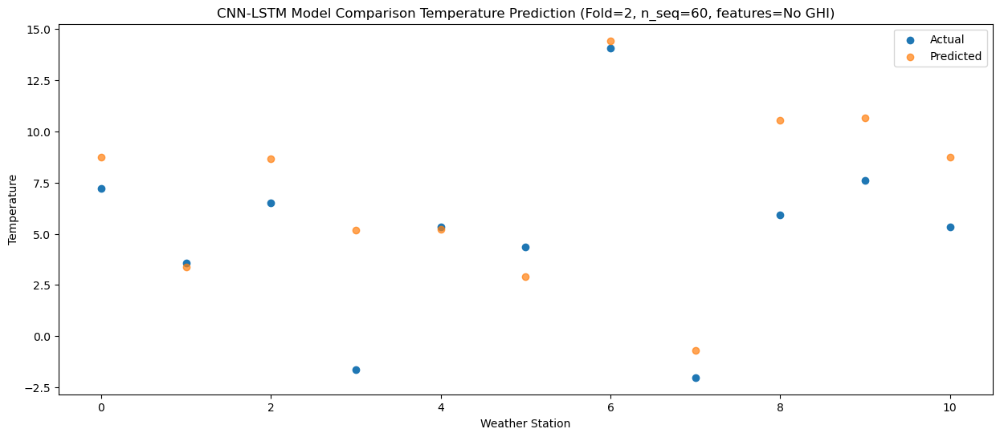

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   11.36  14.291361
1                 1    9.43   8.921391
2                 2    9.06  14.191425
3                 3    4.07  10.721401
4                 4    7.25  10.761383
5                 5    5.29   8.431404
6                 6   15.88  19.971372
7                 7    3.62   4.831388
8                 8    9.76  16.091390
9                 9   11.12  16.201381
10               10   10.21  14.291381


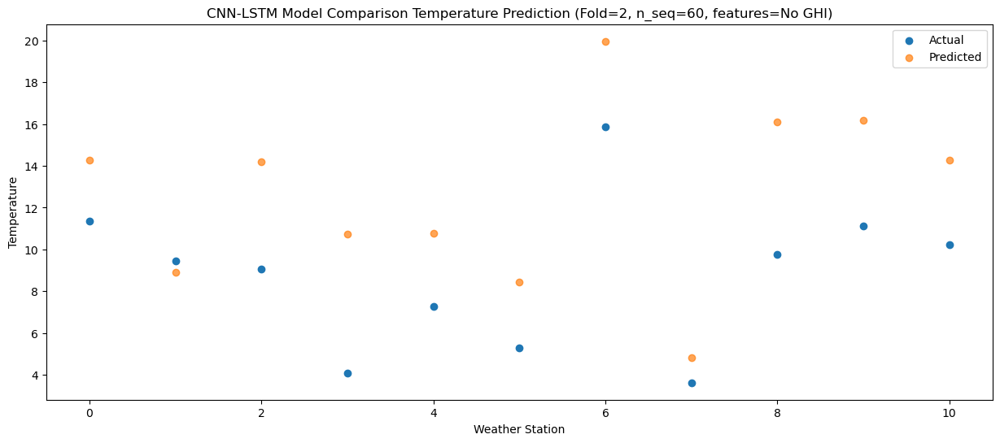

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   17.41  19.685131
1                 1   14.92  14.315181
2                 2   10.04  19.585147
3                 3    7.70  16.115157
4                 4   11.28  16.155119
5                 5   10.37  13.825146
6                 6   21.62  25.365138
7                 7    8.27  10.225137
8                 8   10.97  21.485123
9                 9   13.90  21.595125
10               10   13.56  19.685126


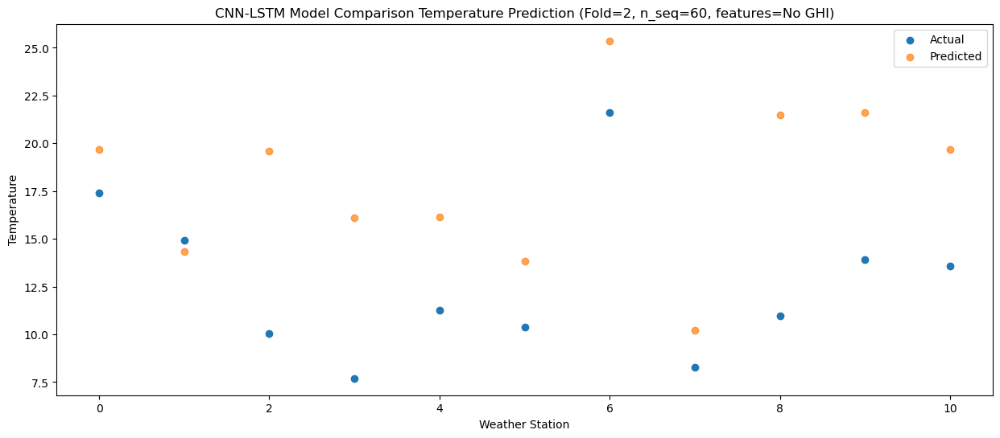

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   20.04  23.713524
1                 1   17.53  18.343576
2                 2   12.45  23.613541
3                 3   11.49  20.143554
4                 4   14.93  20.183512
5                 5   15.29  17.853540
6                 6   25.77  29.393535
7                 7   12.93  14.253530
8                 8   12.93  25.513516
9                 9   17.56  25.623519
10               10   16.47  23.713520


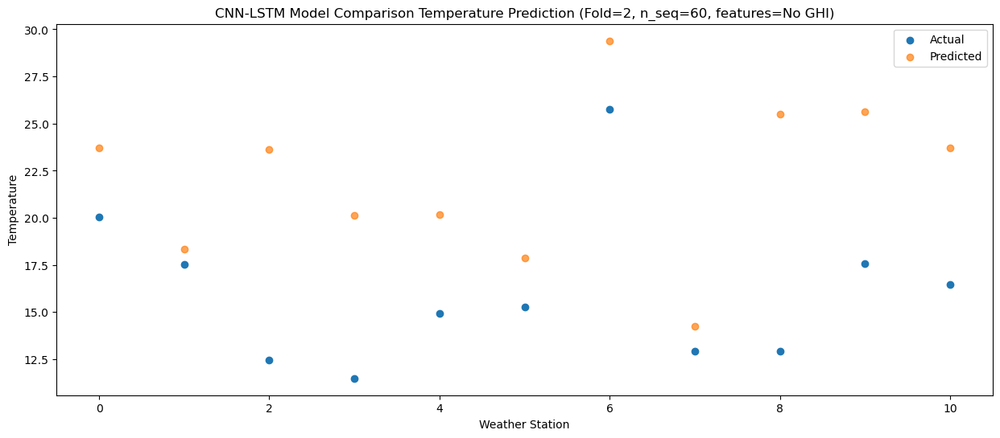

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   21.79  26.830077
1                 1   21.63  21.460130
2                 2   14.36  26.730075
3                 3   17.06  23.260104
4                 4   16.37  23.300053
5                 5   17.45  20.970080
6                 6   28.33  32.510084
7                 7   17.68  17.370070
8                 8   19.85  28.630056
9                 9   21.15  28.740061
10               10   20.02  26.830062


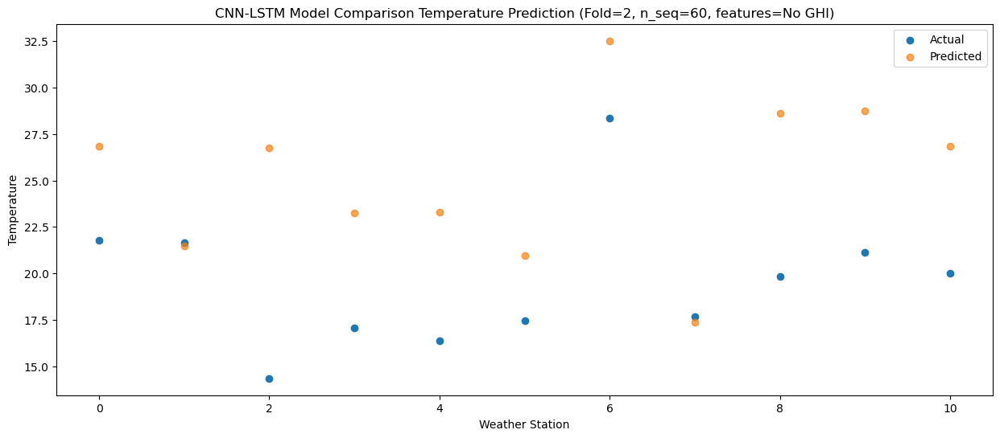

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   21.30  26.572114
1                 1   22.12  21.202162
2                 2   14.54  26.472117
3                 3   15.05  23.002150
4                 4   17.67  23.042094
5                 5   19.15  20.712121
6                 6   30.67  32.252121
7                 7   14.68  17.112110
8                 8   19.48  28.372098
9                 9   20.60  28.482100
10               10   19.31  26.572103


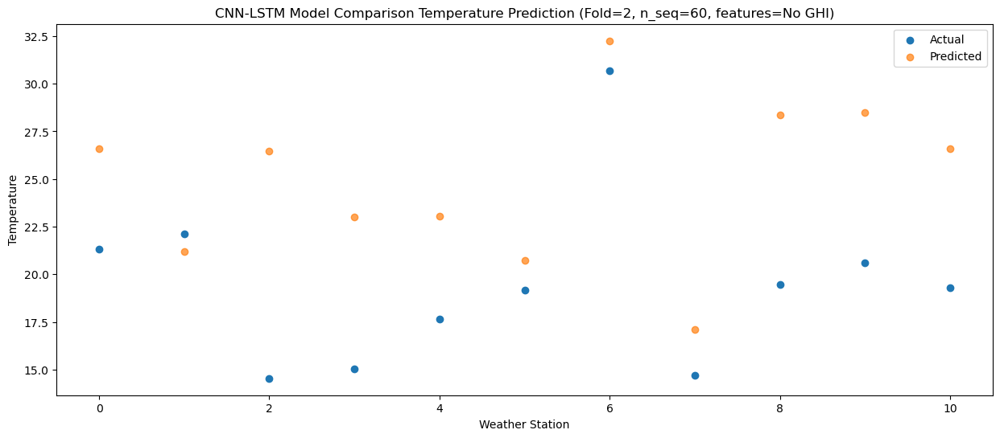

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   18.01  23.311580
1                 1   19.25  17.941624
2                 2   12.59  23.211600
3                 3   12.63  19.741622
4                 4   13.24  19.781573
5                 5   14.67  17.451598
6                 6   25.89  28.991589
7                 7   12.02  13.851587
8                 8   15.98  25.111575
9                 9   16.64  25.221576
10               10   16.53  23.311580


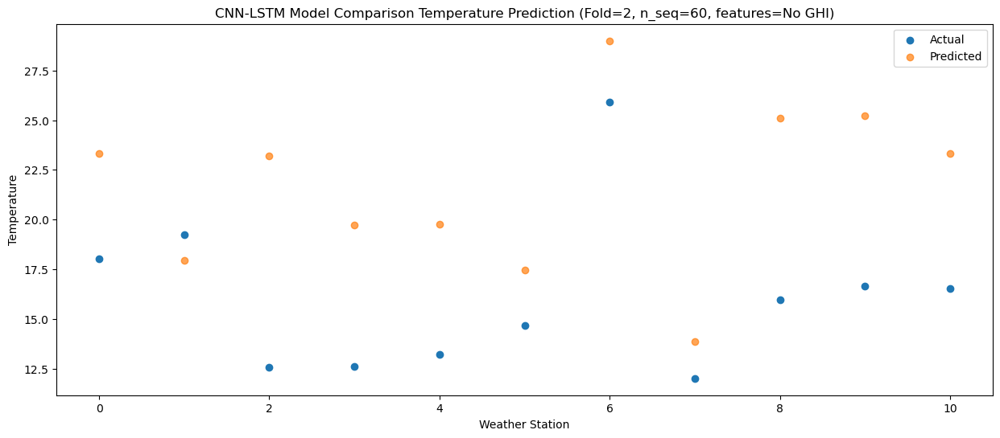

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.85  16.546576
1                 1   10.21  11.176619
2                 2    9.01  16.446590
3                 3    7.61  12.976617
4                 4    7.08  13.016563
5                 5    6.78  10.686589
6                 6   17.17  22.226580
7                 7    5.28   7.086578
8                 8   14.39  18.346567
9                 9   11.35  18.456567
10               10   10.48  16.546571


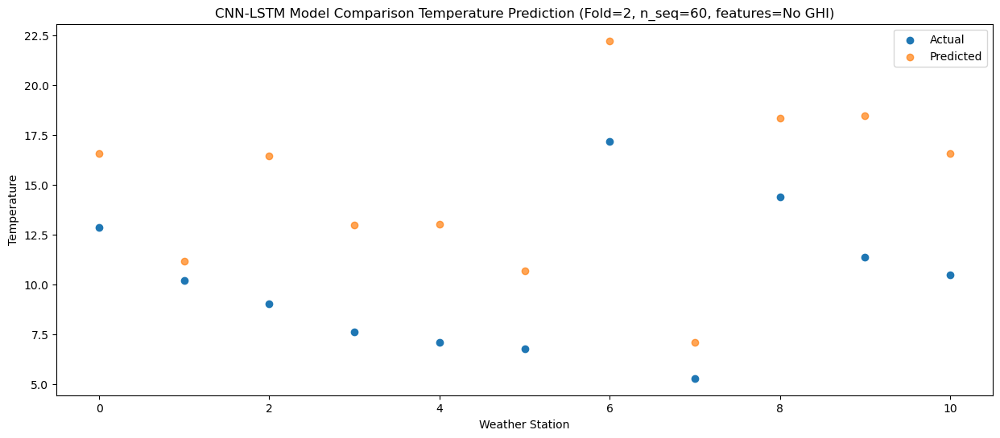

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    5.74  10.106400
1                 1    3.49   4.736452
2                 2    5.03  10.006393
3                 3   -0.37   6.536434
4                 4    1.97   6.576368
5                 5    0.50   4.246403
6                 6   11.83  15.786396
7                 7   -1.83   0.646391
8                 8   10.00  11.906374
9                 9    5.45  12.016377
10               10    4.27  10.106385


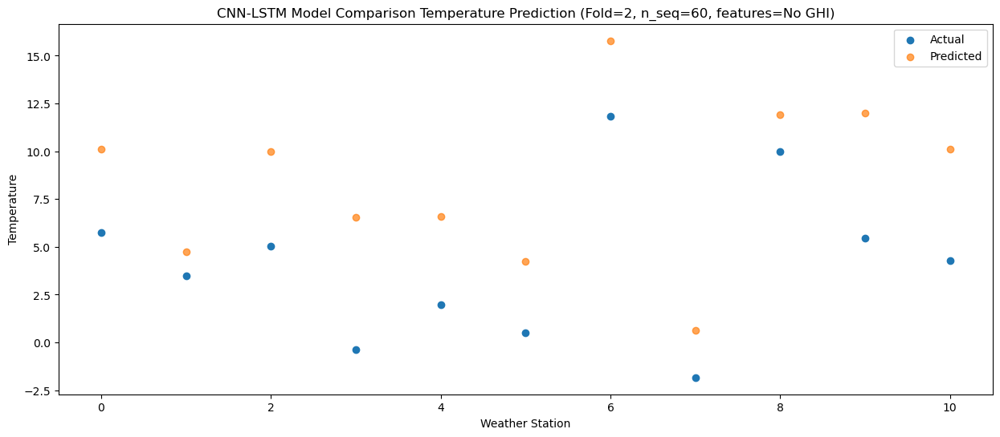

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    2.68   7.388534
1                 1   -0.18   2.018580
2                 2    3.10   7.288552
3                 3   -1.11   3.818570
4                 4   -0.63   3.858518
5                 5   -1.61   1.528548
6                 6    8.85  13.068534
7                 7   -6.87  -2.071462
8                 8    7.67   9.188523
9                 9    2.98   9.298523
10               10    1.42   7.388532


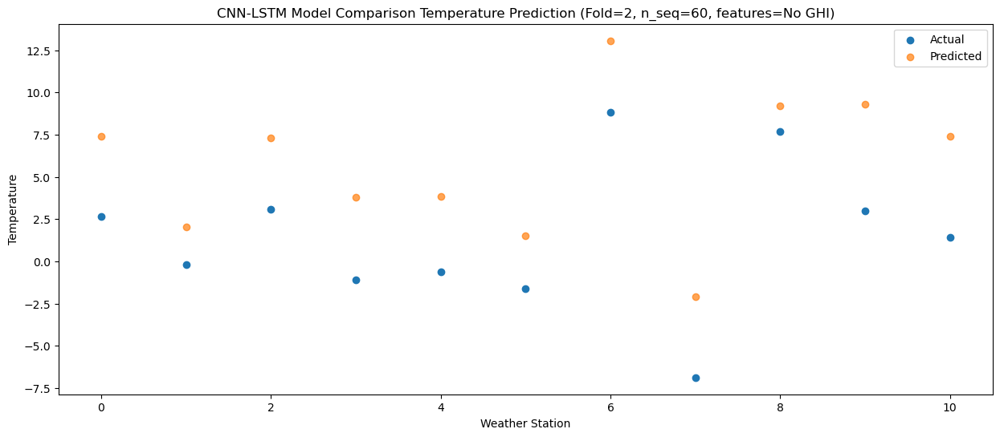

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.11   2.177567
1                 1   -5.27  -3.192391
2                 2    1.10   2.077607
3                 3   -5.28  -1.392391
4                 4   -2.71  -1.352433
5                 5   -5.76  -3.682405
6                 6    3.67   7.857575
7                 7   -7.20  -7.282417
8                 8    5.87   3.977572
9                 9    1.13   4.087572
10               10   -1.90   2.177575


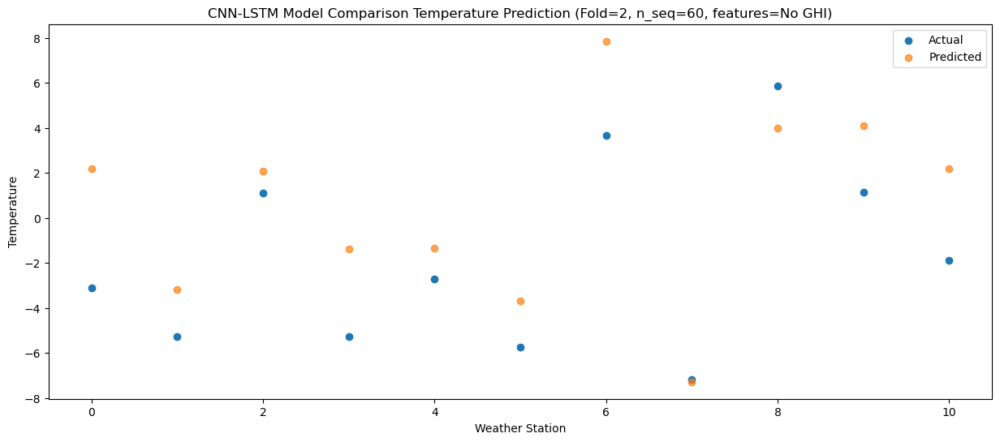

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.21   8.080951
1                 1    2.21   2.711001
2                 2    1.58   7.980993
3                 3   -4.60   4.511000
4                 4    1.45   4.550955
5                 5    1.00   2.220981
6                 6   11.93  13.760965
7                 7   -3.99  -1.379031
8                 8    6.40   9.880964
9                 9    4.35   9.990961
10               10    2.64   8.080961


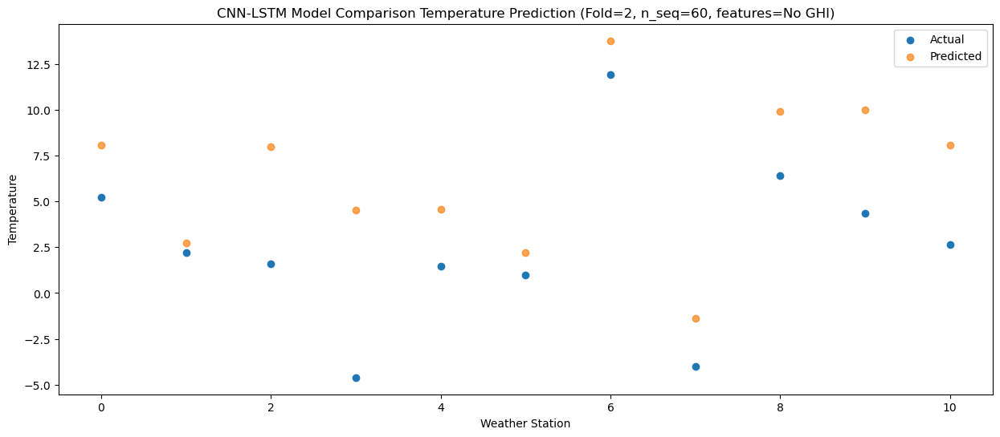

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.10  11.215948
1                 1    4.98   5.846000
2                 2    6.00  11.115999
3                 3   -0.20   7.645997
4                 4    4.12   7.685962
5                 5    3.37   5.355990
6                 6   14.28  16.895968
7                 7   -1.42   1.755974
8                 8    7.34  13.015967
9                 9    7.91  13.125961
10               10    6.81  11.215966


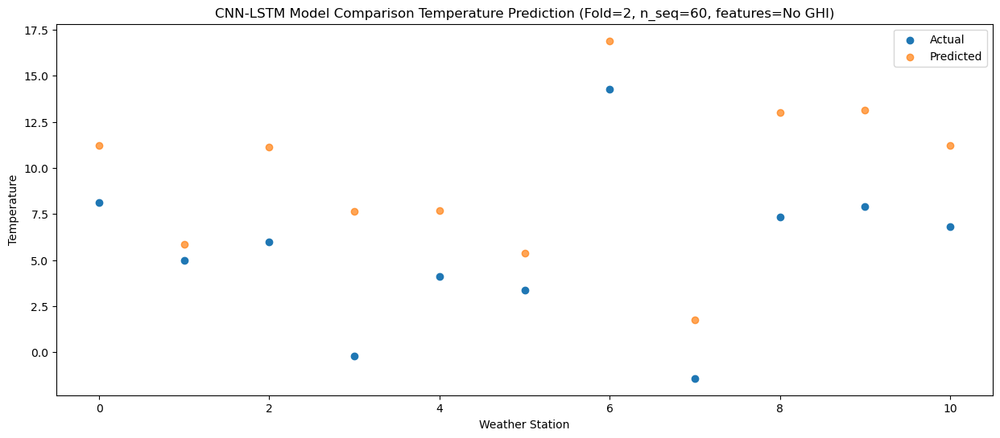

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.86  15.597271
1                 1   10.39  10.227343
2                 2    7.39  15.497287
3                 3    2.23  12.027314
4                 4    7.78  12.067260
5                 5    7.11   9.737299
6                 6   17.73  21.277291
7                 7    2.99   6.137286
8                 8    9.45  17.397263
9                 9   11.97  17.507265
10               10   10.79  15.597278


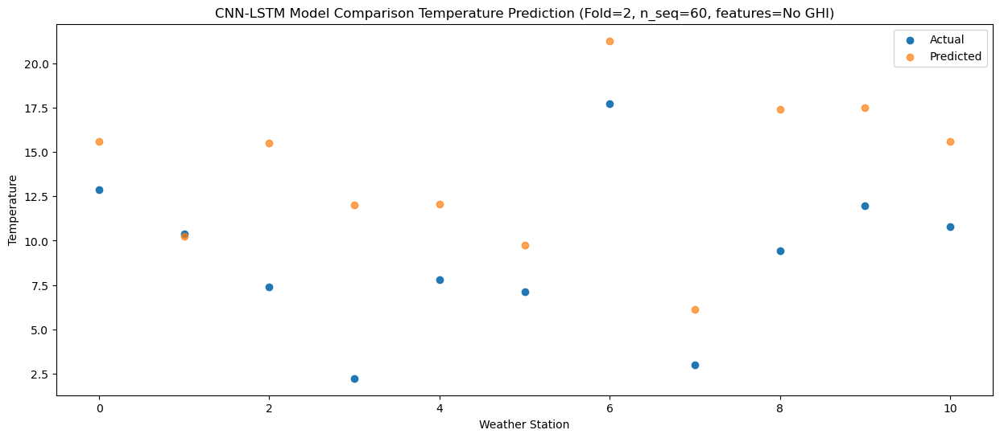

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.79  20.431127
1                 1   15.00  15.061223
2                 2   12.24  20.331098
3                 3    8.02  16.861165
4                 4   12.83  16.901082
5                 5   10.81  14.571138
6                 6   22.62  26.111149
7                 7    8.81  10.971124
8                 8   11.25  22.231090
9                 9   16.35  22.341100
10               10   15.25  20.431120


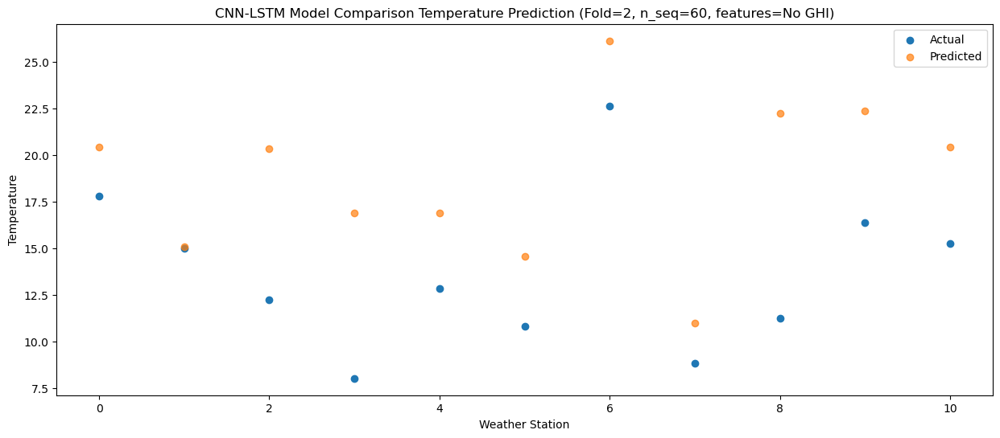

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   20.87  25.268839
1                 1   21.17  19.898941
2                 2   13.15  25.168805
3                 3   13.99  21.698876
4                 4   14.66  21.738790
5                 5   14.04  19.408849
6                 6   26.12  30.948861
7                 7   15.23  15.808830
8                 8   15.93  27.068798
9                 9   20.23  27.178806
10               10   19.60  25.268824


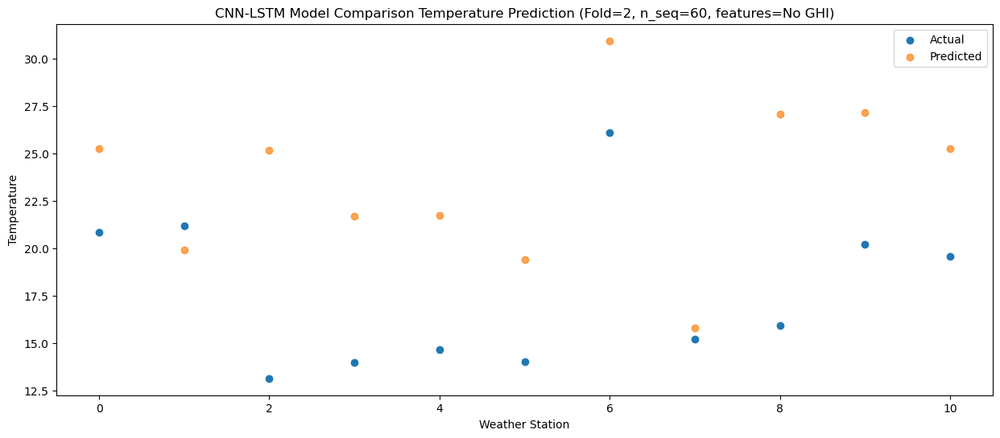

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   21.36  26.066989
1                 1   21.72  20.697095
2                 2   13.99  25.966935
3                 3   16.77  22.497021
4                 4   15.27  22.536929
5                 5   12.52  20.206992
6                 6   26.43  31.747011
7                 7   14.70  16.606973
8                 8   19.66  27.866934
9                 9   21.62  27.976948
10               10   20.83  26.066968


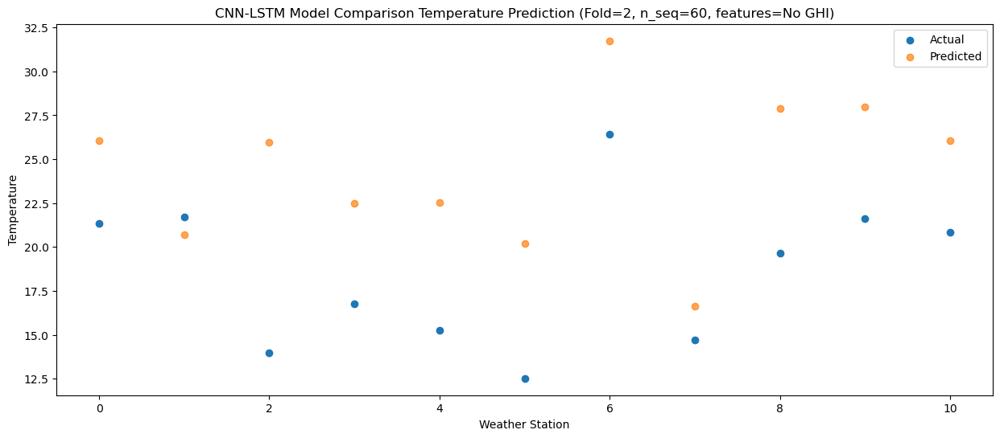

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   21.59  25.865592
1                 1   21.77  20.495692
2                 2   13.95  25.765530
3                 3   15.06  22.295620
4                 4   15.62  22.335520
5                 5   14.17  20.005588
6                 6   28.23  31.545612
7                 7   15.09  16.405569
8                 8   19.24  27.665527
9                 9   19.60  27.775543
10               10   19.21  25.865567


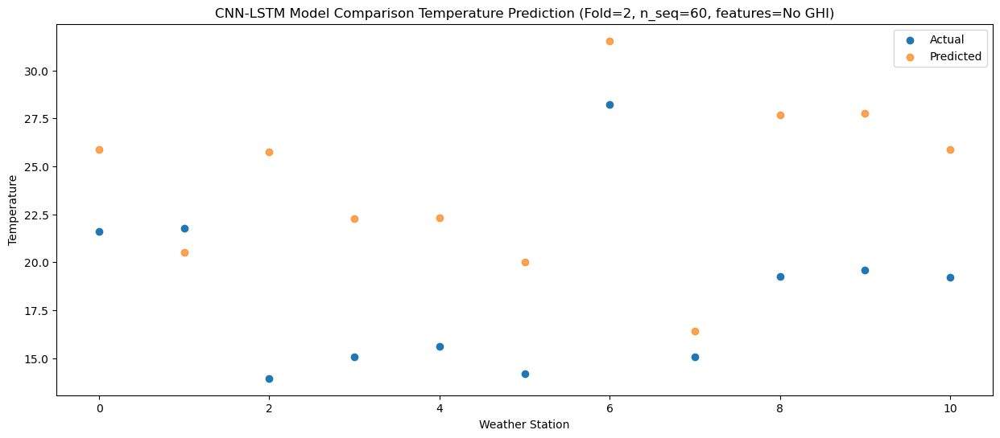

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   17.61  22.864930
1                 1   18.04  17.495035
2                 2   13.63  22.764860
3                 3   11.54  19.294959
4                 4   12.82  19.334853
5                 5   11.44  17.004921
6                 6   24.00  28.544953
7                 7   11.06  13.404902
8                 8   17.39  24.664862
9                 9   16.64  24.774877
10               10   16.62  22.864900


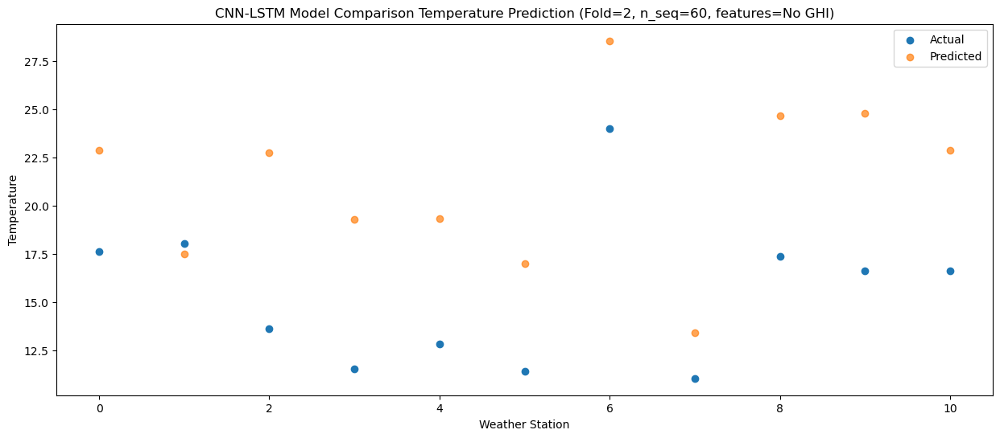

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   13.34  17.895710
1                 1   13.07  12.525824
2                 2   10.16  17.795620
3                 3    6.28  14.325736
4                 4    8.13  14.365619
5                 5    8.79  12.035692
6                 6   21.03  23.575729
7                 7    6.80   8.435672
8                 8   14.40  19.695626
9                 9   11.42  19.805648
10               10   10.20  17.895669


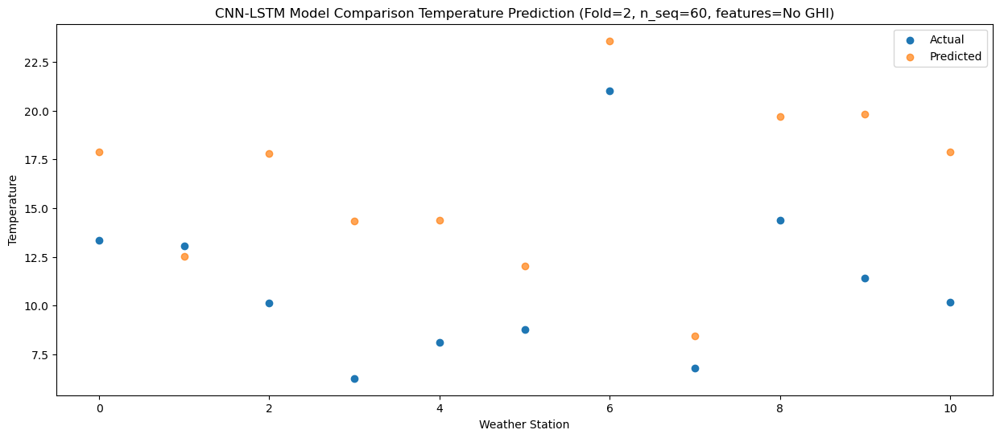

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_2 (Conv1D)           (None, 1, 512)            929792    
                                                                 
 max_pooling1d_2 (MaxPooling  (None, 1, 512)           0         
 1D)                                                             
                                                                 
 dropout_6 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_4 (LSTM)               (None, 1, 1024)           6295552   
                                                                 
 dropout_7 (Dropout)         (None, 1, 1024)           0         
                                                                 
 lstm_5 (LSTM)               (None, 1024)              8392704   
                                                      

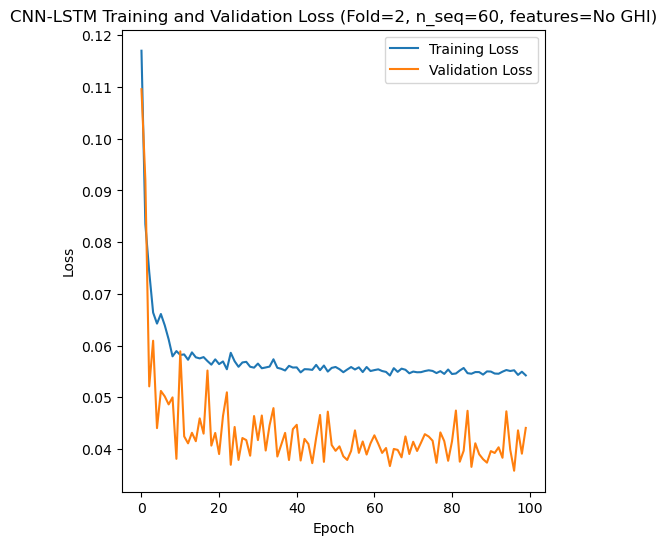

Epoch 1/100
84/84 [==============================] - 18s 94ms/step - loss: 0.1257 - accuracy: 0.2262 - mae: 0.1040 - rmse: 0.1257 - mape: 23.4938 - pearson: 0.6467 - val_loss: 0.0845 - val_accuracy: 0.5000 - val_mae: 0.0666 - val_rmse: 0.0845 - val_mape: 14.3584 - val_pearson: 0.7726
Epoch 2/100
84/84 [==============================] - 6s 66ms/step - loss: 0.0779 - accuracy: 0.4048 - mae: 0.0628 - rmse: 0.0779 - mape: 14.4957 - pearson: 0.8099 - val_loss: 0.0784 - val_accuracy: 0.5000 - val_mae: 0.0630 - val_rmse: 0.0784 - val_mape: 14.1261 - val_pearson: 0.7615
Epoch 3/100
84/84 [==============================] - 5s 61ms/step - loss: 0.0739 - accuracy: 0.5476 - mae: 0.0597 - rmse: 0.0739 - mape: 13.7620 - pearson: 0.8254 - val_loss: 0.0825 - val_accuracy: 0.5000 - val_mae: 0.0653 - val_rmse: 0.0825 - val_mape: 15.2123 - val_pearson: 0.7749
Epoch 4/100
84/84 [==============================] - 5s 62ms/step - loss: 0.0713 - accuracy: 0.5714 - mae: 0.0576 - rmse: 0.0713 - mape: 13.4525 - 

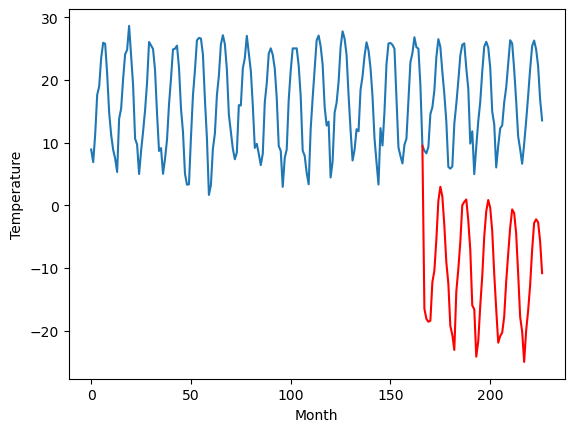

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.89		1.32		-1.57
1.54		-0.30		-1.84
0.70		-0.75		-1.45
0.85		-0.58		-1.43
8.34		5.57		-2.77
9.26		7.39		-1.87
13.66		12.37		-1.29
20.76		18.52		-2.24
22.62		20.77		-1.85
20.76		19.21		-1.55
17.09		14.59		-2.50
9.98		8.71		-1.27
7.16		5.36		-1.80
0.61		-1.41		-2.02
-0.54		-2.86		-2.32
-4.26		-5.25		-0.99
7.71		4.07		-3.64
9.57		7.62		-1.95
13.79		11.96		-1.83
20.50		17.85		-2.65
21.81		18.37		-3.44
22.38		18.74		-3.64
19.65		15.39		-4.26
13.05		10.69		-2.36
5.34		1.84		-3.50
6.65		1.23		-5.42
-2.18		-6.32		-4.14
-0.96		-3.84		-2.88
5.82		1.80		-4.02
10.67		6.51		-4.16
16.10		12.84		-3.26
21.25		16.87		-4.38
25.29		18.66		-6.63
22.21		17.40		-4.81
18.35		13.71		-4.64
11.80		6.88		-4.92
4.57		1.24		-3.33
0.52		-4.09		-4.61
1.22		-3.04		-4.26
3.18		-2.48		-5.66
5.78		0.07		-5.71
10.83		5.68		-5.15
16.14		10.06		-6.08
20.47		14.28		-6.19
22.73		17.16		-5.57
22.91		16.58		-6.33
18.86		13.27		-5.59

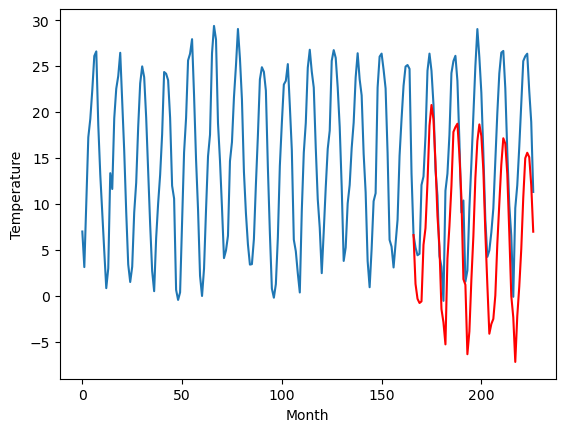

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.73		0.79		-3.94
2.20		-0.83		-3.03
0.98		-1.28		-2.26
3.40		-1.11		-4.51
5.19		5.04		-0.15
9.85		6.86		-2.99
15.04		11.84		-3.20
18.39		17.99		-0.40
21.17		20.24		-0.93
21.70		18.68		-3.02
17.37		14.06		-3.31
11.88		8.18		-3.70
3.23		4.83		1.60
0.03		-1.94		-1.97
1.29		-3.39		-4.68
3.59		-5.78		-9.37
4.74		3.54		-1.20
10.47		7.09		-3.38
15.27		11.43		-3.84
20.12		17.32		-2.80
23.25		17.84		-5.41
21.05		18.21		-2.84
17.74		14.86		-2.88
9.08		10.16		1.08
4.74		1.31		-3.43
0.82		0.70		-0.12
0.49		-6.85		-7.34
2.19		-4.37		-6.56
6.90		1.27		-5.63
9.97		5.98		-3.99
14.21		12.31		-1.90
19.60		16.34		-3.26
22.17		18.13		-4.04
22.35		16.87		-5.48
19.53		13.18		-6.35
12.35		6.35		-6.00
1.62		0.71		-0.91
0.66		-4.62		-5.28
2.05		-3.57		-5.62
1.20		-3.01		-4.21
4.07		-0.46		-4.53
9.70		5.15		-4.55
14.14		9.53		-4.61
16.94		13.75		-3.19
22.60		16.63		-5.97
20.91		16.05		-4.86
17.14		12.74		-4.40
11.83	

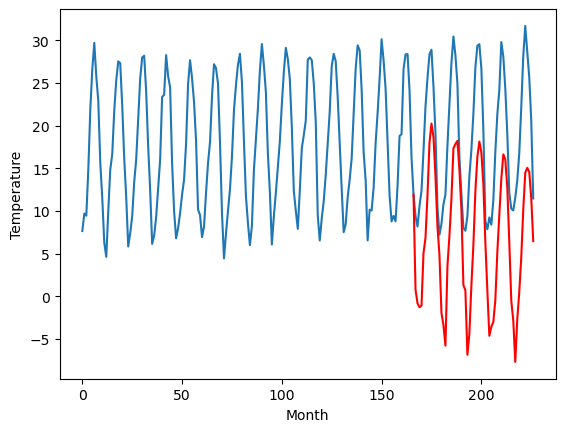

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-7.31		-5.05		2.26
-7.30		-6.67		0.63
-7.85		-7.12		0.73
-8.20		-6.95		1.25
-1.29		-0.80		0.49
-0.65		1.02		1.67
3.92		6.00		2.08
9.74		12.15		2.41
13.54		14.40		0.86
11.12		12.84		1.72
7.06		8.22		1.16
1.64		2.34		0.70
-2.28		-1.01		1.27
-9.48		-7.78		1.70
-10.94		-9.23		1.71
-12.26		-11.62		0.64
-2.05		-2.30		-0.25
0.30		1.25		0.95
4.37		5.59		1.22
10.29		11.48		1.19
11.28		12.00		0.72
11.80		12.37		0.57
7.67		9.02		1.35
4.09		4.32		0.23
-5.57		-4.53		1.04
-4.08		-5.14		-1.06
-13.03		-12.69		0.34
-8.51		-10.21		-1.70
-2.76		-4.57		-1.81
0.25		0.14		-0.11
7.03		6.47		-0.56
10.51		10.50		-0.01
12.06		12.29		0.23
10.99		11.03		0.04
7.01		7.34		0.33
-0.26		0.51		0.77
-3.38		-5.13		-1.75
-8.65		-10.46		-1.81
-6.90		-9.41		-2.51
-4.56		-8.85		-4.29
-4.32		-6.30		-1.98
1.92		-0.69		-2.61
4.61		3.69		-0.92
8.35		7.91		-0.44
11.97		10.79		-1.18
10.86		10.21		-0.65
8.13		6.90		-1.23
2.69		0.50		-2.19

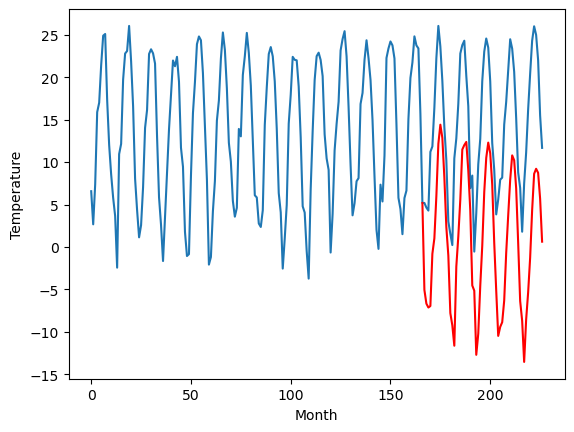

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.64		0.65		-4.99
2.38		-0.97		-3.35
-0.49		-1.42		-0.93
0.66		-1.25		-1.91
8.07		4.90		-3.17
11.10		6.72		-4.38
17.17		11.70		-5.47
24.22		17.85		-6.37
25.68		20.10		-5.58
23.12		18.54		-4.58
19.05		13.92		-5.13
11.32		8.04		-3.28
8.50		4.69		-3.81
1.33		-2.08		-3.41
-0.14		-3.53		-3.39
-4.01		-5.92		-1.91
9.07		3.40		-5.67
12.36		6.95		-5.41
16.93		11.29		-5.64
24.41		17.18		-7.23
24.41		17.70		-6.71
24.53		18.07		-6.46
21.17		14.72		-6.45
15.75		10.02		-5.73
6.01		1.17		-4.84
5.65		0.56		-5.09
-3.82		-6.99		-3.17
-1.30		-4.51		-3.21
7.16		1.13		-6.03
11.29		5.84		-5.45
18.86		12.17		-6.69
24.31		16.20		-8.11
25.43		17.99		-7.44
23.61		16.73		-6.88
19.29		13.04		-6.25
12.02		6.21		-5.81
6.13		0.57		-5.56
0.16		-4.76		-4.92
1.88		-3.71		-5.59
8.40		-3.15		-11.55
5.44		-0.60		-6.04
12.65		5.01		-7.64
18.65		9.39		-9.26
22.75		13.61		-9.14
24.45		16.49		-7.96
23.16		15.91		-7.25
19.80		12.60		

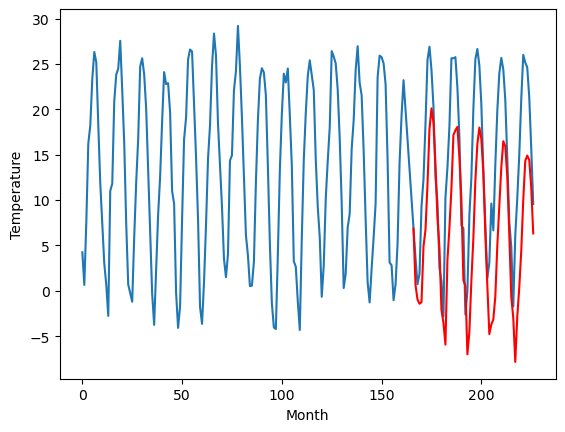

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.05		-1.23		1.82
-2.84		-2.85		-0.01
-4.26		-3.30		0.96
-4.67		-3.13		1.54
2.19		3.02		0.83
4.46		4.84		0.38
9.87		9.82		-0.05
16.86		15.97		-0.89
18.75		18.22		-0.53
16.24		16.66		0.42
12.61		12.04		-0.57
6.61		6.16		-0.45
2.67		2.81		0.14
-4.94		-3.96		0.98
-6.39		-5.41		0.98
-9.11		-7.80		1.31
2.22		1.52		-0.70
5.67		5.07		-0.60
9.95		9.41		-0.54
16.66		15.30		-1.36
17.04		15.82		-1.22
17.36		16.19		-1.17
14.10		12.84		-1.26
9.52		8.14		-1.38
-1.33		-0.71		0.62
-0.28		-1.32		-1.04
-9.10		-8.87		0.23
-5.91		-6.39		-0.48
1.05		-0.75		-1.80
4.90		3.96		-0.94
12.70		10.29		-2.41
16.64		14.32		-2.32
18.63		16.11		-2.52
16.98		14.85		-2.13
13.03		11.16		-1.87
6.99		4.33		-2.66
0.44		-1.31		-1.75
-5.10		-6.64		-1.54
-2.96		-5.59		-2.63
-1.24		-5.03		-3.79
-0.34		-2.48		-2.14
5.89		3.13		-2.76
11.30		7.51		-3.79
14.76		11.73		-3.03
18.02		14.61		-3.41
16.47		14.03		-2.44
13.01		10.72		-2.29
7.36

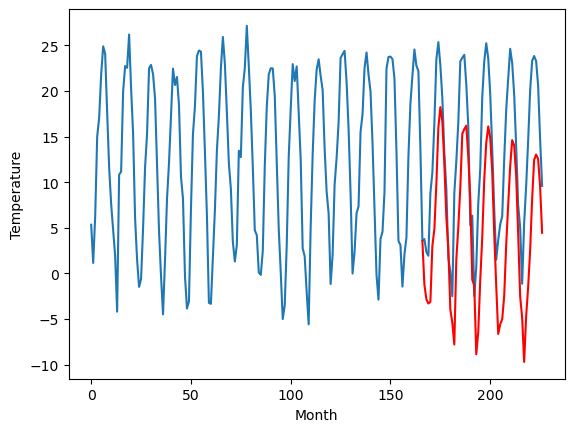

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.14		-0.60		3.54
-9.81		-2.22		7.59
-9.90		-2.67		7.23
-9.71		-2.50		7.21
-4.78		3.65		8.43
-1.80		5.47		7.27
5.31		10.45		5.14
9.52		16.60		7.08
11.51		18.85		7.34
12.26		17.29		5.03
6.76		12.67		5.91
3.02		6.79		3.77
-4.17		3.44		7.61
-9.87		-3.33		6.54
-9.60		-4.78		4.82
-9.50		-7.17		2.33
-6.53		2.15		8.68
-1.75		5.70		7.45
3.30		10.04		6.74
10.69		15.93		5.24
12.53		16.45		3.92
10.61		16.82		6.21
8.74		13.47		4.73
0.77		8.77		8.00
-1.97		-0.08		1.89
-6.73		-0.69		6.04
-9.02		-8.24		0.78
-10.74		-5.76		4.98
-6.20		-0.12		6.08
-1.88		4.59		6.47
4.03		10.92		6.89
9.80		14.95		5.15
11.72		16.74		5.02
10.96		15.48		4.52
8.80		11.79		2.99
0.54		4.96		4.42
-7.14		-0.68		6.46
-9.31		-6.01		3.30
-10.04		-4.96		5.08
-10.01		-4.40		5.61
-8.22		-1.85		6.37
-2.88		3.76		6.64
4.33		8.14		3.81
8.91		12.36		3.45
15.05		15.24		0.19
12.46		14.66		2.20
8.31		11.35		3.04
2.18		4.95		2.77
-3.68		-1.91		1.7

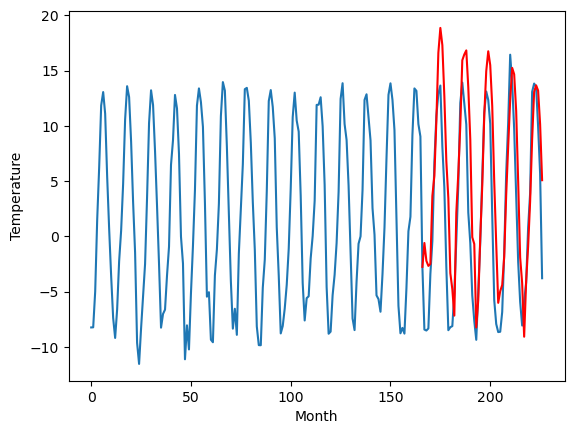

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		-1.68		-3.33
-3.08		-3.30		-0.22
-1.92		-3.75		-1.83
-0.41		-3.58		-3.17
2.70		2.57		-0.13
8.61		4.39		-4.22
15.88		9.37		-6.51
19.34		15.52		-3.82
23.57		17.77		-5.80
23.68		16.21		-7.47
18.87		11.59		-7.28
11.93		5.71		-6.22
3.12		2.36		-0.76
-2.57		-4.41		-1.84
-2.02		-5.86		-3.84
0.83		-8.25		-9.08
2.43		1.07		-1.36
10.40		4.62		-5.78
14.83		8.96		-5.87
22.47		14.85		-7.62
23.55		15.37		-8.18
22.32		15.74		-6.58
18.35		12.39		-5.96
8.00		7.69		-0.31
5.48		-1.16		-6.64
-1.79		-1.77		0.02
-1.86		-9.32		-7.46
0.18		-6.84		-7.02
4.89		-1.20		-6.09
9.52		3.51		-6.01
14.19		9.84		-4.35
20.67		13.87		-6.80
22.90		15.66		-7.24
21.31		14.40		-6.91
18.95		10.71		-8.24
11.06		3.88		-7.18
-0.36		-1.76		-1.40
-2.69		-7.09		-4.40
-3.20		-6.04		-2.84
-2.29		-5.48		-3.19
0.54		-2.93		-3.47
8.49		2.68		-5.81
14.29		7.06		-7.23
16.79		11.28		-5.51
25.15		14.16		-10.99
20.52		13.58		-6.94
15.82		10.27

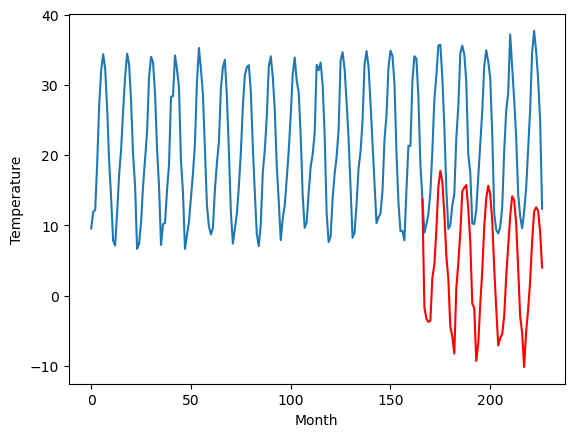

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.04		-4.00		-3.96
-1.29		-5.62		-4.33
-1.92		-6.07		-4.15
0.10		-5.90		-6.00
-0.46		0.25		0.71
3.16		2.07		-1.09
5.56		7.05		1.49
8.10		13.20		5.10
7.29		15.45		8.16
9.17		13.89		4.72
8.59		9.27		0.68
6.37		3.39		-2.98
-0.79		0.04		0.83
-2.84		-6.73		-3.89
-1.62		-8.18		-6.56
-0.69		-10.57		-9.88
-0.91		-1.25		-0.34
1.28		2.30		1.02
5.57		6.64		1.07
7.27		12.53		5.26
6.45		13.05		6.60
7.00		13.42		6.42
6.45		10.07		3.62
3.69		5.37		1.68
0.87		-3.48		-4.35
-2.83		-4.09		-1.26
-2.21		-11.64		-9.43
-1.25		-9.16		-7.91
0.98		-3.52		-4.50
2.42		1.19		-1.23
5.41		7.52		2.11
8.56		11.55		2.99
6.91		13.34		6.43
8.33		12.08		3.75
8.56		8.39		-0.17
3.83		1.56		-2.27
-1.90		-4.08		-2.18
-3.10		-9.41		-6.31
-1.43		-8.36		-6.93
-3.23		-7.80		-4.57
-1.77		-5.25		-3.48
2.31		0.36		-1.95
3.34		4.74		1.40
5.24		8.96		3.72
8.25		11.84		3.59
9.28		11.26		1.98
6.67		7.95		1.28
5.21		1.55		-3.66
1.17		-5.31		-6

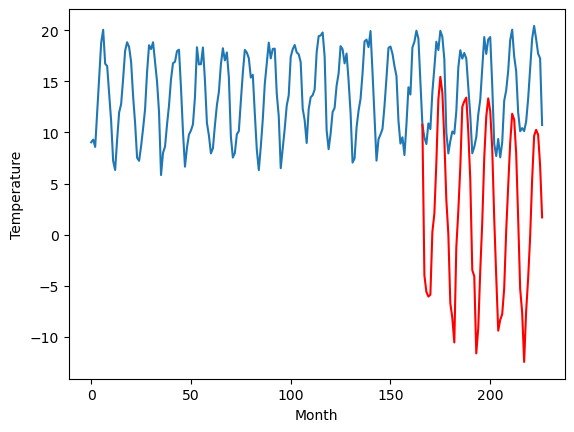

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.08		-2.92		0.16
-5.84		-4.54		1.30
-5.81		-4.99		0.82
-5.37		-4.82		0.55
-1.79		1.33		3.12
-0.35		3.15		3.50
5.21		8.13		2.92
12.19		14.28		2.09
16.14		16.53		0.39
14.96		14.97		0.01
10.62		10.35		-0.27
5.30		4.47		-0.83
1.23		1.12		-0.11
-5.11		-5.65		-0.54
-8.13		-7.10		1.03
-8.25		-9.49		-1.24
-3.25		-0.17		3.08
1.37		3.38		2.01
6.20		7.72		1.52
12.07		13.61		1.54
14.21		14.13		-0.08
14.83		14.50		-0.33
11.51		11.15		-0.36
7.07		6.45		-0.62
-1.85		-2.40		-0.55
-3.45		-3.01		0.44
-10.00		-10.56		-0.56
-7.24		-8.08		-0.84
-3.28		-2.44		0.84
1.01		2.27		1.26
6.80		8.60		1.80
11.12		12.63		1.51
15.67		14.42		-1.25
15.59		13.16		-2.43
10.68		9.47		-1.21
4.42		2.64		-1.78
0.46		-3.00		-3.46
-5.90		-8.33		-2.43
-3.92		-7.28		-3.36
-5.65		-6.72		-1.07
-3.68		-4.17		-0.49
2.37		1.44		-0.93
6.01		5.82		-0.19
10.00		10.04		0.04
15.68		12.92		-2.76
13.43		12.34		-1.09
10.86		9.03		-1.83
5.43		2.63

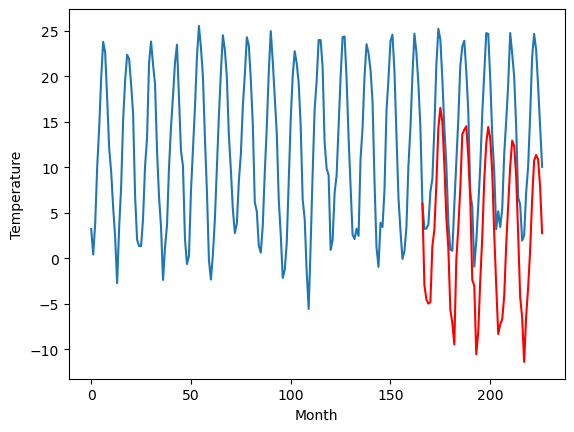

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-17.90		-16.49		1.41
-20.86		-18.11		2.75
-20.45		-18.56		1.89
-19.53		-18.39		1.14
-15.12		-12.24		2.88
-13.18		-10.42		2.76
-7.41		-5.44		1.97
-0.69		0.71		1.40
3.08		2.96		-0.12
1.21		1.40		0.19
-3.76		-3.22		0.54
-9.25		-9.10		0.15
-13.53		-12.45		1.08
-20.35		-19.22		1.13
-21.91		-20.67		1.24
-22.71		-23.06		-0.35
-15.52		-13.74		1.78
-10.65		-10.19		0.46
-6.39		-5.85		0.54
-0.22		0.04		0.26
1.42		0.56		-0.86
1.15		0.93		-0.22
-3.11		-2.42		0.69
-7.23		-7.12		0.11
-17.45		-15.97		1.48
-17.86		-16.58		1.28
-24.84		-24.13		0.71
-21.03		-21.65		-0.62
-15.85		-16.01		-0.16
-12.03		-11.30		0.73
-5.25		-4.97		0.28
-1.26		-0.94		0.32
2.52		0.85		-1.67
1.65		-0.41		-2.06
-3.58		-4.10		-0.52
-11.19		-10.93		0.26
-14.31		-16.57		-2.26
-21.34		-21.90		-0.56
-18.69		-20.85		-2.16
-18.48		-20.29		-1.81
-16.92		-17.74		-0.82
-9.35		-12.13		-2.78
-6.88		-7.75		-0.87
-2.95		-3.53		-0.58
1.89		-0.65		-2

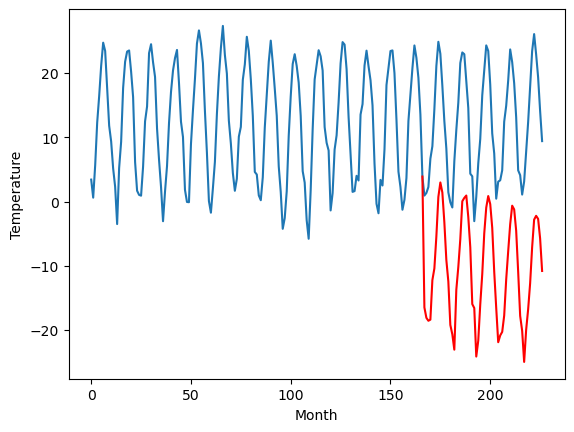

RangeIndex(start=1, stop=12, step=1)
[-17.9, 2.8899999999999997, 4.729999999999999, -7.31, 5.640000000000001, -3.0500000000000007, -4.139999999999999, 1.6500000000000012, -0.03999999999999826, -3.08, -17.9]
[-16.49072479248047, 1.3192532730102542, 0.7892780685424796, -5.050735282897949, 0.6492475509643558, -1.2307438659667973, -0.6007305145263668, -1.6807266998291013, -4.000715255737305, -2.9207314682006835, -16.490731468200686]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0  -17.90 -16.490725
1                 1    2.89   1.319253
2                 2    4.73   0.789278
3                 3   -7.31  -5.050735
4                 4    5.64   0.649248
5                 5   -3.05  -1.230744
6                 6   -4.14  -0.600731
7                 7    1.65  -1.680727
8                 8   -0.04  -4.000715
9                 9   -3.08  -2.920731
10               10  -17.90 -16.490731


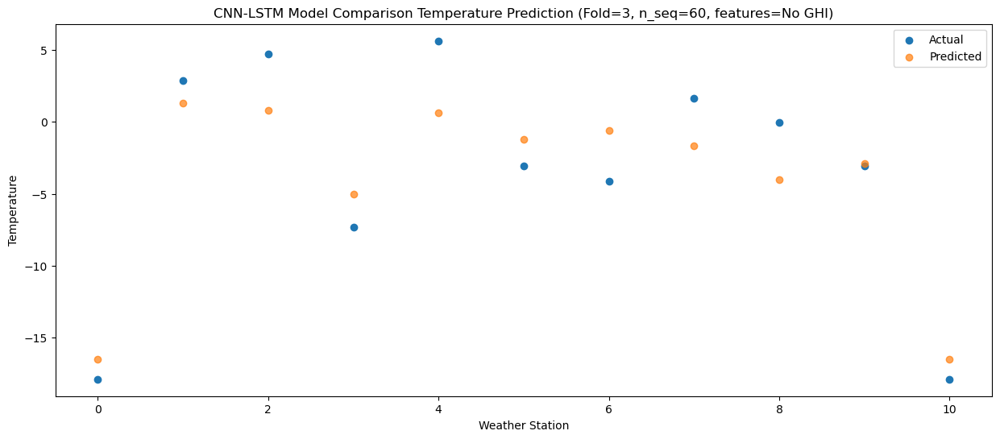

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0  -18.68 -18.105842
1                 1    1.54  -0.295732
2                 2    2.20  -0.825836
3                 3   -7.30  -6.665800
4                 4    2.38  -0.965711
5                 5   -2.84  -2.845737
6                 6   -9.81  -2.215797
7                 7   -3.08  -3.295810
8                 8   -1.29  -5.615855
9                 9   -5.84  -4.535807
10               10  -20.86 -18.105802


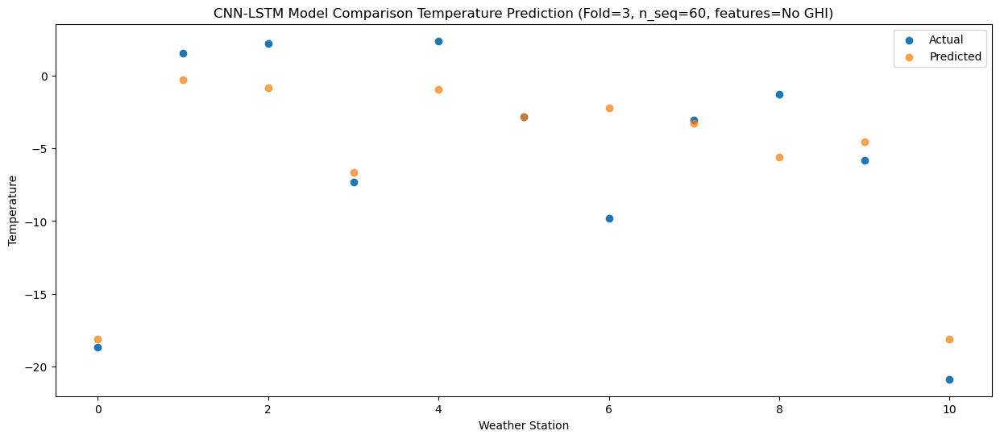

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0  -19.10 -18.564115
1                 1    0.70  -0.754031
2                 2    0.98  -1.284105
3                 3   -7.85  -7.124085
4                 4   -0.49  -1.424021
5                 5   -4.26  -3.304037
6                 6   -9.90  -2.674078
7                 7   -1.92  -3.754088
8                 8   -1.92  -6.074124
9                 9   -5.81  -4.994089
10               10  -20.45 -18.564083


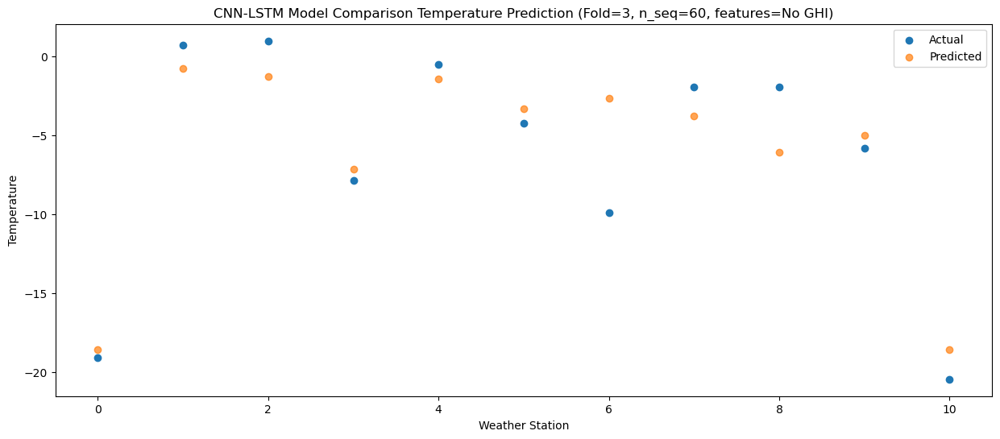

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0  -18.09 -18.388611
1                 1    0.85  -0.578488
2                 2    3.40  -1.108603
3                 3   -8.20  -6.948561
4                 4    0.66  -1.248466
5                 5   -4.67  -3.128494
6                 6   -9.71  -2.498555
7                 7   -0.41  -3.578572
8                 8    0.10  -5.898631
9                 9   -5.37  -4.818572
10               10  -19.53 -18.388569


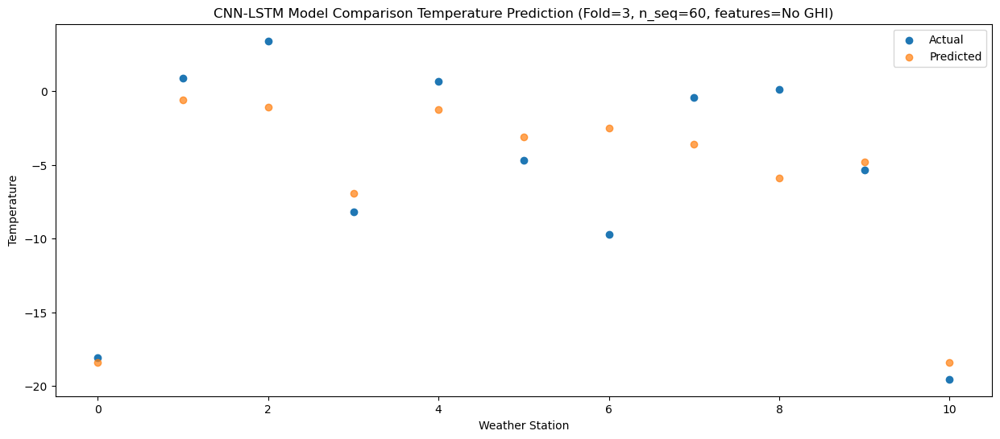

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0  -12.83 -12.240103
1                 1    8.34   5.570122
2                 2    5.19   5.039913
3                 3   -1.29  -0.800008
4                 4    8.07   4.900166
5                 5    2.19   3.020112
6                 6   -4.78   3.649990
7                 7    2.70   2.569962
8                 8   -0.46   0.249859
9                 9   -1.79   1.329962
10               10  -15.12 -12.240023


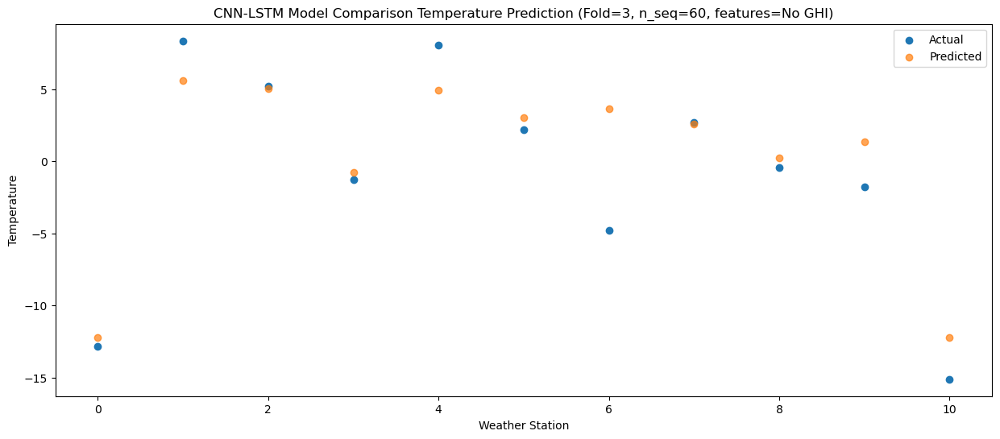

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0  -11.76 -10.423847
1                 1    9.26   7.386175
2                 2    9.85   6.856158
3                 3   -0.65   1.016165
4                 4   11.10   6.716158
5                 5    4.46   4.836168
6                 6   -1.80   5.466167
7                 7    8.61   4.386162
8                 8    3.16   2.066141
9                 9   -0.35   3.146166
10               10  -13.18 -10.423831


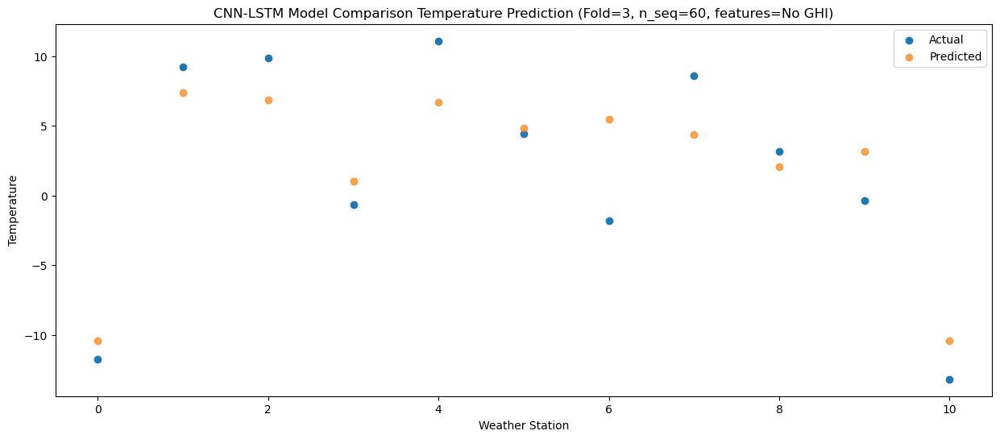

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   -9.07  -5.437210
1                 1   13.66  12.372679
2                 2   15.04  11.842784
3                 3    3.92   6.002744
4                 4   17.17  11.702622
5                 5    9.87   9.822677
6                 6    5.31  10.452755
7                 7   15.88   9.372763
8                 8    5.56   7.052793
9                 9    5.21   8.132763
10               10   -7.41  -5.437238


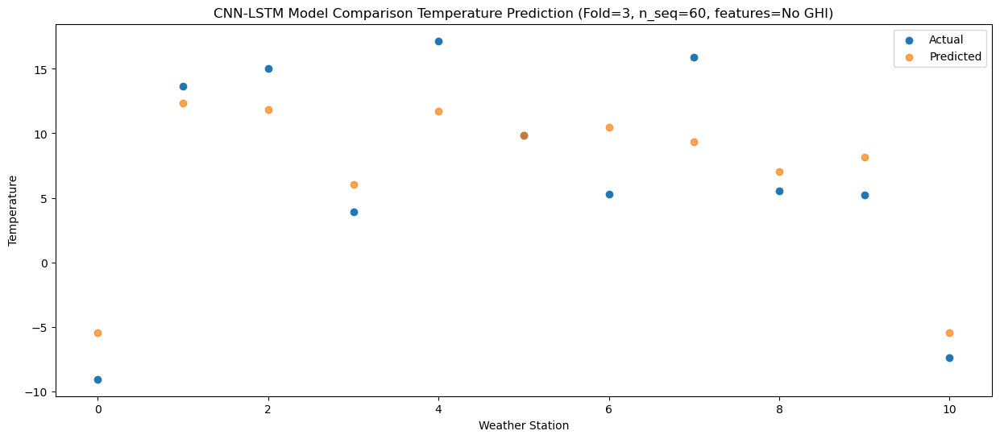

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   -3.75   0.713410
1                 1   20.76  18.523329
2                 2   18.39  17.993406
3                 3    9.74  12.153375
4                 4   24.22  17.853287
5                 5   16.86  15.973327
6                 6    9.52  16.603390
7                 7   19.34  15.523394
8                 8    8.10  13.203402
9                 9   12.19  14.283398
10               10   -0.69   0.713395


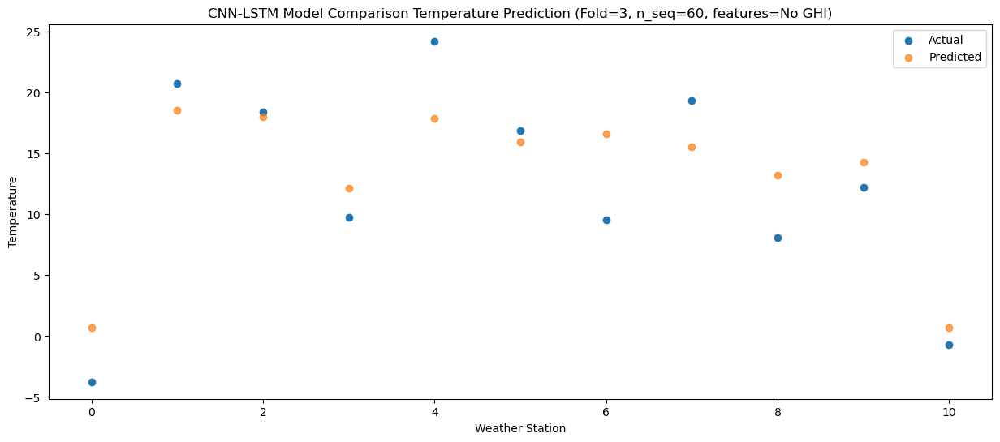

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   -0.89   2.962087
1                 1   22.62  20.771894
2                 2   21.17  20.242076
3                 3   13.54  14.402005
4                 4   25.68  20.101819
5                 5   18.75  18.221895
6                 6   11.51  18.852018
7                 7   23.57  17.772041
8                 8    7.29  15.452098
9                 9   16.14  16.532041
10               10    3.08   2.962033


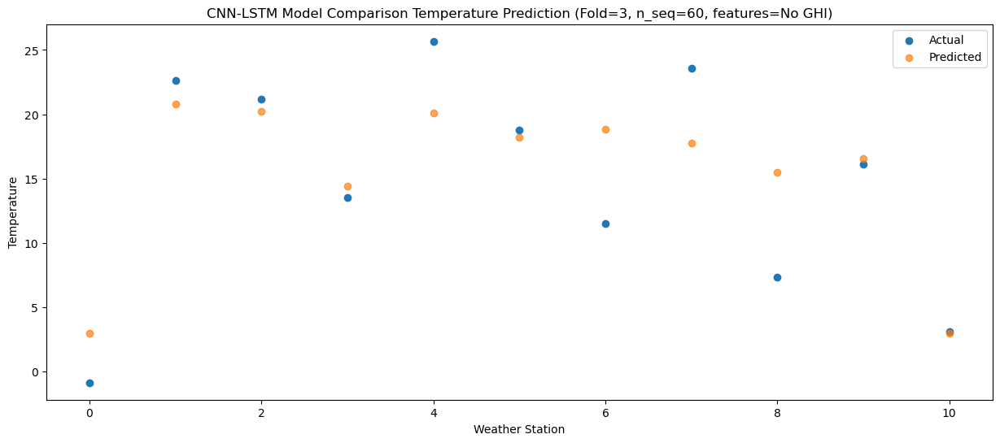

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   -2.12   1.404262
1                 1   20.76  19.213991
2                 2   21.70  18.684246
3                 3   11.12  12.844149
4                 4   23.12  18.543891
5                 5   16.24  16.663995
6                 6   12.26  17.294164
7                 7   23.68  16.214197
8                 8    9.17  13.894286
9                 9   14.96  14.974194
10               10    1.21   1.404185


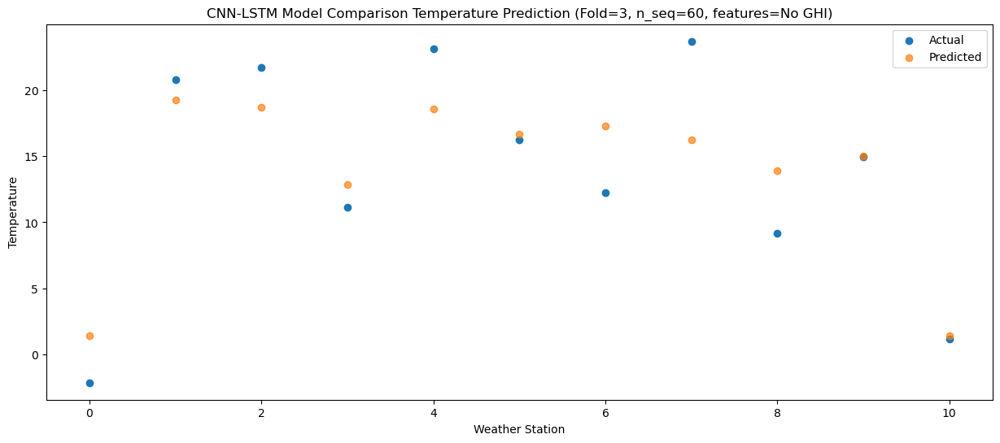

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   -6.09  -3.222540
1                 1   17.09  14.587181
2                 2   17.37  14.057438
3                 3    7.06   8.217343
4                 4   19.05  13.917078
5                 5   12.61  12.037190
6                 6    6.76  12.667358
7                 7   18.87  11.587391
8                 8    8.59   9.267482
9                 9   10.62  10.347387
10               10   -3.76  -3.222619


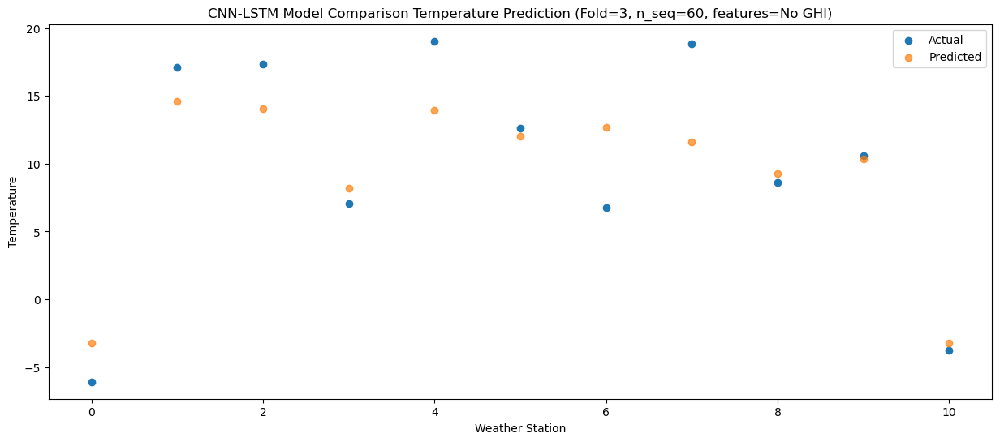

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   -9.66  -9.096959
1                 1    9.98   8.712819
2                 2   11.88   8.183020
3                 3    1.64   2.342948
4                 4   11.32   8.042733
5                 5    6.61   6.162826
6                 6    3.02   6.792961
7                 7   11.93   5.712985
8                 8    6.37   3.393052
9                 9    5.30   4.472984
10               10   -9.25  -9.097020


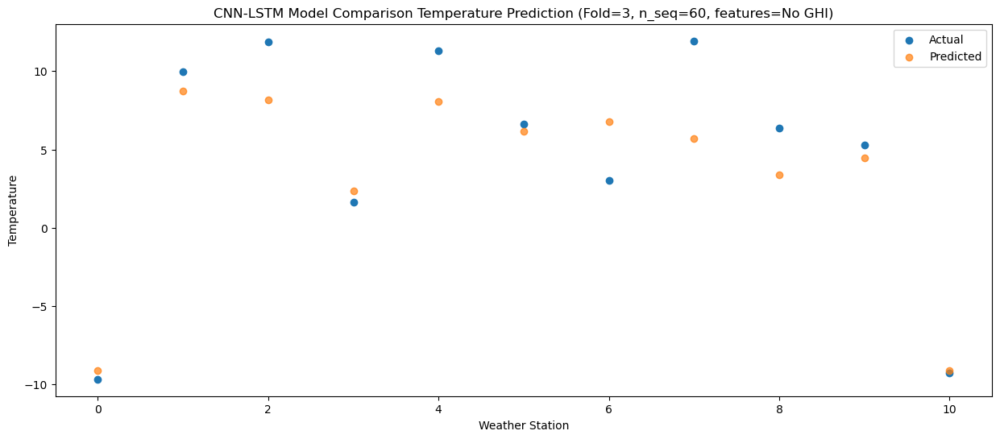

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0  -14.08 -12.450748
1                 1    7.16   5.358987
2                 2    3.23   4.829232
3                 3   -2.28  -1.010861
4                 4    8.50   4.688880
5                 5    2.67   2.808993
6                 6   -4.17   3.439151
7                 7    3.12   2.359183
8                 8   -0.79   0.039275
9                 9    1.23   1.119180
10               10  -13.53 -12.450827


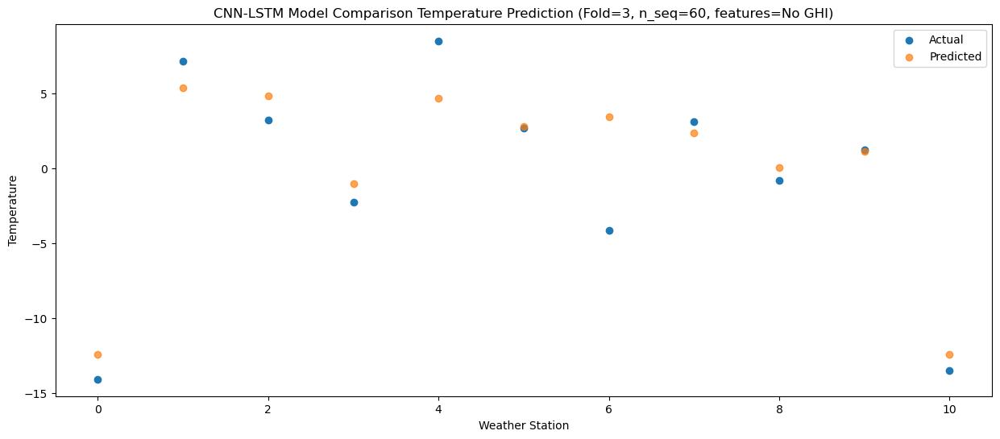

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0  -21.26 -19.221923
1                 1    0.61  -1.412215
2                 2    0.03  -1.941948
3                 3   -9.48  -7.782047
4                 4    1.33  -2.082328
5                 5   -4.94  -3.962205
6                 6   -9.87  -3.332034
7                 7   -2.57  -4.412002
8                 8   -2.84  -6.731900
9                 9   -5.11  -5.652000
10               10  -20.35 -19.222008


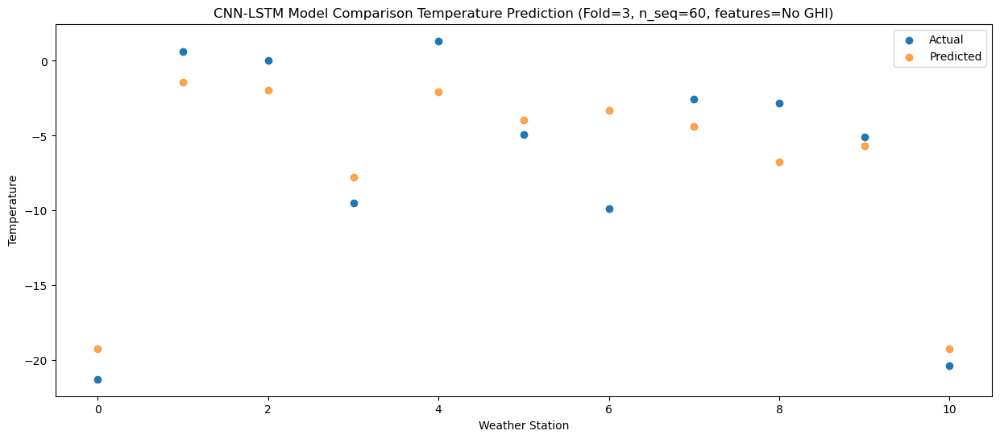

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -21.54 -20.666992
1                 1   -0.54  -2.857253
2                 2    1.29  -3.387019
3                 3  -10.94  -9.227103
4                 4   -0.14  -3.527352
5                 5   -6.39  -5.407242
6                 6   -9.60  -4.777091
7                 7   -2.02  -5.857061
8                 8   -1.62  -8.176975
9                 9   -8.13  -7.097060
10               10  -21.91 -20.667061


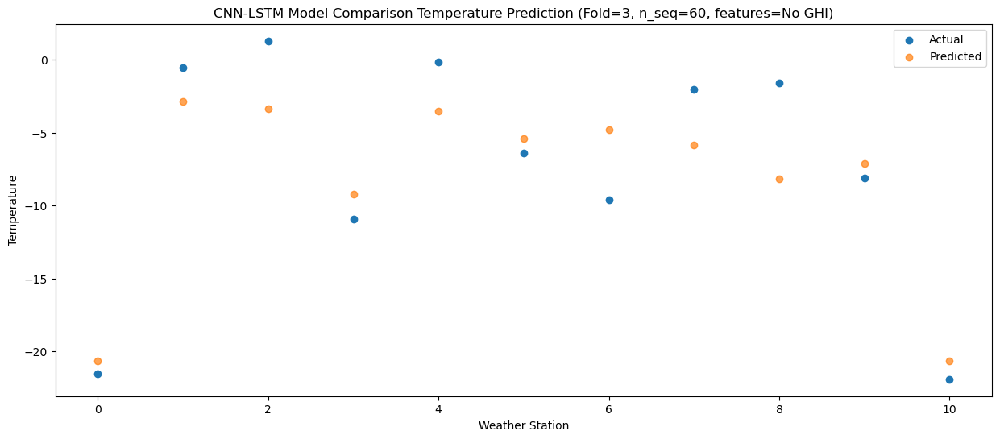

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -21.17 -23.062062
1                 1   -4.26  -5.252228
2                 2    3.59  -5.782082
3                 3  -12.26 -11.622127
4                 4   -4.01  -5.922295
5                 5   -9.11  -7.802214
6                 6   -9.50  -7.172120
7                 7    0.83  -8.252103
8                 8   -0.69 -10.572059
9                 9   -8.25  -9.492102
10               10  -22.71 -23.062097


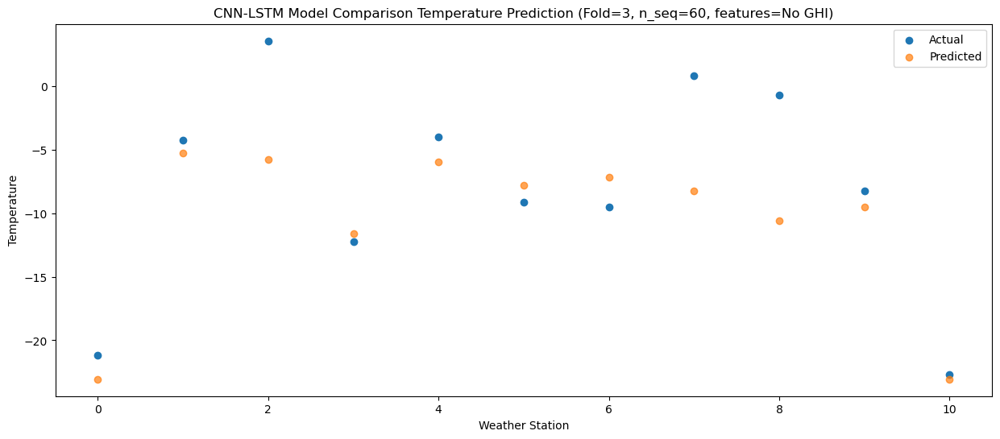

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0  -14.37 -13.741967
1                 1    7.71   4.067964
2                 2    4.74   3.538021
3                 3   -2.05  -2.301987
4                 4    9.07   3.397936
5                 5    2.22   1.517982
6                 6   -6.53   2.148016
7                 7    2.43   1.068026
8                 8   -0.91  -1.251983
9                 9   -3.25  -0.171974
10               10  -15.52 -13.741965


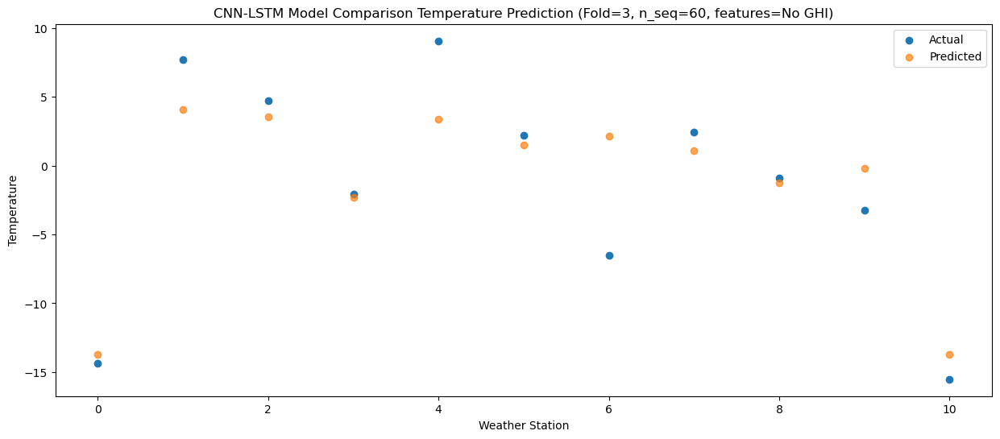

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0  -11.21 -10.188379
1                 1    9.57   7.621548
2                 2   10.47   7.091609
3                 3    0.30   1.251601
4                 4   12.36   6.951522
5                 5    5.67   5.071570
6                 6   -1.75   5.701606
7                 7   10.40   4.621610
8                 8    1.28   2.301605
9                 9    1.37   3.381614
10               10  -10.65 -10.188380


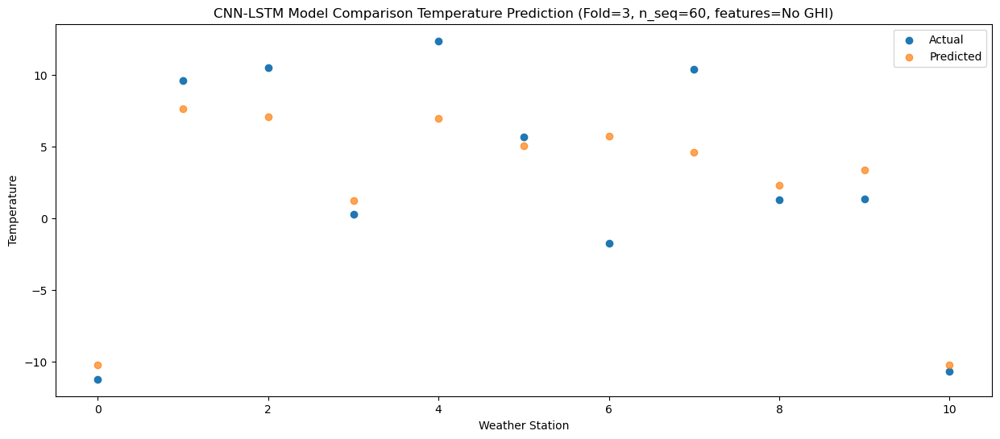

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   -7.55  -5.853479
1                 1   13.79  11.956475
2                 2   15.27  11.426505
3                 3    4.37   5.586511
4                 4   16.93  11.286447
5                 5    9.95   9.406493
6                 6    3.30  10.036516
7                 7   14.83   8.956514
8                 8    5.57   6.636501
9                 9    6.20   7.716526
10               10   -6.39  -5.853471


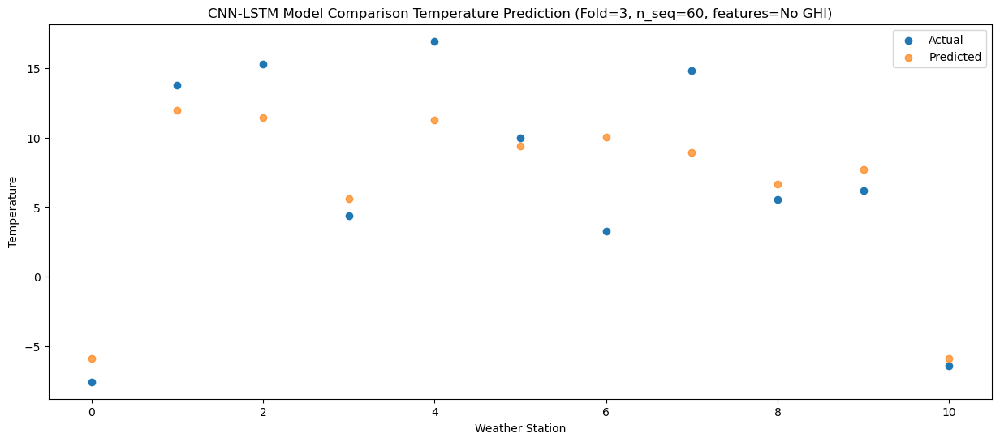

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   -3.49   0.037127
1                 1   20.50  17.847078
2                 2   20.12  17.317110
3                 3   10.29  11.477115
4                 4   24.41  17.177053
5                 5   16.66  15.297098
6                 6   10.69  15.927122
7                 7   22.47  14.847115
8                 8    7.27  12.527108
9                 9   12.07  13.607136
10               10   -0.22   0.037137


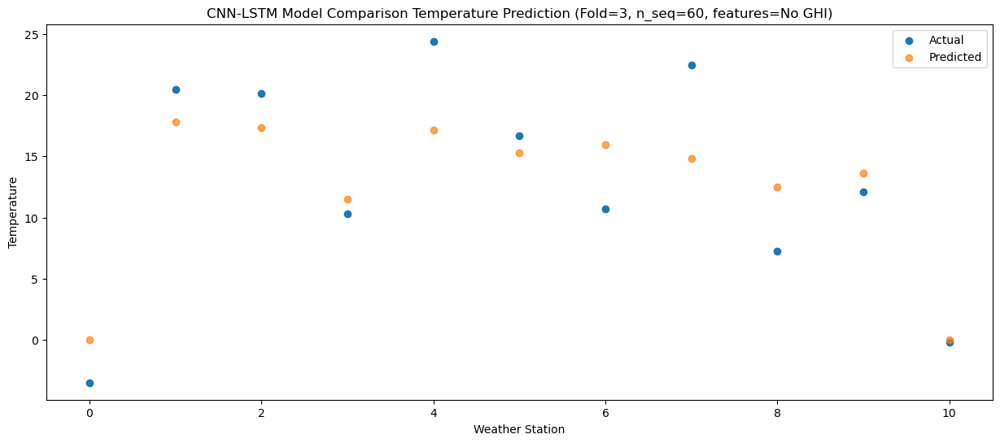

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   -1.78   0.560317
1                 1   21.81  18.370097
2                 2   23.25  17.840290
3                 3   11.28  12.000233
4                 4   24.41  17.700029
5                 5   17.04  15.820127
6                 6   12.53  16.450245
7                 7   23.55  15.370255
8                 8    6.45  13.050316
9                 9   14.21  14.130278
10               10    1.42   0.560270


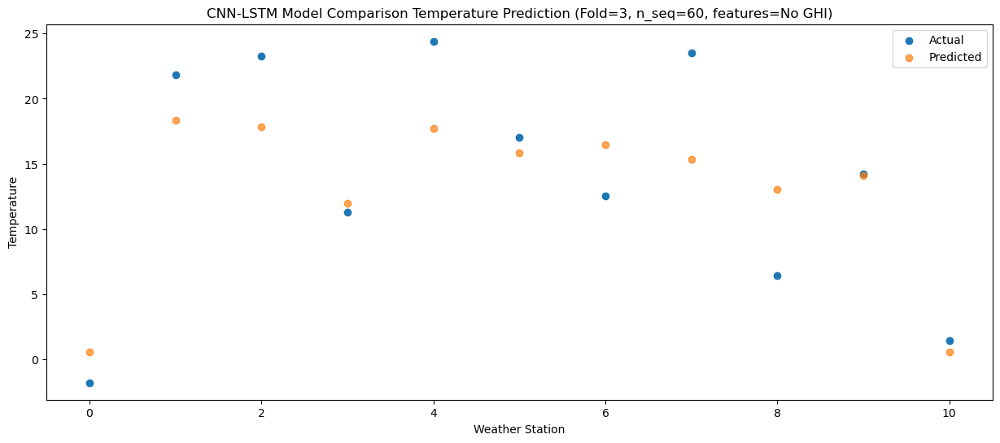

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   -1.56   0.929491
1                 1   22.38  18.739237
2                 2   21.05  18.209466
3                 3   11.80  12.369388
4                 4   24.53  18.069158
5                 5   17.36  16.189266
6                 6   10.61  16.819409
7                 7   22.32  15.739416
8                 8    7.00  13.419494
9                 9   14.83  14.499441
10               10    1.15   0.929429


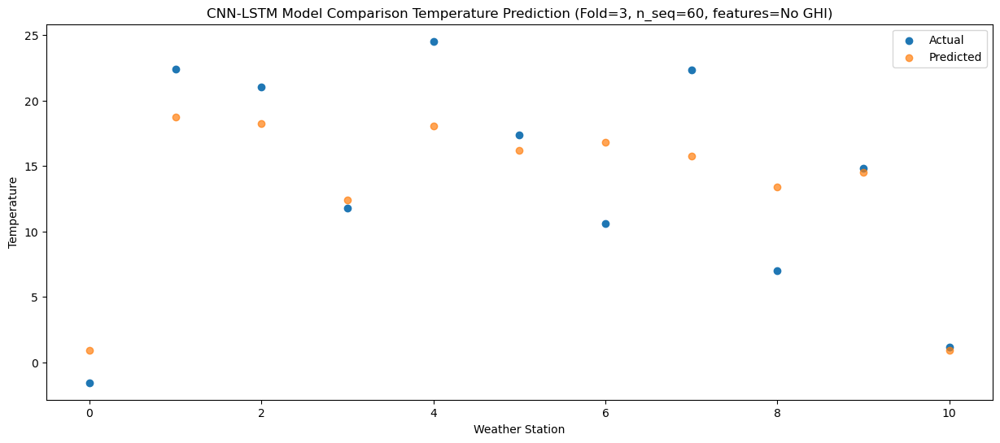

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   -5.55  -2.420212
1                 1   19.65  15.389466
2                 2   17.74  14.859761
3                 3    7.67   9.019654
4                 4   21.17  14.719366
5                 5   14.10  12.839494
6                 6    8.74  13.469677
7                 7   18.35  12.389693
8                 8    6.45  10.069799
9                 9   11.51  11.149720
10               10   -3.11  -2.420300


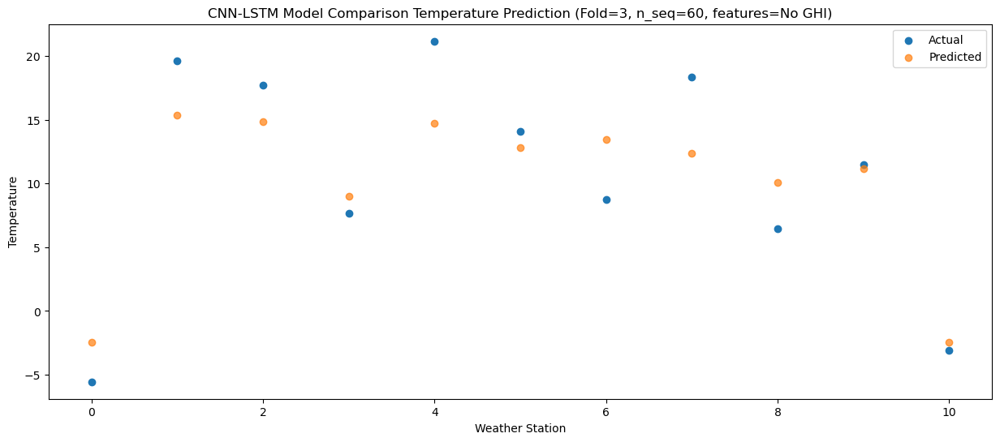

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   -8.78  -7.121477
1                 1   13.05  10.688125
2                 2    9.08  10.158495
3                 3    4.09   4.318356
4                 4   15.75  10.018009
5                 5    9.52   8.138161
6                 6    0.77   8.768382
7                 7    8.00   7.688406
8                 8    3.69   5.368548
9                 9    7.07   6.448429
10               10   -7.23  -7.121589


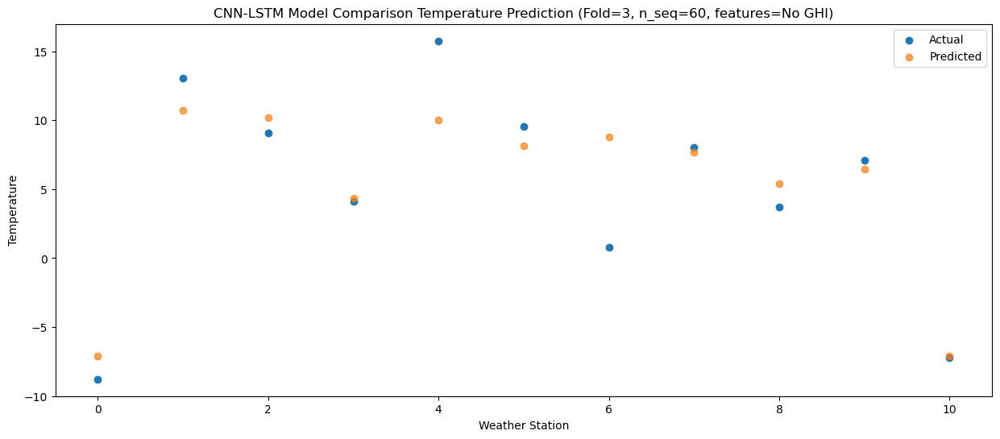

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0  -17.54 -15.971345
1                 1    5.34   1.838188
2                 2    4.74   1.308622
3                 3   -5.57  -4.531546
4                 4    6.01   1.168049
5                 5   -1.33  -0.711778
6                 6   -1.97  -0.081515
7                 7    5.48  -1.161483
8                 8    0.87  -3.481308
9                 9   -1.85  -2.401463
10               10  -17.45 -15.971483


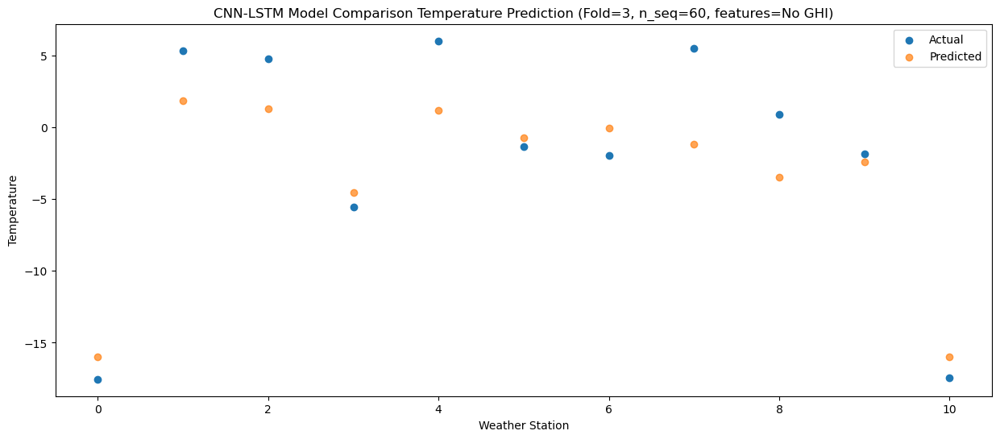

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0  -15.58 -16.581731
1                 1    6.65   1.227791
2                 2    0.82   0.698241
3                 3   -4.08  -5.141937
4                 4    5.65   0.557651
5                 5   -0.28  -1.322171
6                 6   -6.73  -0.691906
7                 7   -1.79  -1.771868
8                 8   -2.83  -4.091687
9                 9   -3.45  -3.011858
10               10  -17.86 -16.581872


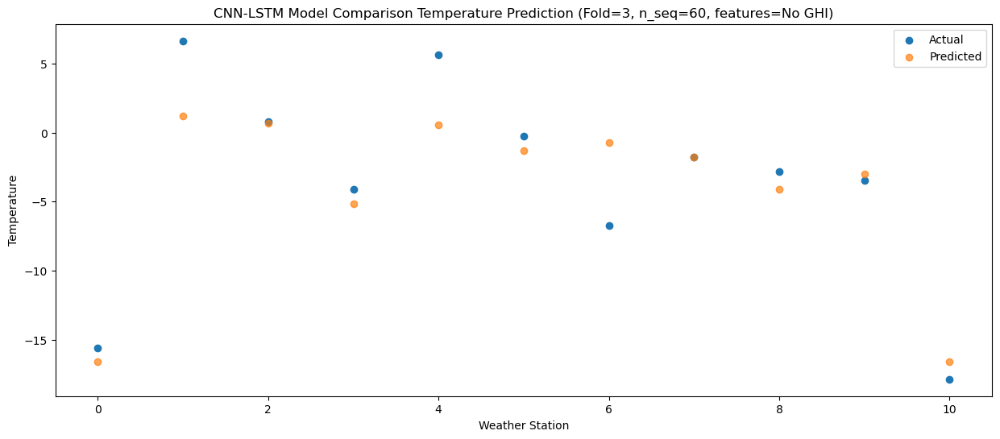

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -22.42 -24.132331
1                 1   -2.18  -6.322825
2                 2    0.49  -6.852364
3                 3  -13.03 -12.692545
4                 4   -3.82  -6.992972
5                 5   -9.10  -8.872789
6                 6   -9.02  -8.242516
7                 7   -1.86  -9.322478
8                 8   -2.21 -11.642287
9                 9  -10.00 -10.562463
10               10  -24.84 -24.132479


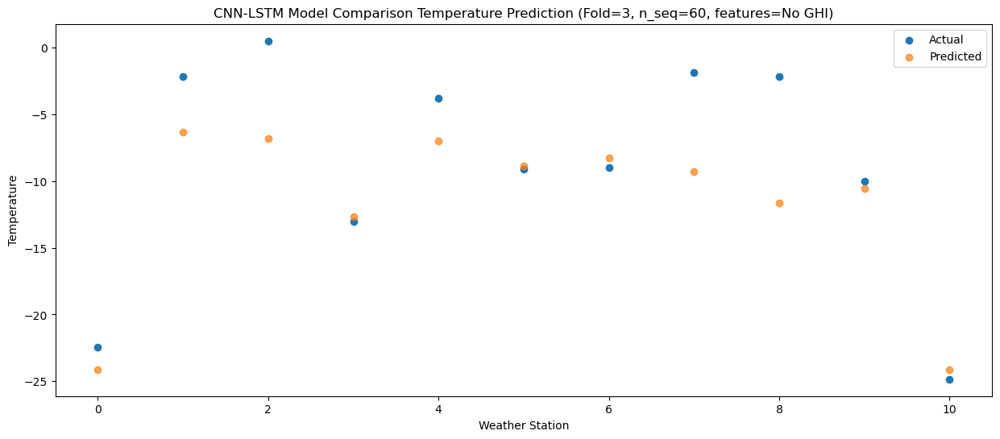

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0  -18.04 -21.648946
1                 1   -0.96  -3.839266
2                 2    2.19  -4.368967
3                 3   -8.51 -10.209081
4                 4   -1.30  -4.509360
5                 5   -5.91  -6.389231
6                 6  -10.74  -5.759065
7                 7    0.18  -6.839040
8                 8   -1.25  -9.158926
9                 9   -7.24  -8.079030
10               10  -21.03 -21.649038


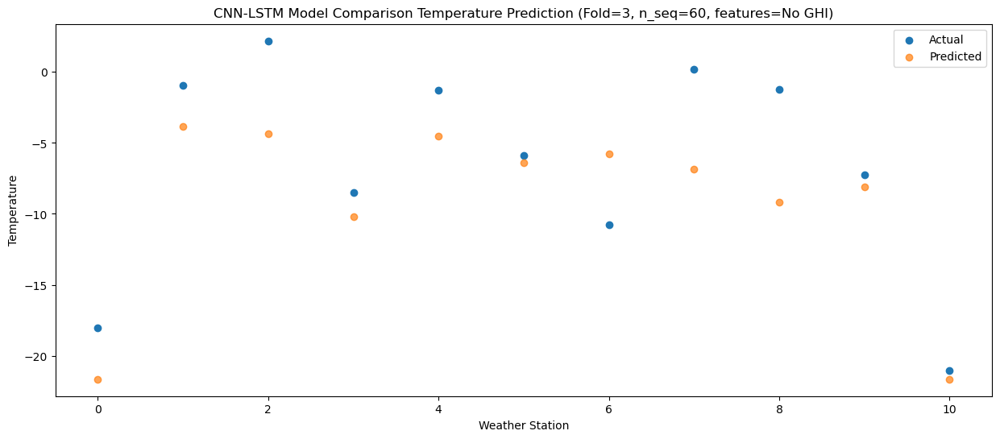

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0  -13.98 -16.010733
1                 1    5.82   1.799070
2                 2    6.90   1.269247
3                 3   -2.76  -4.570817
4                 4    7.16   1.129018
5                 5    1.05  -0.750893
6                 6   -6.20  -0.120805
7                 7    4.89  -1.200796
8                 8    0.98  -3.520733
9                 9   -3.28  -2.440780
10               10  -15.85 -16.010782


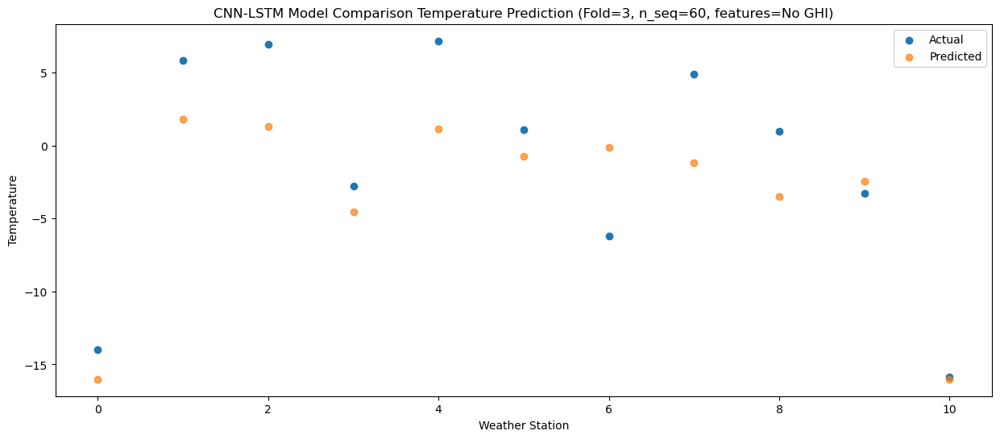

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0  -10.88 -11.298856
1                 1   10.67   6.511138
2                 2    9.97   5.981128
3                 3    0.25   0.141141
4                 4   11.29   5.841145
5                 5    4.90   3.961167
6                 6   -1.88   4.591150
7                 7    9.52   3.511136
8                 8    2.42   1.191111
9                 9    1.01   2.271156
10               10  -12.03 -11.298842


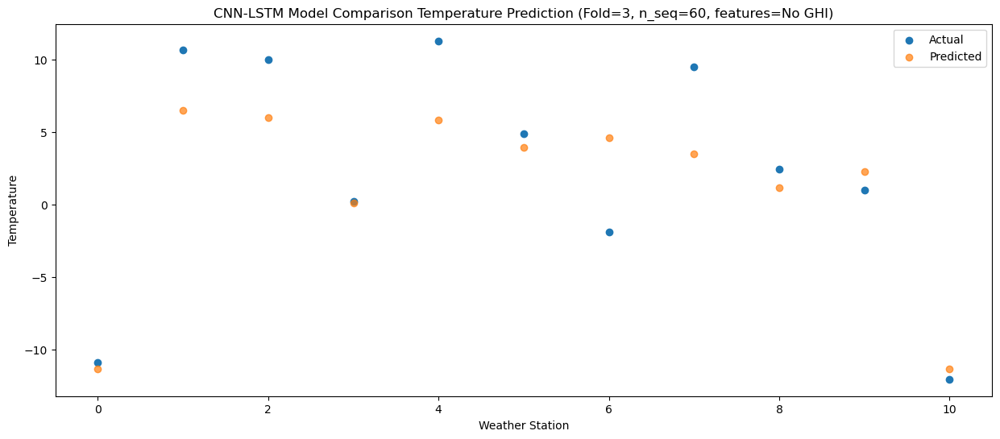

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   -6.04  -4.973435
1                 1   16.10  12.836437
2                 2   14.21  12.306541
3                 3    7.03   6.466509
4                 4   18.86  12.166410
5                 5   12.70  10.286470
6                 6    4.03  10.916523
7                 7   14.19   9.836525
8                 8    5.41   7.516554
9                 9    6.80   8.596539
10               10   -5.25  -4.973461


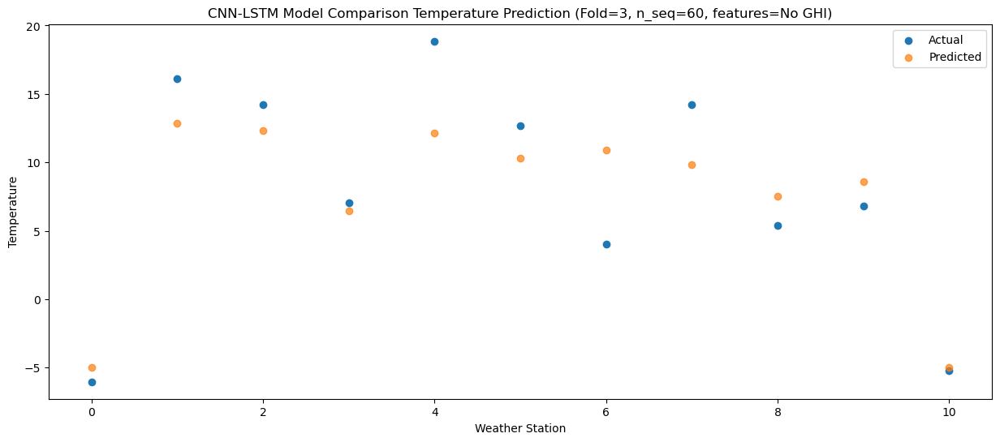

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   -2.08  -0.944865
1                 1   21.25  16.865074
2                 2   19.60  16.335115
3                 3   10.51  10.495110
4                 4   24.31  16.195067
5                 5   16.64  14.315109
6                 6    9.80  14.945120
7                 7   20.67  13.865116
8                 8    8.56  11.545111
9                 9   11.12  12.625130
10               10   -1.26  -0.944868


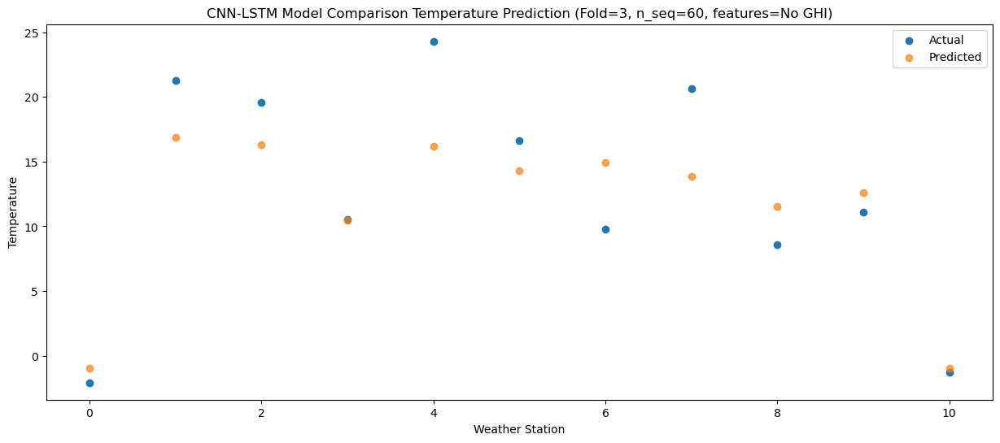

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   -1.31   0.850571
1                 1   25.29  18.660393
2                 2   22.17  18.130547
3                 3   12.06  12.290497
4                 4   25.43  17.990358
5                 5   18.63  16.110431
6                 6   11.72  16.740509
7                 7   22.90  15.660516
8                 8    6.91  13.340566
9                 9   15.67  14.420534
10               10    2.52   0.850527


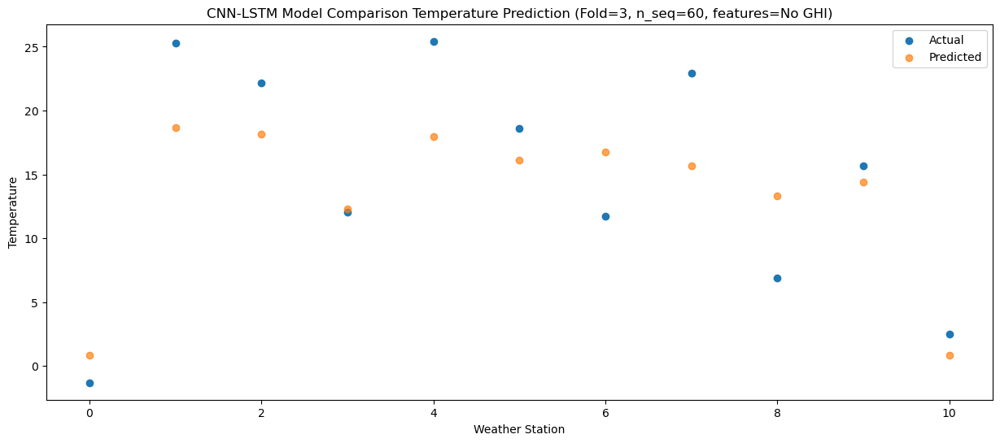

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   -2.22  -0.405869
1                 1   22.21  17.403910
2                 2   22.35  16.874108
3                 3   10.99  11.034035
4                 4   23.61  16.733859
5                 5   16.98  14.853948
6                 6   10.96  15.484052
7                 7   21.31  14.404064
8                 8    8.33  12.084135
9                 9   15.59  13.164078
10               10    1.65  -0.405932


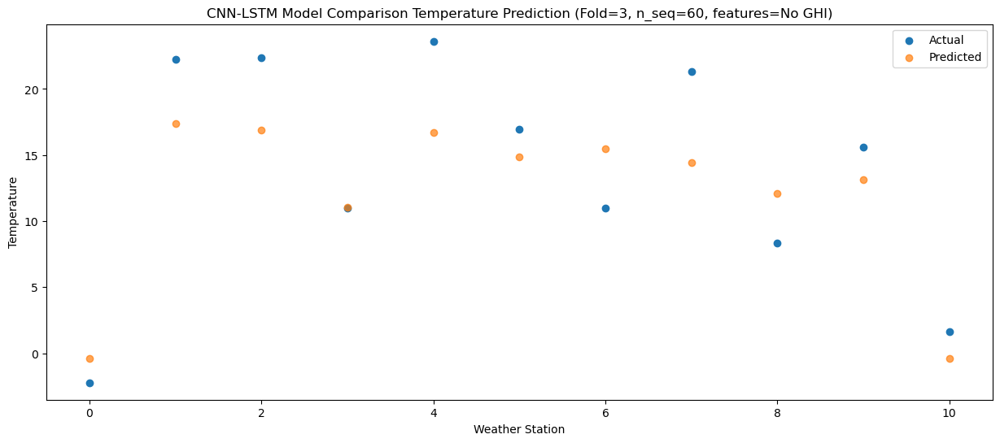

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   -5.43  -4.102253
1                 1   18.35  13.707570
2                 2   19.53  13.177723
3                 3    7.01   7.337667
4                 4   19.29  13.037532
5                 5   13.03  11.157605
6                 6    8.80  11.787683
7                 7   18.95  10.707689
8                 8    8.56   8.387743
9                 9   10.68   9.467706
10               10   -3.58  -4.102302


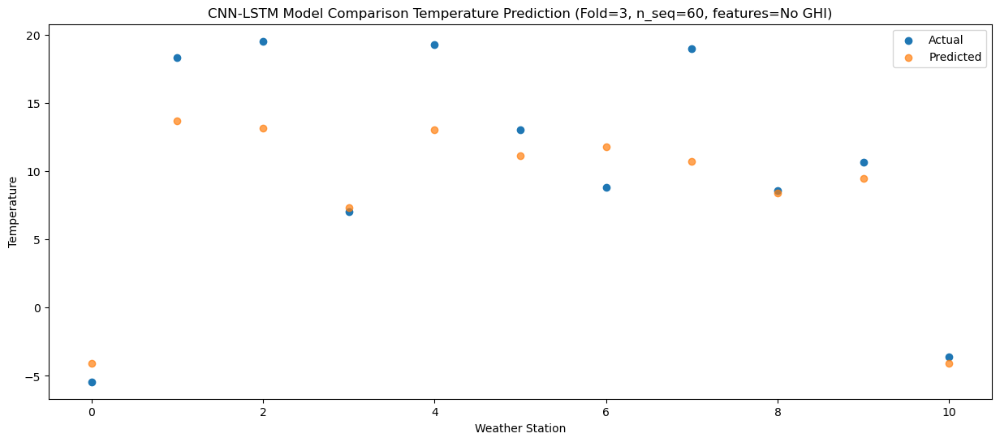

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0  -12.44 -10.927794
1                 1   11.80   6.881984
2                 2   12.35   6.352181
3                 3   -0.26   0.512108
4                 4   12.02   6.211930
5                 5    6.99   4.332019
6                 6    0.54   4.962127
7                 7   11.06   3.882137
8                 8    3.83   1.562207
9                 9    4.42   2.642154
10               10  -11.19 -10.927856


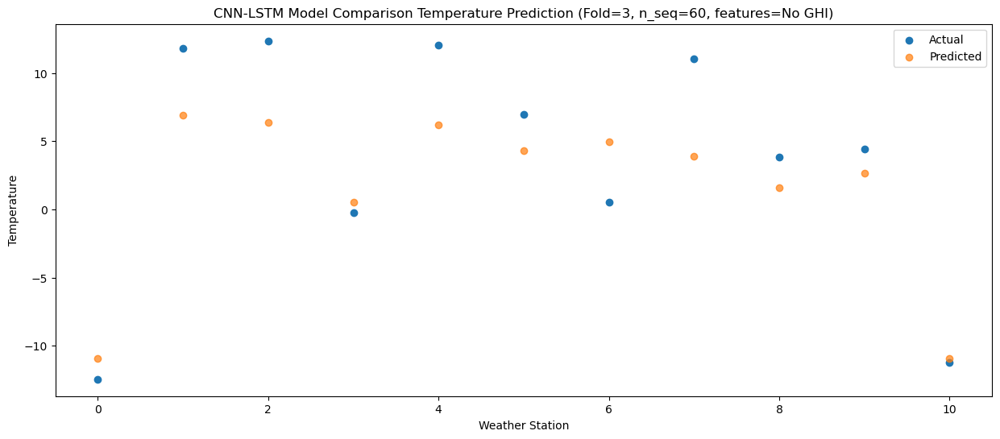

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0  -14.47 -16.573806
1                 1    4.57   1.235956
2                 2    1.62   0.706164
3                 3   -3.38  -5.133912
4                 4    6.13   0.565896
5                 5    0.44  -1.314010
6                 6   -7.14  -0.683894
7                 7   -0.36  -1.763878
8                 8   -1.90  -4.083806
9                 9    0.46  -3.003863
10               10  -14.31 -16.573876


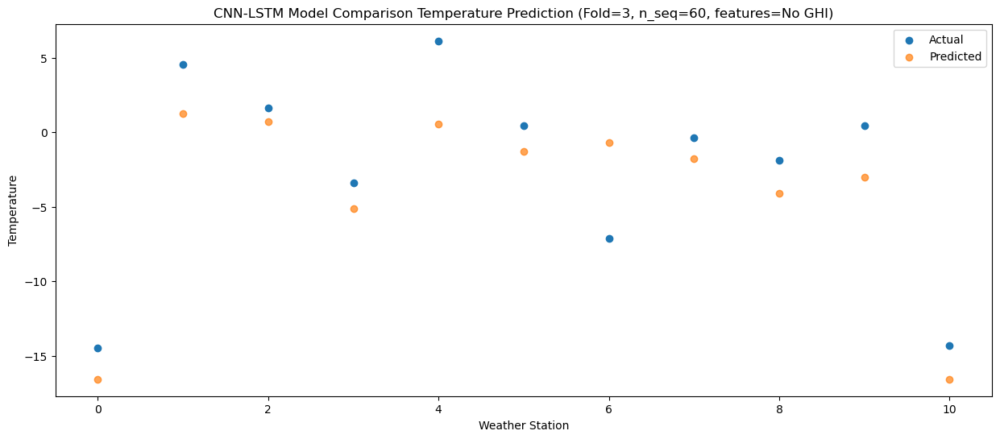

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0  -21.35 -21.903103
1                 1    0.52  -4.093498
2                 2    0.66  -4.623145
3                 3   -8.65 -10.463276
4                 4    0.16  -4.763604
5                 5   -5.10  -6.643461
6                 6   -9.31  -6.013255
7                 7   -2.69  -7.093223
8                 8   -3.10  -9.413083
9                 9   -5.90  -8.333204
10               10  -21.34 -21.903224


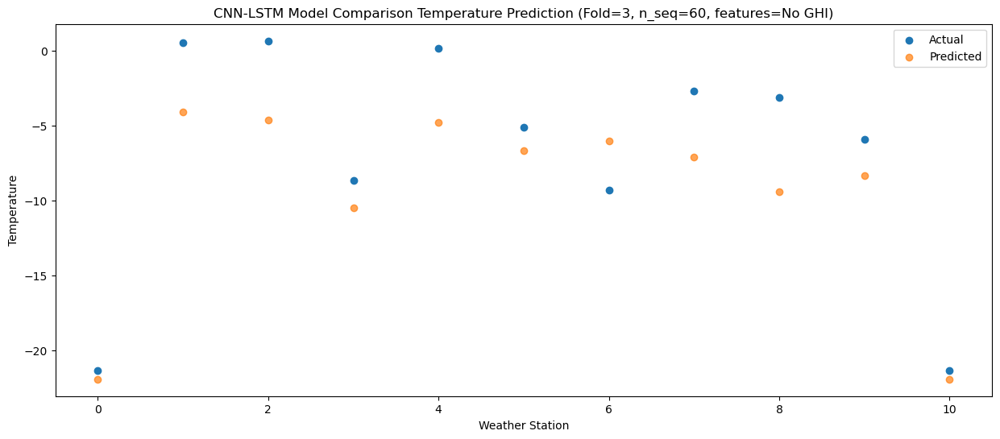

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0  -17.93 -20.848800
1                 1    1.22  -3.039272
2                 2    2.05  -3.568848
3                 3   -6.90  -9.409009
4                 4    1.88  -3.709399
5                 5   -2.96  -5.589232
6                 6  -10.04  -4.958980
7                 7   -3.20  -6.038941
8                 8   -1.43  -8.358773
9                 9   -3.92  -7.278927
10               10  -18.69 -20.848946


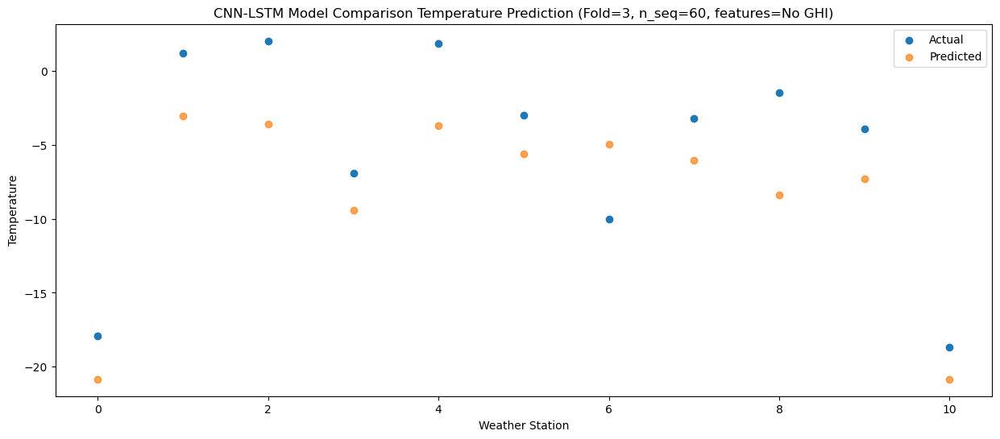

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0  -15.11 -20.291809
1                 1    3.18  -2.482274
2                 2    1.20  -3.011861
3                 3   -4.56  -8.852017
4                 4    8.40  -3.152397
5                 5   -1.24  -5.032234
6                 6  -10.01  -4.401986
7                 7   -2.29  -5.481947
8                 8   -3.23  -7.801782
9                 9   -5.65  -6.721933
10               10  -18.48 -20.291955


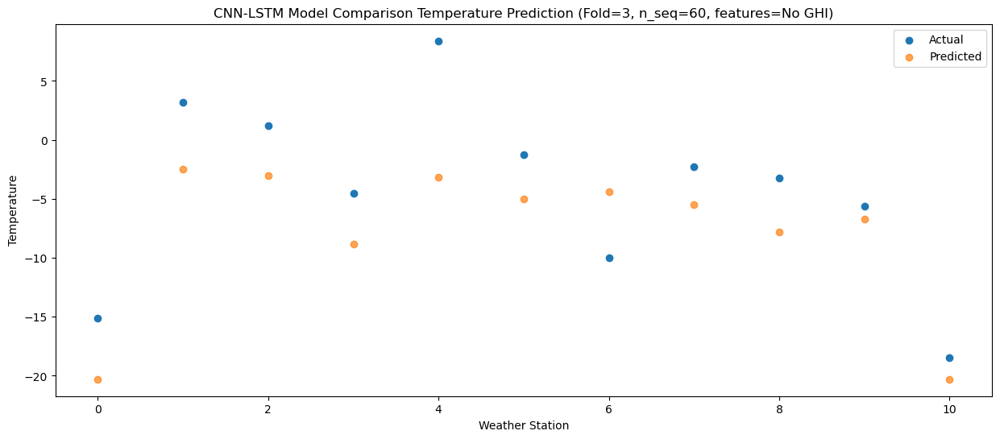

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0  -14.64 -17.742466
1                 1    5.78   0.067023
2                 2    4.07  -0.462530
3                 3   -4.32  -6.302697
4                 4    5.44  -0.603107
5                 5   -0.34  -2.482931
6                 6   -8.22  -1.852664
7                 7    0.54  -2.932625
8                 8   -1.77  -5.252438
9                 9   -3.68  -4.172609
10               10  -16.92 -17.742631


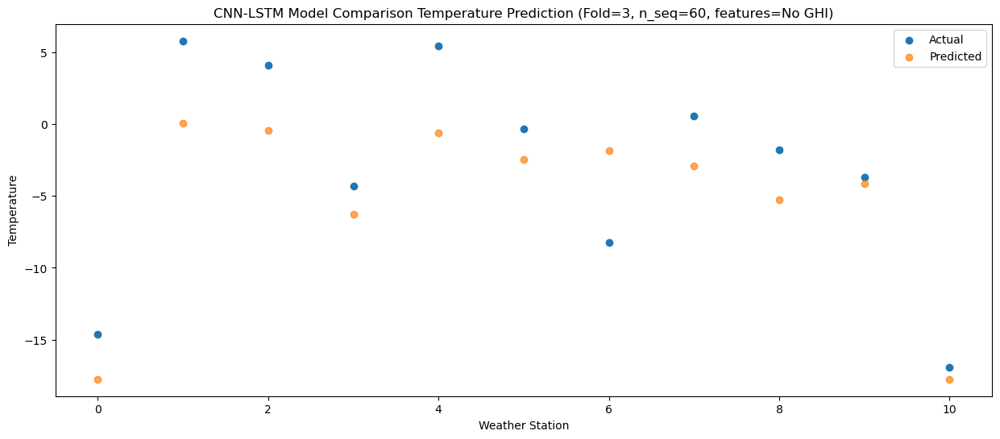

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0  -10.97 -12.134234
1                 1   10.83   5.675386
2                 2    9.70   5.145712
3                 3    1.92  -0.694400
4                 4   12.65   5.005297
5                 5    5.89   3.125430
6                 6   -2.88   3.755624
7                 7    8.49   2.675649
8                 8    2.31   0.355785
9                 9    2.37   1.435663
10               10   -9.35 -12.134350


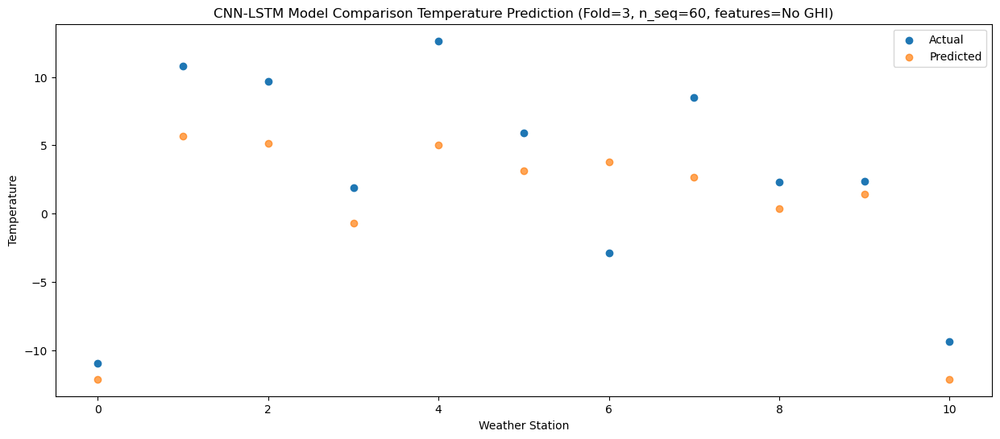

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   -8.61  -7.747650
1                 1   16.14  10.062008
2                 2   14.14   9.532296
3                 3    4.61   3.692199
4                 4   18.65   9.391934
5                 5   11.30   7.512050
6                 6    4.33   8.142223
7                 7   14.29   7.062244
8                 8    3.34   4.742365
9                 9    6.01   5.822260
10               10   -6.88  -7.747751


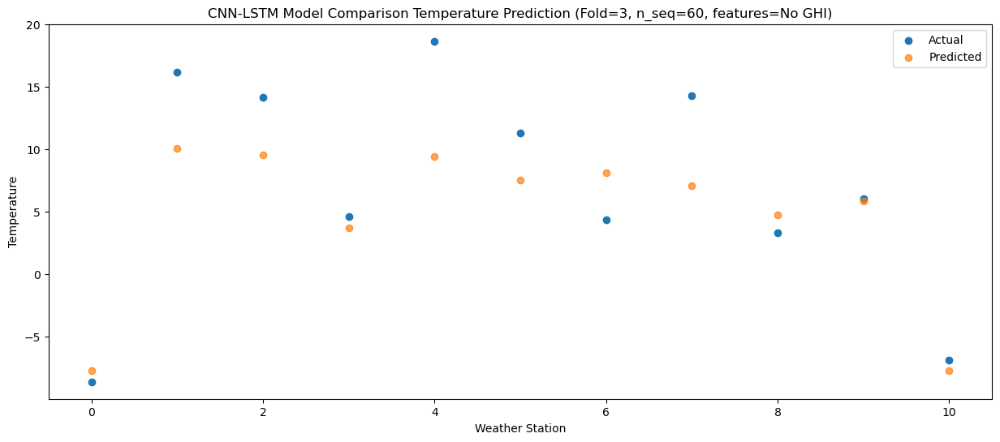

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   -4.84  -3.530432
1                 1   20.47  14.279281
2                 2   16.94  13.749516
3                 3    8.35   7.909436
4                 4   22.75  13.609220
5                 5   14.76  11.729322
6                 6    8.91  12.359460
7                 7   16.79  11.279478
8                 8    5.24   8.959578
9                 9   10.00  10.039488
10               10   -2.95  -3.530518


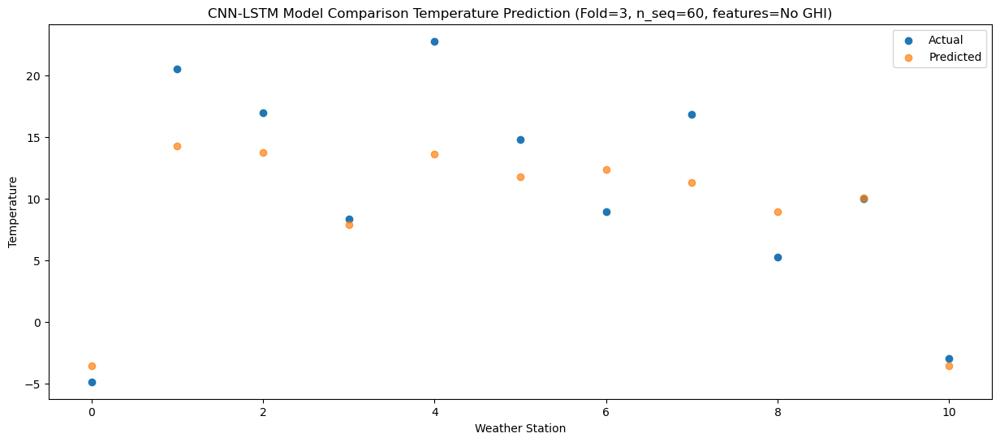

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   -1.06  -0.651544
1                 1   22.73  17.158210
2                 2   22.60  16.628400
3                 3   11.97  10.788339
4                 4   24.45  16.488166
5                 5   18.02  14.608249
6                 6   15.05  15.238355
7                 7   25.15  14.158367
8                 8    8.25  11.838458
9                 9   15.68  12.918381
10               10    1.89  -0.651622


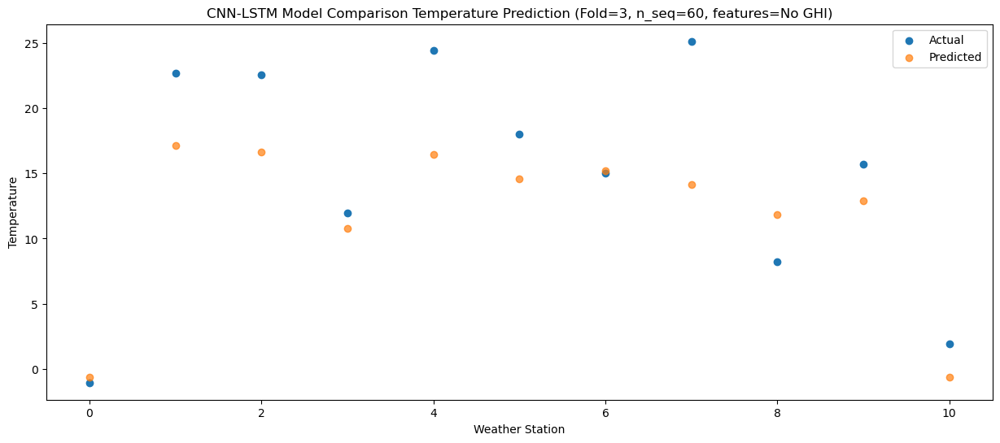

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   -1.57  -1.231128
1                 1   22.91  16.578788
2                 2   20.91  16.048818
3                 3   10.86  10.208823
4                 4   23.16  15.908791
5                 5   16.47  14.028821
6                 6   12.46  14.658831
7                 7   20.52  13.578820
8                 8    9.28  11.258842
9                 9   13.43  12.338844
10               10   -0.08  -1.231158


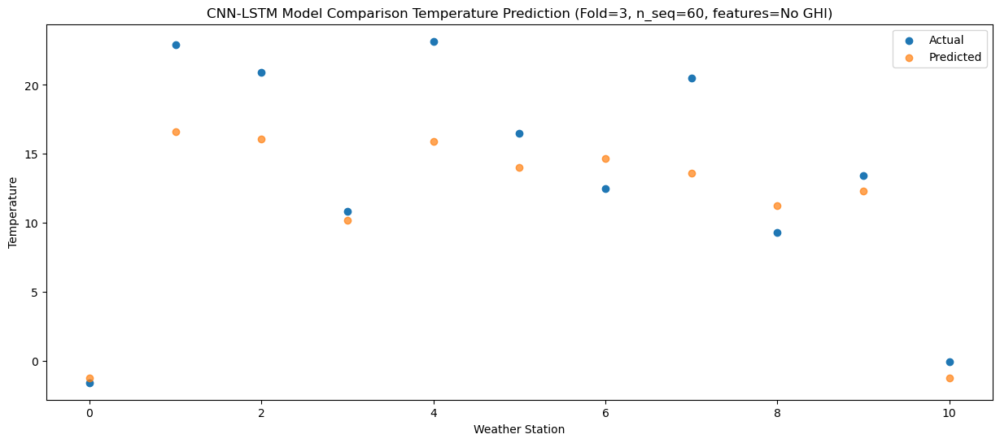

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   -5.71  -4.540691
1                 1   18.86  13.269173
2                 2   17.14  12.739251
3                 3    8.13   6.899235
4                 4   19.80  12.599163
5                 5   13.01  10.719206
6                 6    8.31  11.349247
7                 7   15.82  10.269242
8                 8    6.67   7.949287
9                 9   10.86   9.029265
10               10   -3.37  -4.540741


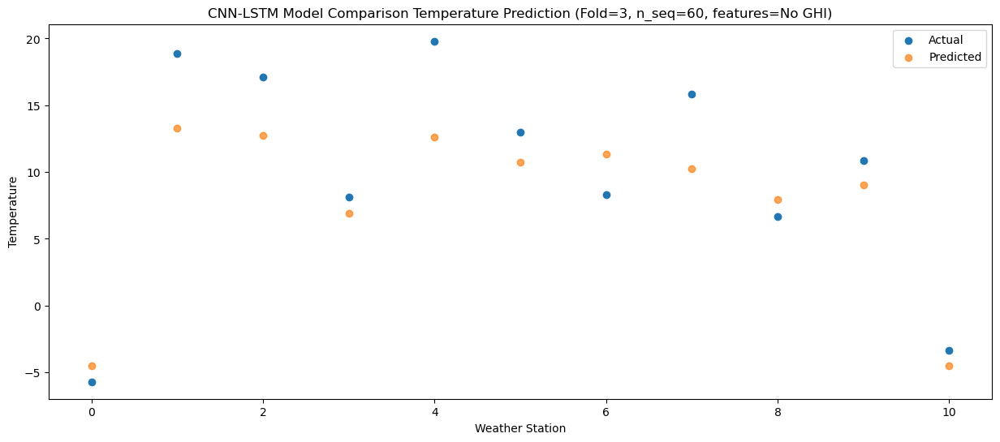

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0  -10.74 -10.938688
1                 1   11.92   6.871087
2                 2   11.83   6.341250
3                 3    2.69   0.501197
4                 4   13.34   6.201050
5                 5    7.36   4.321118
6                 6    2.18   4.951210
7                 7   10.53   3.871216
8                 8    5.21   1.551304
9                 9    5.43   2.631239
10               10   -8.66 -10.938771


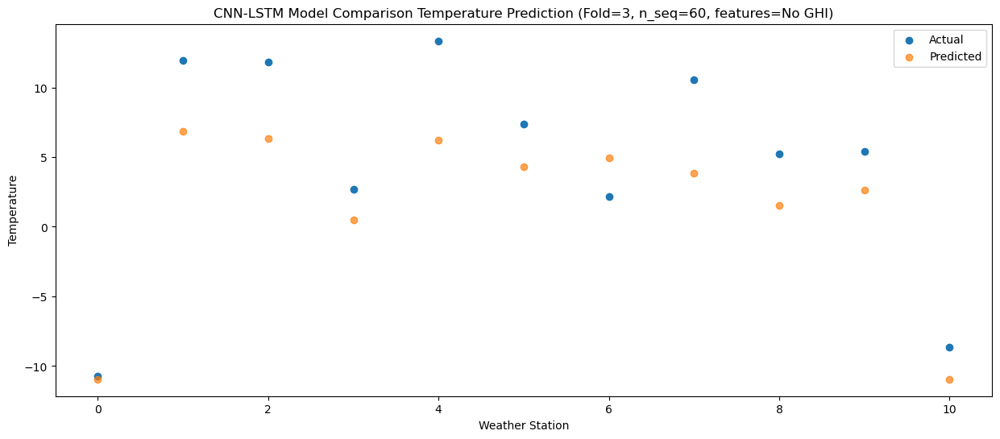

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0  -16.40 -17.800859
1                 1    6.14   0.008955
2                 2    4.92  -0.520917
3                 3   -3.70  -6.360957
4                 4    6.39  -0.661072
5                 5    0.88  -2.541012
6                 6   -3.68  -1.910942
7                 7    2.39  -2.990940
8                 8    1.17  -5.310872
9                 9   -2.42  -4.230920
10               10  -16.93 -17.800928


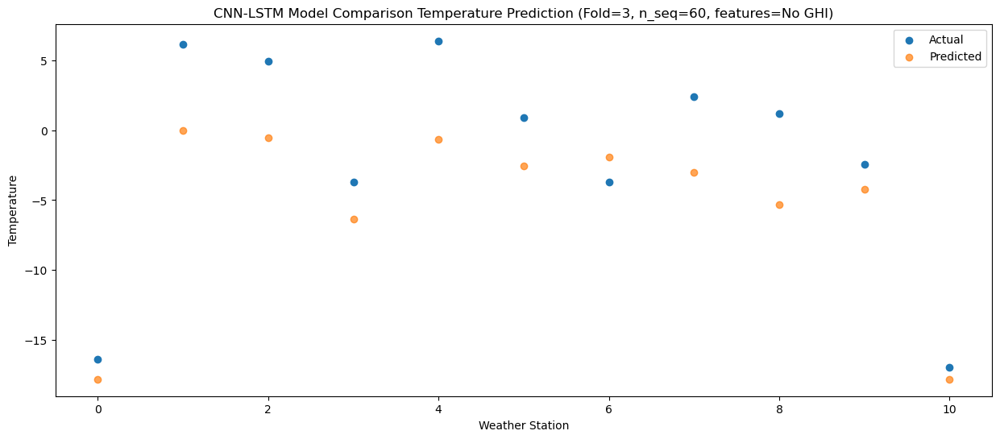

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0  -18.45 -20.128737
1                 1    2.79  -2.318850
2                 2    3.08  -2.848794
3                 3   -5.53  -8.688801
4                 4    3.58  -2.988858
5                 5   -1.58  -4.868818
6                 6   -7.31  -4.238791
7                 7   -0.74  -5.318798
8                 8   -0.67  -7.638764
9                 9   -3.15  -6.558776
10               10  -17.68 -20.128781


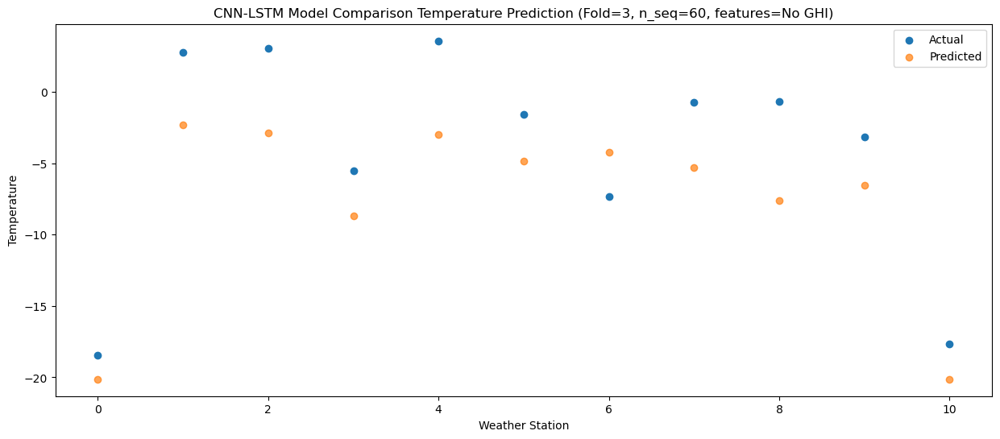

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -20.76 -24.969325
1                 1   -3.82  -7.159498
2                 2    2.87  -7.689387
3                 3  -10.69 -13.529415
4                 4   -2.92  -7.829525
5                 5   -7.74  -9.709466
6                 6   -9.45  -9.079406
7                 7   -2.46 -10.159407
8                 8   -0.36 -12.479346
9                 9   -7.14 -11.399383
10               10  -20.70 -24.969390


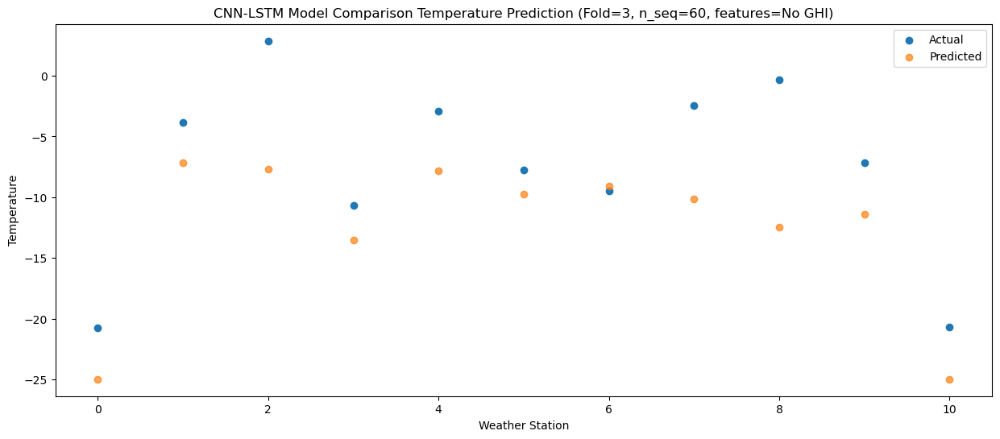

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0  -17.62 -19.983468
1                 1    5.83  -2.173769
2                 2    4.36  -2.703539
3                 3   -5.01  -8.543612
4                 4    4.89  -2.843830
5                 5   -1.11  -4.723729
6                 6   -7.29  -4.093596
7                 7   -0.10  -5.173585
8                 8   -0.65  -7.493470
9                 9   -6.57  -6.413569
10               10  -18.66 -19.983578


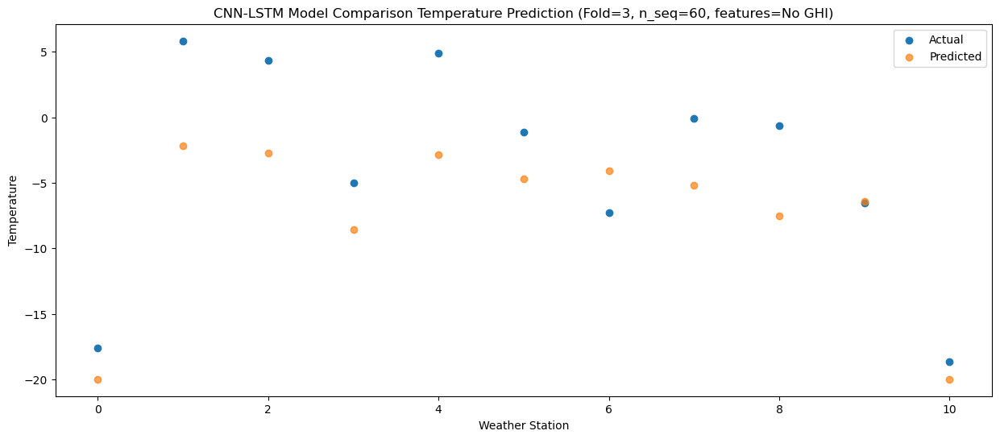

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0  -13.95 -16.780557
1                 1    8.31   1.028976
2                 2    6.39   0.499359
3                 3   -1.36  -5.340775
4                 4    9.00   0.358860
5                 5    2.96  -1.520981
6                 6   -5.55  -0.890752
7                 7    3.26  -1.970723
8                 8    0.28  -4.290536
9                 9   -1.87  -3.210707
10               10  -14.00 -16.780723


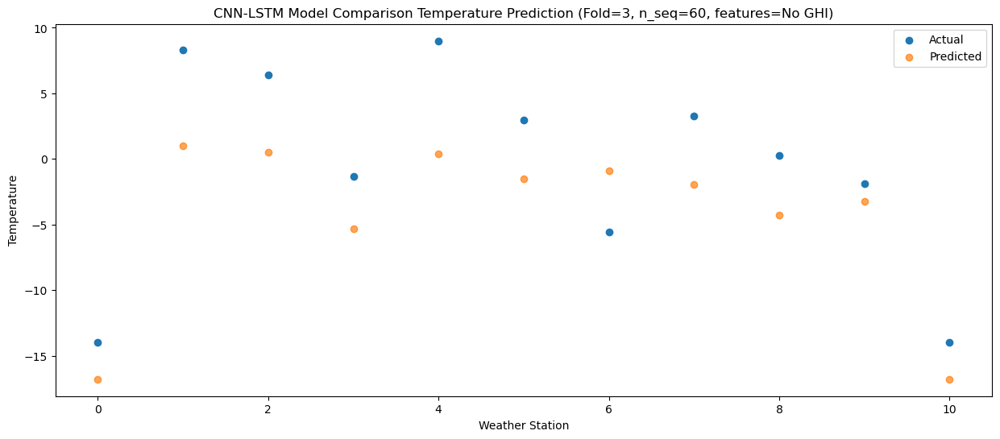

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -9.93 -12.712361
1                 1   12.48   5.097134
2                 2    9.58   4.567554
3                 3    3.70  -1.272599
4                 4   13.75   4.427007
5                 5    7.93   2.547173
6                 6   -0.57   3.177428
7                 7    8.76   2.097461
8                 8    2.51  -0.222330
9                 9    1.00   0.857477
10               10   -9.42 -12.712547


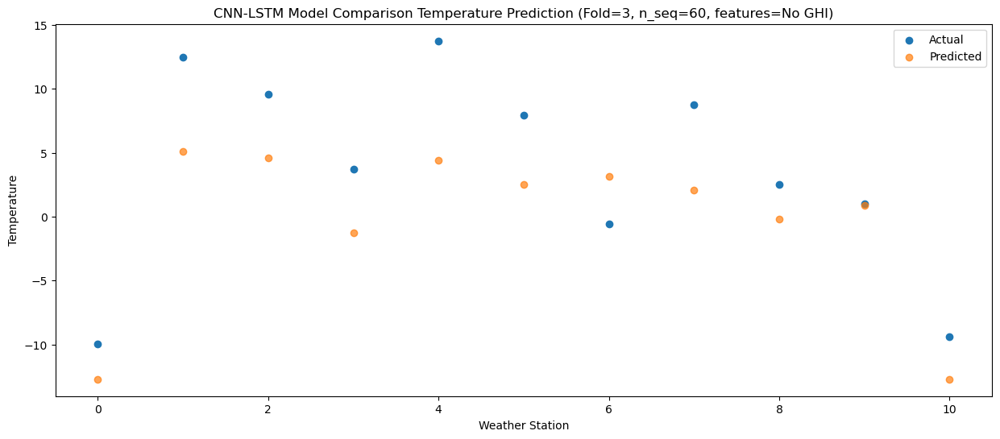

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   -5.66  -7.125677
1                 1   17.25  10.683742
2                 2   14.97  10.154236
3                 3    7.89   4.314049
4                 4   19.91  10.013593
5                 5   13.45   8.133786
6                 6    2.54   8.764076
7                 7   14.39   7.684122
8                 8    5.48   5.364373
9                 9    6.55   6.444140
10               10   -3.75  -7.125887


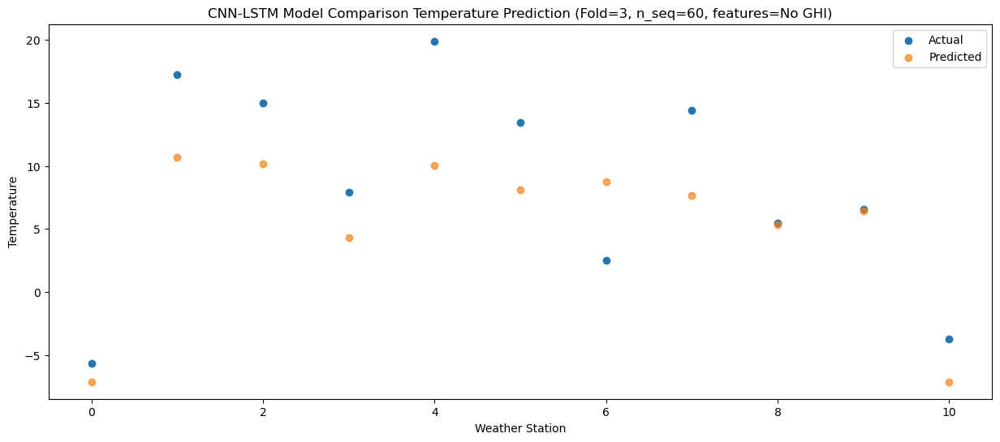

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   -2.00  -2.821404
1                 1   21.81  14.987891
2                 2   20.92  14.458496
3                 3   11.79   8.618268
4                 4   24.78  14.317700
5                 5   16.68  12.437942
6                 6   11.69  13.068300
7                 7   22.57  11.988358
8                 8    8.39   9.668658
9                 9   13.02  10.748377
10               10    1.62  -2.821654


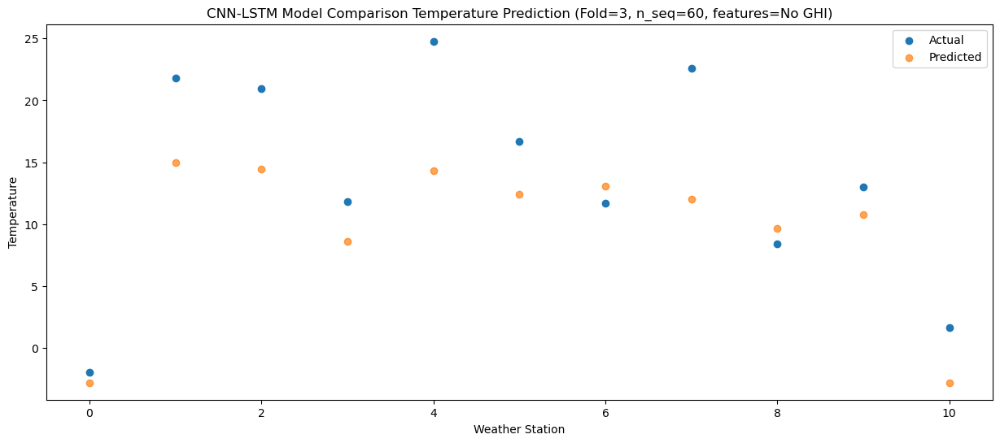

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   -1.11  -2.229138
1                 1   22.33  15.580179
2                 2   24.49  15.050756
3                 3   13.50   9.210541
4                 4   23.94  14.909990
5                 5   17.23  13.030228
6                 6   12.44  13.660571
7                 7   25.65  12.580629
8                 8    9.65  10.260920
9                 9   15.58  11.340651
10               10    4.28  -2.229382


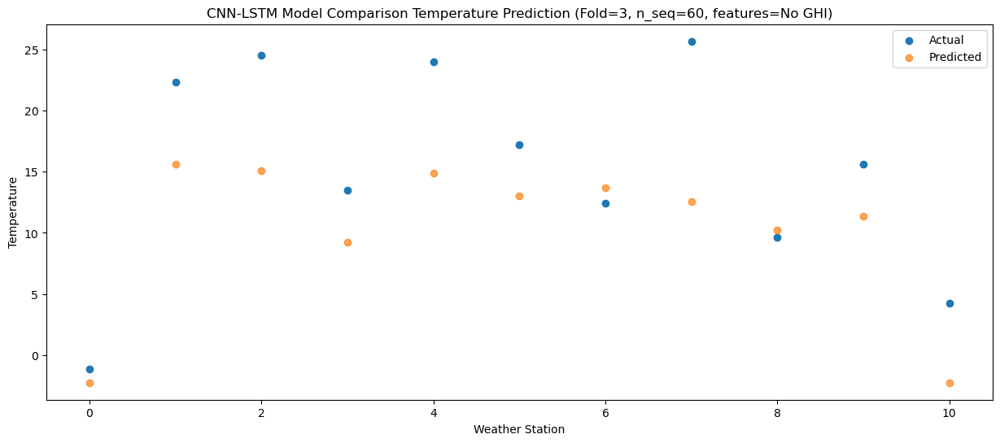

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   -2.51  -2.705092
1                 1   22.61  15.104248
2                 2   21.52  14.574798
3                 3   12.48   8.734596
4                 4   23.39  14.434062
5                 5   16.68  12.554299
6                 6   12.15  13.184625
7                 7   22.79  12.104676
8                 8    8.37   9.784956
9                 9   13.86  10.864704
10               10    1.14  -2.705329


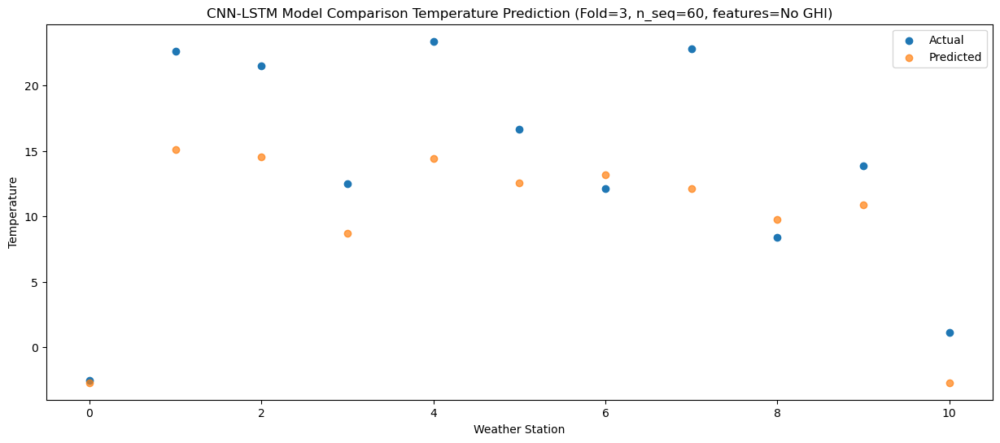

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   -5.20  -5.744902
1                 1   18.57  12.064412
2                 2   18.49  11.534986
3                 3    9.51   5.694777
4                 4   20.13  11.394222
5                 5   13.99   9.514462
6                 6    8.53  10.144805
7                 7   18.84   9.064860
8                 8    6.93   6.745152
9                 9    9.85   7.824887
10               10   -2.45  -5.745142


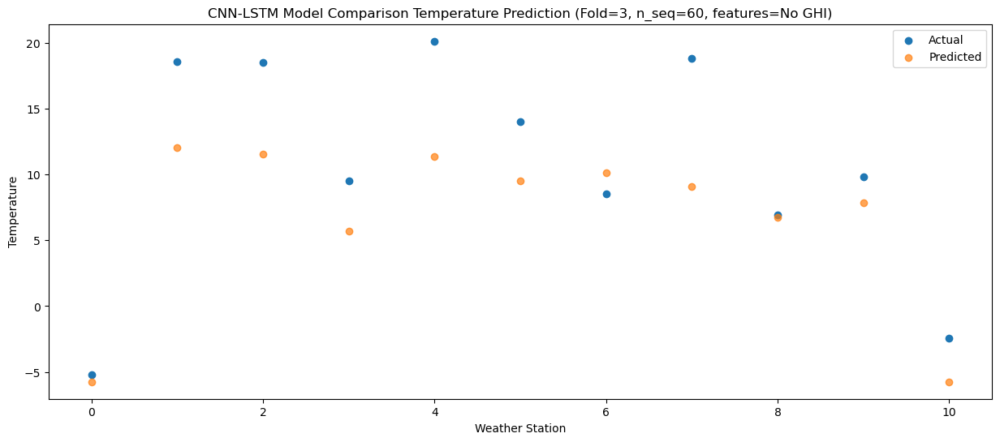

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0  -10.51 -10.810997
1                 1   15.18   6.998305
2                 2   13.46   6.468889
3                 3    3.01   0.628679
4                 4   14.50   6.328110
5                 5    8.11   4.448353
6                 6    4.30   5.078704
7                 7   12.95   3.998762
8                 8    6.47   1.679054
9                 9    5.32   2.758786
10               10   -7.69 -10.811242


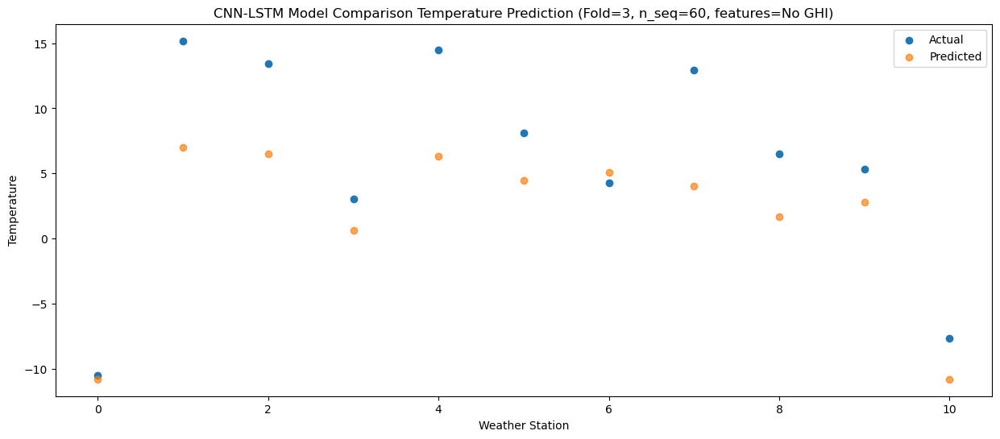

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_3 (Conv1D)           (None, 1, 512)            929792    
                                                                 
 max_pooling1d_3 (MaxPooling  (None, 1, 512)           0         
 1D)                                                             
                                                                 
 dropout_9 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_6 (LSTM)               (None, 1, 1024)           6295552   
                                                                 
 dropout_10 (Dropout)        (None, 1, 1024)           0         
                                                                 
 lstm_7 (LSTM)               (None, 1024)              8392704   
                                                      

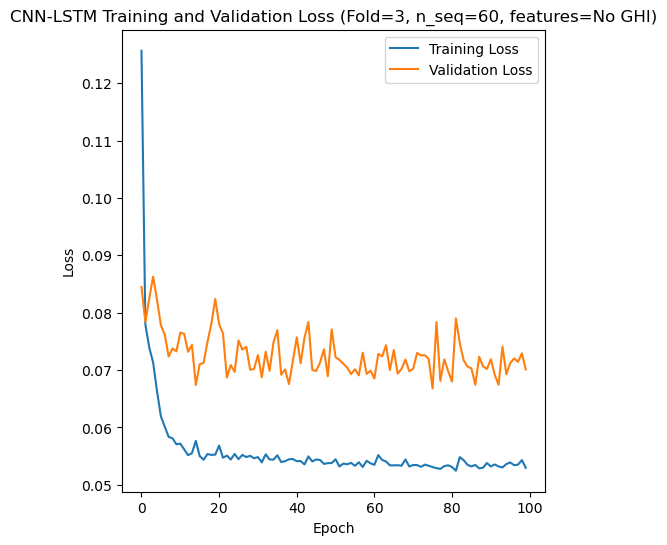

Epoch 1/100
84/84 [==============================] - 20s 112ms/step - loss: 0.1164 - accuracy: 0.2262 - mae: 0.0948 - rmse: 0.1164 - mape: inf - pearson: 0.6448 - val_loss: 0.0865 - val_accuracy: 0.1000 - val_mae: 0.0690 - val_rmse: 0.0865 - val_mape: 15.9555 - val_pearson: 0.7418
Epoch 2/100
84/84 [==============================] - 5s 63ms/step - loss: 0.0781 - accuracy: 0.3452 - mae: 0.0628 - rmse: 0.0781 - mape: inf - pearson: 0.7835 - val_loss: 0.0809 - val_accuracy: 0.0000e+00 - val_mae: 0.0639 - val_rmse: 0.0809 - val_mape: 14.3084 - val_pearson: 0.7920
Epoch 3/100
84/84 [==============================] - 5s 63ms/step - loss: 0.0748 - accuracy: 0.4286 - mae: 0.0600 - rmse: 0.0748 - mape: inf - pearson: 0.8048 - val_loss: 0.1008 - val_accuracy: 0.6000 - val_mae: 0.0825 - val_rmse: 0.1008 - val_mape: 20.8640 - val_pearson: 0.8210
Epoch 4/100
84/84 [==============================] - 6s 66ms/step - loss: 0.0704 - accuracy: 0.4524 - mae: 0.0566 - rmse: 0.0704 - mape: inf - pearson: 0.

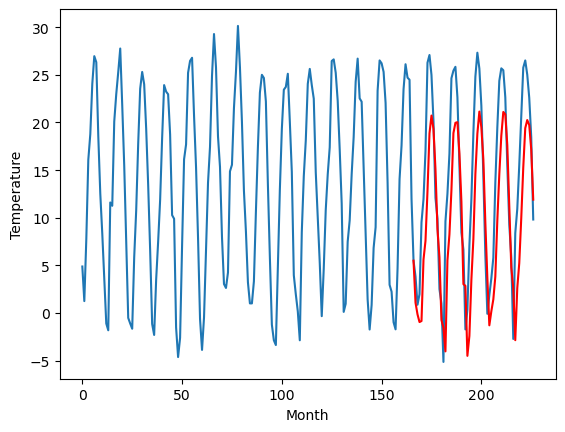

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.37		-0.58		-0.95
0.19		-1.81		-2.00
-1.27		-2.62		-1.35
0.28		-2.51		-2.79
4.35		3.93		-0.42
6.03		5.90		-0.13
7.43		11.13		3.70
9.19		17.18		7.99
9.51		19.05		9.54
9.36		17.65		8.29
8.78		13.43		4.65
7.28		7.13		-0.15
3.89		4.18		0.29
-3.86		-2.41		1.45
-3.16		-3.21		-0.05
0.27		-5.70		-5.97
1.87		3.86		1.99
3.31		6.59		3.28
7.35		11.23		3.88
8.98		17.21		8.23
9.35		18.29		8.94
9.63		18.36		8.73
8.34		15.09		6.75
6.50		10.01		3.51
-0.66		1.35		2.01
1.14		1.19		0.05
-3.62		-6.16		-2.54
-0.19		-4.08		-3.89
2.63		1.82		-0.81
4.97		6.09		1.12
7.79		12.89		5.10
9.51		17.14		7.63
9.88		19.47		9.59
9.83		17.81		7.98
8.39		14.44		6.05
4.56		7.79		3.23
3.10		2.03		-1.07
-1.75		-2.96		-1.21
-1.90		-1.49		0.41
1.40		-0.24		-1.64
3.12		2.15		-0.97
5.84		8.04		2.20
6.62		12.90		6.28
8.83		16.93		8.10
10.44		19.42		8.98
10.95		19.17		8.22
8.85		15.94		7.09
5.20		9.52		4.32
1.49		3.10		1.61
-0.63		0.94		

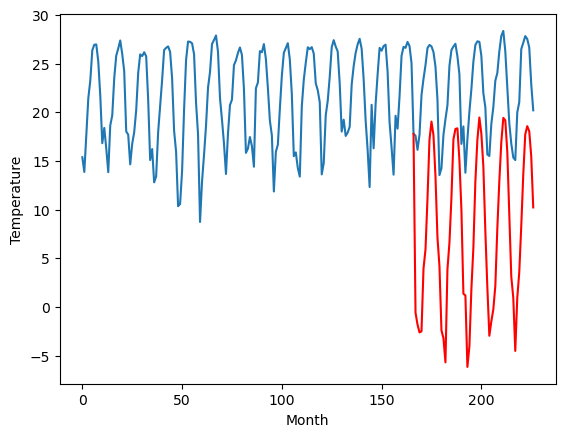

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.37		-3.96		0.41
-4.31		-5.19		-0.88
-4.50		-6.00		-1.50
-4.24		-5.89		-1.65
3.56		0.55		-3.01
2.61		2.52		-0.09
6.49		7.75		1.26
10.58		13.80		3.22
12.15		15.67		3.52
11.32		14.27		2.95
9.22		10.05		0.83
3.88		3.75		-0.13
-0.12		0.80		0.92
-6.37		-5.79		0.58
-6.34		-6.59		-0.25
-8.26		-9.08		-0.82
1.07		0.48		-0.59
2.14		3.21		1.07
6.61		7.85		1.24
10.87		13.83		2.96
11.53		14.91		3.38
12.18		14.98		2.80
9.06		11.71		2.65
5.67		6.63		0.96
-3.00		-2.03		0.97
0.51		-2.19		-2.70
-7.77		-9.54		-1.77
-5.41		-7.46		-2.05
-0.67		-1.56		-0.89
3.54		2.71		-0.83
9.34		9.51		0.17
12.63		13.76		1.13
12.83		16.09		3.26
11.29		14.43		3.14
9.22		11.06		1.84
3.09		4.41		1.32
-1.50		-1.35		0.15
-3.93		-6.34		-2.41
-3.52		-4.87		-1.35
-1.58		-3.62		-2.04
0.57		-1.23		-1.80
2.32		4.66		2.34
7.18		9.52		2.34
10.77		13.55		2.78
12.55		16.04		3.49
14.63		15.79		1.16
10.88		12.56		1.68
4.77		6.14		1.37
-2.19		-0

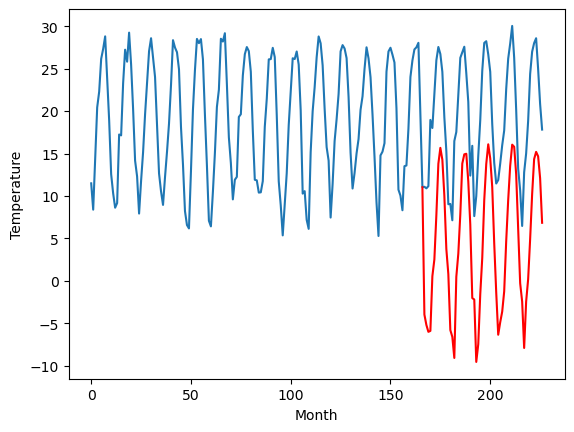

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.64		-4.60		-0.96
-5.29		-5.83		-0.54
-5.05		-6.64		-1.59
-5.38		-6.53		-1.15
2.08		-0.09		-2.17
2.74		1.88		-0.86
7.87		7.11		-0.76
12.83		13.16		0.33
14.69		15.03		0.34
14.44		13.63		-0.81
8.66		9.41		0.75
2.93		3.12		0.19
0.32		0.16		-0.16
-5.96		-6.43		-0.47
-6.88		-7.23		-0.35
-10.34		-9.72		0.62
0.62		-0.16		-0.78
2.31		2.57		0.26
6.47		7.21		0.74
12.15		13.19		1.04
13.74		14.27		0.53
14.11		14.34		0.23
11.32		11.07		-0.25
6.67		5.99		-0.68
-1.33		-2.67		-1.34
0.67		-2.83		-3.50
-7.80		-10.18		-2.38
-7.54		-8.10		-0.56
-1.36		-2.20		-0.84
4.69		2.07		-2.62
9.40		8.87		-0.53
13.95		13.12		-0.83
17.25		15.45		-1.80
14.52		13.79		-0.73
11.09		10.42		-0.67
4.22		3.77		-0.45
-2.83		-1.99		0.84
-5.52		-6.98		-1.46
-4.53		-5.51		-0.98
-4.47		-4.26		0.21
0.06		-1.87		-1.93
2.66		4.02		1.36
8.34		8.88		0.54
12.53		12.91		0.38
15.08		15.40		0.32
17.63		15.15		-2.48
12.93		11.92		-1.01
4.80		5.5

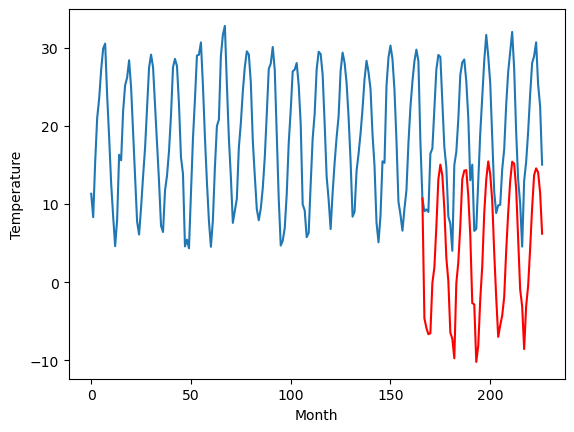

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.77		-3.33		-0.56
-4.55		-4.56		-0.01
-3.93		-5.37		-1.44
-4.31		-5.26		-0.95
3.57		1.18		-2.39
4.26		3.15		-1.11
9.91		8.38		-1.53
14.62		14.43		-0.19
17.06		16.30		-0.76
16.38		14.90		-1.48
10.08		10.68		0.60
4.33		4.39		0.06
1.57		1.43		-0.14
-5.00		-5.16		-0.16
-5.60		-5.96		-0.36
-9.49		-8.45		1.04
1.43		1.11		-0.32
3.61		3.84		0.23
7.14		8.48		1.34
13.99		14.46		0.47
15.48		15.54		0.06
15.85		15.61		-0.24
12.42		12.34		-0.08
7.55		7.26		-0.29
-0.29		-1.40		-1.11
1.45		-1.56		-3.01
-7.45		-8.91		-1.46
-6.83		-6.83		0.00
0.09		-0.93		-1.02
6.78		3.34		-3.44
11.61		10.14		-1.47
16.28		14.39		-1.89
19.70		16.72		-2.98
16.86		15.06		-1.80
12.77		11.69		-1.08
5.62		5.04		-0.58
-1.47		-0.72		0.75
-4.44		-5.71		-1.27
-3.67		-4.24		-0.57
-3.44		-2.99		0.45
1.41		-0.60		-2.01
4.06		5.29		1.23
10.22		10.15		-0.07
15.33		14.18		-1.15
18.41		16.67		-1.74
20.28		16.42		-3.86
15.19		13.19		-2.00
6.3

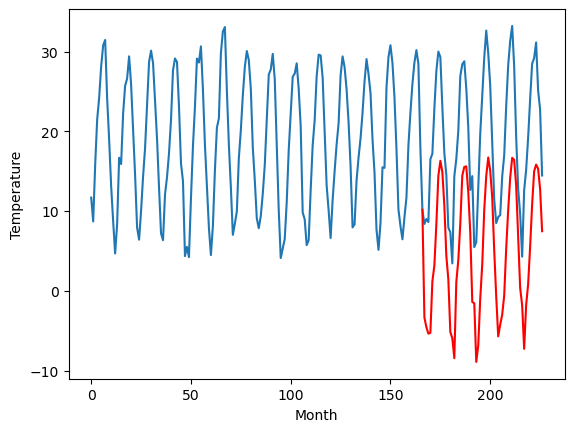

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.81		7.16		-1.65
7.17		5.93		-1.24
6.44		5.12		-1.32
5.68		5.23		-0.45
13.24		11.67		-1.57
16.21		13.64		-2.57
22.78		18.87		-3.91
26.11		24.92		-1.19
28.94		26.79		-2.15
28.32		25.39		-2.93
20.59		21.17		0.58
16.63		14.88		-1.75
12.75		11.92		-0.83
5.77		5.33		-0.44
4.67		4.53		-0.14
3.10		2.04		-1.06
12.35		11.60		-0.75
14.58		14.33		-0.25
20.07		18.97		-1.10
25.03		24.95		-0.08
24.77		26.03		1.26
25.09		26.10		1.01
24.40		22.83		-1.57
18.70		17.75		-0.95
11.76		9.09		-2.67
12.17		8.93		-3.24
4.80		1.58		-3.22
4.60		3.66		-0.94
11.92		9.56		-2.36
19.43		13.83		-5.60
25.12		20.63		-4.49
27.49		24.88		-2.61
29.39		27.21		-2.18
26.09		25.55		-0.54
23.19		22.18		-1.01
16.38		15.53		-0.85
8.53		9.77		1.24
6.93		4.78		-2.15
7.30		6.25		-1.05
7.47		7.50		0.03
12.54		9.89		-2.65
16.76		15.78		-0.98
21.68		20.64		-1.04
28.16		24.67		-3.49
29.62		27.16		-2.46
29.71		26.91		-2.80
26.23		23.68		-2.55


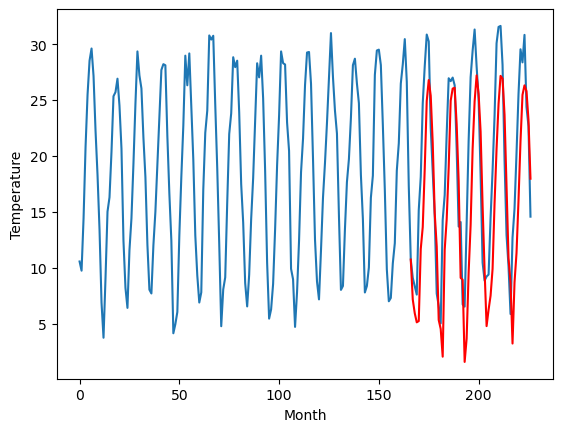

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.79		3.27		1.48
1.44		2.04		0.60
1.27		1.23		-0.04
1.74		1.34		-0.40
7.35		7.78		0.43
8.62		9.75		1.13
11.41		14.98		3.57
16.00		21.03		5.03
19.04		22.90		3.86
17.84		21.50		3.66
14.04		17.28		3.24
10.22		10.98		0.76
5.91		8.03		2.12
-1.34		1.44		2.78
-1.11		0.64		1.75
-0.44		-1.85		-1.41
5.96		7.71		1.75
8.69		10.44		1.75
12.14		15.08		2.94
16.16		21.06		4.90
17.90		22.14		4.24
18.03		22.21		4.18
14.06		18.94		4.88
10.26		13.86		3.60
2.10		5.20		3.10
4.01		5.04		1.03
-2.05		-2.31		-0.26
2.23		-0.23		-2.46
5.79		5.67		-0.12
8.45		9.94		1.49
14.43		16.74		2.31
17.64		20.99		3.35
18.91		23.32		4.41
17.39		21.66		4.27
14.30		18.29		3.99
7.43		11.64		4.21
4.73		5.88		1.15
-1.22		0.89		2.11
1.80		2.36		0.56
5.22		3.61		-1.61
5.70		6.00		0.30
8.81		11.89		3.08
11.43		16.75		5.32
15.07		20.78		5.71
18.94		23.27		4.33
18.38		23.02		4.64
14.54		19.79		5.25
9.10		13.37		4.27
3.37		6.95		3.58
1.16		4.7

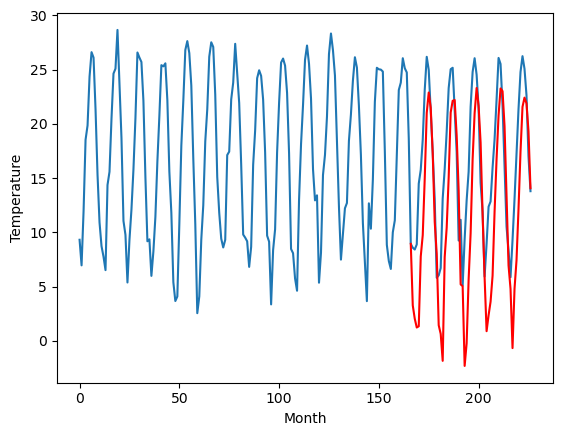

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.00		3.09		-0.91
3.19		1.86		-1.33
1.54		1.05		-0.49
2.11		1.16		-0.95
9.04		7.60		-1.44
10.62		9.57		-1.05
14.72		14.80		0.08
21.07		20.85		-0.22
23.61		22.72		-0.89
21.62		21.32		-0.30
18.04		17.10		-0.94
11.11		10.81		-0.30
8.56		7.85		-0.71
2.03		1.26		-0.77
0.36		0.46		0.10
-3.25		-2.03		1.22
9.02		7.53		-1.49
10.92		10.26		-0.66
14.96		14.90		-0.06
21.26		20.88		-0.38
22.55		21.96		-0.59
23.07		22.03		-1.04
20.03		18.76		-1.27
14.26		13.68		-0.58
6.32		5.02		-1.30
7.78		4.86		-2.92
-1.29		-2.49		-1.20
0.77		-0.41		-1.18
7.43		5.49		-1.94
11.29		9.76		-1.53
16.96		16.56		-0.40
22.28		20.81		-1.47
25.98		23.14		-2.84
22.46		21.48		-0.98
18.87		18.11		-0.76
12.50		11.46		-1.04
5.95		5.70		-0.25
1.10		0.71		-0.39
2.75		2.18		-0.57
4.89		3.43		-1.46
6.61		5.82		-0.79
12.23		11.71		-0.52
17.01		16.57		-0.44
21.09		20.60		-0.49
23.05		23.09		0.04
22.86		22.84		-0.02
18.92		19.61		0.69
13.02		

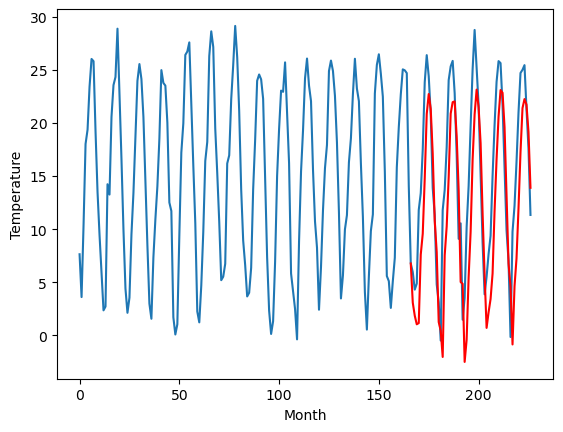

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.41		3.47		2.06
0.59		2.24		1.65
-0.34		1.43		1.77
-1.17		1.54		2.71
5.65		7.98		2.33
8.64		9.95		1.31
14.22		15.18		0.96
21.51		21.23		-0.28
23.55		23.10		-0.45
21.35		21.70		0.35
17.59		17.48		-0.11
10.75		11.18		0.43
6.91		8.23		1.32
-0.60		1.64		2.24
-2.18		0.84		3.02
-5.54		-1.65		3.89
6.43		7.91		1.48
10.08		10.64		0.56
14.49		15.28		0.79
21.73		21.26		-0.47
22.30		22.34		0.04
23.16		22.41		-0.75
19.67		19.14		-0.53
14.32		14.06		-0.26
3.46		5.40		1.94
3.78		5.24		1.46
-5.06		-2.11		2.95
-2.04		-0.03		2.01
5.43		5.87		0.44
9.21		10.14		0.93
17.71		16.94		-0.77
22.19		21.19		-1.00
24.13		23.52		-0.61
21.90		21.86		-0.04
17.99		18.49		0.50
10.50		11.84		1.34
4.71		6.08		1.37
-1.07		1.09		2.16
0.89		2.56		1.67
2.48		3.81		1.33
3.75		6.20		2.45
10.25		12.09		1.84
15.96		16.95		0.99
19.84		20.98		1.14
22.57		23.47		0.90
21.41		23.22		1.81
18.32		19.99		1.67
12.18		13.57		1.39
5.11		7.15		2.

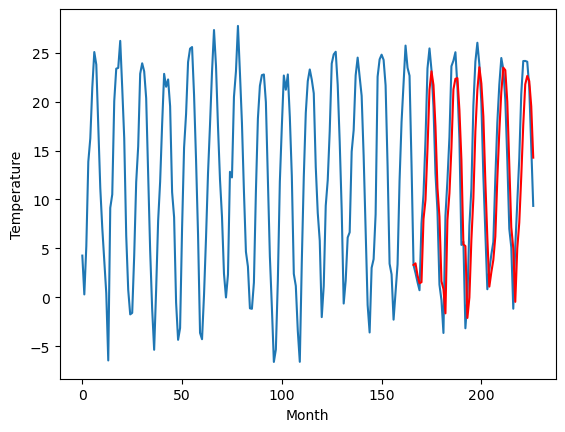

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.42		2.34		0.92
1.10		1.11		0.01
-1.34		0.30		1.64
-1.59		0.41		2.00
6.01		6.85		0.84
9.12		8.82		-0.30
15.00		14.05		-0.95
22.73		20.10		-2.63
23.94		21.97		-1.97
21.34		20.57		-0.77
17.44		16.35		-1.09
10.10		10.06		-0.04
7.46		7.10		-0.36
-0.42		0.51		0.93
-2.45		-0.29		2.16
-6.89		-2.77		4.12
6.97		6.78		-0.19
10.68		9.51		-1.17
15.46		14.15		-1.31
22.85		20.13		-2.72
22.56		21.21		-1.35
22.84		21.28		-1.56
19.73		18.01		-1.72
14.27		12.93		-1.34
3.96		4.27		0.31
3.71		4.11		0.40
-5.77		-3.24		2.53
-2.94		-1.16		1.78
5.27		4.74		-0.53
9.39		9.01		-0.38
17.92		15.81		-2.11
22.53		20.06		-2.47
23.35		22.39		-0.96
22.05		20.73		-1.32
17.91		17.36		-0.55
10.44		10.71		0.27
4.90		4.95		0.05
-1.83		-0.04		1.79
0.41		1.43		1.02
1.60		2.68		1.08
4.14		5.07		0.93
11.47		10.96		-0.51
17.23		15.82		-1.41
21.54		19.85		-1.69
23.07		22.34		-0.73
21.81		22.09		0.28
18.77		18.86		0.09
12.36		12.44		0.

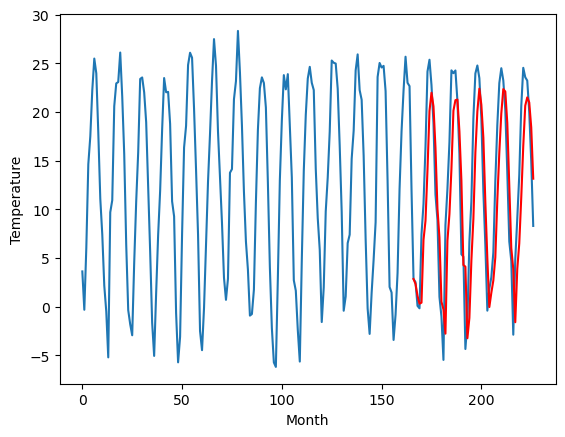

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.09		1.10		2.19
-1.87		-0.13		1.74
-3.07		-0.94		2.13
-3.88		-0.83		3.05
2.28		5.61		3.33
3.66		7.58		3.92
10.40		12.81		2.41
16.89		18.86		1.97
20.33		20.73		0.40
17.92		19.33		1.41
13.93		15.11		1.18
7.77		8.81		1.04
4.54		5.86		1.32
-3.02		-0.73		2.29
-4.94		-1.53		3.41
-7.18		-4.02		3.16
2.71		5.54		2.83
6.51		8.27		1.76
11.04		12.91		1.87
17.93		18.89		0.96
18.09		19.97		1.88
19.29		20.04		0.75
15.00		16.77		1.77
11.47		11.69		0.22
1.07		3.03		1.96
0.21		2.87		2.66
-8.62		-4.48		4.14
-5.06		-2.40		2.66
0.91		3.50		2.59
4.91		7.77		2.86
13.49		14.57		1.08
16.76		18.82		2.06
19.36		21.15		1.79
18.29		19.49		1.20
14.24		16.12		1.88
7.38		9.47		2.09
3.30		3.71		0.41
-3.41		-1.28		2.13
-1.78		0.19		1.97
-1.64		1.44		3.08
-0.76		3.83		4.59
7.71		9.72		2.01
11.40		14.58		3.18
15.71		18.61		2.90
18.80		21.10		2.30
17.47		20.85		3.38
15.13		17.62		2.49
9.87		11.20		1.33
2.48		4.78		2.30
1.82		

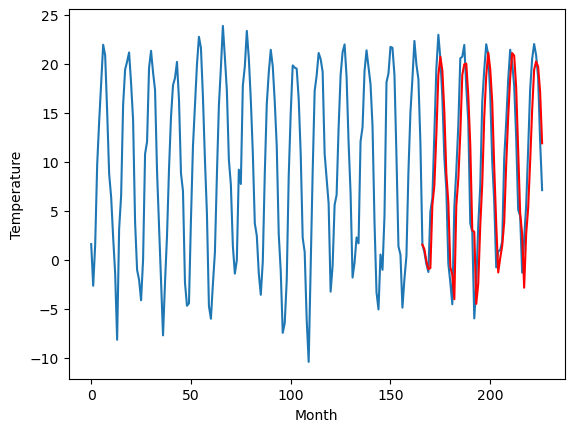

RangeIndex(start=1, stop=12, step=1)
[2.839999999999999, 0.3700000000000001, -4.370000000000001, -3.639999999999999, -2.7700000000000005, 8.81, 1.7899999999999991, 4.0, 1.4099999999999984, 1.42, -1.0899999999999999]
[1.0973485183715823, -0.5826657867431644, -3.9626572036743166, -4.602651481628418, -3.3326495742797855, 7.157345657348634, 3.267340888977051, 3.087344703674317, 3.467344703674316, 2.337354240417481, 1.097340888977051]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.84   1.097349
1                 1    0.37  -0.582666
2                 2   -4.37  -3.962657
3                 3   -3.64  -4.602651
4                 4   -2.77  -3.332650
5                 5    8.81   7.157346
6                 6    1.79   3.267341
7                 7    4.00   3.087345
8                 8    1.41   3.467345
9                 9    1.42   2.337354
10               10   -1.09   1.097341


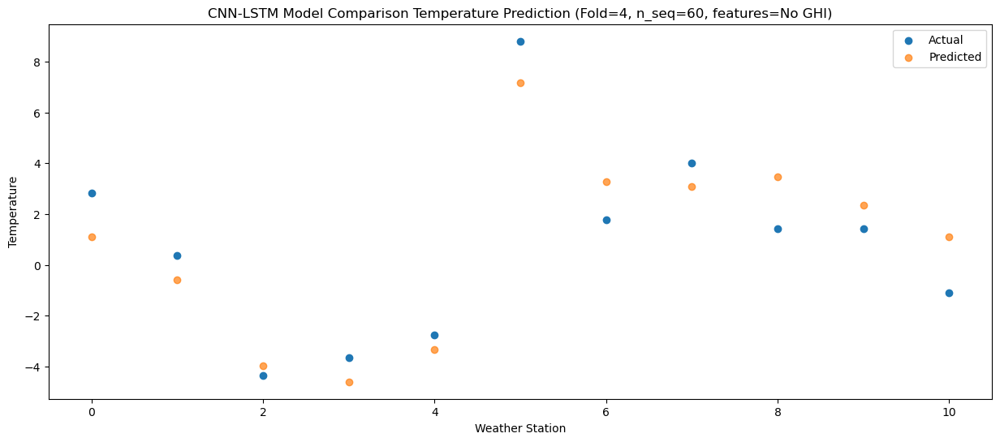

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18  -0.132609
1                 1    0.19  -1.812681
2                 2   -4.31  -5.192647
3                 3   -5.29  -5.832620
4                 4   -4.55  -4.562616
5                 5    7.17   5.927377
6                 6    1.44   2.037338
7                 7    3.19   1.857377
8                 8    0.59   2.237362
9                 9    1.10   1.107390
10               10   -1.87  -0.132658


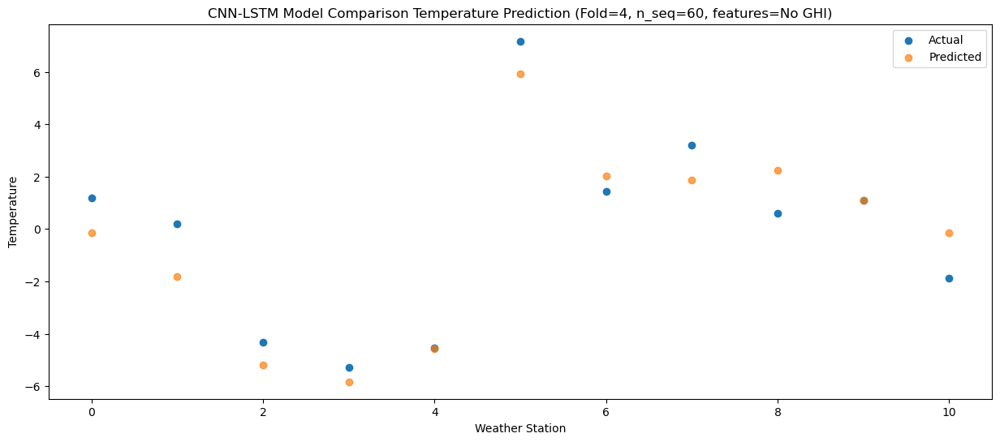

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -0.940814
1                 1   -1.27  -2.620886
2                 2   -4.50  -6.000858
3                 3   -5.05  -6.640827
4                 4   -3.93  -5.370822
5                 5    6.44   5.119168
6                 6    1.27   1.229133
7                 7    1.54   1.049172
8                 8   -0.34   1.429159
9                 9   -1.34   0.299186
10               10   -3.07  -0.940863


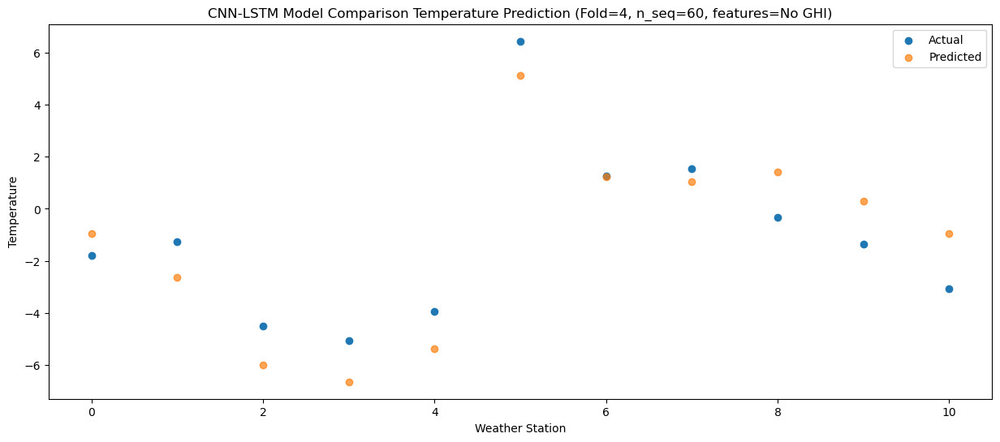

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.67  -0.827097
1                 1    0.28  -2.507236
2                 2   -4.24  -5.887187
3                 3   -5.38  -6.527120
4                 4   -4.31  -5.257111
5                 5    5.68   5.232873
6                 6    1.74   1.342789
7                 7    2.11   1.162875
8                 8   -1.17   1.542842
9                 9   -1.59   0.412898
10               10   -3.88  -0.827201


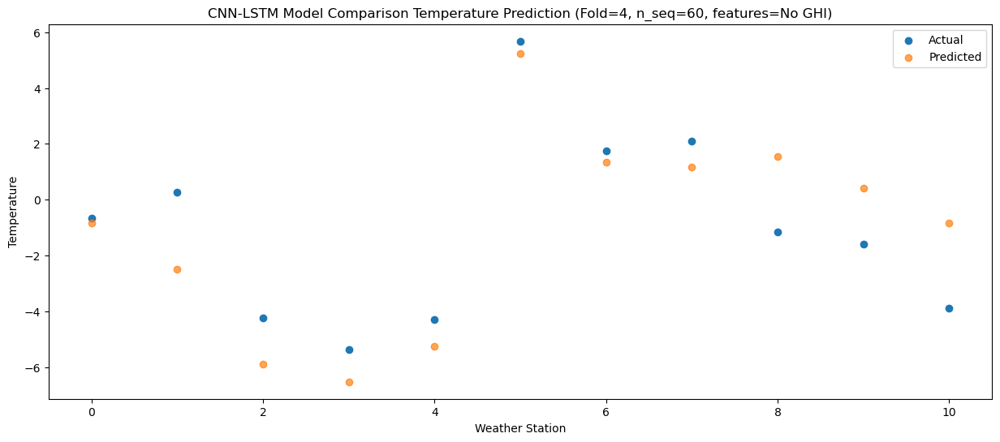

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.86   5.614073
1                 1    4.35   3.933957
2                 2    3.56   0.553996
3                 3    2.08  -0.085950
4                 4    3.57   1.184067
5                 5   13.24  11.674047
6                 6    7.35   7.783979
7                 7    9.04   7.604049
8                 8    5.65   7.984028
9                 9    6.01   6.854072
10               10    2.28   5.613985


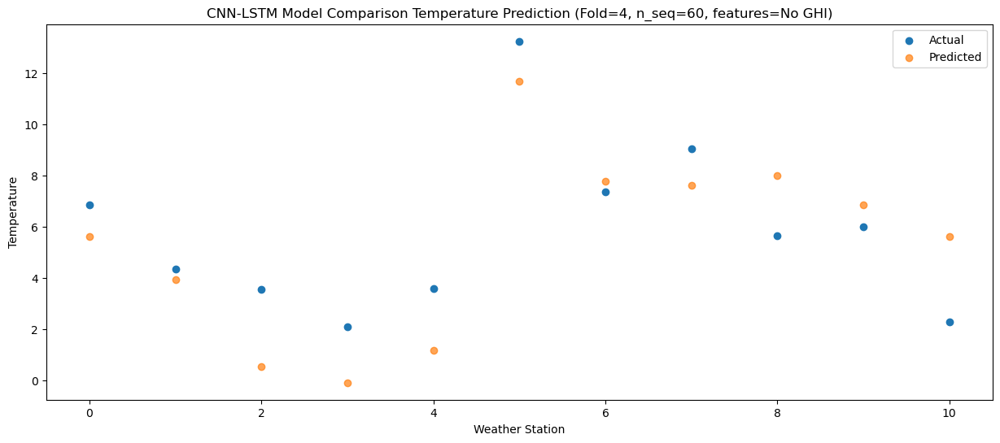

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    9.29   7.579276
1                 1    6.03   5.899146
2                 2    2.61   2.519189
3                 3    2.74   1.879253
4                 4    4.26   3.149266
5                 5   16.21  13.639262
6                 6    8.62   9.749164
7                 7   10.62   9.569252
8                 8    8.64   9.949217
9                 9    9.12   8.819269
10               10    3.66   7.579176


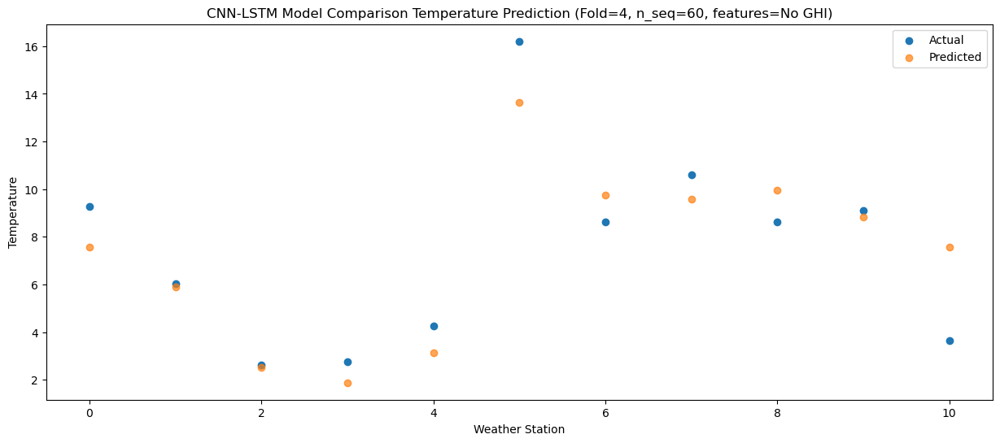

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   14.36  12.805598
1                 1    7.43  11.125516
2                 2    6.49   7.745543
3                 3    7.87   7.105580
4                 4    9.91   8.375592
5                 5   22.78  18.865588
6                 6   11.41  14.975538
7                 7   14.72  14.795582
8                 8   14.22  15.175563
9                 9   15.00  14.045600
10               10   10.40  12.805538


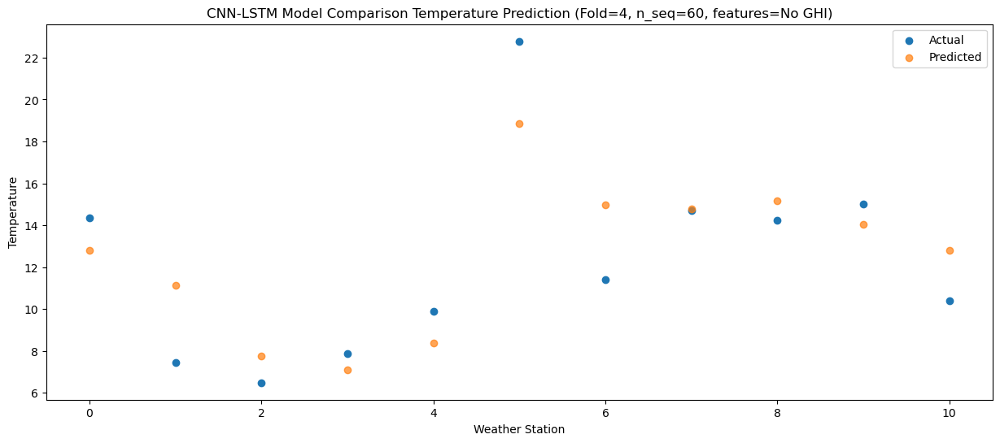

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   23.61  18.855230
1                 1    9.19  17.175071
2                 2   10.58  13.795137
3                 3   12.83  13.155210
4                 4   14.62  14.425222
5                 5   26.11  24.915216
6                 6   16.00  21.025105
7                 7   21.07  20.845204
8                 8   21.51  21.225167
9                 9   22.73  20.095227
10               10   16.89  18.855117


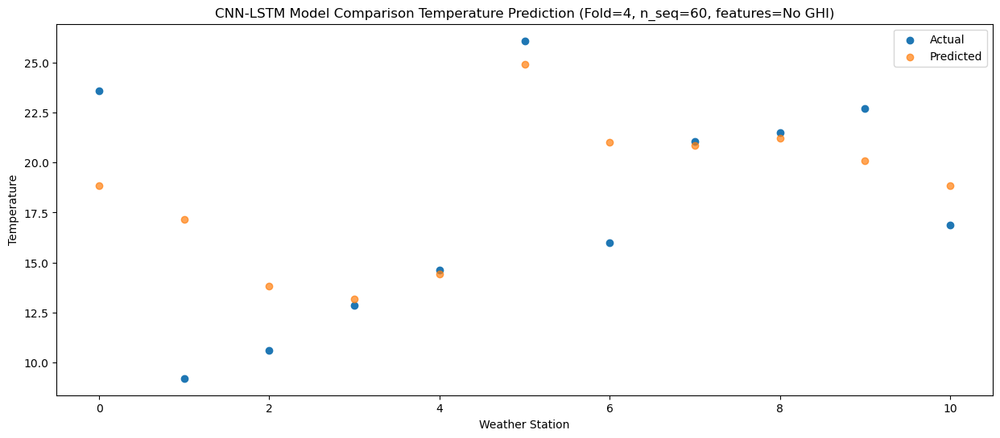

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   24.42  20.727402
1                 1    9.51  19.047224
2                 2   12.15  15.667297
3                 3   14.69  15.027380
4                 4   17.06  16.297390
5                 5   28.94  26.787380
6                 6   19.04  22.897259
7                 7   23.61  22.717374
8                 8   23.55  23.097329
9                 9   23.94  21.967403
10               10   20.33  20.727277


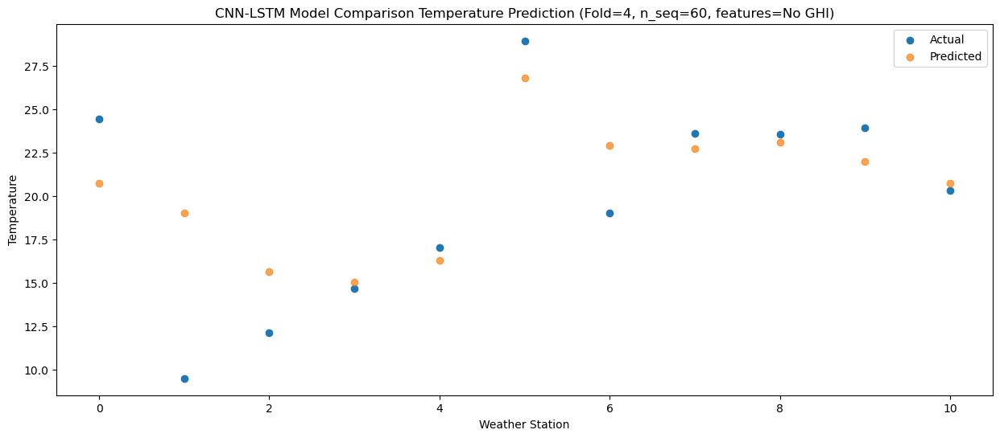

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   22.32  19.331092
1                 1    9.36  17.650849
2                 2   11.32  14.270952
3                 3   14.44  13.631065
4                 4   16.38  14.901079
5                 5   28.32  25.391067
6                 6   17.84  21.500889
7                 7   21.62  21.321053
8                 8   21.35  21.700985
9                 9   21.34  20.571083
10               10   17.92  19.330917


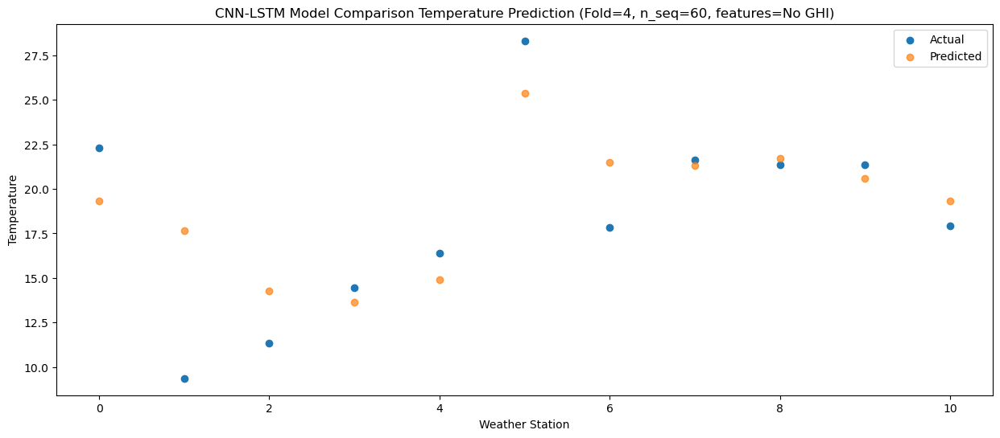

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   17.48  15.110033
1                 1    8.78  13.429788
2                 2    9.22  10.049891
3                 3    8.66   9.410004
4                 4   10.08  10.680016
5                 5   20.59  21.170005
6                 6   14.04  17.279827
7                 7   18.04  17.099992
8                 8   17.59  17.479921
9                 9   17.44  16.350025
10               10   13.93  15.109855


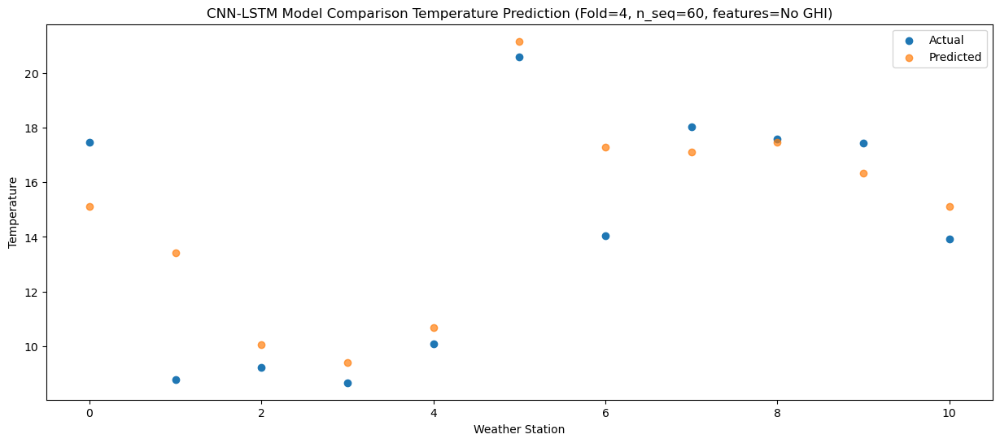

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    9.43   8.815040
1                 1    7.28   7.134873
2                 2    3.88   3.754945
3                 3    2.93   3.115020
4                 4    4.33   4.385028
5                 5   16.63  14.875020
6                 6   10.22  10.984905
7                 7   11.11  10.805014
8                 8   10.75  11.184964
9                 9   10.10  10.055041
10               10    7.77   8.814919


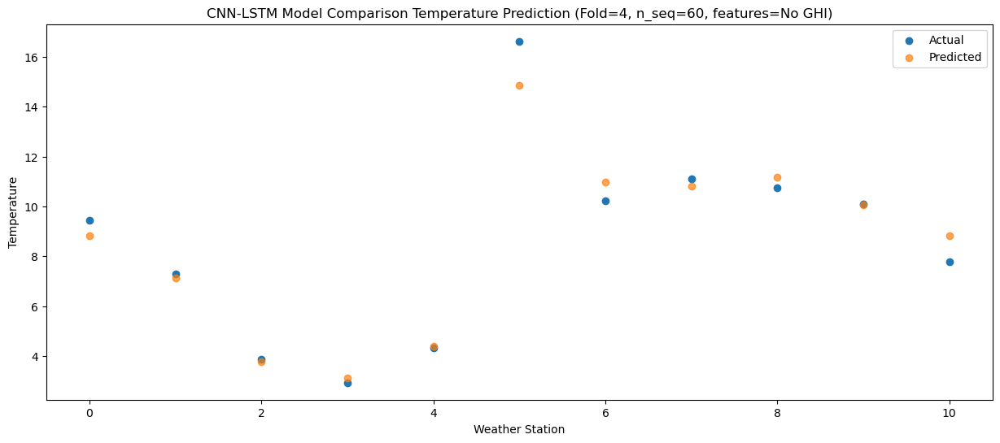

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    7.24   5.859132
1                 1    3.89   4.178992
2                 2   -0.12   0.799057
3                 3    0.32   0.159114
4                 4    1.57   1.429123
5                 5   12.75  11.919108
6                 6    5.91   8.029032
7                 7    8.56   7.849114
8                 8    6.91   8.229078
9                 9    7.46   7.099143
10               10    4.54   5.859039


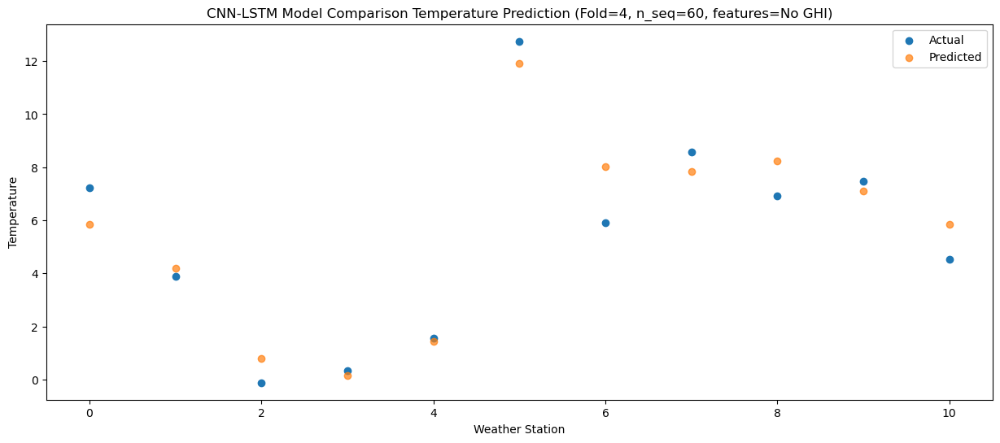

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.14  -0.729281
1                 1   -3.86  -2.409428
2                 2   -6.37  -5.789366
3                 3   -5.96  -6.429306
4                 4   -5.00  -5.159296
5                 5    5.77   5.330694
6                 6   -1.34   1.440604
7                 7    2.03   1.260698
8                 8   -0.60   1.640657
9                 9   -0.42   0.510725
10               10   -3.02  -0.729382


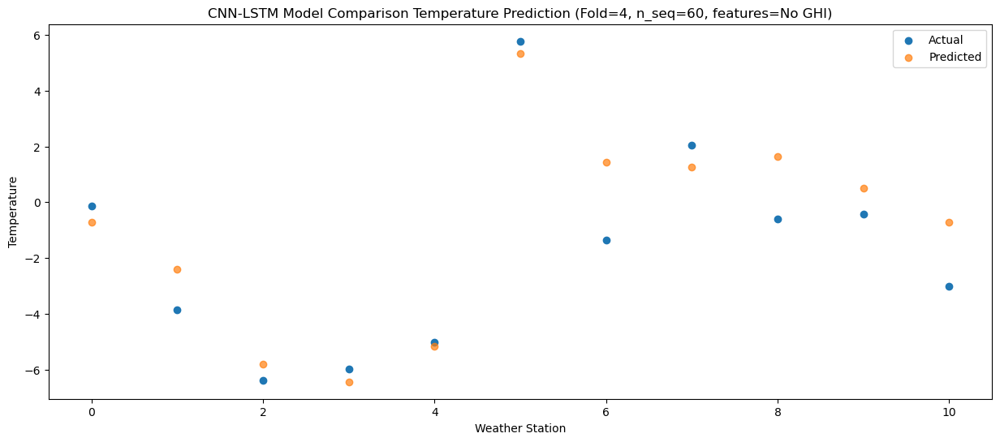

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.65  -1.529746
1                 1   -3.16  -3.209886
2                 2   -6.34  -6.589820
3                 3   -6.88  -7.229771
4                 4   -5.60  -5.959761
5                 5    4.67   4.530228
6                 6   -1.11   0.640146
7                 7    0.36   0.460236
8                 8   -2.18   0.840196
9                 9   -2.45  -0.289739
10               10   -4.94  -1.529839


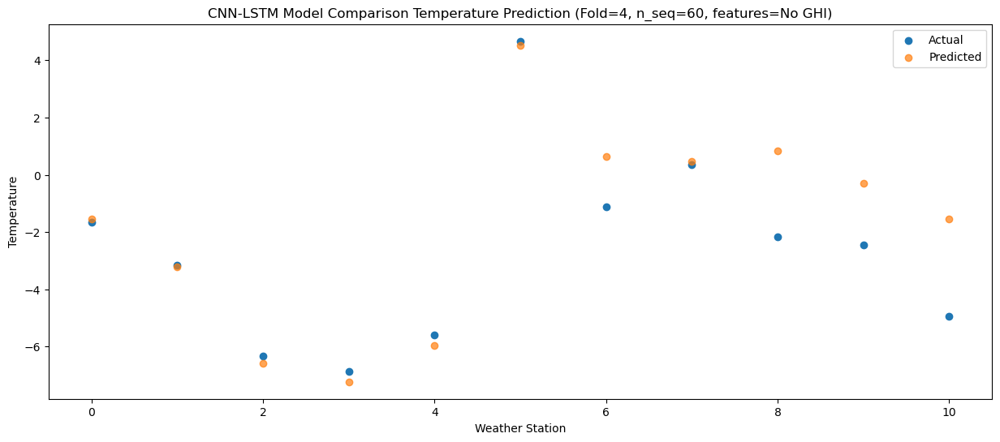

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -7.78  -4.014989
1                 1    0.27  -5.695148
2                 2   -8.26  -9.075074
3                 3  -10.34  -9.715016
4                 4   -9.49  -8.445008
5                 5    3.10   2.044988
6                 6   -0.44  -1.845118
7                 7   -3.25  -2.025013
8                 8   -5.54  -1.645060
9                 9   -6.89  -2.774989
10               10   -7.18  -4.015096


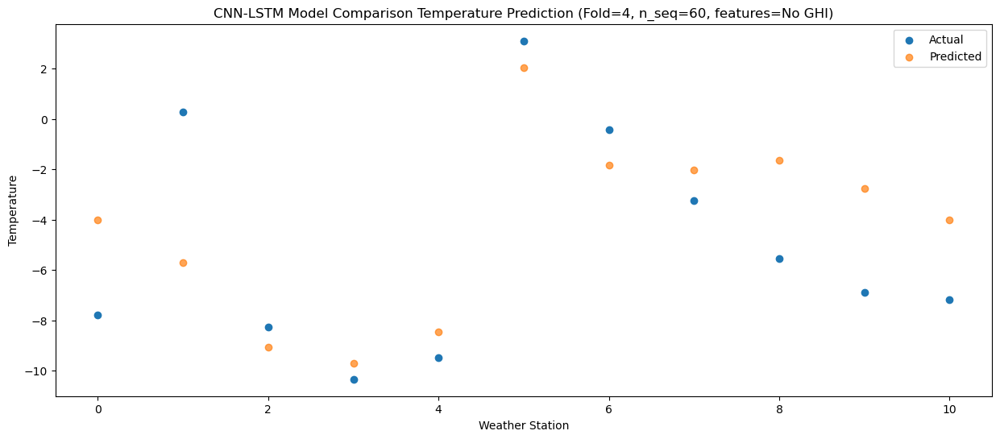

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    6.95   5.542588
1                 1    1.87   3.862437
2                 2    1.07   0.482508
3                 3    0.62  -0.157435
4                 4    1.43   1.112573
5                 5   12.35  11.602569
6                 6    5.96   7.712461
7                 7    9.02   7.532571
8                 8    6.43   7.912519
9                 9    6.97   6.782598
10               10    2.71   5.542493


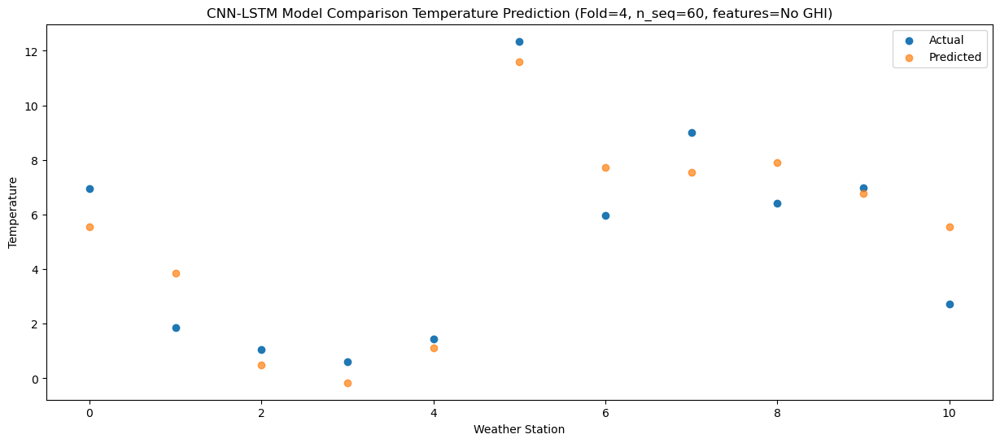

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    9.86   8.267027
1                 1    3.31   6.586807
2                 2    2.14   3.206906
3                 3    2.31   2.566996
4                 4    3.61   3.837010
5                 5   14.58  14.327001
6                 6    8.69  10.436837
7                 7   10.92  10.256995
8                 8   10.08  10.636926
9                 9   10.68   9.507031
10               10    6.51   8.266877


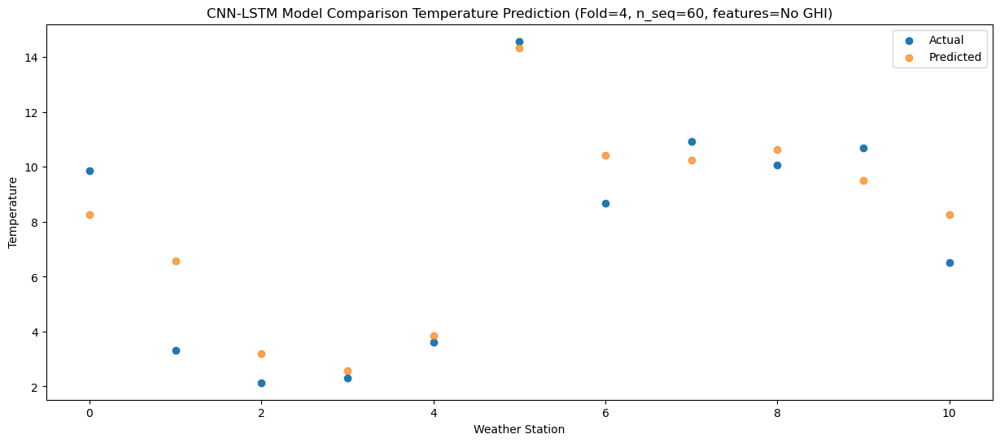

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   14.07  12.905683
1                 1    7.35  11.225502
2                 2    6.61   7.845587
3                 3    6.47   7.205654
4                 4    7.14   8.475662
5                 5   20.07  18.965658
6                 6   12.14  15.075537
7                 7   14.96  14.895658
8                 8   14.49  15.275602
9                 9   15.46  14.145691
10               10   11.04  12.905561


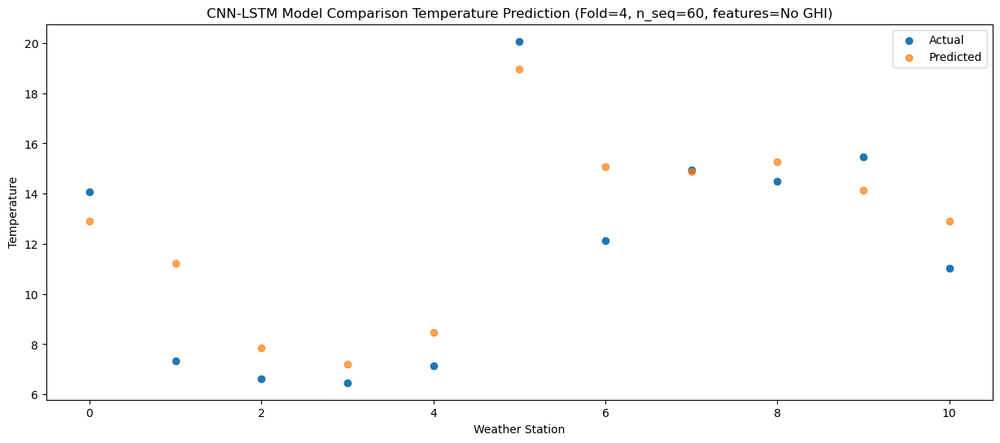

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   21.98  18.885803
1                 1    8.98  17.205616
2                 2   10.87  13.825705
3                 3   12.15  13.185771
4                 4   13.99  14.455780
5                 5   25.03  24.945775
6                 6   16.16  21.055652
7                 7   21.26  20.875774
8                 8   21.73  21.255720
9                 9   22.85  20.125806
10               10   17.93  18.885678


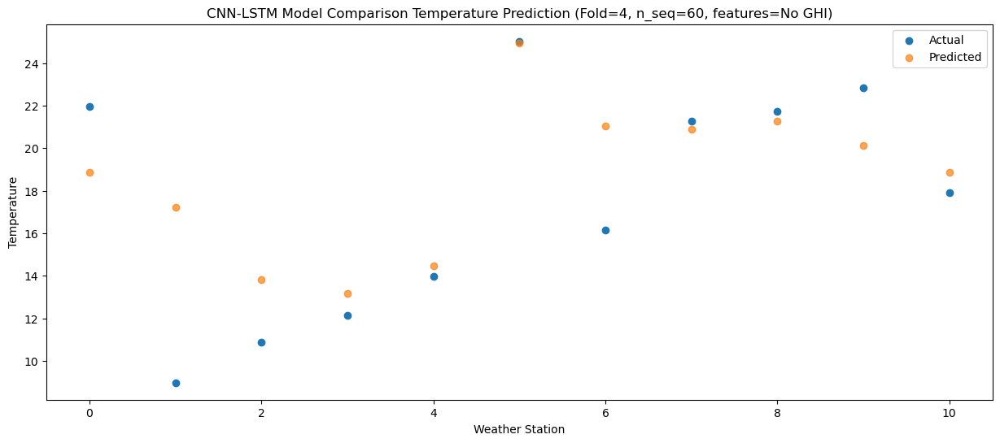

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   22.78  19.965432
1                 1    9.35  18.285288
2                 2   11.53  14.905364
3                 3   13.74  14.265409
4                 4   15.48  15.535416
5                 5   24.77  26.025411
6                 6   17.90  22.135317
7                 7   22.55  21.955415
8                 8   22.30  22.335373
9                 9   22.56  21.205444
10               10   18.09  19.965337


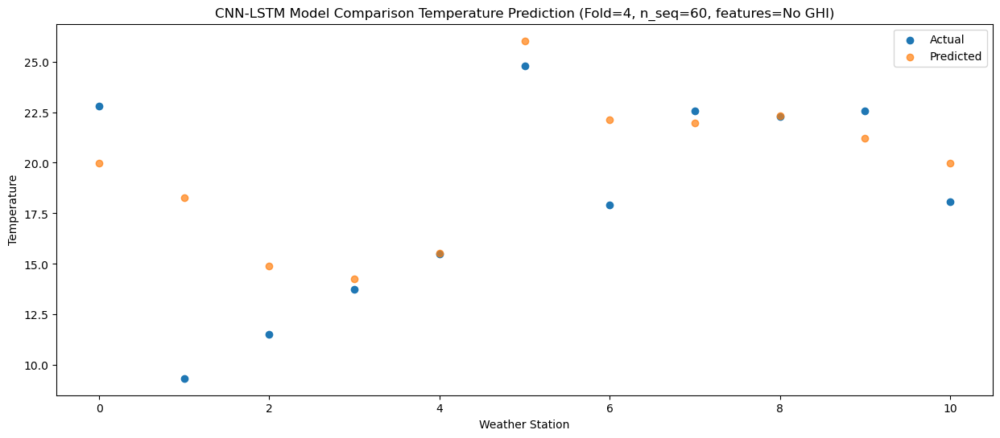

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   23.18  20.035359
1                 1    9.63  18.355225
2                 2   12.18  14.975300
3                 3   14.11  14.335343
4                 4   15.85  15.605346
5                 5   25.09  26.095333
6                 6   18.03  22.205263
7                 7   23.07  22.025351
8                 8   23.16  22.405309
9                 9   22.84  21.275380
10               10   19.29  20.035268


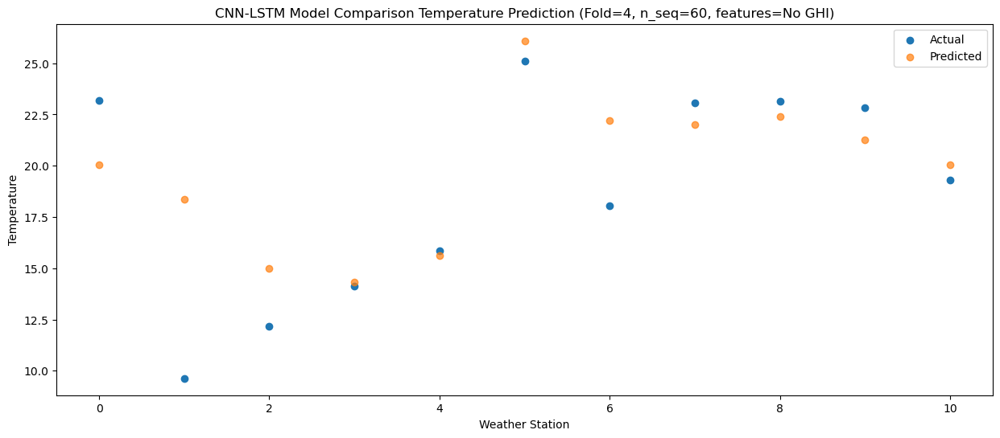

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.99  16.769931
1                 1    8.34  15.089829
2                 2    9.06  11.709895
3                 3   11.32  11.069919
4                 4   12.42  12.339916
5                 5   24.40  22.829894
6                 6   14.06  18.939878
7                 7   20.03  18.759931
8                 8   19.67  19.139908
9                 9   19.73  18.009968
10               10   15.00  16.769875


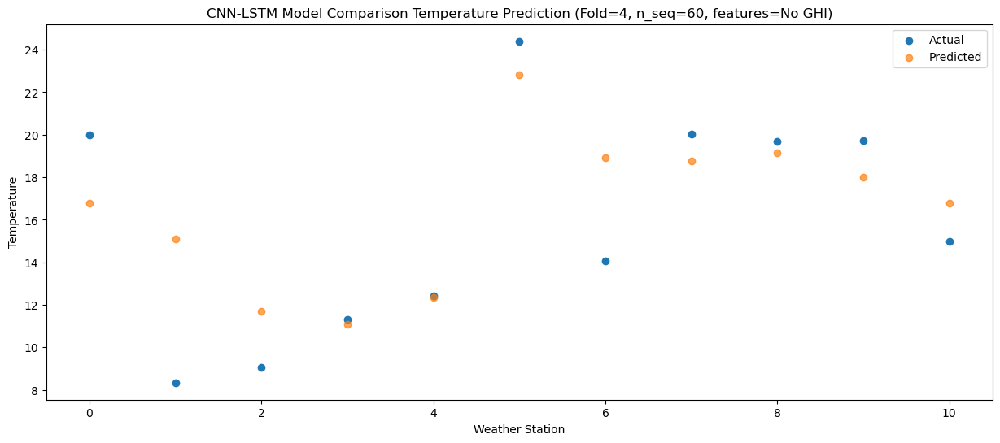

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   12.86  11.687329
1                 1    6.50  10.007167
2                 2    5.67   6.627260
3                 3    6.67   5.987315
4                 4    7.55   7.257310
5                 5   18.70  17.747284
6                 6   10.26  13.857227
7                 7   14.26  13.677321
8                 8   14.32  14.057288
9                 9   14.27  12.927367
10               10   11.47  11.687237


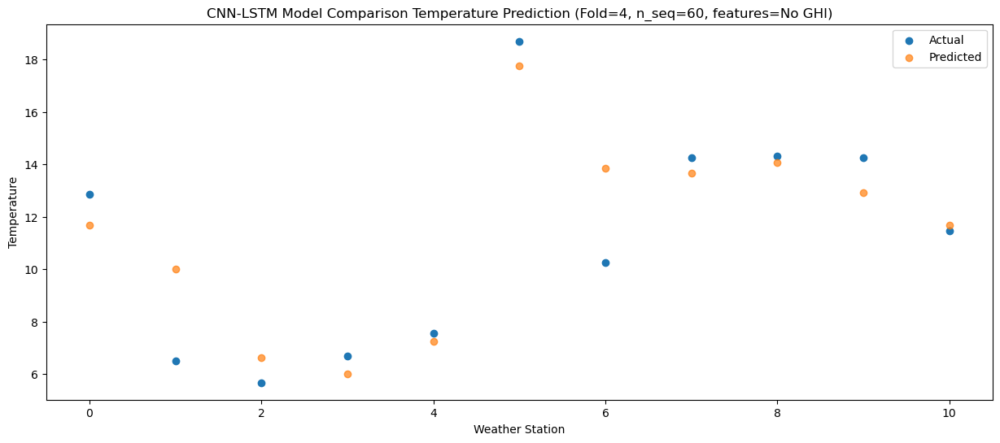

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    5.80   3.033646
1                 1   -0.66   1.353442
2                 2   -3.00  -2.026446
3                 3   -1.33  -2.666372
4                 4   -0.29  -1.396378
5                 5   11.76   9.093585
6                 6    2.10   5.203511
7                 7    6.32   5.023631
8                 8    3.46   5.403590
9                 9    3.96   4.273687
10               10    1.07   3.033527


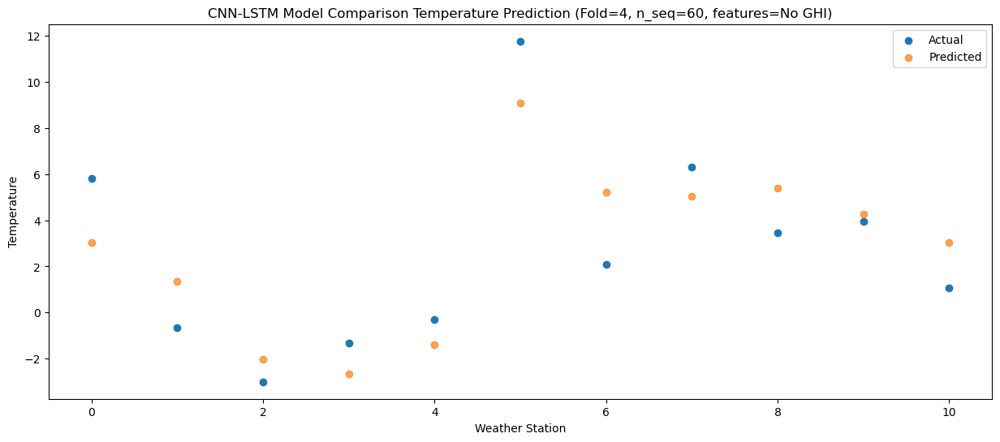

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.01   2.868593
1                 1    1.14   1.188340
2                 2    0.51  -2.191529
3                 3    0.67  -2.831431
4                 4    1.45  -1.561435
5                 5   12.17   8.928530
6                 6    4.01   5.038407
7                 7    7.78   4.858566
8                 8    3.78   5.238509
9                 9    3.71   4.108627
10               10    0.21   2.868437


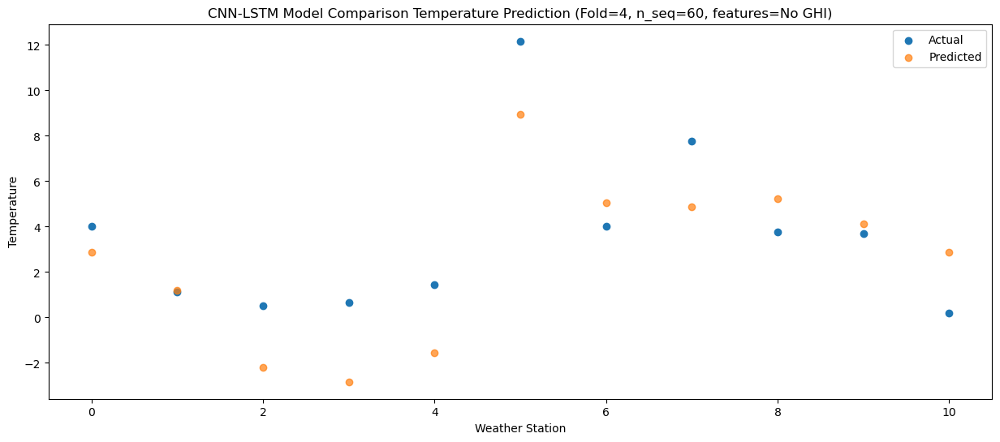

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.37  -4.483129
1                 1   -3.62  -6.163335
2                 2   -7.77  -9.543224
3                 3   -7.80 -10.183151
4                 4   -7.45  -8.913154
5                 5    4.80   1.576814
6                 6   -2.05  -2.313274
7                 7   -1.29  -2.493146
8                 8   -5.06  -2.113191
9                 9   -5.77  -3.243094
10               10   -8.62  -4.483251


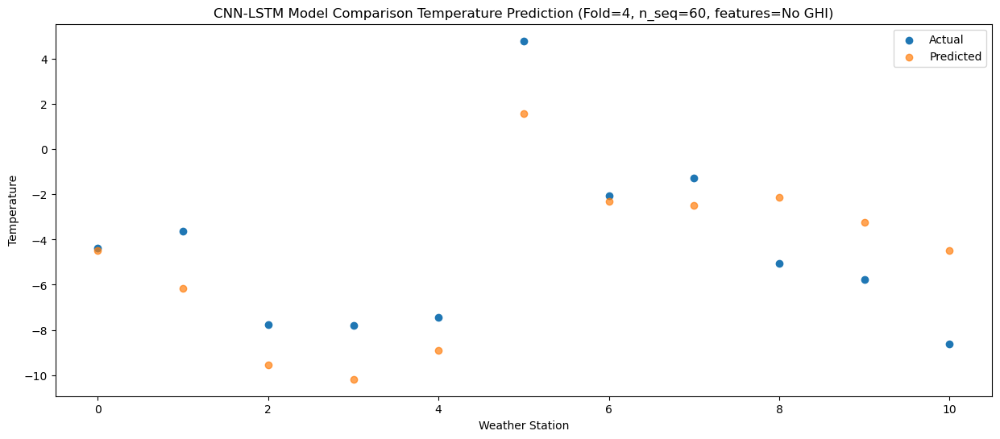

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.30  -2.395911
1                 1   -0.19  -4.076197
2                 2   -5.41  -7.456052
3                 3   -7.54  -8.095938
4                 4   -6.83  -6.825943
5                 5    4.60   3.664021
6                 6    2.23  -0.226127
7                 7    0.77  -0.405943
8                 8   -2.04  -0.026013
9                 9   -2.94  -1.155888
10               10   -5.06  -2.396093


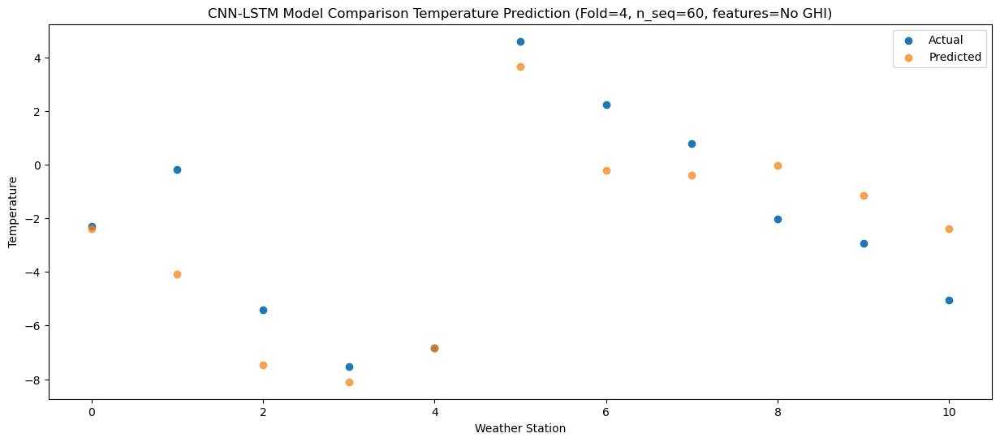

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    4.41   3.498629
1                 1    2.63   1.818372
2                 2   -0.67  -1.561494
3                 3   -1.36  -2.201397
4                 4    0.09  -0.931400
5                 5   11.92   9.558560
6                 6    5.79   5.668431
7                 7    7.43   5.488602
8                 8    5.43   5.868540
9                 9    5.27   4.738654
10               10    0.91   3.498474


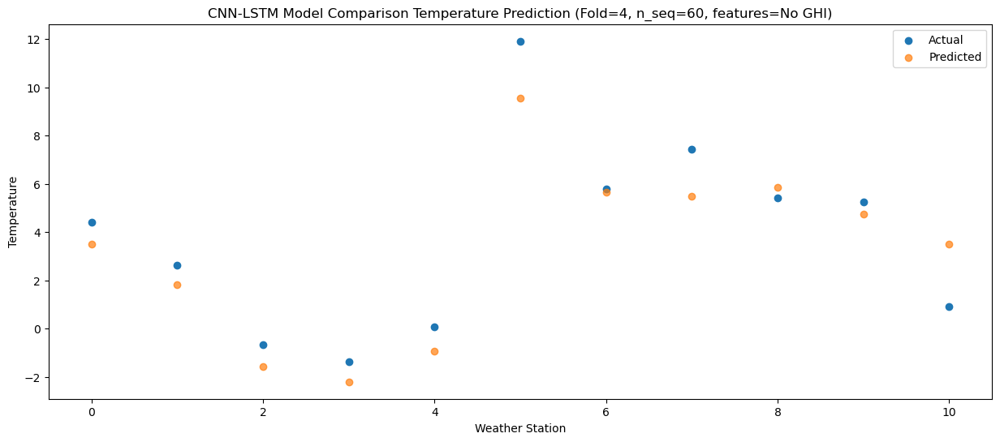

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    9.29   7.767180
1                 1    4.97   6.086989
2                 2    3.54   2.707091
3                 3    4.69   2.067148
4                 4    6.78   3.337145
5                 5   19.43  13.827113
6                 6    8.45   9.937037
7                 7   11.29   9.757159
8                 8    9.21  10.137112
9                 9    9.39   9.007203
10               10    4.91   7.767070


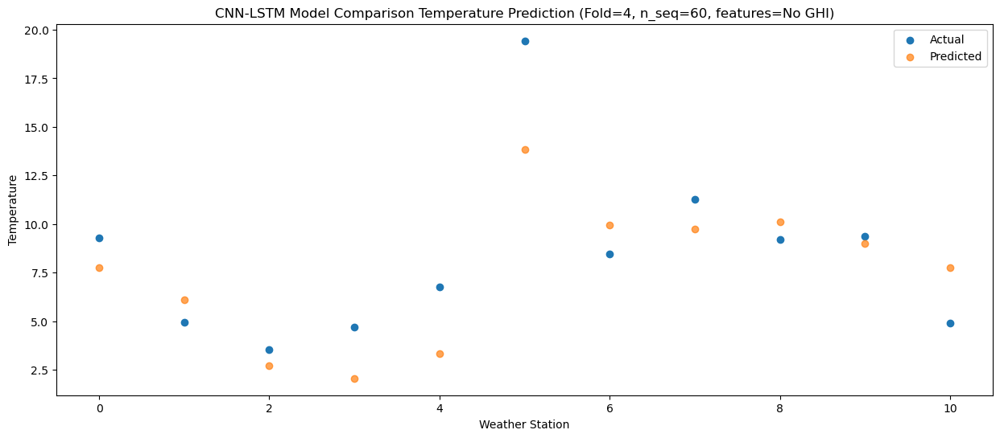

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   16.23  14.574934
1                 1    7.79  12.894780
2                 2    9.34   9.514867
3                 3    9.40   8.874905
4                 4   11.61  10.144896
5                 5   25.12  20.634872
6                 6   14.43  16.744824
7                 7   16.96  16.564922
8                 8   17.71  16.944881
9                 9   17.92  15.814959
10               10   13.49  14.574855


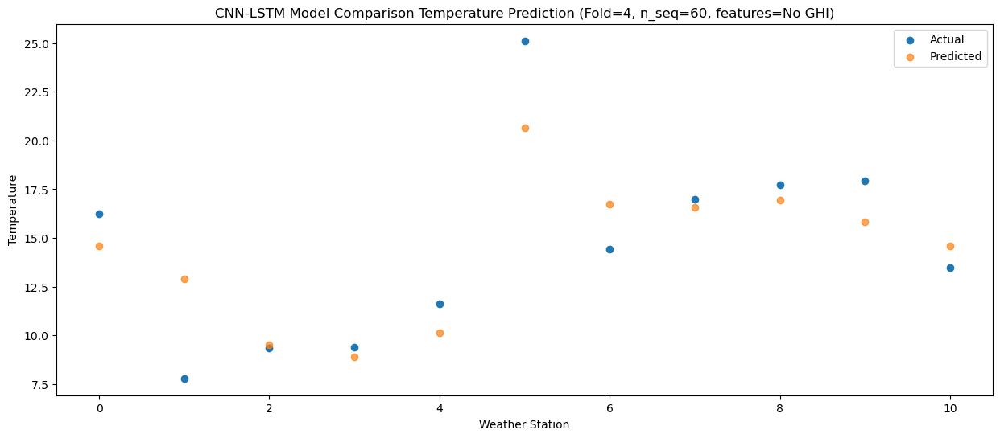

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   22.14  18.821549
1                 1    9.51  17.141404
2                 2   12.63  13.761491
3                 3   13.95  13.121524
4                 4   16.28  14.391515
5                 5   27.49  24.881488
6                 6   17.64  20.991449
7                 7   22.28  20.811541
8                 8   22.19  21.191505
9                 9   22.53  20.061576
10               10   16.76  18.821484


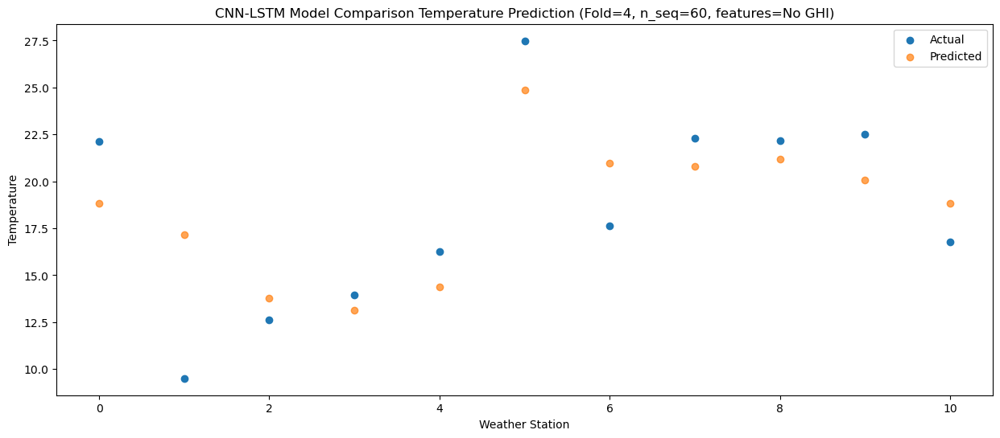

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.66  21.145661
1                 1    9.88  19.465518
2                 2   12.83  16.085605
3                 3   17.25  15.445642
4                 4   19.70  16.715633
5                 5   29.39  27.205605
6                 6   18.91  23.315559
7                 7   25.98  23.135657
8                 8   24.13  23.515619
9                 9   23.35  22.385690
10               10   19.36  21.145592


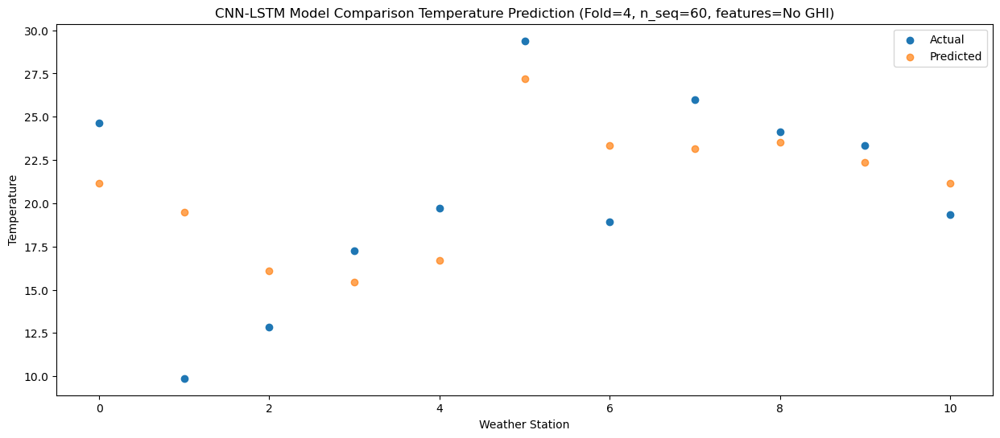

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   23.00  19.489581
1                 1    9.83  17.809484
2                 2   11.29  14.429546
3                 3   14.52  13.789564
4                 4   16.86  15.059552
5                 5   26.09  25.549522
6                 6   17.39  21.659521
7                 7   22.46  21.479585
8                 8   21.90  21.859556
9                 9   22.05  20.729611
10               10   18.29  19.489543


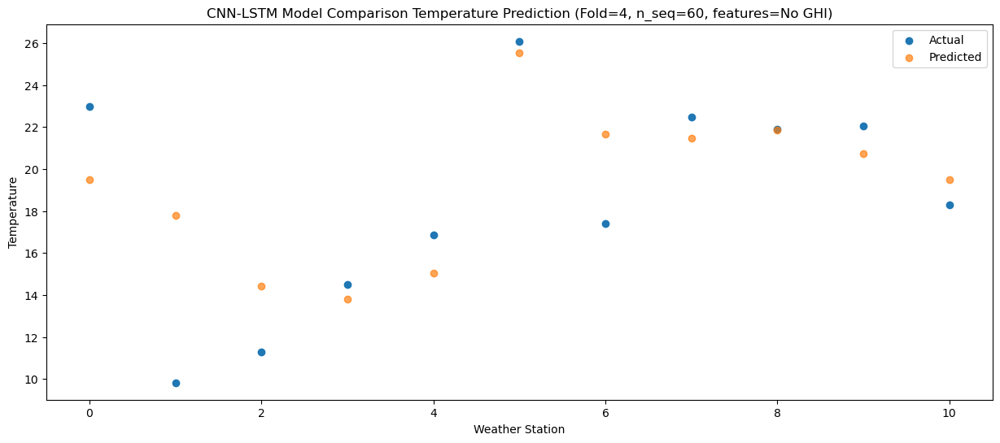

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.09  16.116881
1                 1    8.39  14.436858
2                 2    9.22  11.056891
3                 3   11.09  10.416865
4                 4   12.77  11.686853
5                 5   23.19  22.176823
6                 6   14.30  18.286891
7                 7   18.87  18.106896
8                 8   17.99  18.486892
9                 9   17.91  17.356918
10               10   14.24  16.116905


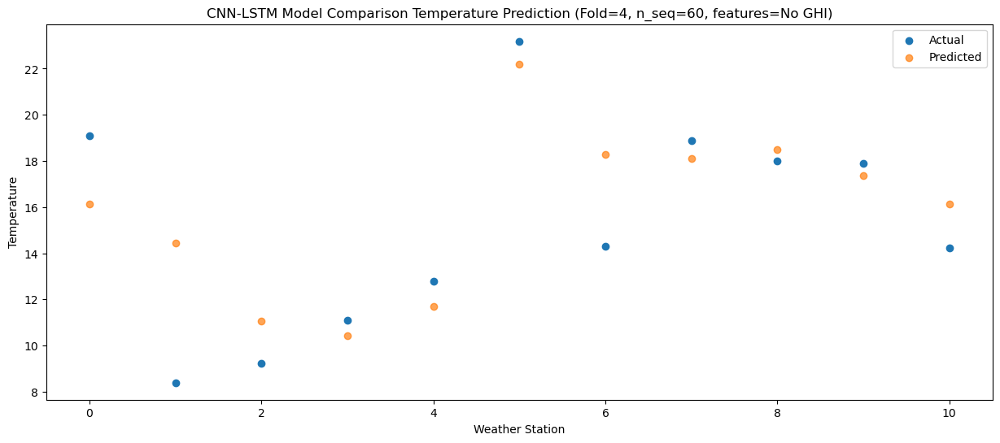

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.74   9.473319
1                 1    4.56   7.793314
2                 2    3.09   4.413341
3                 3    4.22   3.773303
4                 4    5.62   5.043291
5                 5   16.38  15.533261
6                 6    7.43  11.643347
7                 7   12.50  11.463338
8                 8   10.50  11.843342
9                 9   10.44  10.713362
10               10    7.38   9.473360


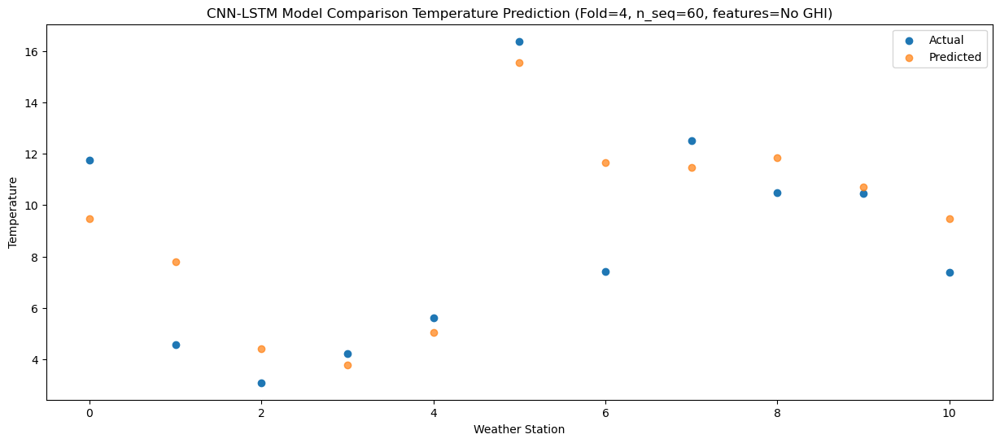

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.41   3.705198
1                 1    3.10   2.025262
2                 2   -1.50  -1.354738
3                 3   -2.83  -1.994815
4                 4   -1.47  -0.724832
5                 5    8.53   9.765135
6                 6    4.73   5.875295
7                 7    5.95   5.695232
8                 8    4.71   6.075263
9                 9    4.90   4.945258
10               10    3.30   3.705303


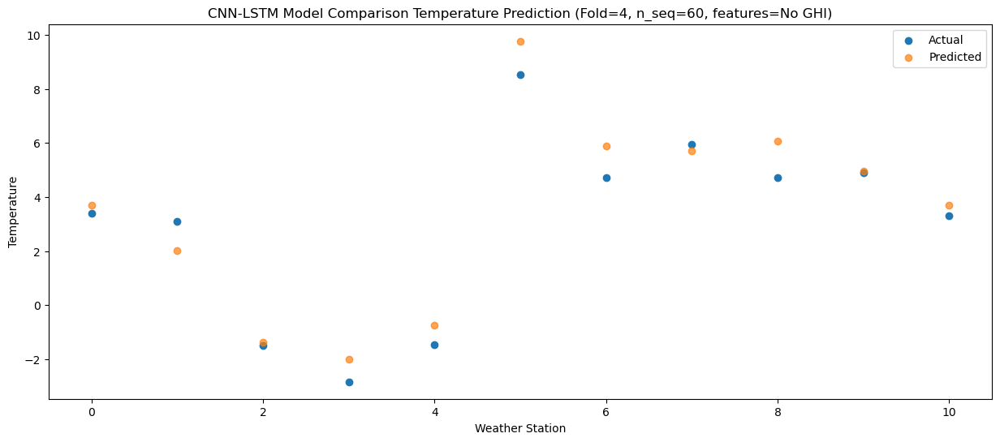

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -2.73  -1.280467
1                 1   -1.75  -2.960432
2                 2   -3.93  -6.340416
3                 3   -5.52  -6.980473
4                 4   -4.44  -5.710493
5                 5    6.93   4.779474
6                 6   -1.22   0.889605
7                 7    1.10   0.709565
8                 8   -1.07   1.089586
9                 9   -1.83  -0.040411
10               10   -3.41  -1.280385


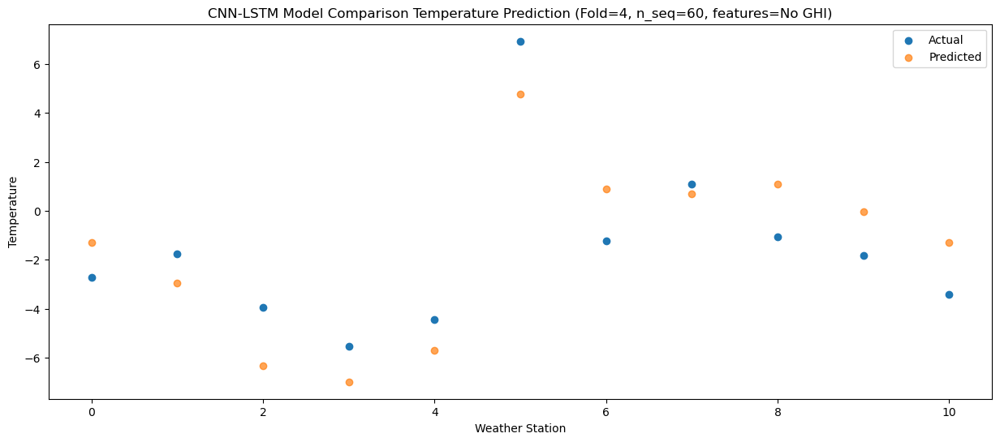

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.77   0.189645
1                 1   -1.90  -1.490339
2                 2   -3.52  -4.870315
3                 3   -4.53  -5.510357
4                 4   -3.67  -4.240377
5                 5    7.30   6.249594
6                 6    1.80   2.359693
7                 7    2.75   2.179674
8                 8    0.89   2.559687
9                 9    0.41   1.429694
10               10   -1.78   0.189703


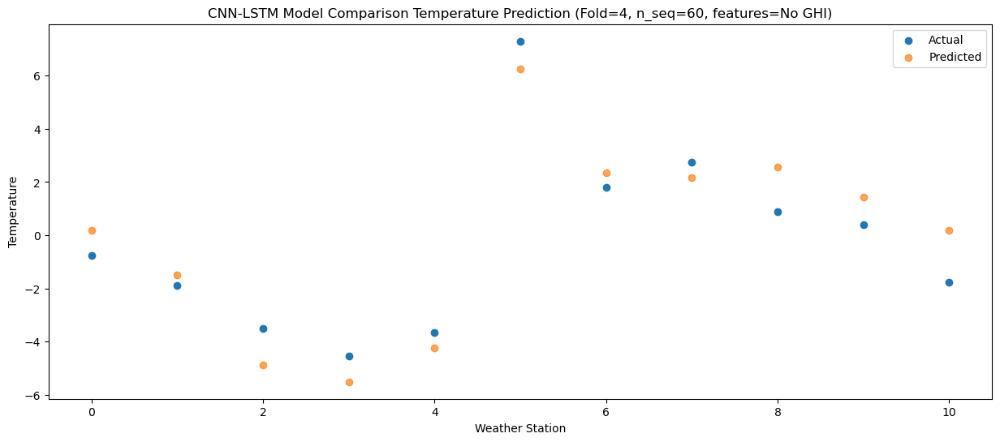

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.98   1.442220
1                 1    1.40  -0.237712
2                 2   -1.58  -3.617706
3                 3   -4.47  -4.257771
4                 4   -3.44  -2.987798
5                 5    7.47   7.502171
6                 6    5.22   3.612319
7                 7    4.89   3.432264
8                 8    2.48   3.812289
9                 9    1.60   2.682282
10               10   -1.64   1.442319


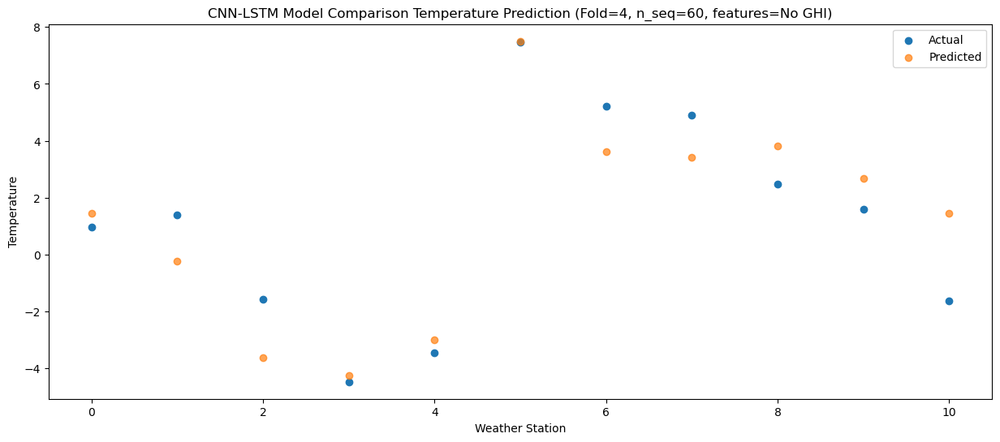

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.16   3.834225
1                 1    3.12   2.154290
2                 2    0.57  -1.225700
3                 3    0.06  -1.865760
4                 4    1.41  -0.595789
5                 5   12.54   9.894180
6                 6    5.70   6.004324
7                 7    6.61   5.824269
8                 8    3.75   6.204290
9                 9    4.14   5.074288
10               10   -0.76   3.834325


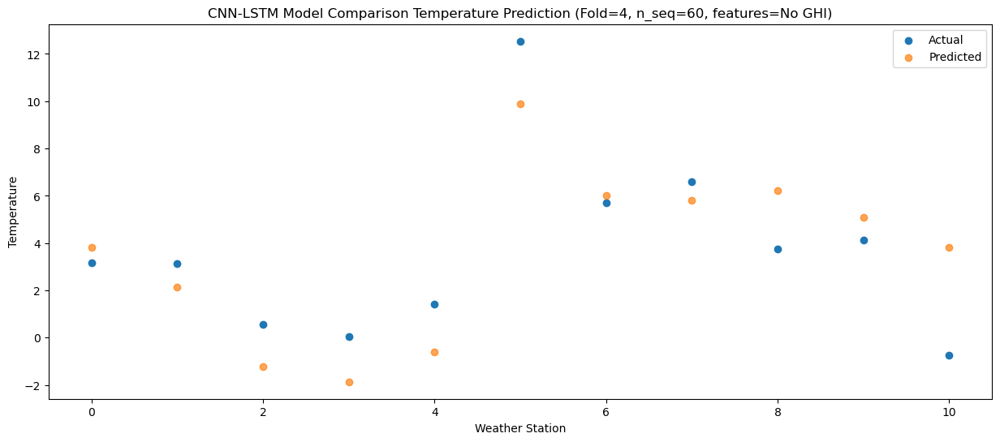

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   10.99   9.723417
1                 1    5.84   8.043529
2                 2    2.32   4.663519
3                 3    2.66   4.023440
4                 4    4.06   5.293407
5                 5   16.76  15.783364
6                 6    8.81  11.893567
7                 7   12.23  11.713477
8                 8   10.25  12.093513
9                 9   11.47  10.963495
10               10    7.71   9.723560


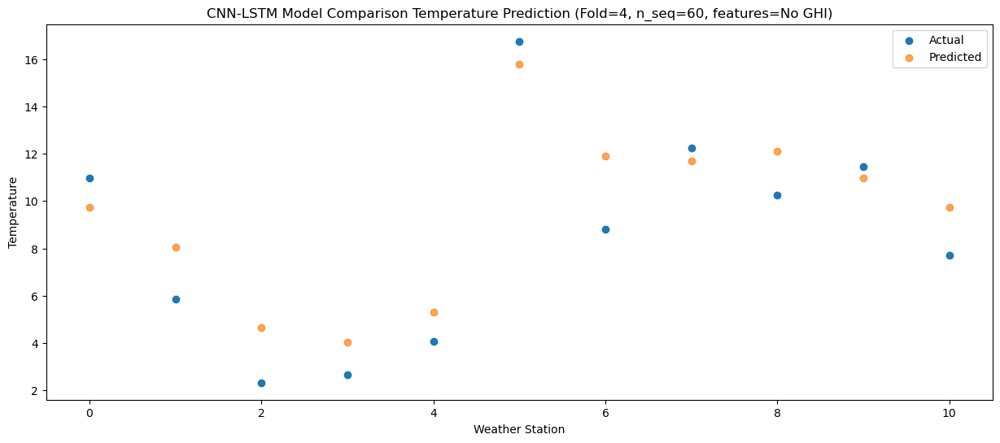

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   16.80  14.578192
1                 1    6.62  12.898319
2                 2    7.18   9.518304
3                 3    8.34   8.878215
4                 4   10.22  10.148178
5                 5   21.68  20.638137
6                 6   11.43  16.748358
7                 7   17.01  16.568252
8                 8   15.96  16.948295
9                 9   17.23  15.818270
10               10   11.40  14.578347


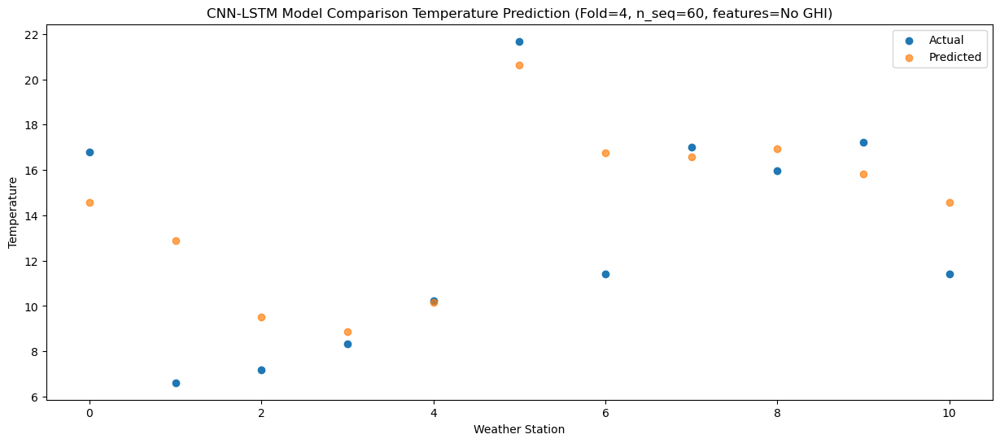

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   21.71  18.607315
1                 1    8.83  16.927403
2                 2   10.77  13.547400
3                 3   12.53  12.907334
4                 4   15.33  14.177297
5                 5   28.16  24.667264
6                 6   15.07  20.777444
7                 7   21.09  20.597367
8                 8   19.84  20.977390
9                 9   21.54  19.847381
10               10   15.71  18.607438


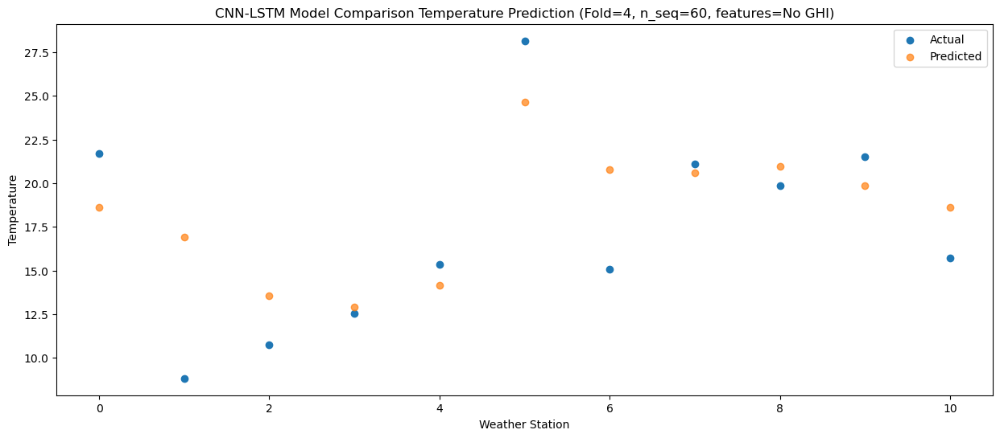

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   23.02  21.104484
1                 1   10.44  19.424525
2                 2   12.55  16.044537
3                 3   15.08  15.404489
4                 4   18.41  16.674460
5                 5   29.62  27.164435
6                 6   18.94  23.274560
7                 7   23.05  23.094524
8                 8   22.57  23.474532
9                 9   23.07  22.344540
10               10   18.80  21.104568


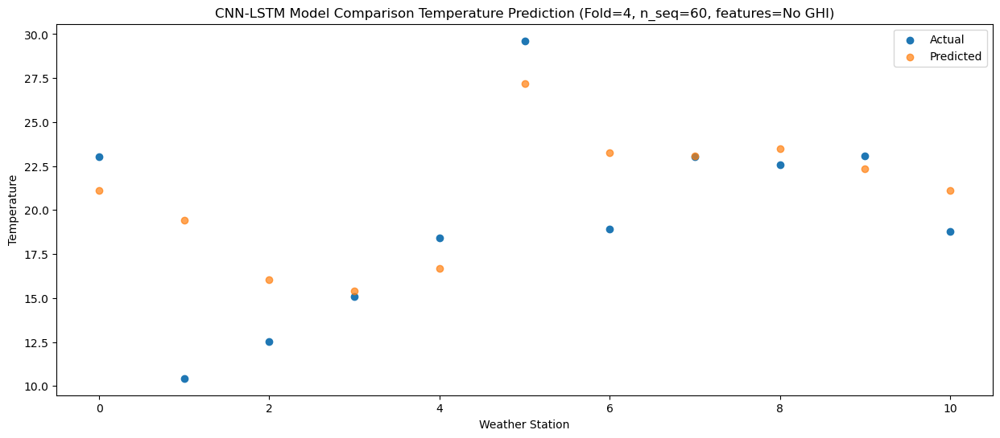

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   22.82  20.851915
1                 1   10.95  19.171878
2                 2   14.63  15.791918
3                 3   17.63  15.151915
4                 4   20.28  16.421892
5                 5   29.71  26.911871
6                 6   18.38  23.021911
7                 7   22.86  22.841938
8                 8   21.41  23.221918
9                 9   21.81  22.091956
10               10   17.47  20.851931


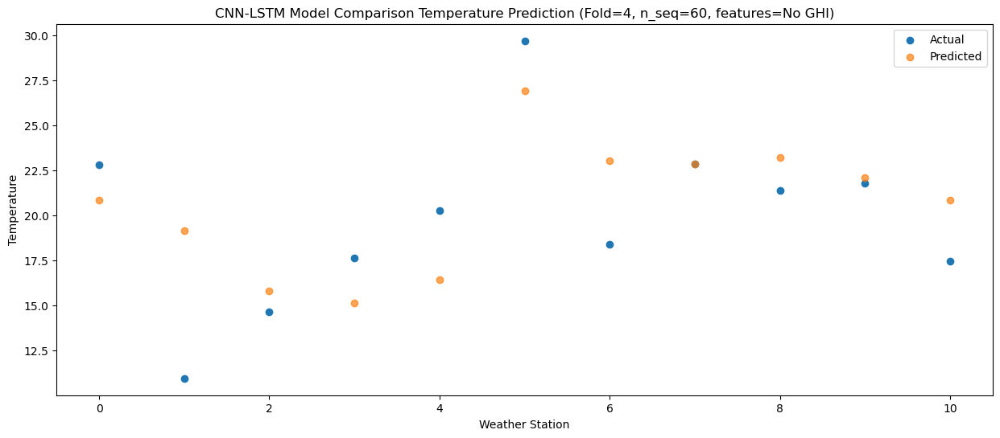

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   19.99  17.617928
1                 1    8.85  15.937859
2                 2   10.88  12.557913
3                 3   12.93  11.917924
4                 4   15.19  13.187907
5                 5   26.23  23.677886
6                 6   14.54  19.787892
7                 7   18.92  19.607945
8                 8   18.32  19.987914
9                 9   18.77  18.857961
10               10   15.13  17.617915


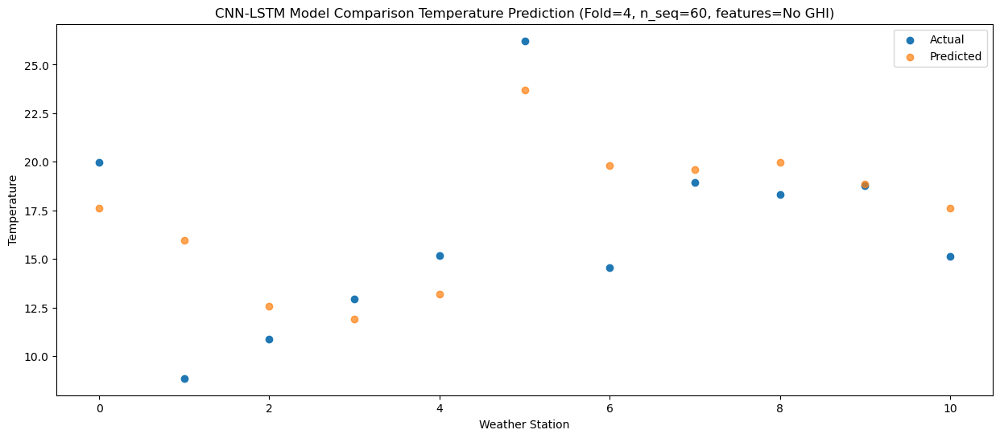

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.87  11.195983
1                 1    5.20   9.515813
2                 2    4.77   6.135906
3                 3    4.80   5.495971
4                 4    6.36   6.765955
5                 5   17.70  17.255937
6                 6    9.10  13.365852
7                 7   13.02  13.185979
8                 8   12.18  13.565915
9                 9   12.36  12.435997
10               10    9.87  11.195885


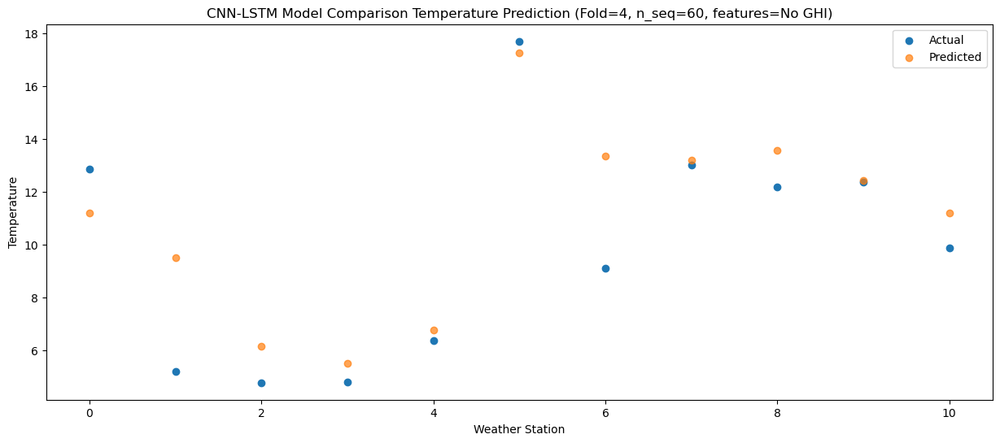

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    6.62   4.783750
1                 1    1.49   3.103591
2                 2   -2.19  -0.276321
3                 3   -1.27  -0.916262
4                 4   -0.17   0.353721
5                 5   10.99  10.843699
6                 6    3.37   6.953635
7                 7    7.12   6.773749
8                 8    5.11   7.153688
9                 9    5.27   6.023766
10               10    2.48   4.783665


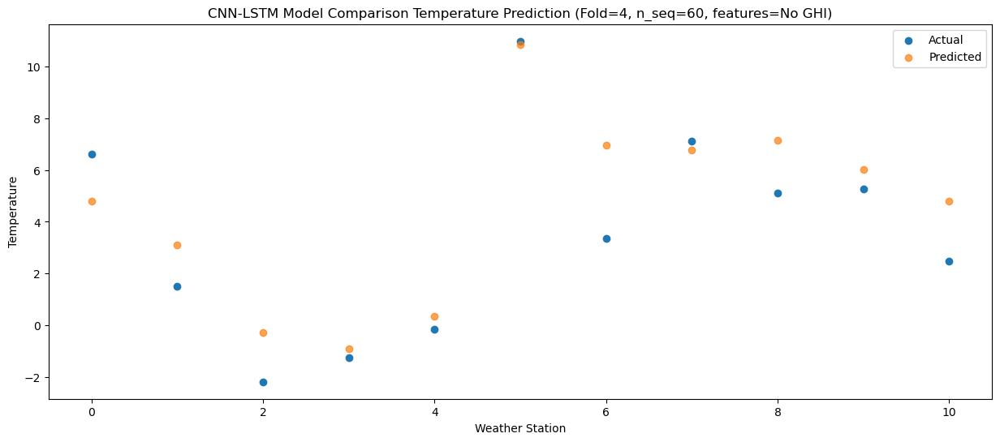

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.22   2.623044
1                 1   -0.63   0.942894
2                 2   -4.74  -2.437022
3                 3   -4.29  -3.076971
4                 4   -3.30  -1.806986
5                 5    8.19   8.682988
6                 6    1.16   4.792938
7                 7    4.24   4.613039
8                 8    3.22   4.992985
9                 9    3.28   3.863066
10               10    1.82   2.622964


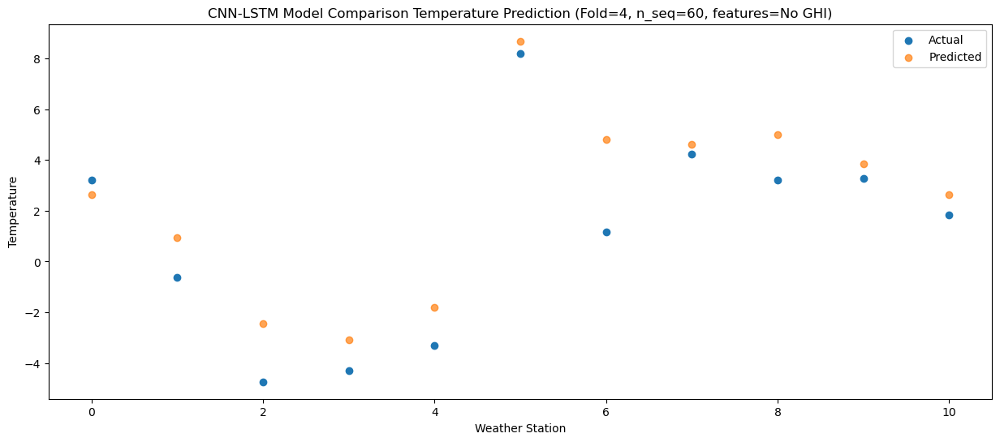

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -5.37  -2.839467
1                 1   -2.05  -4.519584
2                 2   -8.93  -7.899512
3                 3   -9.81  -8.539482
4                 4   -8.65  -7.269497
5                 5    3.94   3.220478
6                 6   -1.28  -0.669540
7                 7   -2.92  -0.849463
8                 8   -3.06  -0.469510
9                 9   -4.30  -1.599444
10               10   -3.95  -2.839519


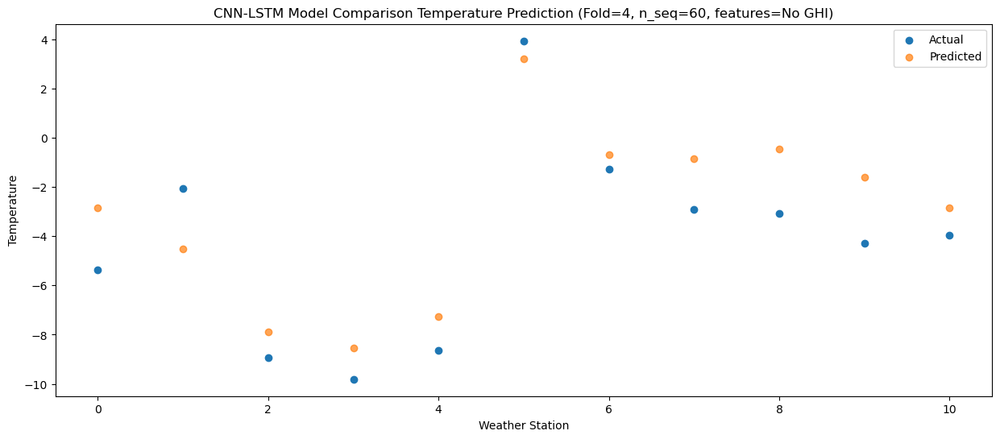

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.74   2.632115
1                 1   -2.32   0.951986
2                 2   -2.61  -2.427935
3                 3   -1.40  -3.067906
4                 4   -0.33  -1.797919
5                 5   10.76   8.692040
6                 6    2.13   4.802035
7                 7    6.99   4.622117
8                 8    3.28   5.002065
9                 9    3.47   3.872142
10               10   -0.47   2.632057


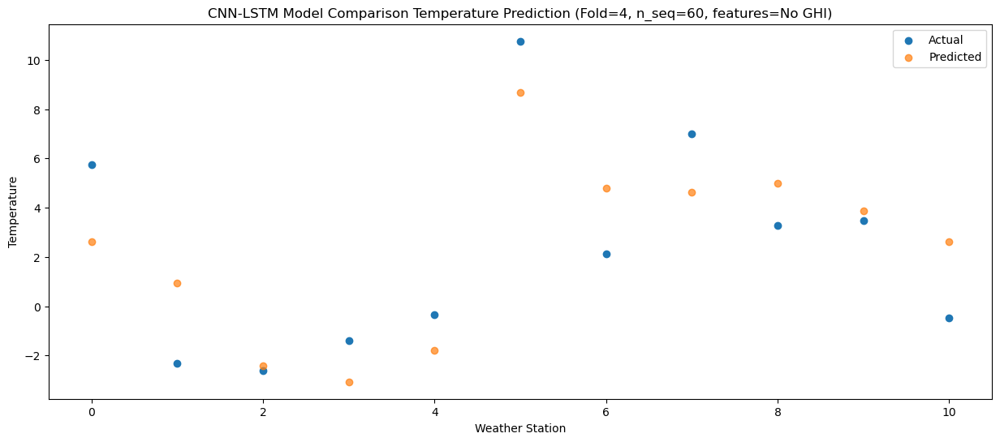

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.27   5.257534
1                 1    2.58   3.577447
2                 2   -0.38   0.197513
3                 3    1.01  -0.442483
4                 4    2.24   0.827500
5                 5   13.36  11.317461
6                 6    5.92   7.427495
7                 7    9.42   7.247552
8                 8    7.72   7.627507
9                 9    7.62   6.497569
10               10    2.88   5.257508


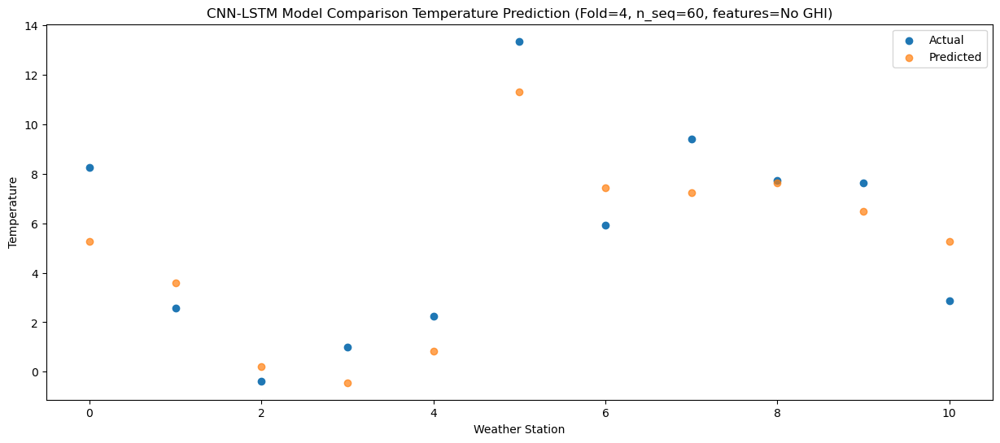

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.89   9.982664
1                 1    3.63   8.302594
2                 2    3.44   4.922655
3                 3    4.86   4.282644
4                 4    6.29   5.552626
5                 5   18.32  16.042589
6                 6   10.15  12.152648
7                 7   13.56  11.972685
8                 8   12.30  12.352651
9                 9   12.11  11.222702
10               10    8.60   9.982653


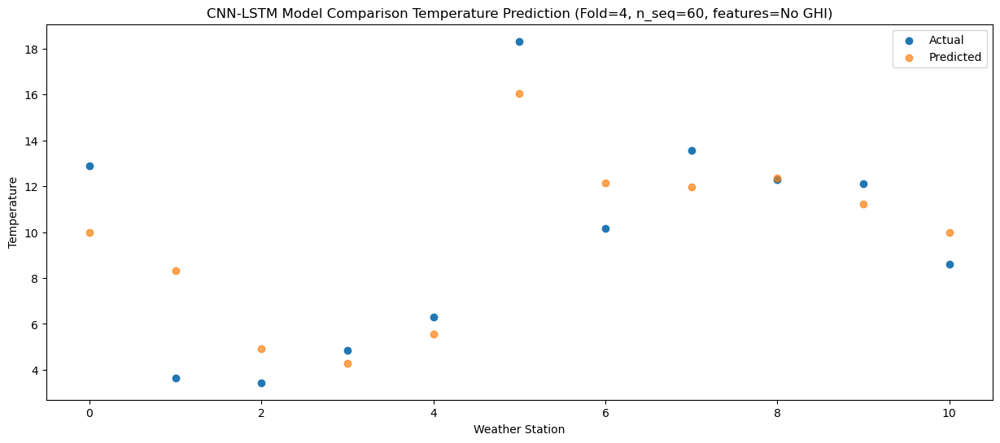

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.90  15.258627
1                 1    9.08  13.578580
2                 2    8.96  10.198634
3                 3    9.62   9.558604
4                 4   11.09  10.828590
5                 5   23.61  21.318547
6                 6   14.22  17.428638
7                 7   18.21  17.248655
8                 8   18.90  17.628635
9                 9   19.14  16.498674
10               10   14.70  15.258645


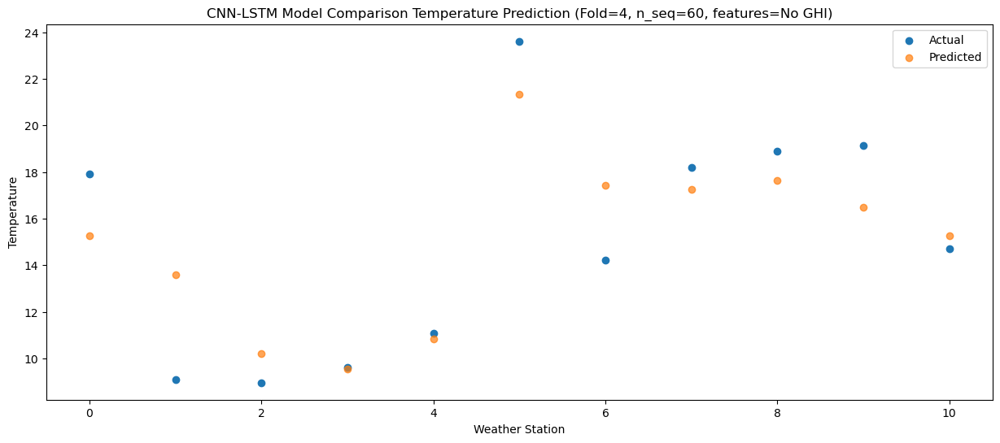

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   23.09  19.404085
1                 1    9.73  17.724052
2                 2   11.59  14.344095
3                 3   13.65  13.704062
4                 4   15.54  14.974045
5                 5   27.62  25.464004
6                 6   17.64  21.574110
7                 7   21.93  21.394116
8                 8   22.26  21.774100
9                 9   23.11  20.644133
10               10   17.86  19.404111


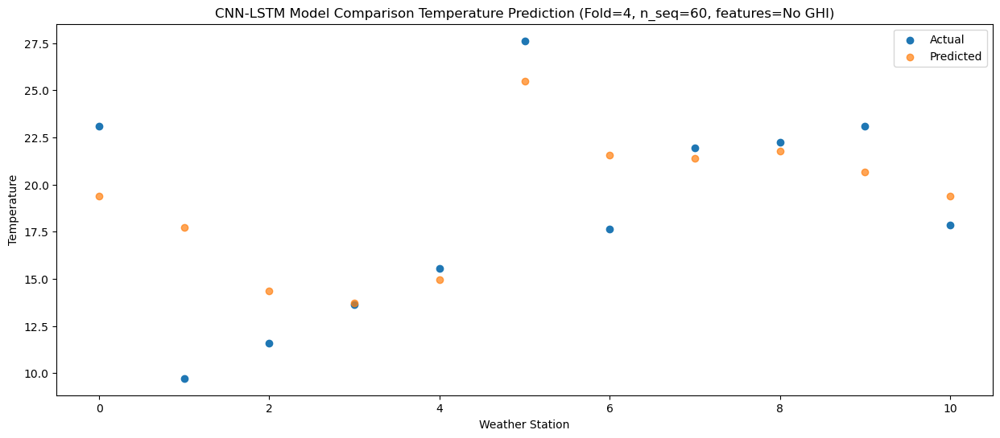

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   23.85  20.255844
1                 1   10.42  18.575821
2                 2   12.61  15.195858
3                 3   14.55  14.555823
4                 4   16.25  15.825804
5                 5   26.45  26.315771
6                 6   19.10  22.425877
7                 7   22.23  22.245877
8                 8   22.27  22.625857
9                 9   22.14  21.495890
10               10   19.38  20.255870


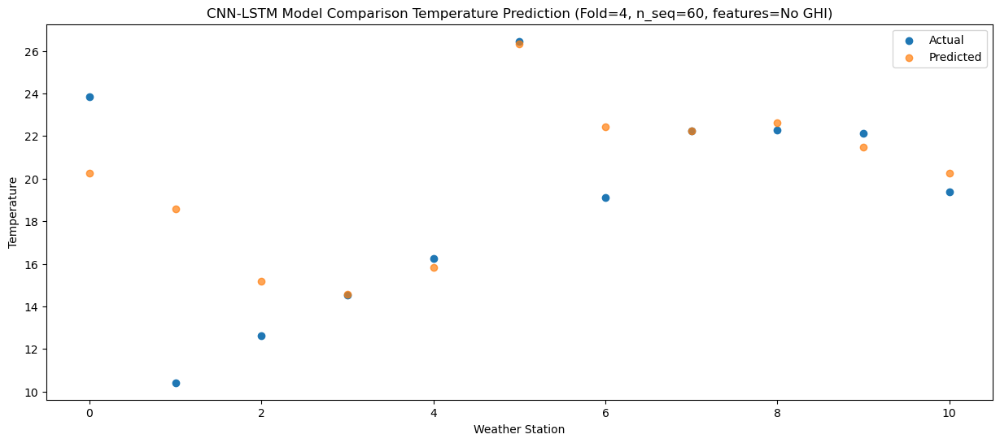

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   22.36  19.732605
1                 1   10.12  18.052569
2                 2   13.18  14.672610
3                 3   16.30  14.032582
4                 4   18.21  15.302564
5                 5   28.91  25.792532
6                 6   17.94  21.902624
7                 7   22.67  21.722639
8                 8   22.19  22.102620
9                 9   21.80  20.972659
10               10   18.24  19.732627


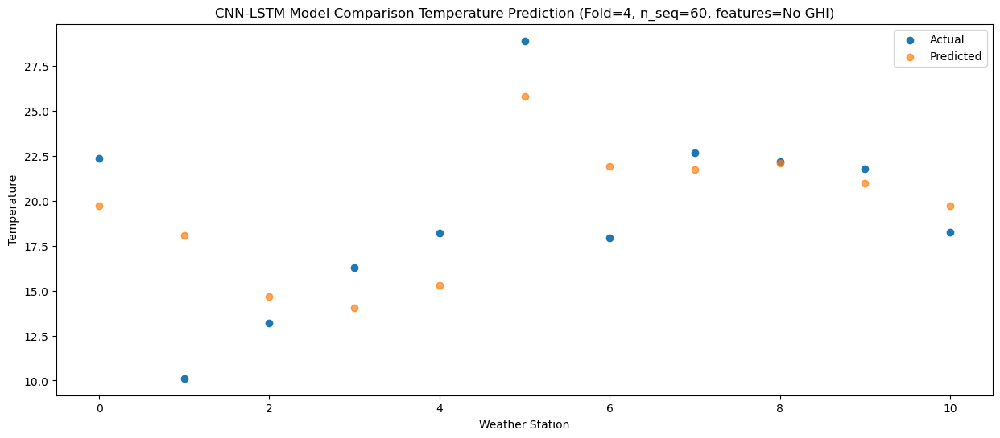

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   19.93  17.162017
1                 1    9.25  15.481968
2                 2    9.57  12.102014
3                 3   10.91  11.461992
4                 4   12.20  12.731974
5                 5   22.46  23.221940
6                 6   15.50  19.332023
7                 7   18.53  19.152049
8                 8   19.58  19.532029
9                 9   18.57  18.402075
10               10   15.97  17.162032


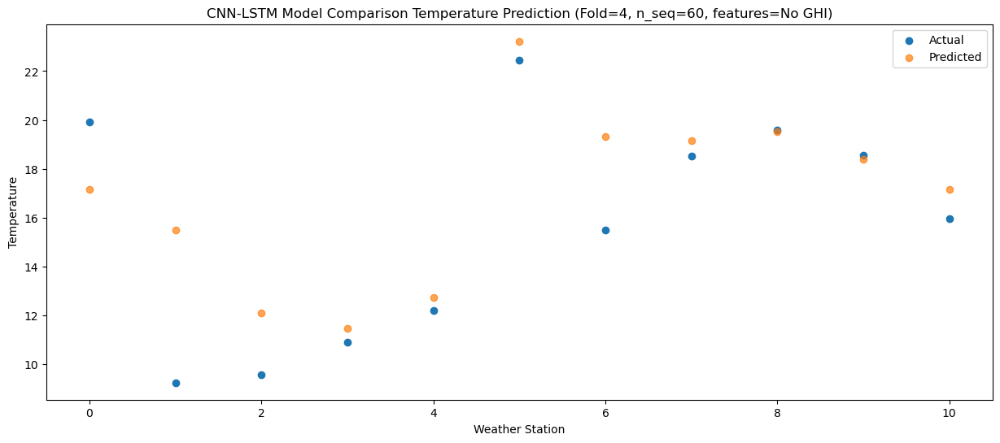

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   15.80  11.904218
1                 1    5.48  10.224113
2                 2    5.43   6.844185
3                 3    8.16   6.204190
4                 4    9.78   7.474169
5                 5   20.75  17.964124
6                 6    9.88  14.074181
7                 7   14.85  13.894244
8                 8   13.65  14.274211
9                 9   13.50  13.144277
10               10    9.50  11.904196


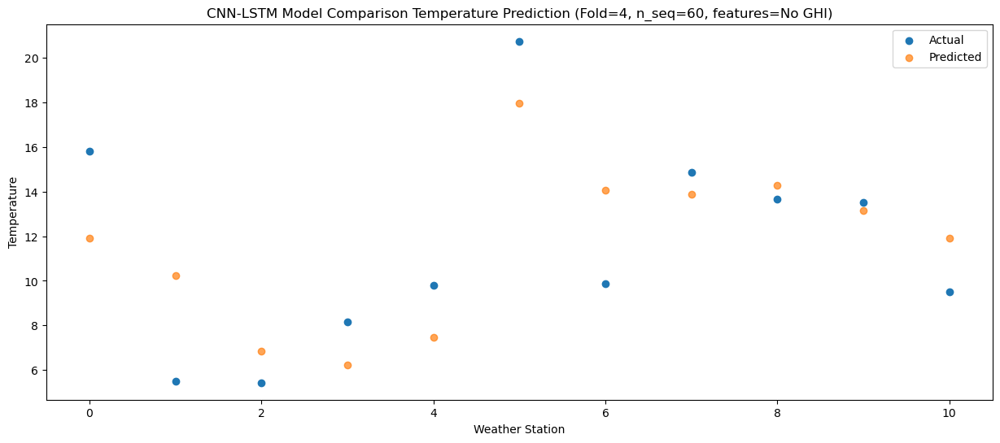

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_4 (Conv1D)           (None, 1, 512)            929792    
                                                                 
 max_pooling1d_4 (MaxPooling  (None, 1, 512)           0         
 1D)                                                             
                                                                 
 dropout_12 (Dropout)        (None, 1, 512)            0         
                                                                 
 lstm_8 (LSTM)               (None, 1, 1024)           6295552   
                                                                 
 dropout_13 (Dropout)        (None, 1, 1024)           0         
                                                                 
 lstm_9 (LSTM)               (None, 1024)              8392704   
                                                      

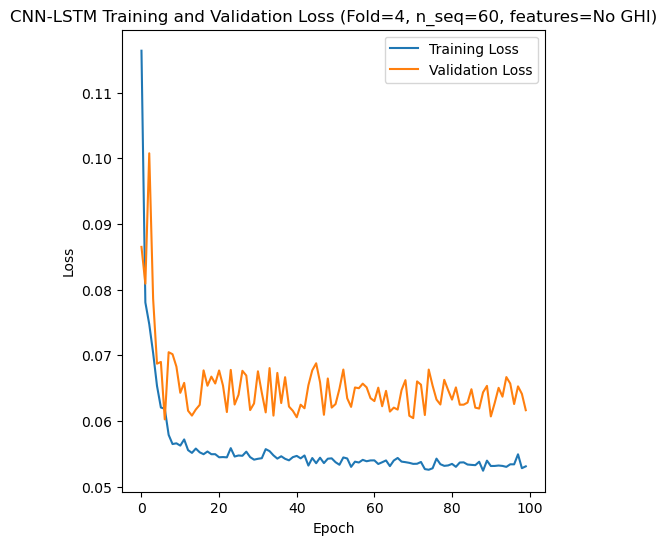

[[1.4632096125489753, 1.1763952088816558, 1.490483370738382, 1.659855049976464, 2.219499222612174, 1.4980347419400635, 2.3851955060917063, 3.721369621059303, 4.402085294414288, 3.767852379883467, 2.8345144833223745, 1.573955951527888, 1.612574424402567, 2.211619215300344, 1.9155243076815505, 2.1720394189674535, 1.8538417744403064, 3.0360935107557134, 3.792684029657661, 5.409005709542434, 5.893180836166696, 5.275474649873934, 4.882362266778169, 3.3852305007416077, 3.591018900619183, 2.310156518873354, 3.030362155964647, 2.5950159958665924, 2.5938458476381148, 3.252880635086153, 3.9118632400139943, 4.956279180018262, 6.554909434873172, 7.057689660293191, 5.927196980377832, 5.1799046025481745, 3.7381521574037873, 3.5421083096265207, 3.665620868393817, 2.397385818275623, 3.1267839869588925, 4.737709541437104, 5.487265641207438, 5.753514980552597, 7.0153466046776956, 6.033215213826477, 6.018159910976915, 5.58077021068202, 4.793578728831488, 4.96927774385805, 4.566855795582946, 4.32422254310

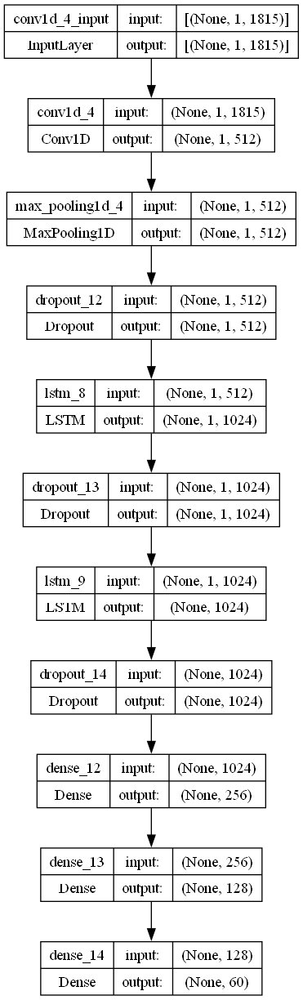

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    filters = 512
    lr = 0.0012821726838092452
    optimizer = Adam(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 1024
    dropout_rate = 0.15053071753197886

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# make one forecast with a CNN-LSTM model,
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='CNN-LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No GHI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'CNN-LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No GHI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "cnnlstm_model_optimized_CV_S60_No_GHI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)